In [64]:
!pip install pmdarima

   ---------------------------------------- 0.0/625.1 kB ? eta -:--:--
   ---------------------------------------- 0.0/625.1 kB ? eta -:--:--
   --------------------------------- ------ 524.3/625.1 kB 3.4 MB/s eta 0:00:01
   --------------------------------- ------ 524.3/625.1 kB 3.4 MB/s eta 0:00:01
   -------------------------------------- 625.1/625.1 kB 860.1 kB/s eta 0:00:00
   ---------------------------------------- 0.0/2.8 MB ? eta -:--:--
   ----------- ---------------------------- 0.8/2.8 MB 3.4 MB/s eta 0:00:01
   ---------------------- ----------------- 1.6/2.8 MB 4.0 MB/s eta 0:00:01
   ------------------------------------- -- 2.6/2.8 MB 4.3 MB/s eta 0:00:01
   ------------------------------------- -- 2.6/2.8 MB 4.3 MB/s eta 0:00:01
   ---------------------------------------- 2.8/2.8 MB 2.8 MB/s eta 0:00:00


In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.model_selection import TimeSeriesSplit
from pmdarima import auto_arima
from sklearn.metrics import mean_absolute_error, mean_squared_error, root_mean_squared_error
import time

In [15]:
df = pd.read_csv('BER Eq sales data full-date.csv')

## EDA

In [16]:
df

,InvoiceDate,InventoryWarehouseId,ProductNumber,ProductName,Sum of InvoicedQuantity,PrimaryVendorAccountNumber
0,01/01/2020,RKSQR,BURBER002,NaN,1,NaN
1,01/01/2020,JDSQR,COKBER001,NaN,1,NaN
2,01/01/2020,KMSQR,COKBER001,NaN,1,NaN
3,01/01/2020,MDSQR,COKBER001,NaN,1,NaN
4,01/01/2020,DMSQR,FRYBER002,NaN,2,NaN
...,...,...,...,...,...,...
7560,31/12/2024,DMSQR,GRLBER009,NaN,1,NaN
7561,31/12/2024,MDSQR,GRLBER020,NaN,1,NaN
7562,31/12/2024,QSSQR,OVEBER002,NaN,1,NaN
7563,31/12/2024,RDSQR,OVEBER011,NaN,1,NaN


In [17]:
df['ProductNumber'].nunique()

61

In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7565 entries, 0 to 7564
Data columns (total 6 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   InvoiceDate                 7565 non-null   object
 1   InventoryWarehouseId        7565 non-null   object
 2   ProductNumber               7565 non-null   object
 3   ProductName                 2219 non-null   object
 4   Sum of InvoicedQuantity     7565 non-null   int64 
 5   PrimaryVendorAccountNumber  2219 non-null   object
dtypes: int64(1), object(5)
memory usage: 354.7+ KB


## Data pre-processing

In [19]:
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'], dayfirst=True)

In [20]:
df = df.drop(columns= ['PrimaryVendorAccountNumber', 'ProductName'], axis= True)

In [21]:
df.head()

,InvoiceDate,InventoryWarehouseId,ProductNumber,Sum of InvoicedQuantity
0,2020-01-01,RKSQR,BURBER002,1
1,2020-01-01,JDSQR,COKBER001,1
2,2020-01-01,KMSQR,COKBER001,1
3,2020-01-01,MDSQR,COKBER001,1
4,2020-01-01,DMSQR,FRYBER002,2


In [22]:
df['InventoryWarehouseId_dup'] = df['InventoryWarehouseId']
df['ProductNumber_dup'] = df['ProductNumber']

In [58]:
df.loc[df['ProductNumber'] == 'ICMBER003']

,InvoiceDate,InventoryWarehouseId,ProductNumber,Sum of InvoicedQuantity,InventoryWarehouseId_dup,ProductNumber_dup
6402,2023-11-02,JDSQR,ICMBER003,1,JDSQR,ICMBER003
6785,2024-03-17,KMSQR,ICMBER003,1,KMSQR,ICMBER003
6808,2024-04-02,TKSQR,ICMBER003,1,TKSQR,ICMBER003
6833,2024-05-01,TKSQR,ICMBER003,2,TKSQR,ICMBER003
6868,2024-05-09,MDSQR,ICMBER003,1,MDSQR,ICMBER003
6948,2024-05-30,QSSQR,ICMBER003,1,QSSQR,ICMBER003
6988,2024-06-08,JZSQR,ICMBER003,1,JZSQR,ICMBER003


In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7565 entries, 0 to 7564
Data columns (total 6 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   InvoiceDate               7565 non-null   datetime64[ns]
 1   InventoryWarehouseId      7565 non-null   object        
 2   ProductNumber             7565 non-null   object        
 3   Sum of InvoicedQuantity   7565 non-null   int64         
 4   InventoryWarehouseId_dup  7565 non-null   object        
 5   ProductNumber_dup         7565 non-null   object        
dtypes: datetime64[ns](1), int64(1), object(4)
memory usage: 354.7+ KB


In [25]:
df.describe()

,InvoiceDate,Sum of InvoicedQuantity
count,7565,7565.000000
mean,2022-04-22 06:40:29.821546496,1.099802
min,2020-01-01 00:00:00,-10.000000
25%,2021-03-16 00:00:00,1.000000
50%,2022-04-05 00:00:00,1.000000
75%,2023-04-27 00:00:00,1.000000
max,2024-12-31 00:00:00,33.000000
std,NaN,1.138229


In [26]:
raw_data_group = df.groupby(['ProductNumber', 'InvoiceDate'], as_index=False)['Sum of InvoicedQuantity'].sum()
raw_data_group

,ProductNumber,InvoiceDate,Sum of InvoicedQuantity
0,BOLBER001,2020-01-07,2
1,BOLBER001,2020-01-30,3
2,BOLBER001,2020-02-10,1
3,BOLBER001,2020-02-22,-1
4,BOLBER001,2020-03-02,10
...,...,...,...
6375,WARBER024,2023-02-25,1
6376,WARBER024,2023-02-28,1
6377,WARBER024,2023-03-06,1
6378,WARBER024,2024-02-07,1


Raw data historical demand for Product: BOLBER001


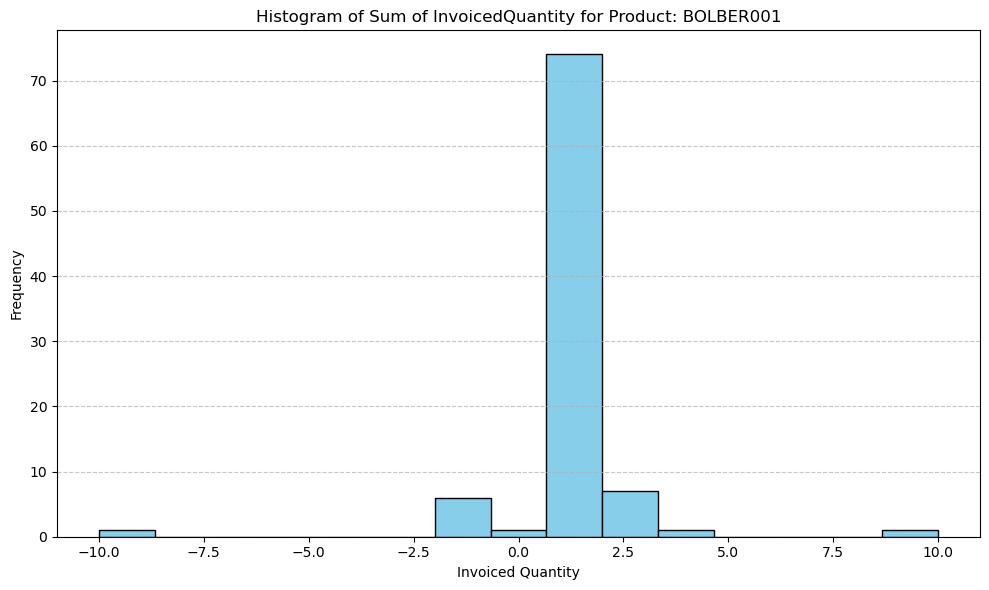

Raw data historical demand for Product: BOLBER002


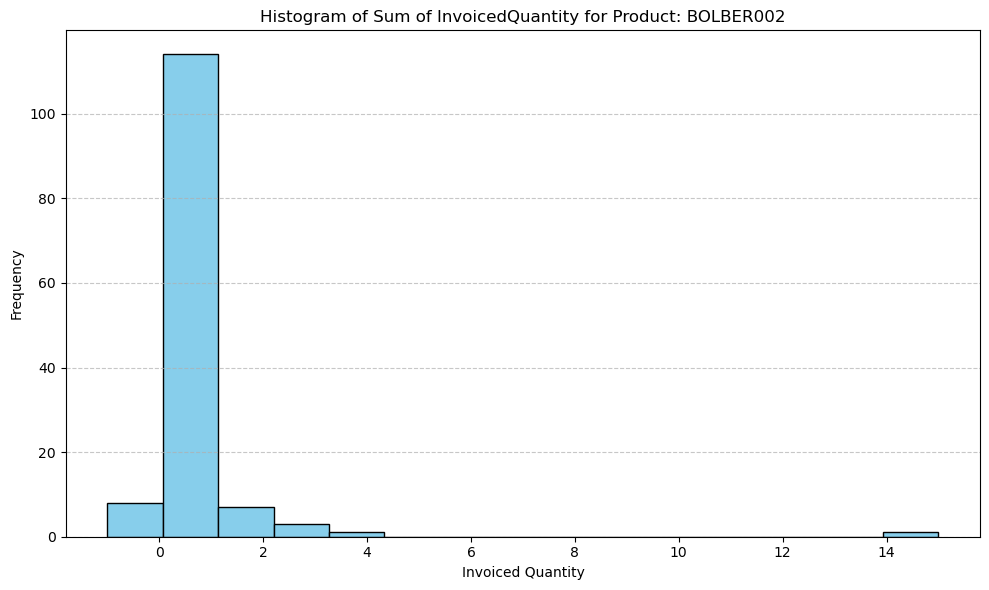

Raw data historical demand for Product: BOLBER003


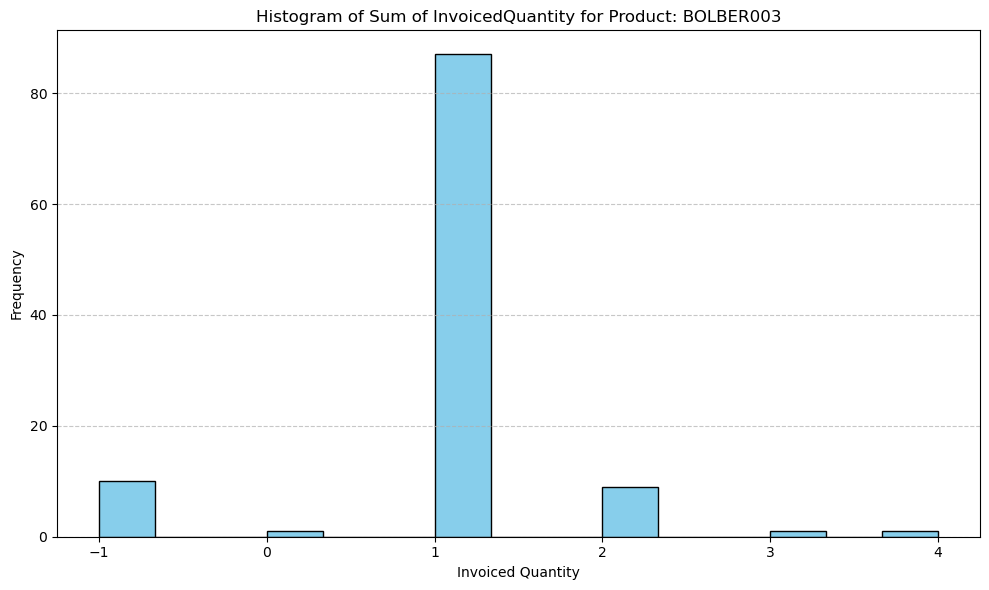

Raw data historical demand for Product: BOLBER005


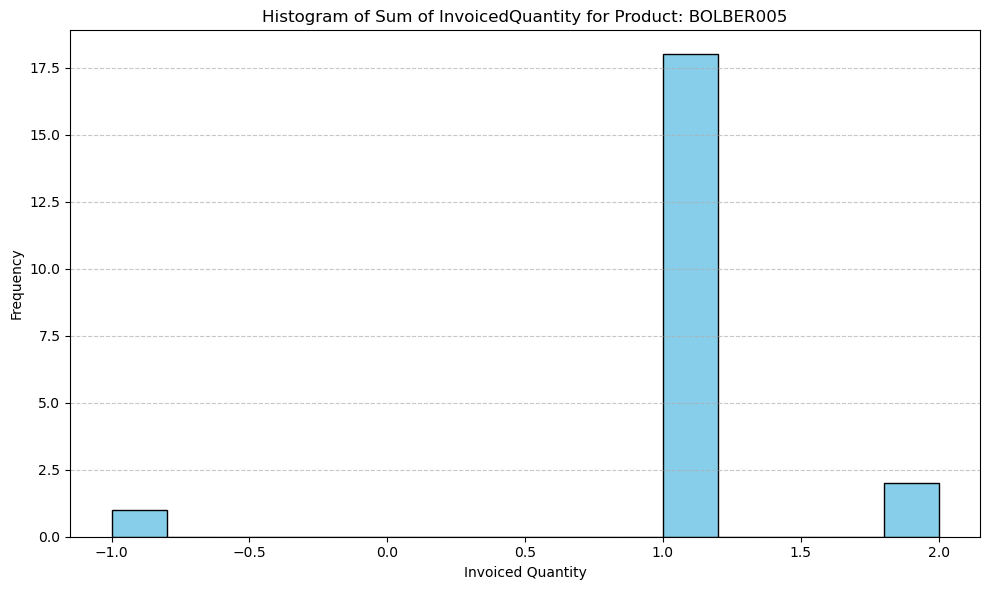

Raw data historical demand for Product: BURBER001


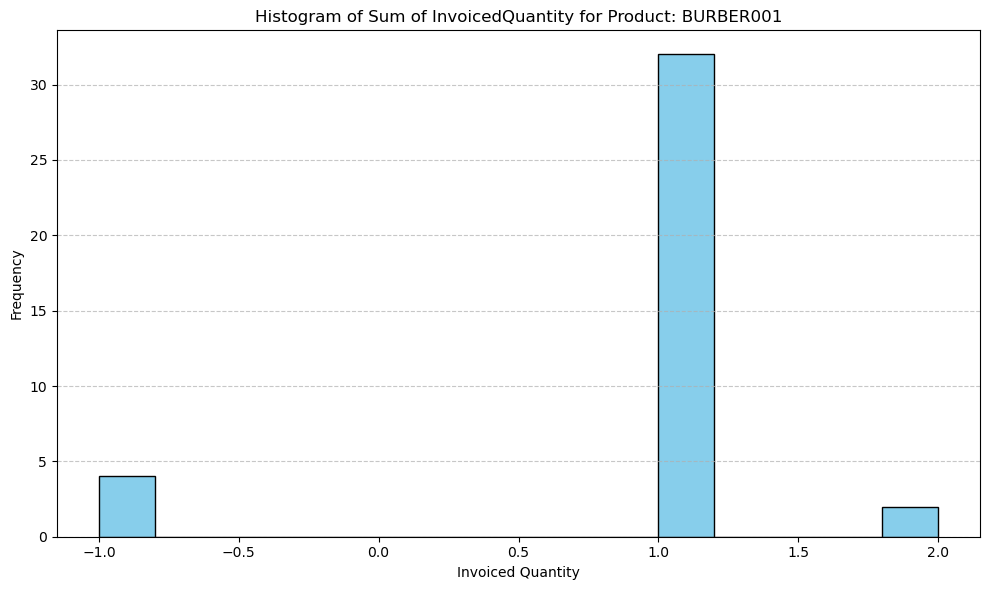

Raw data historical demand for Product: BURBER002


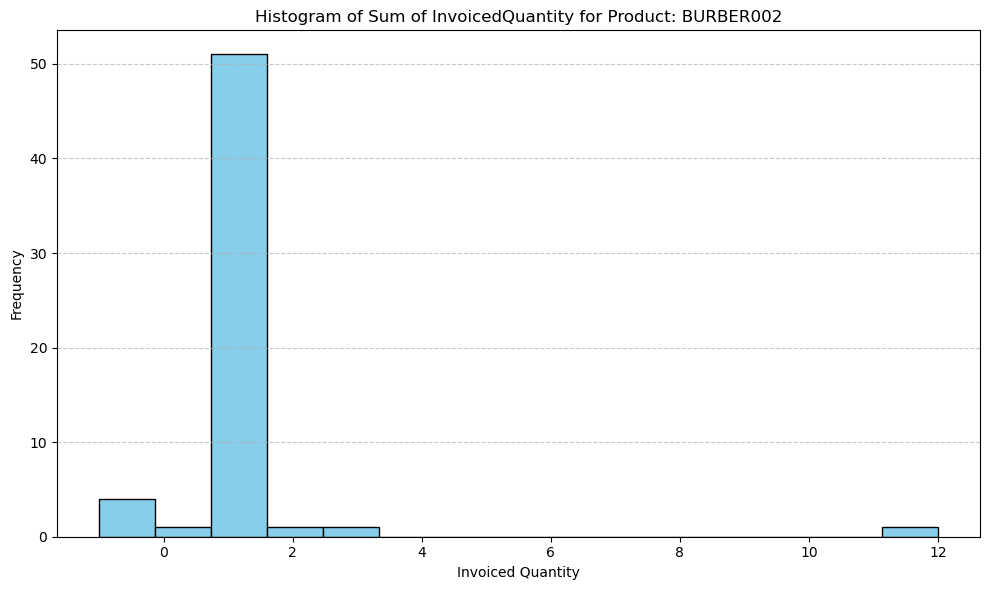

Raw data historical demand for Product: BURBER003


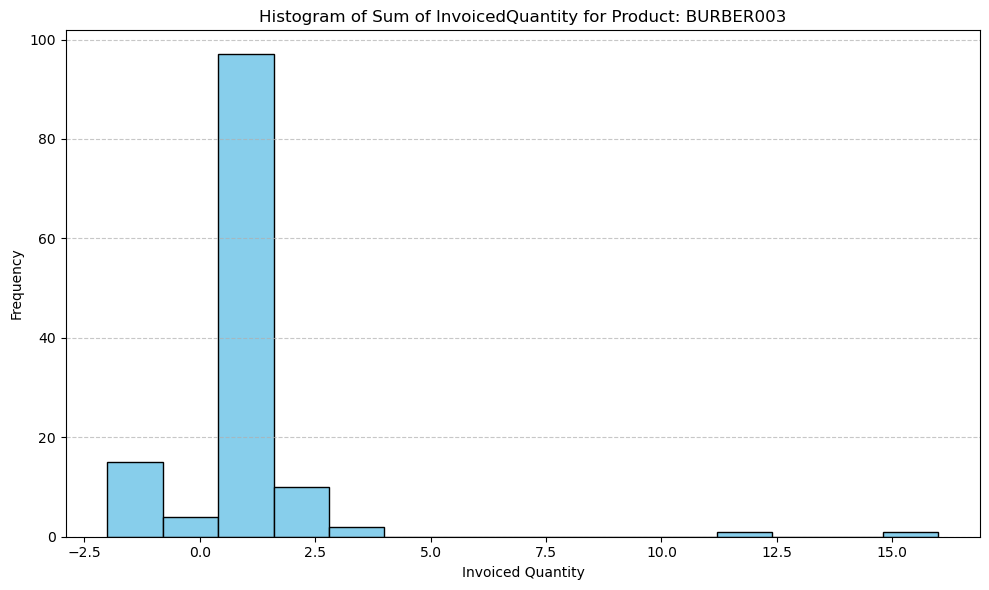

Raw data historical demand for Product: BURBER004


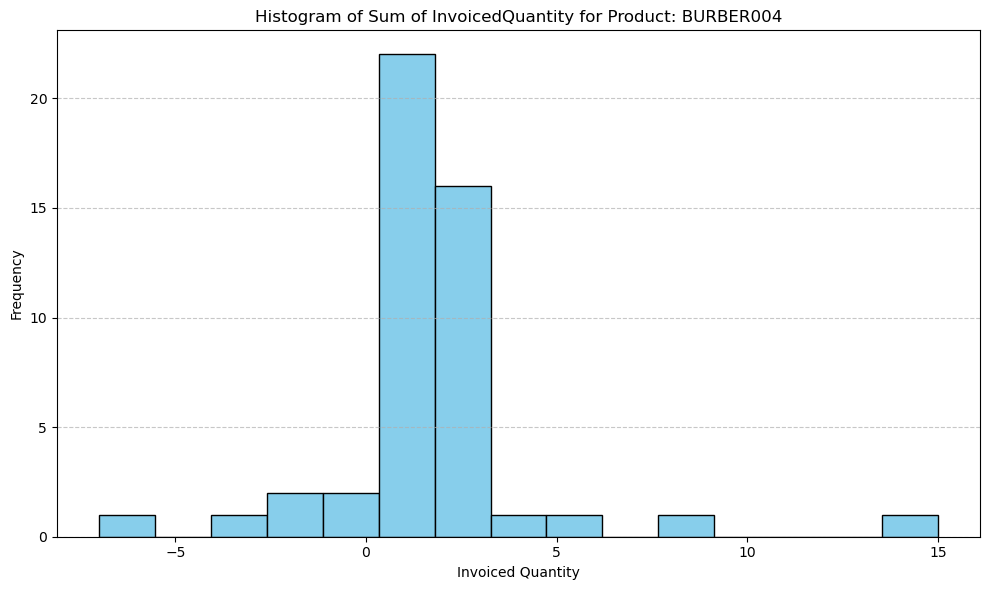

Raw data historical demand for Product: BURBER007


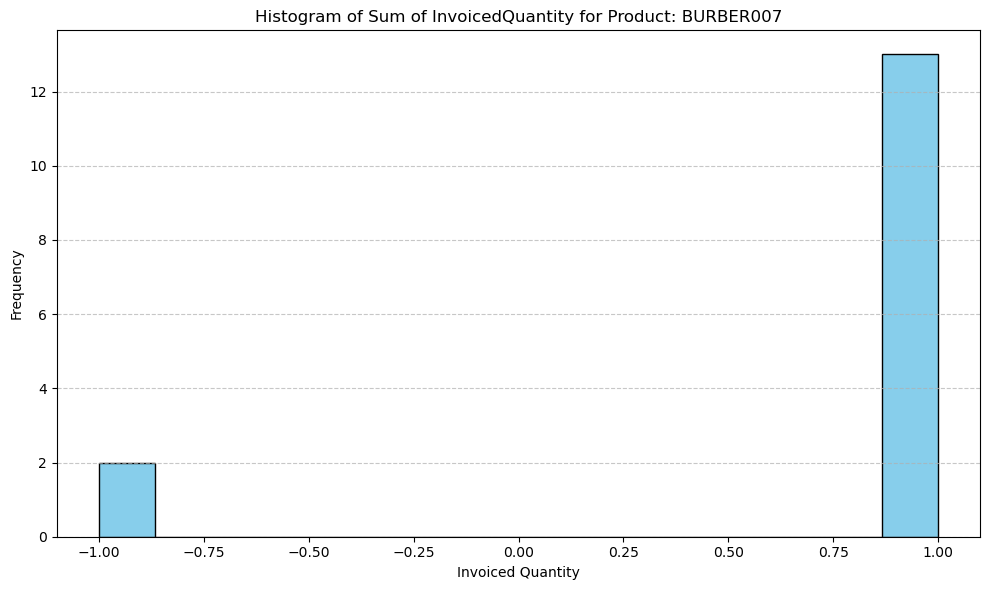

Raw data historical demand for Product: COFBER001


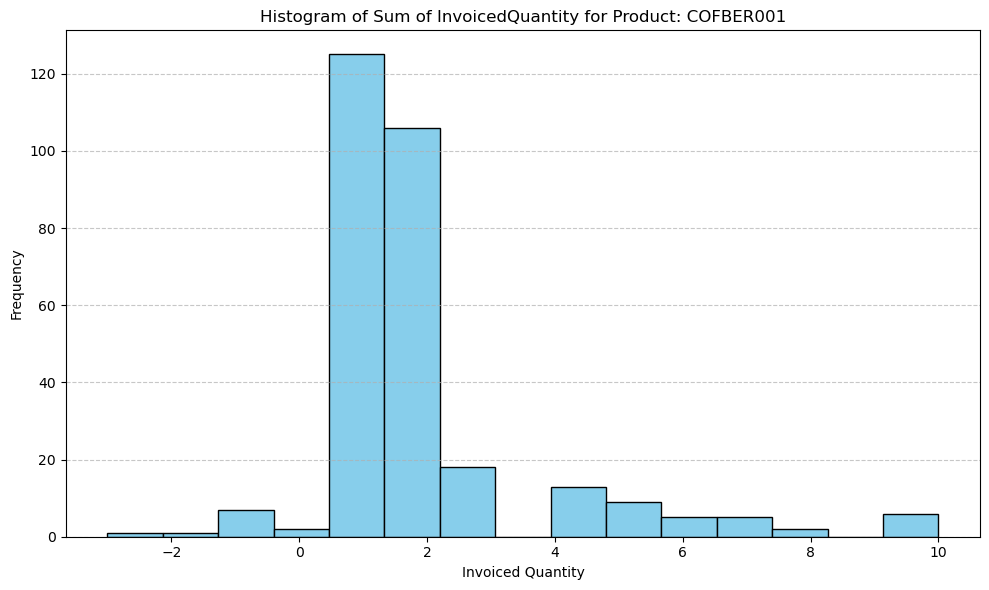

Raw data historical demand for Product: COKBER001


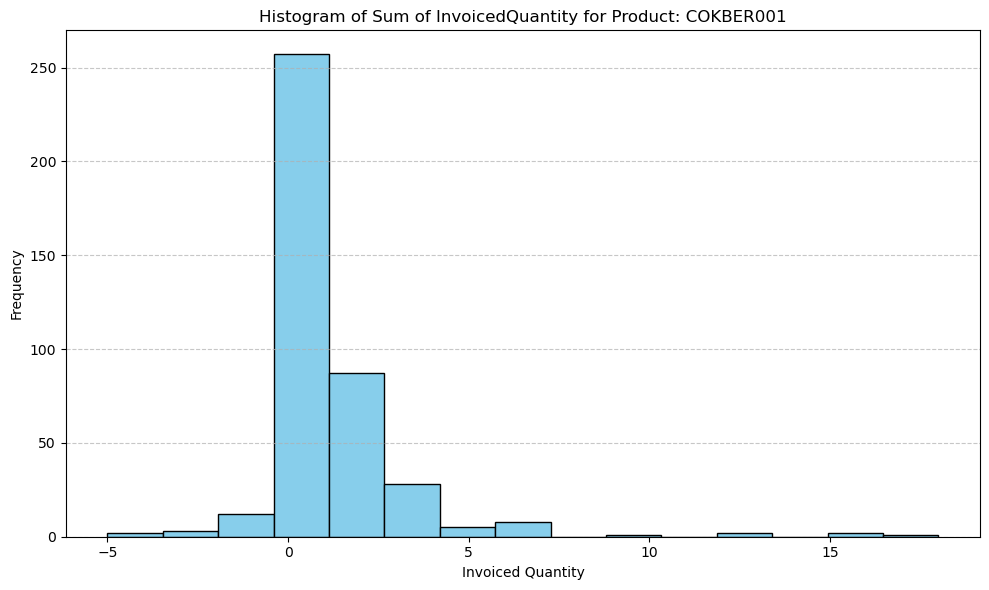

Raw data historical demand for Product: FRYBER002


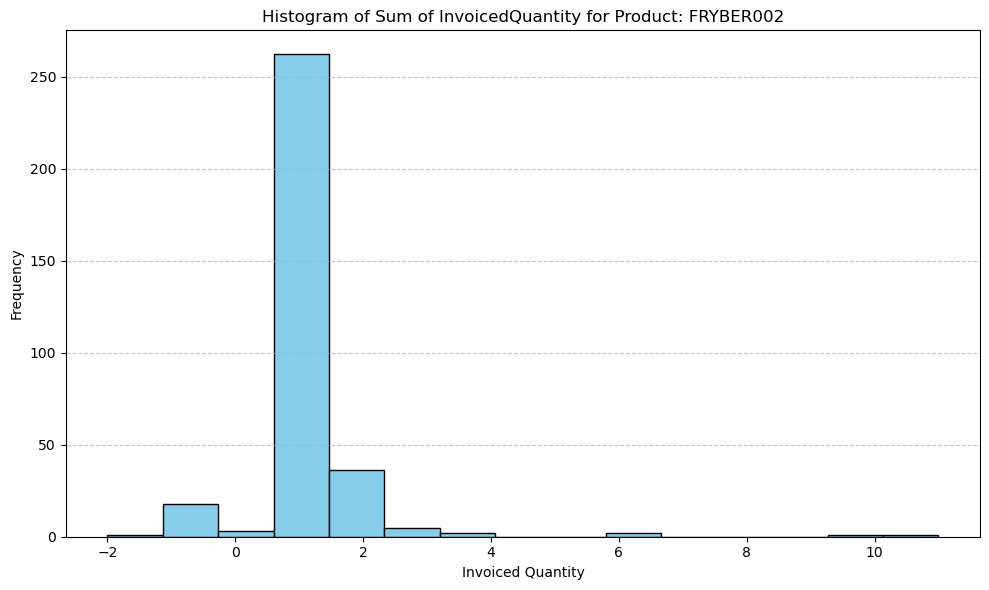

Raw data historical demand for Product: FRYBER003


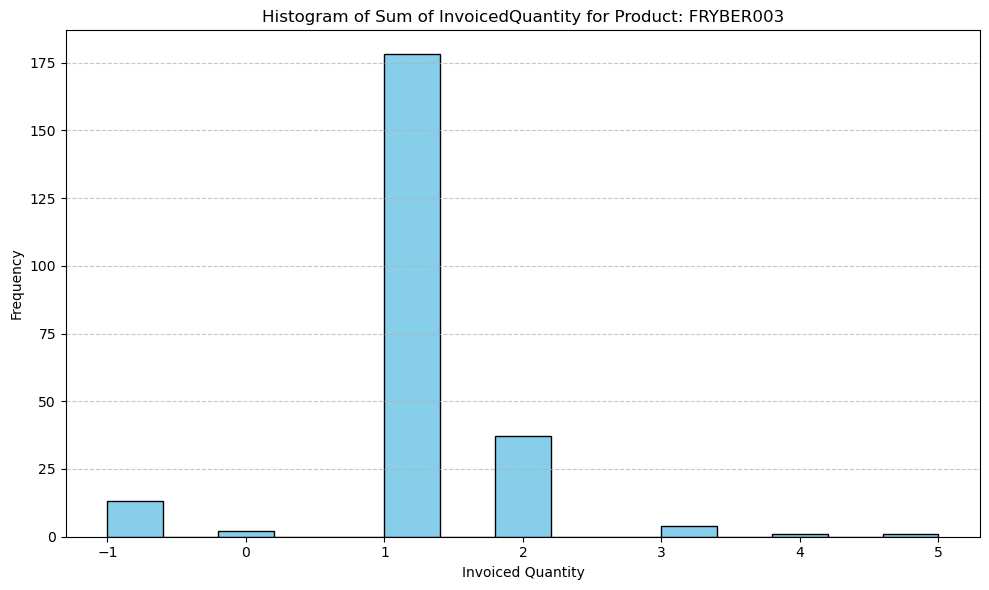

Raw data historical demand for Product: FRYBER005


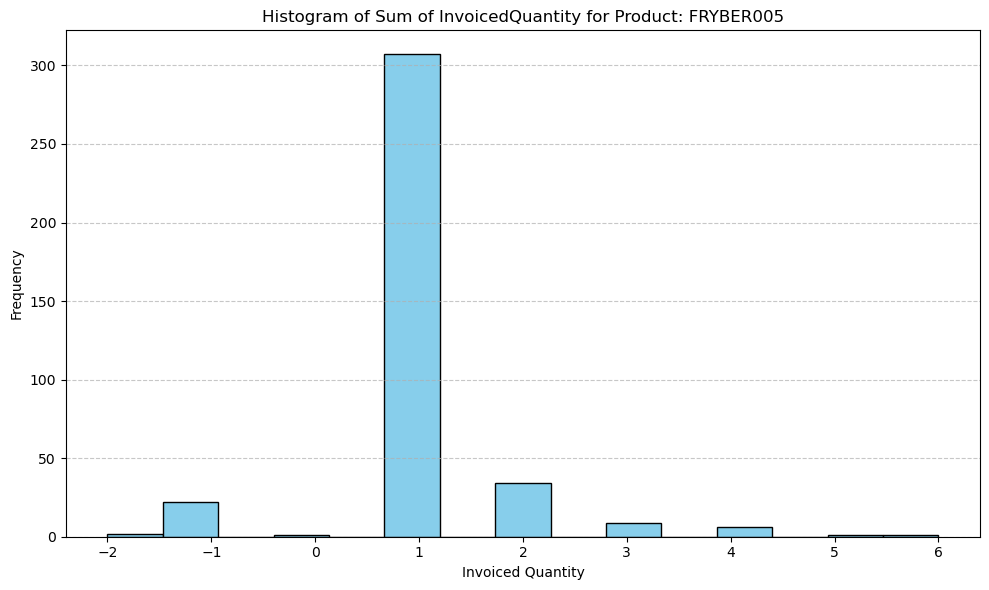

Raw data historical demand for Product: GRLBER003


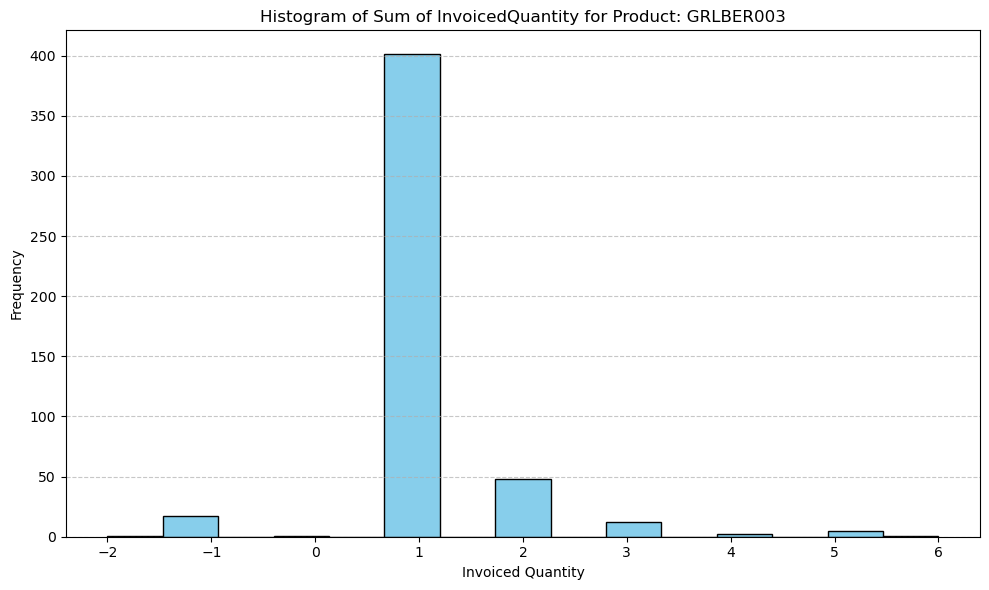

Raw data historical demand for Product: GRLBER004


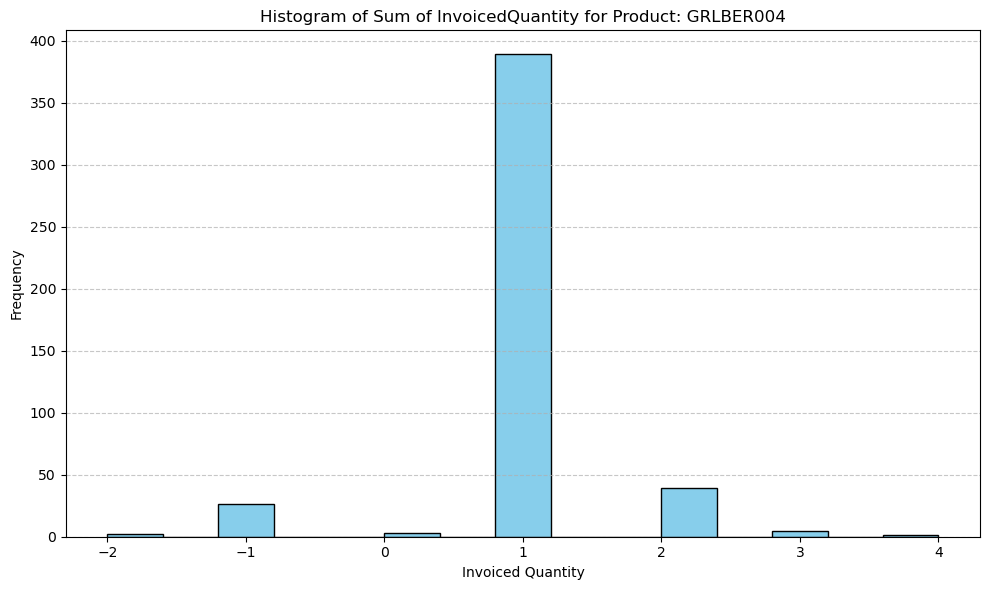

Raw data historical demand for Product: GRLBER009


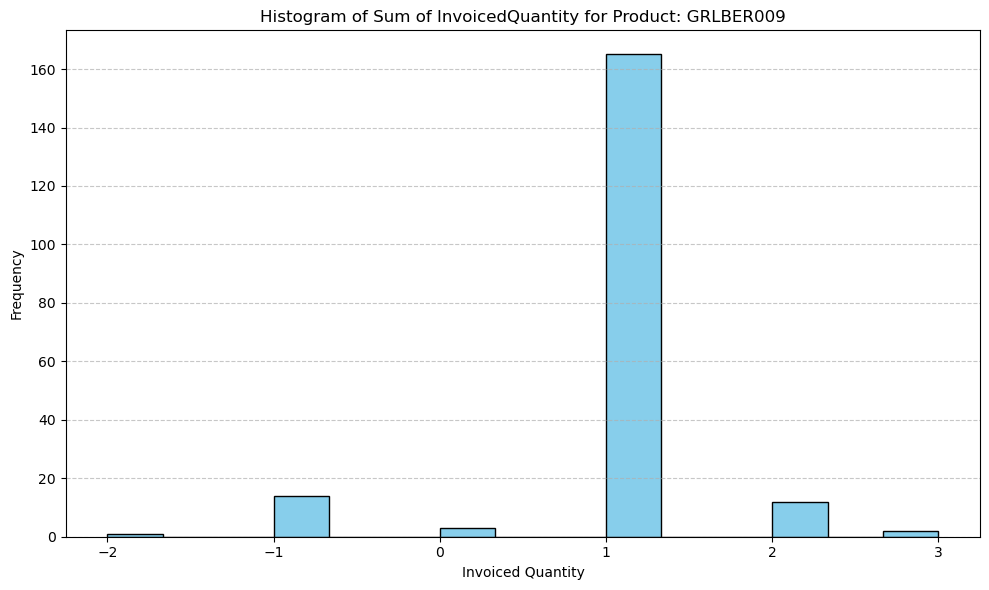

Raw data historical demand for Product: GRLBER010


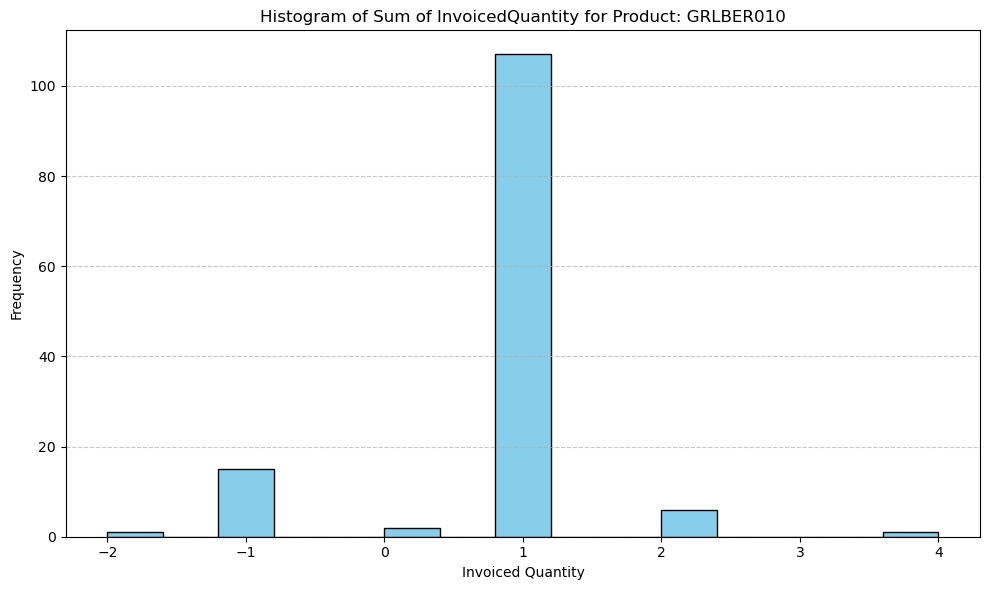

Raw data historical demand for Product: GRLBER011


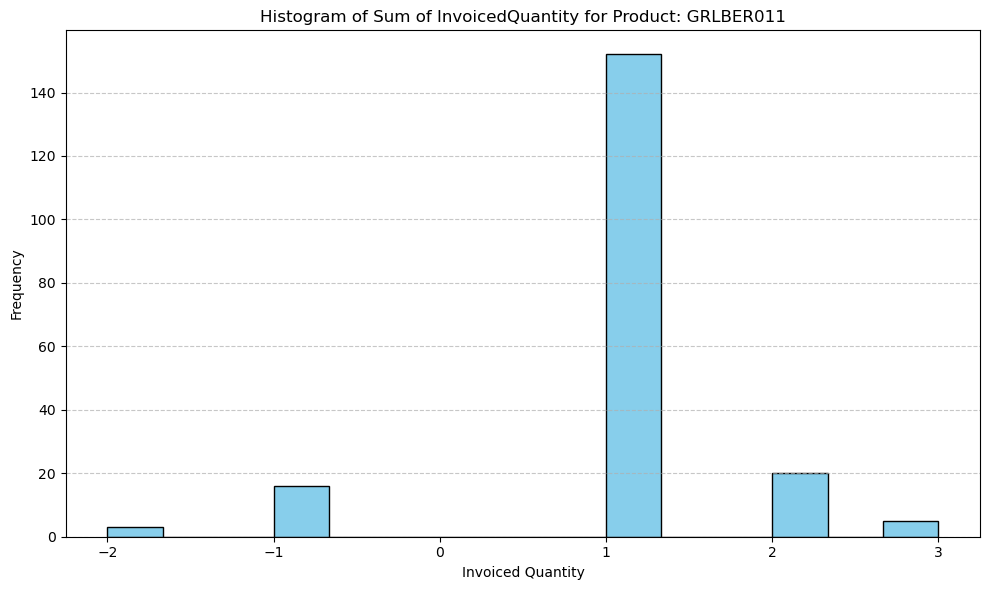

Raw data historical demand for Product: GRLBER012


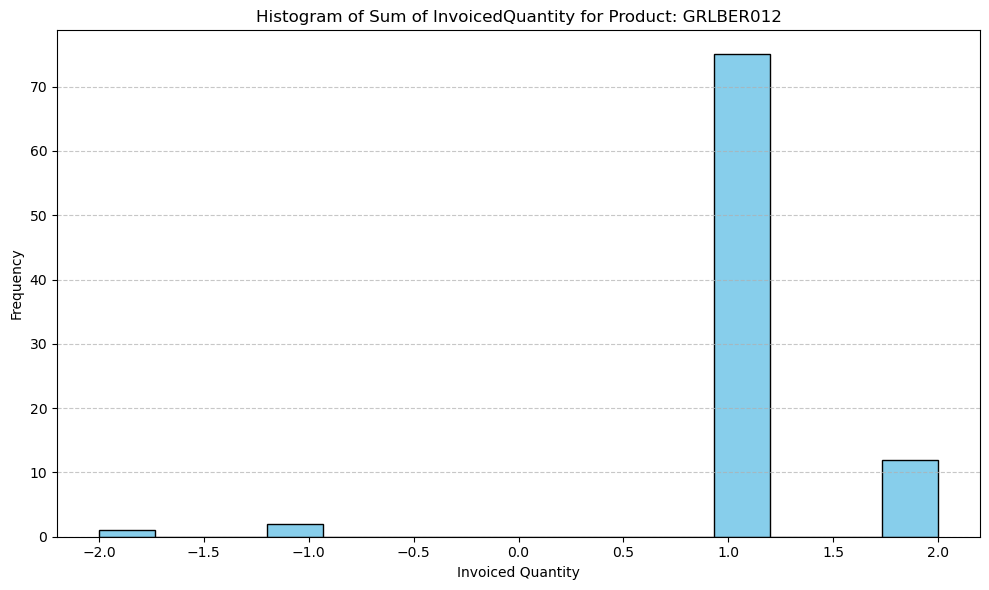

Raw data historical demand for Product: GRLBER015


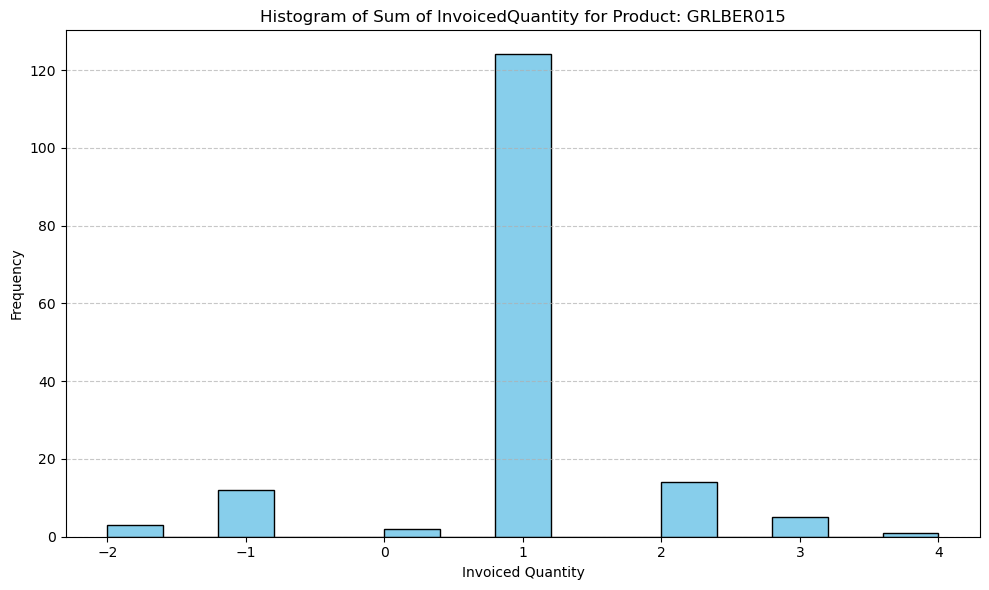

Raw data historical demand for Product: GRLBER019


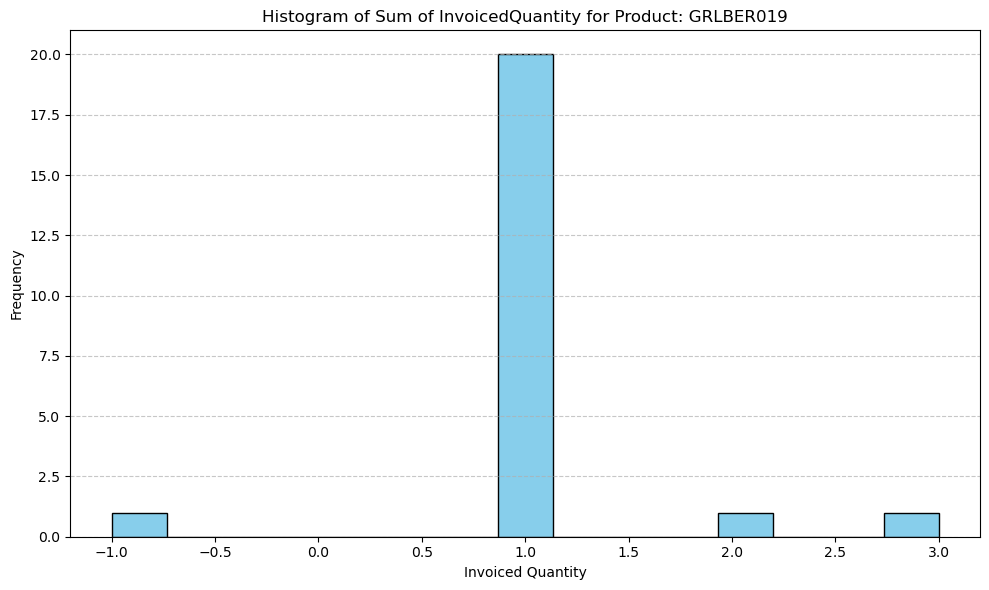

Raw data historical demand for Product: GRLBER020


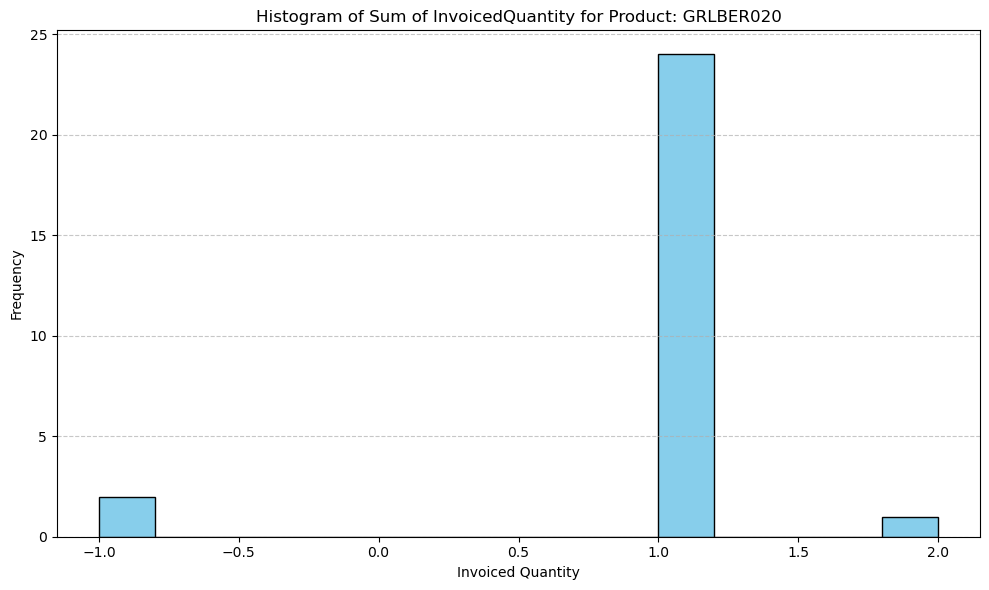

Raw data historical demand for Product: HEABER001


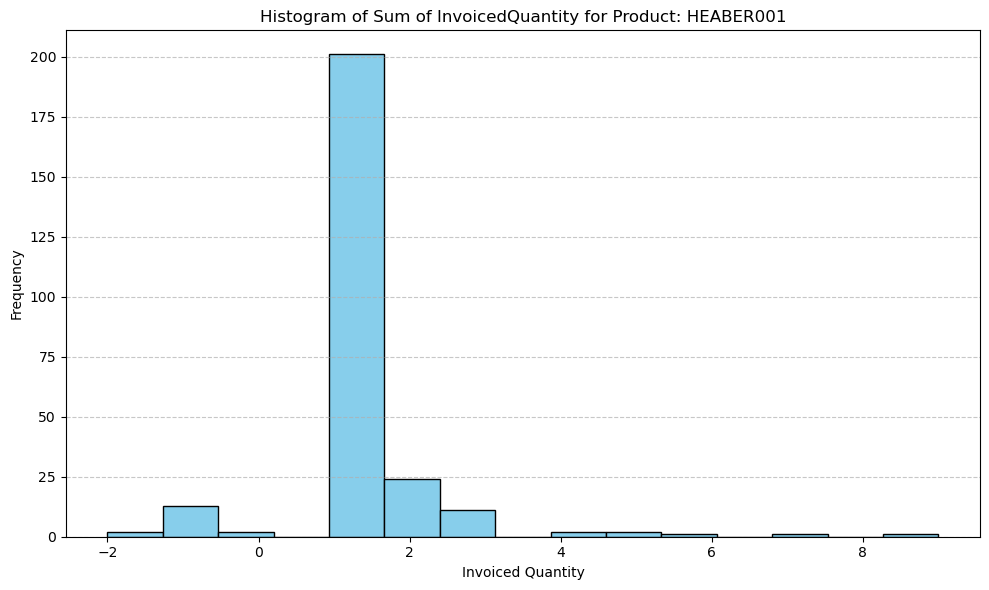

Raw data historical demand for Product: HOTBER001


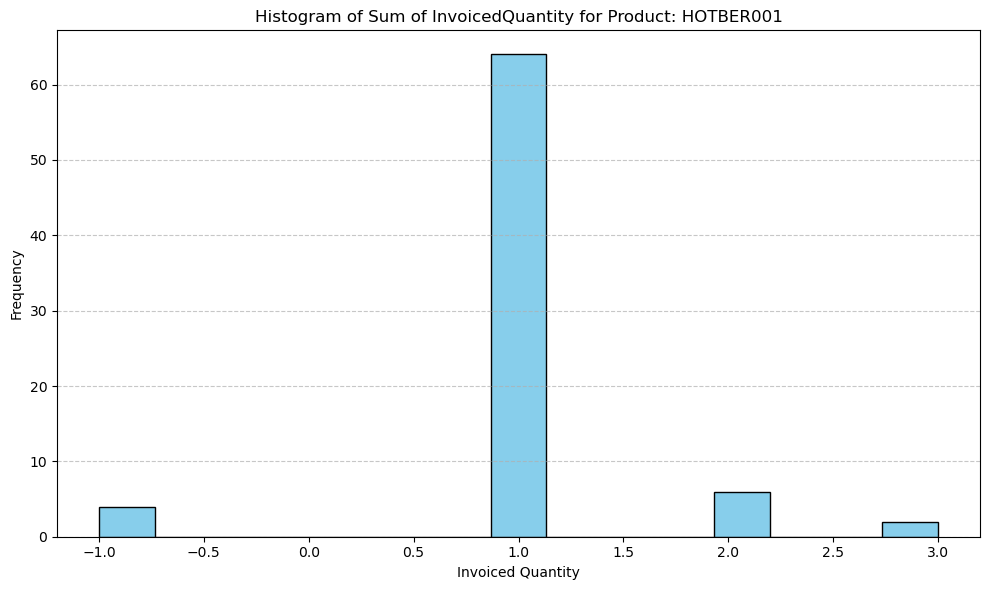

Raw data historical demand for Product: HOTBER002


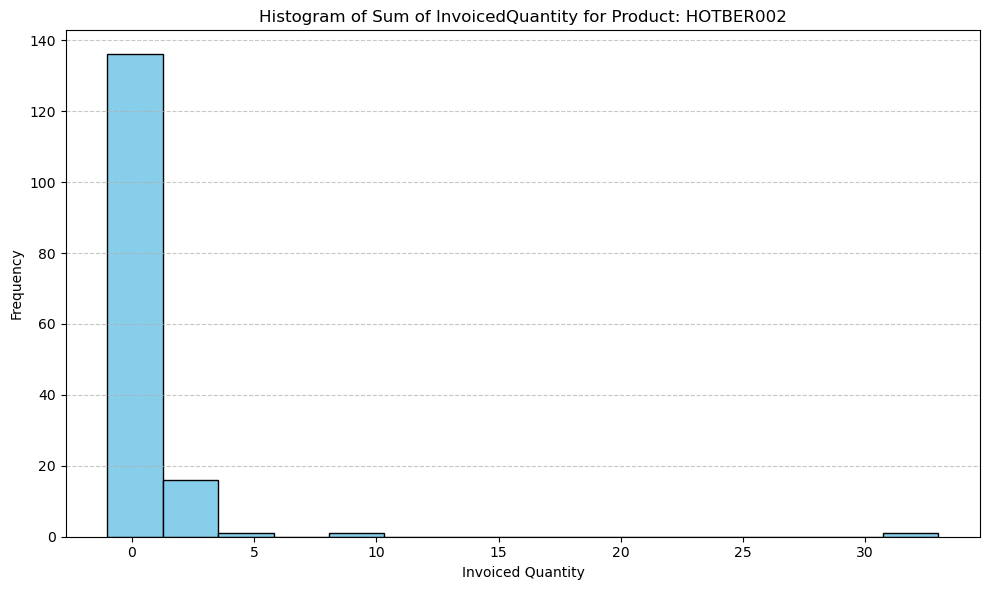

Raw data historical demand for Product: HOTBER003


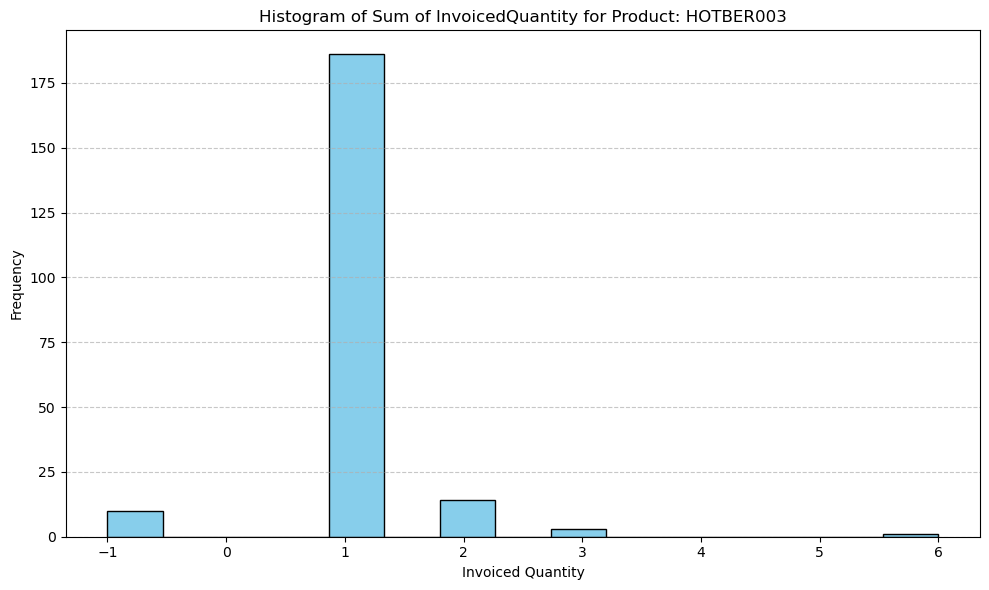

Raw data historical demand for Product: ICMBER002


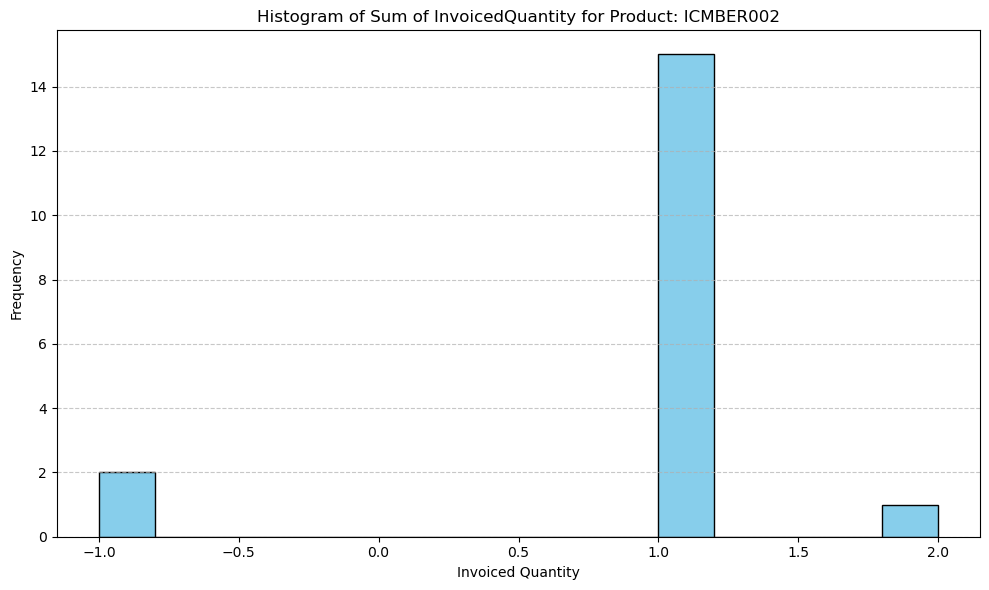

Raw data historical demand for Product: ICMBER003


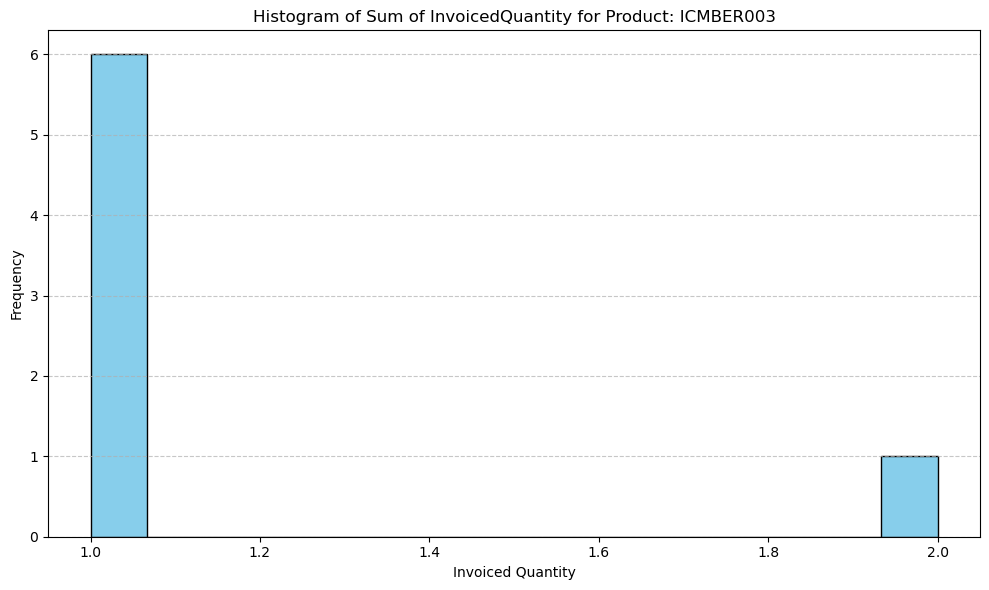

Raw data historical demand for Product: MIXBER001


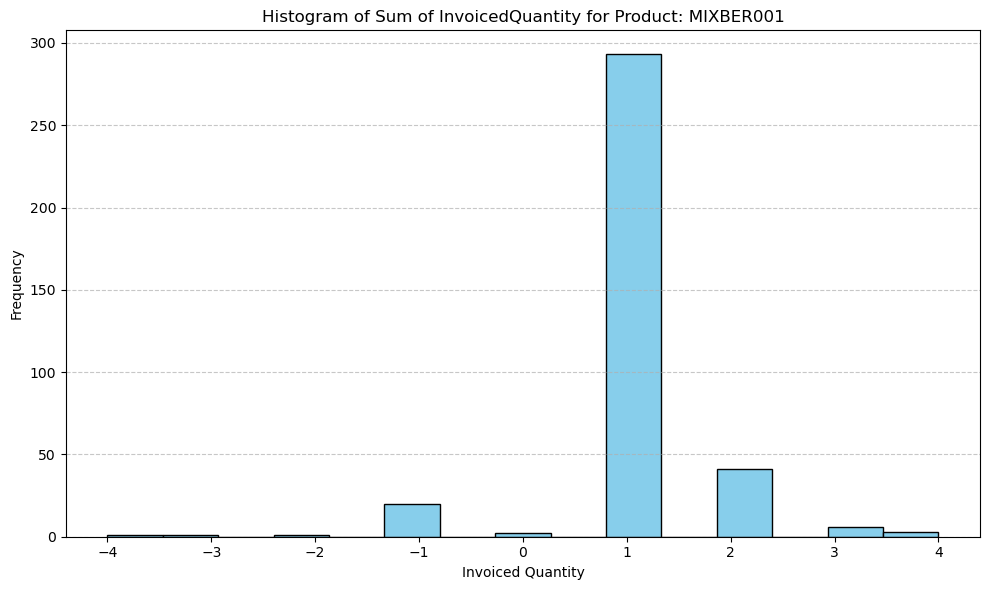

Raw data historical demand for Product: MIXBER003


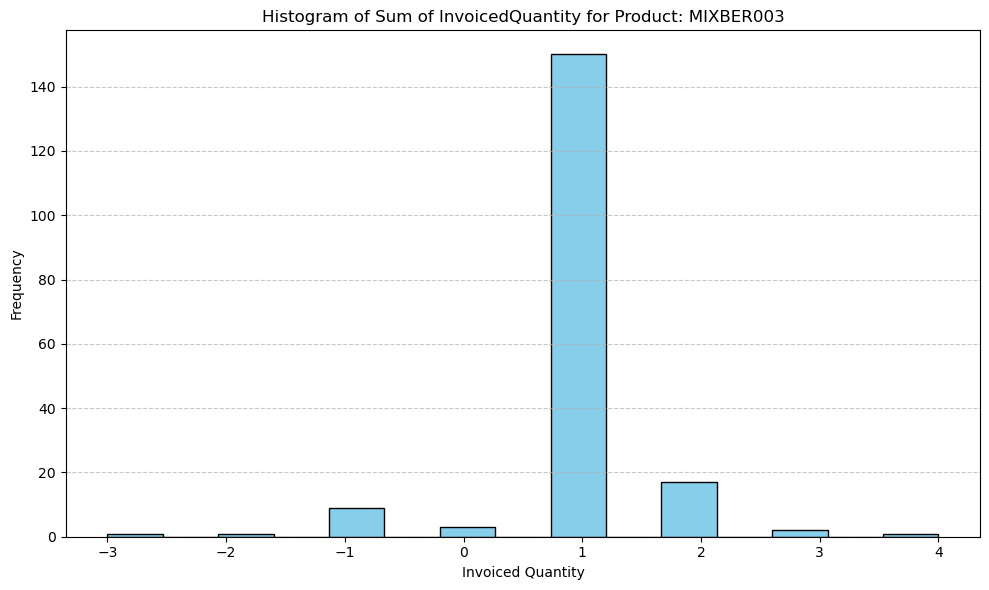

Raw data historical demand for Product: OVEBER002


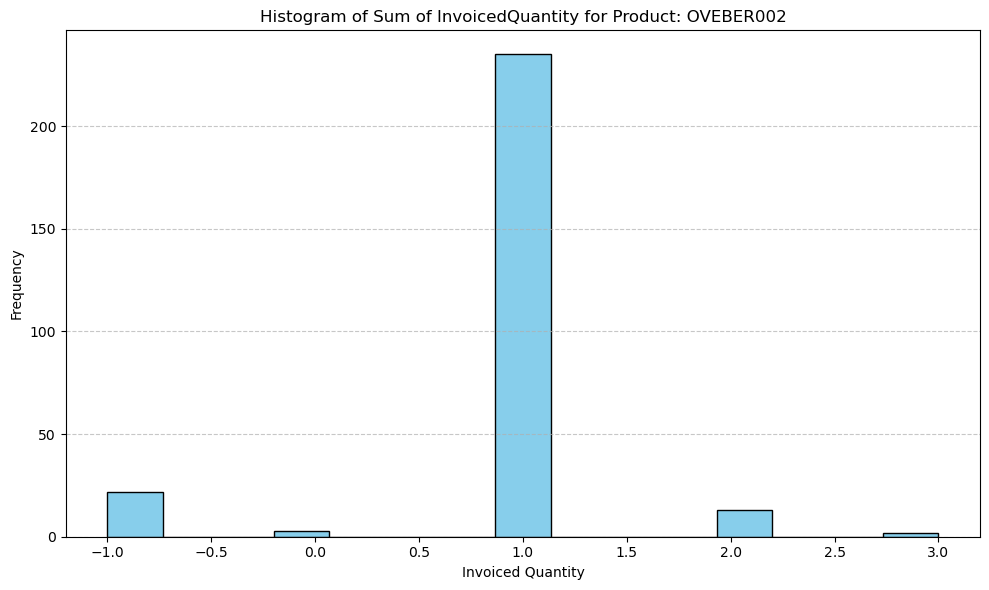

Raw data historical demand for Product: OVEBER005


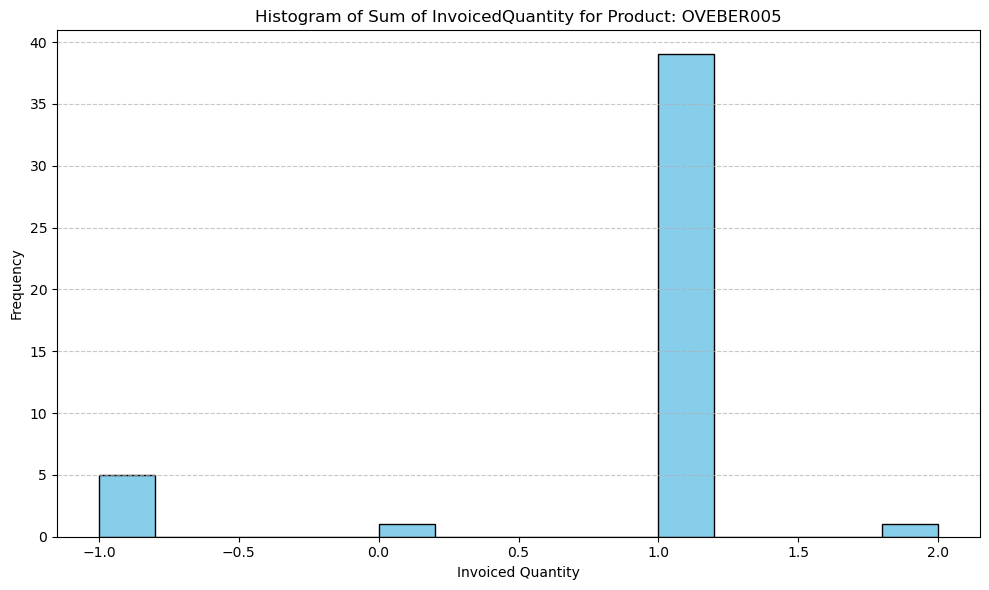

Raw data historical demand for Product: OVEBER006


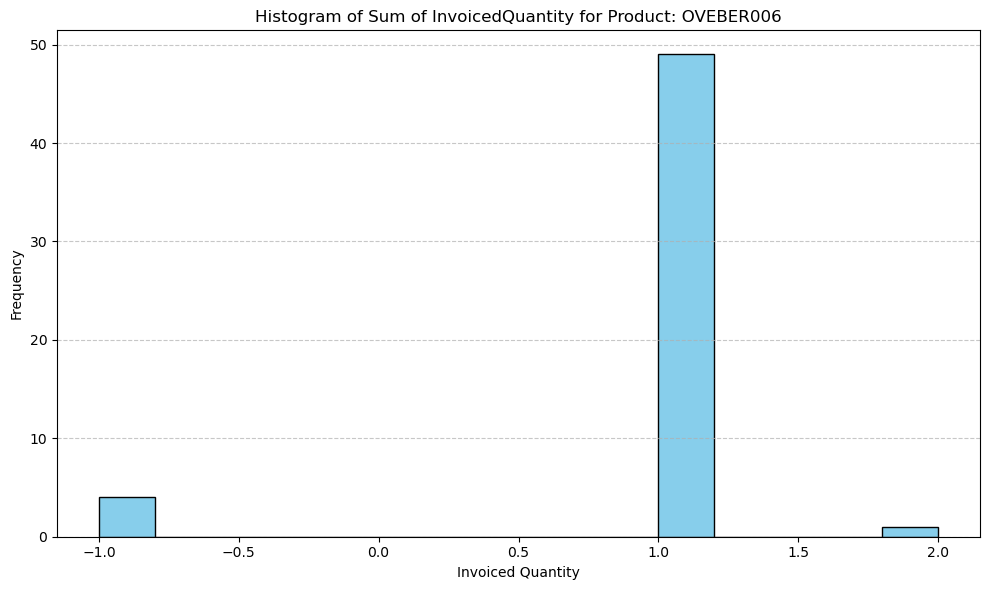

Raw data historical demand for Product: OVEBER011


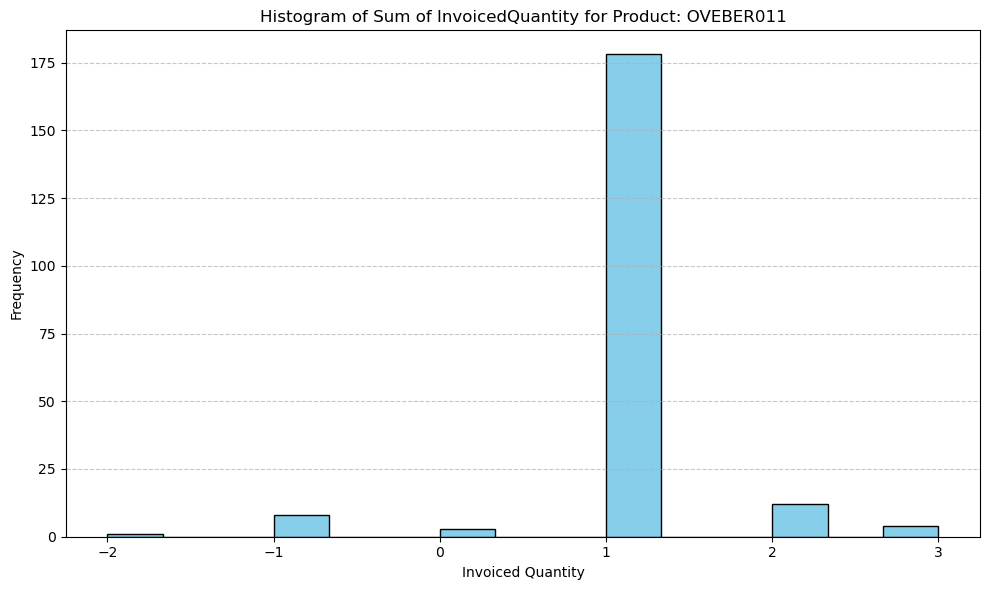

Raw data historical demand for Product: OVEBER012


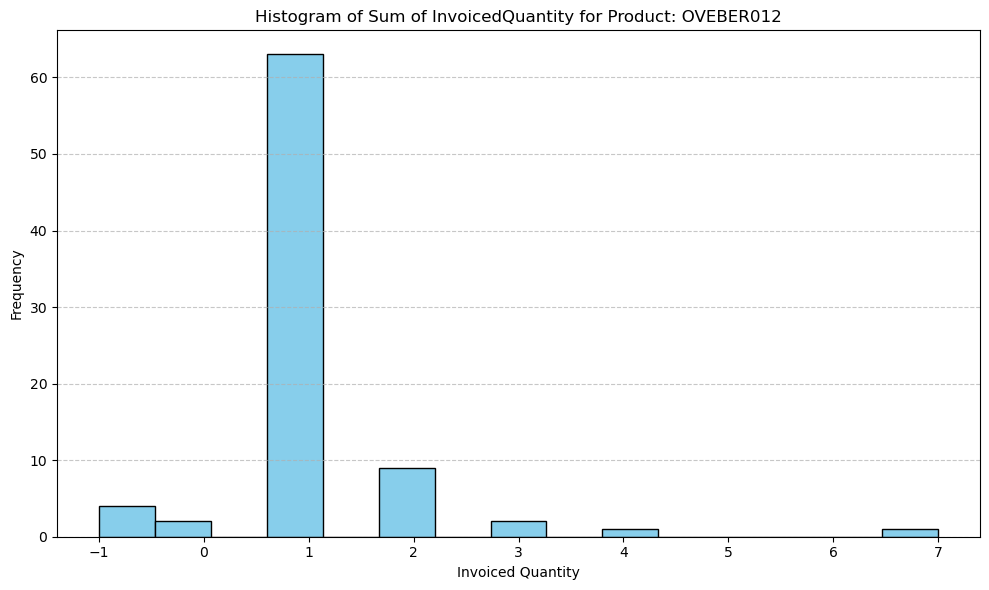

Raw data historical demand for Product: OVEBER013


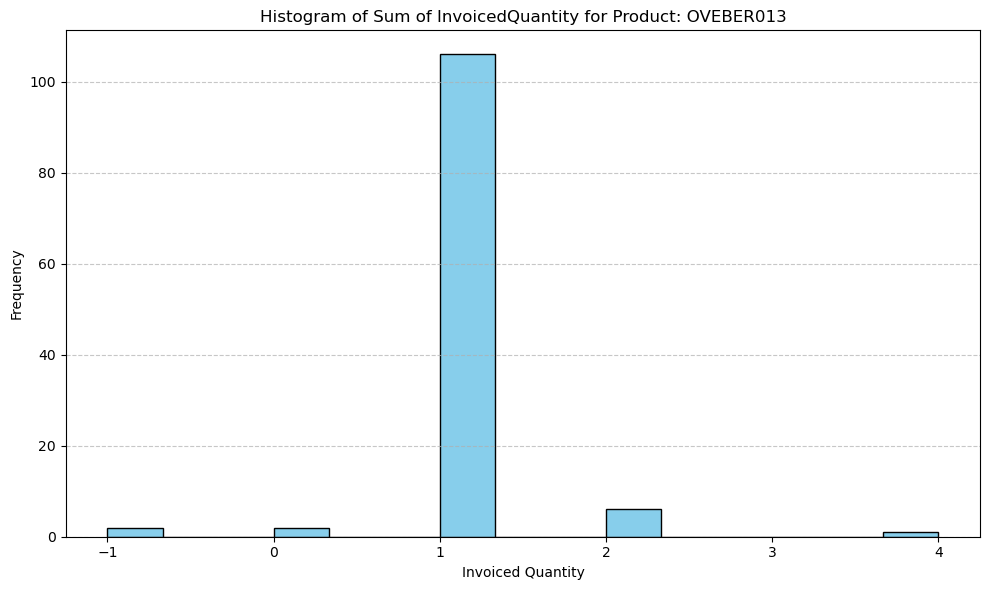

Raw data historical demand for Product: OVEBER014


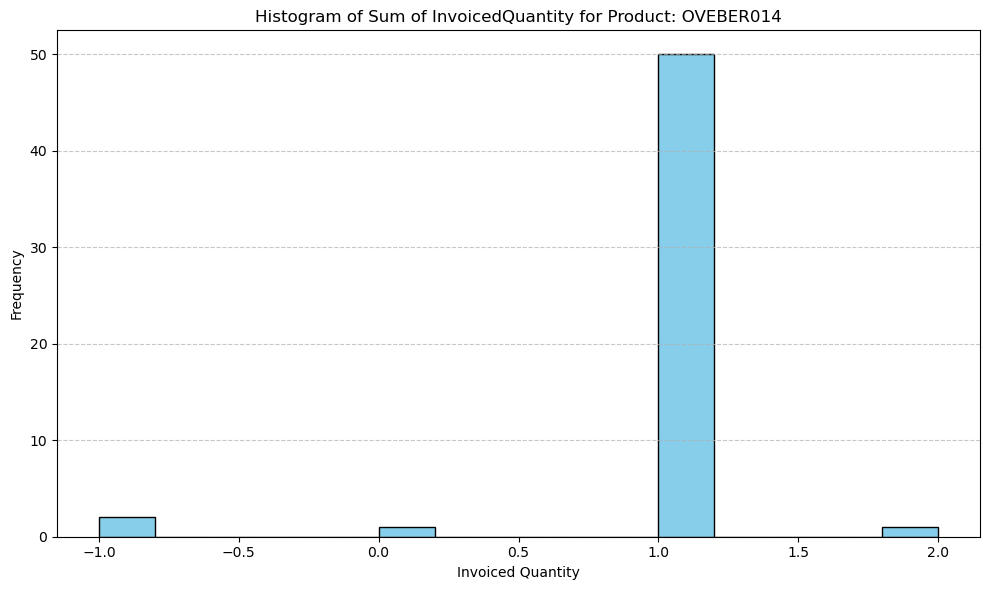

Raw data historical demand for Product: OVEBER015


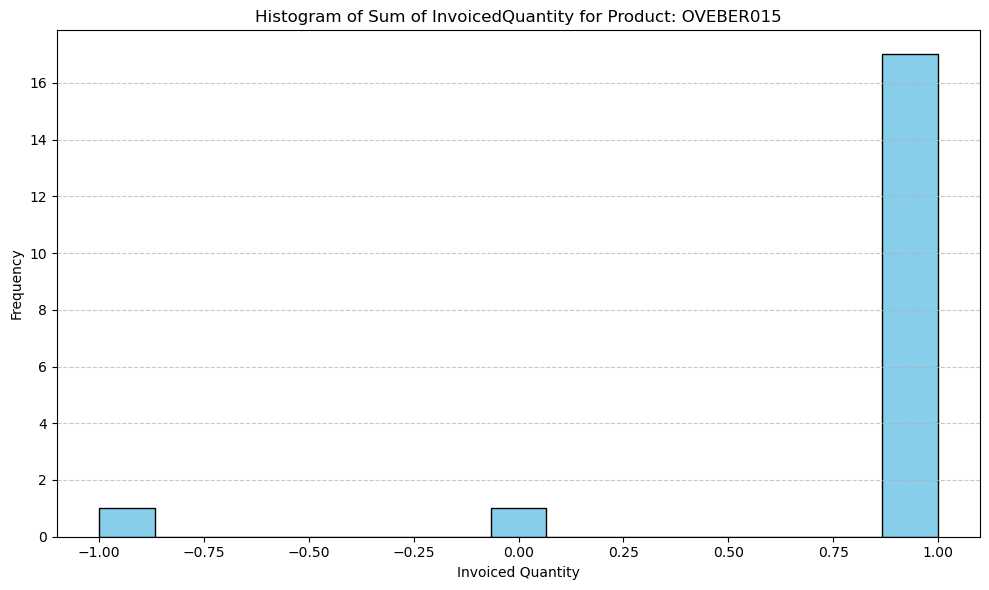

Raw data historical demand for Product: OVEBER016


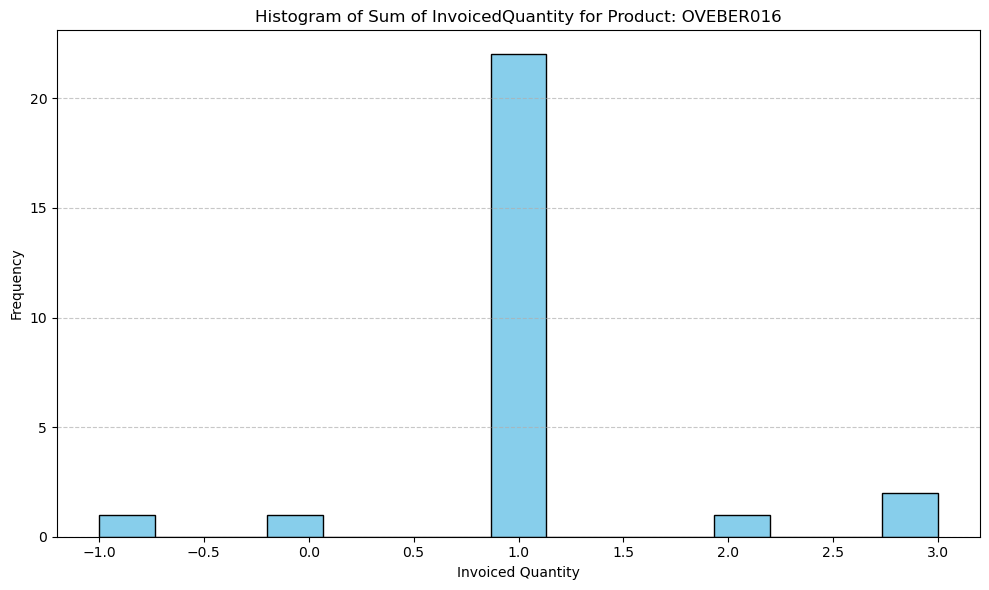

Raw data historical demand for Product: OVEBER017


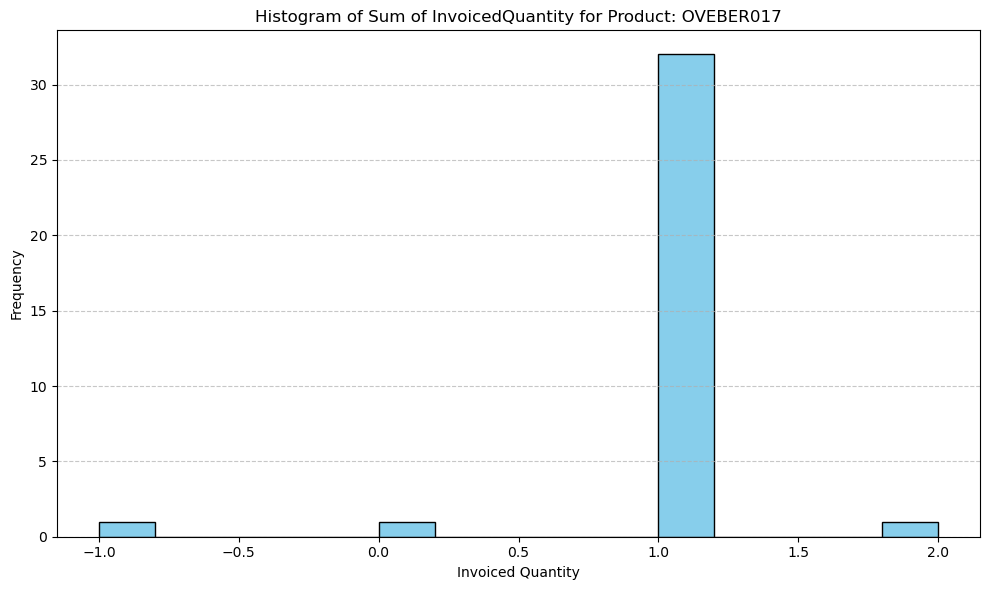

Raw data historical demand for Product: POPBER001


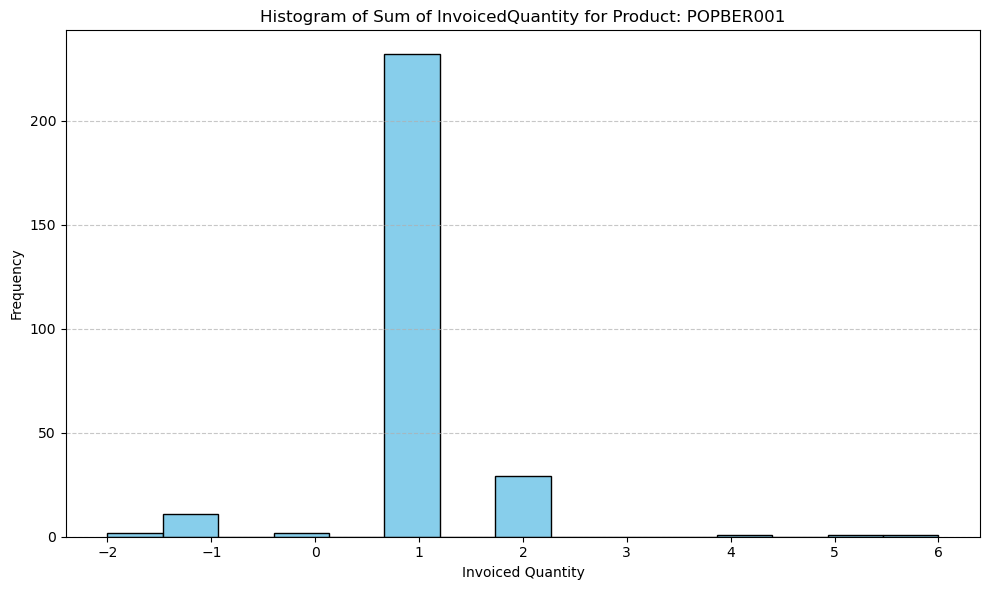

Raw data historical demand for Product: SOPBER001


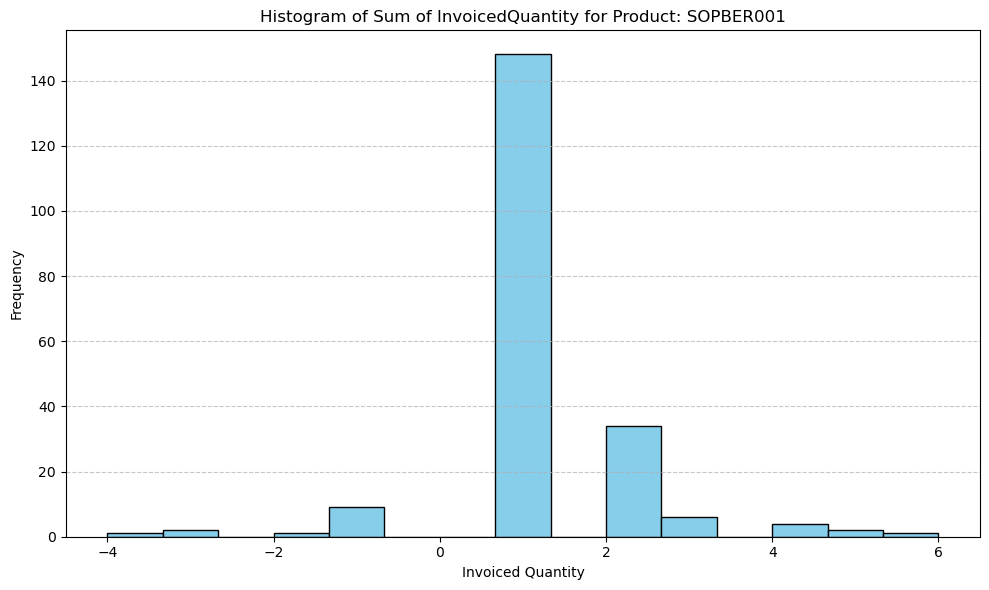

Raw data historical demand for Product: TROBER001


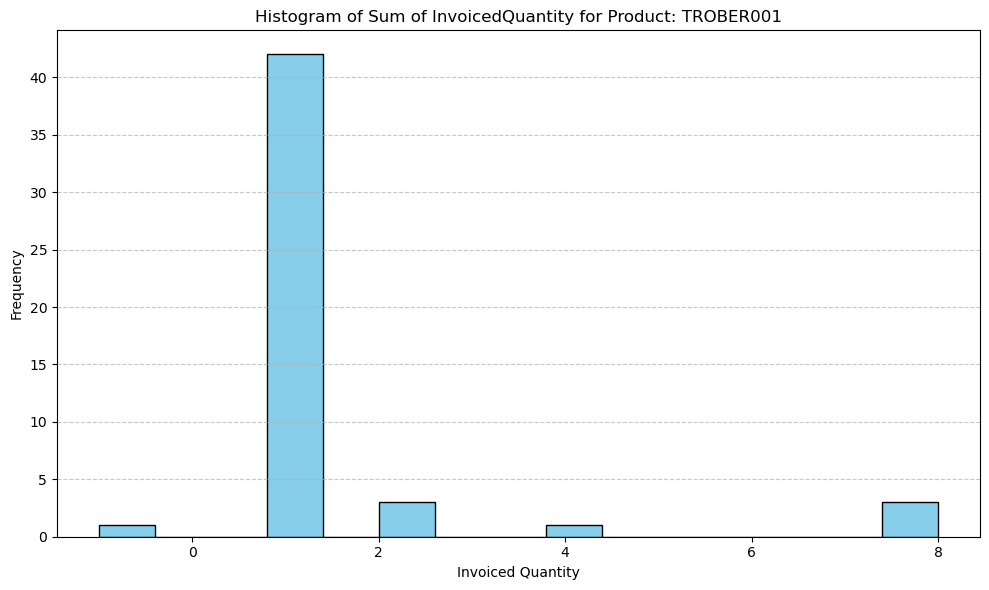

Raw data historical demand for Product: TROBER003


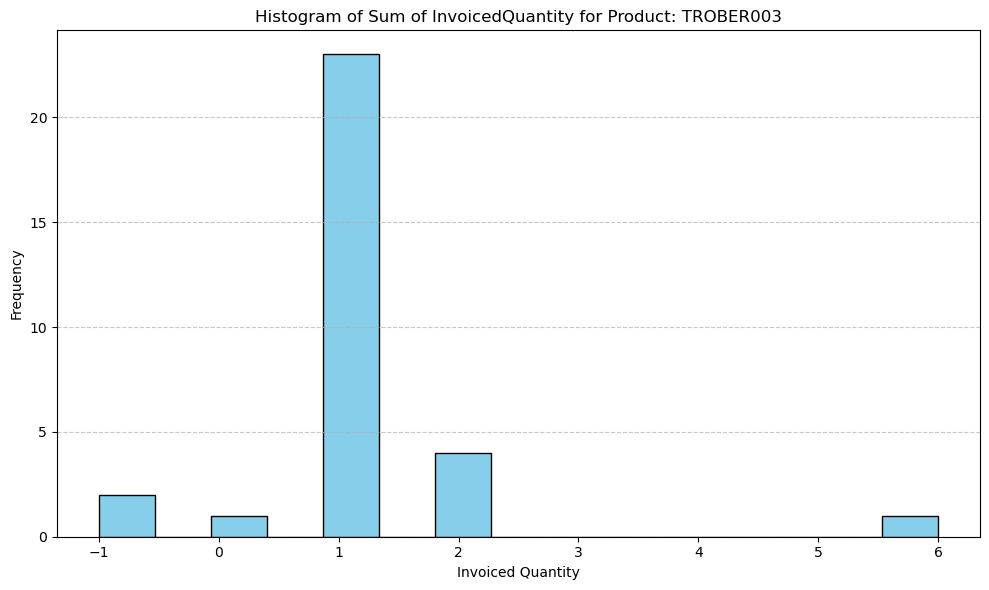

Raw data historical demand for Product: WARBER001


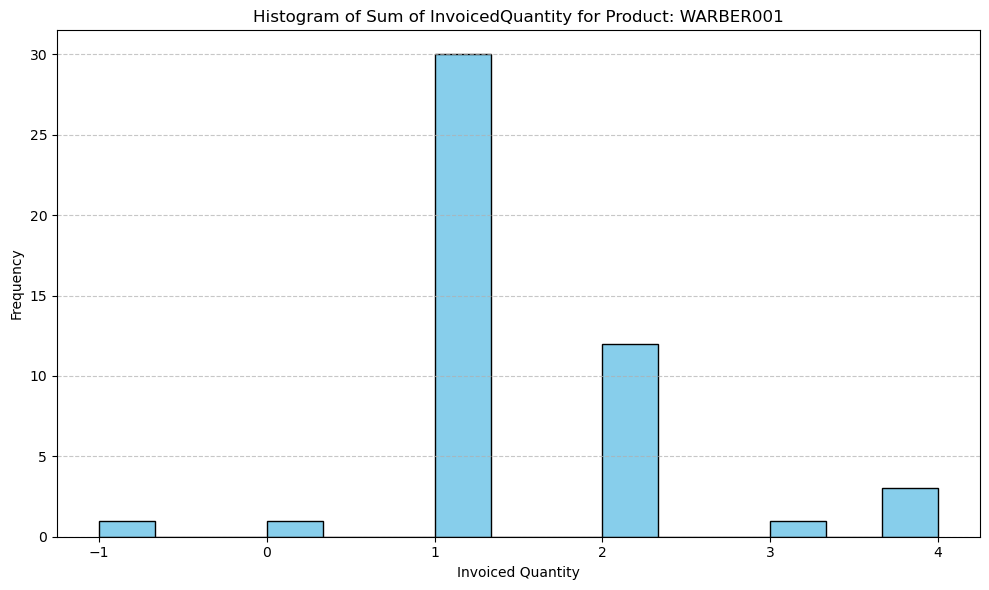

Raw data historical demand for Product: WARBER002


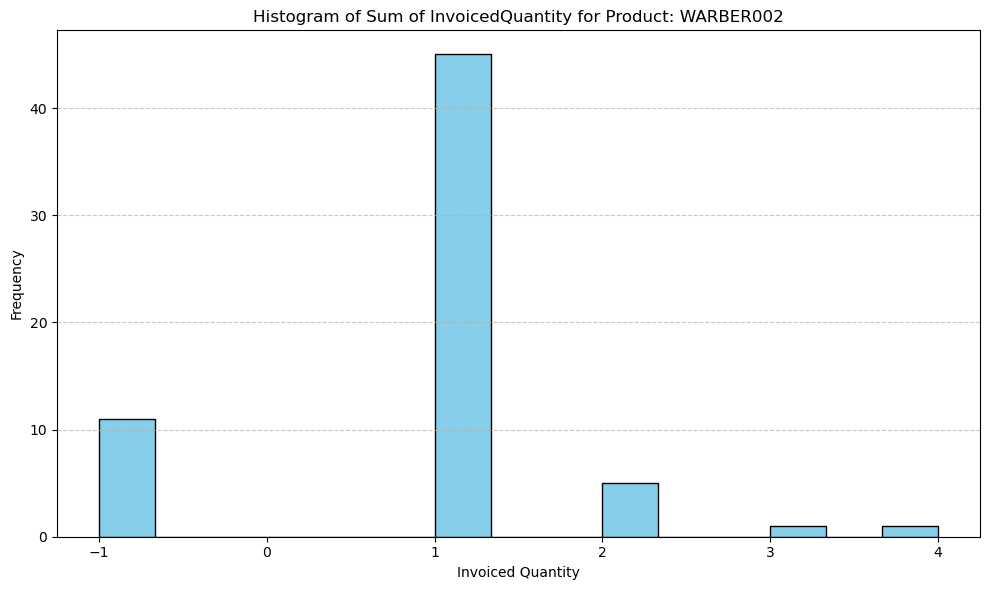

Raw data historical demand for Product: WARBER003


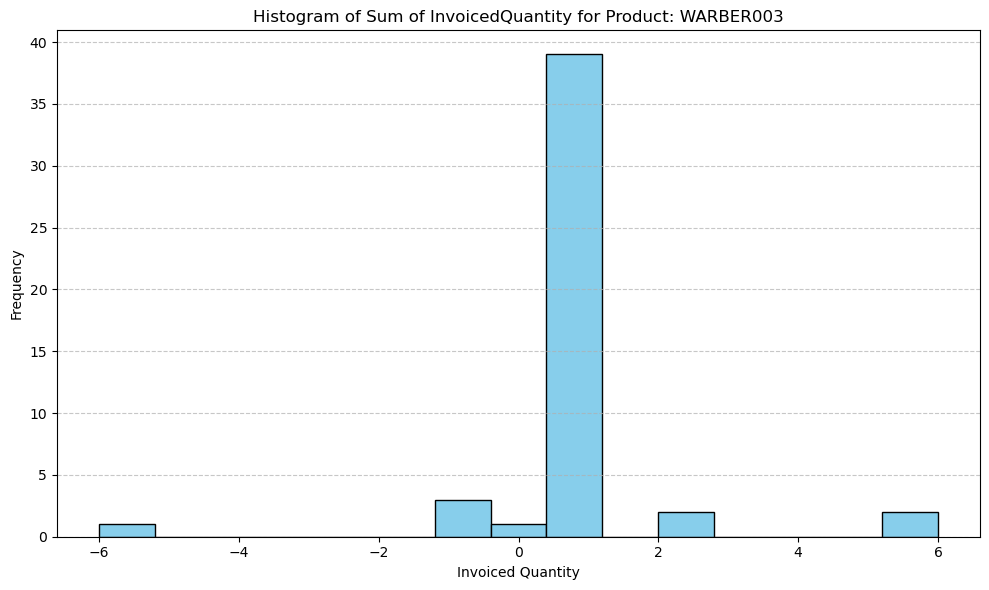

Raw data historical demand for Product: WARBER004


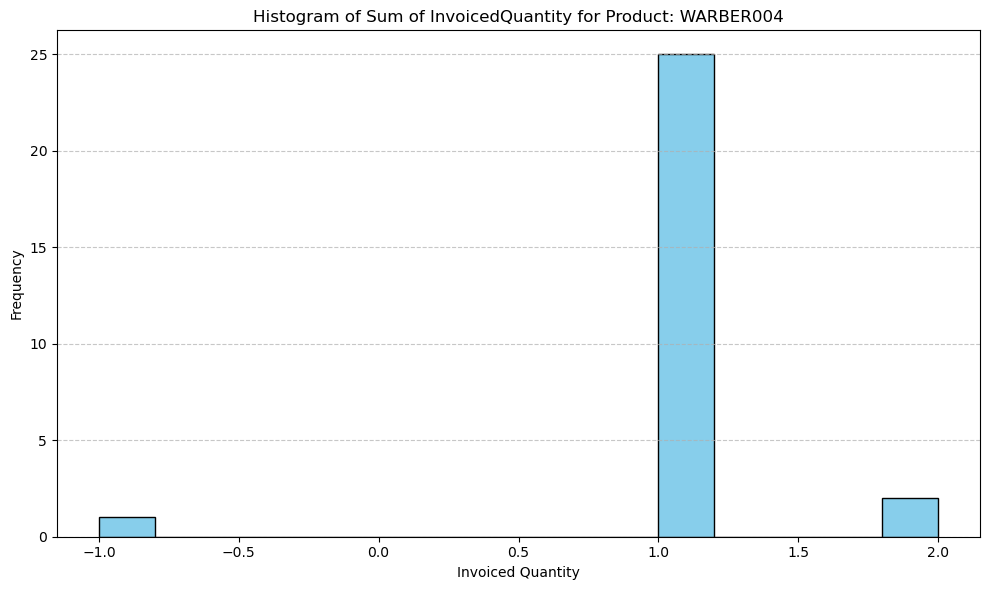

Raw data historical demand for Product: WARBER005


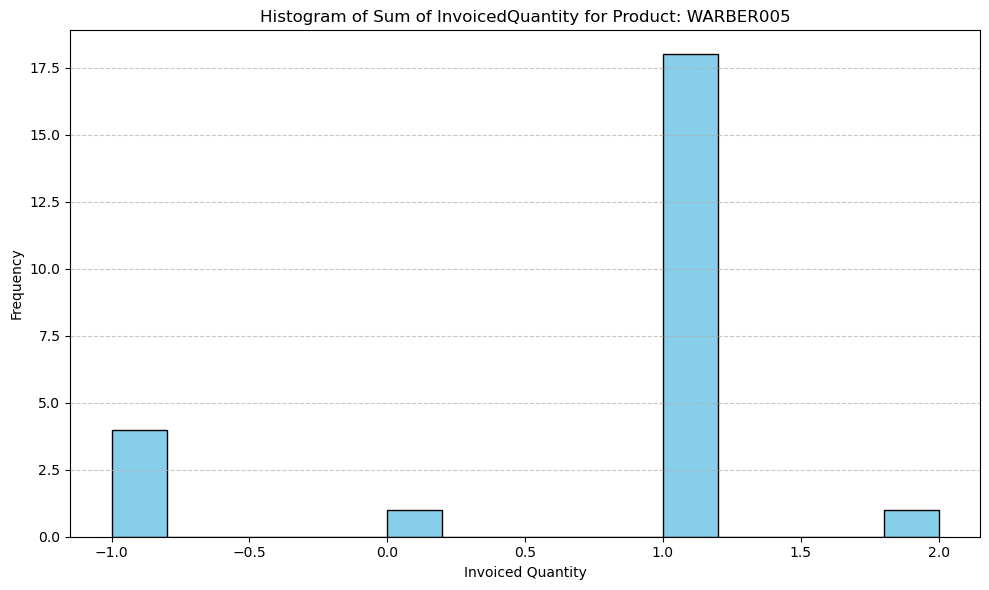

Raw data historical demand for Product: WARBER006


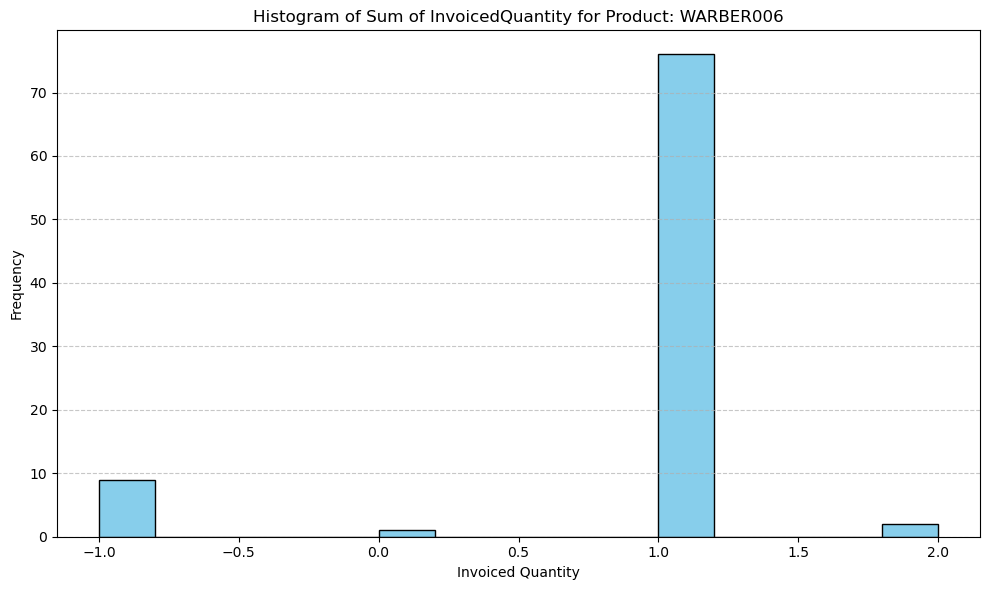

Raw data historical demand for Product: WARBER009


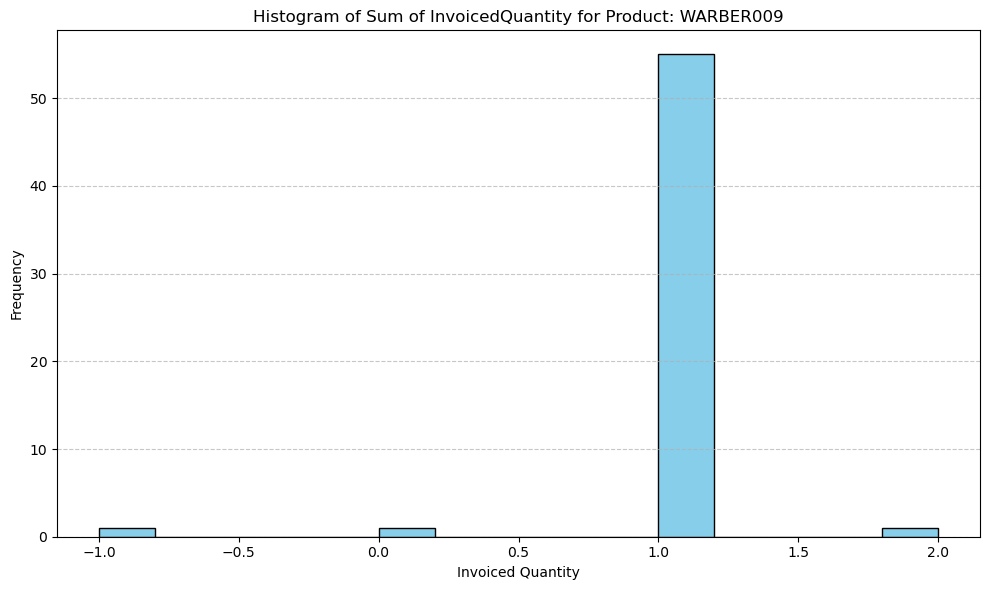

Raw data historical demand for Product: WARBER010


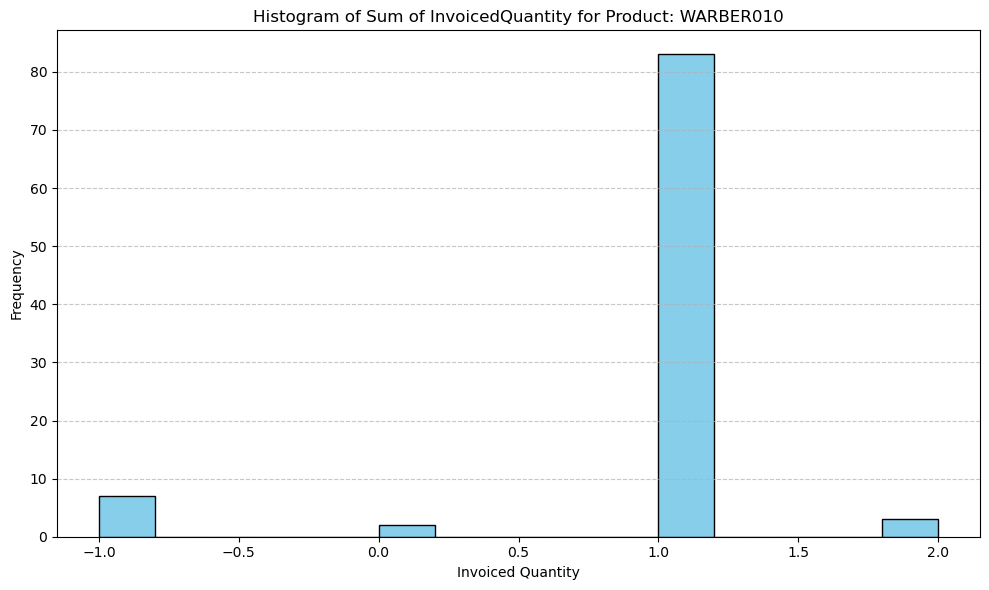

Raw data historical demand for Product: WARBER011


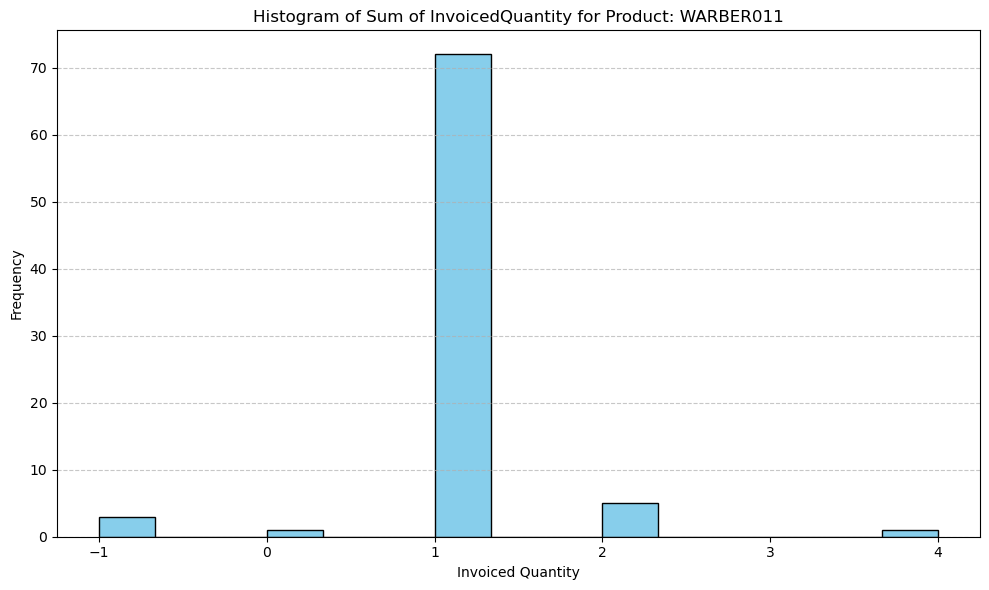

Raw data historical demand for Product: WARBER012


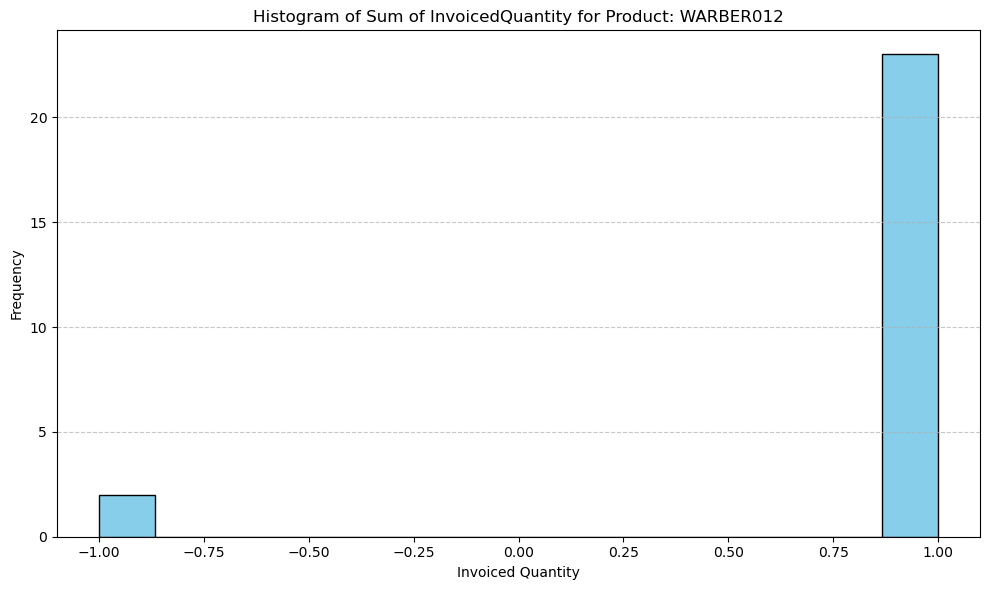

Raw data historical demand for Product: WARBER013


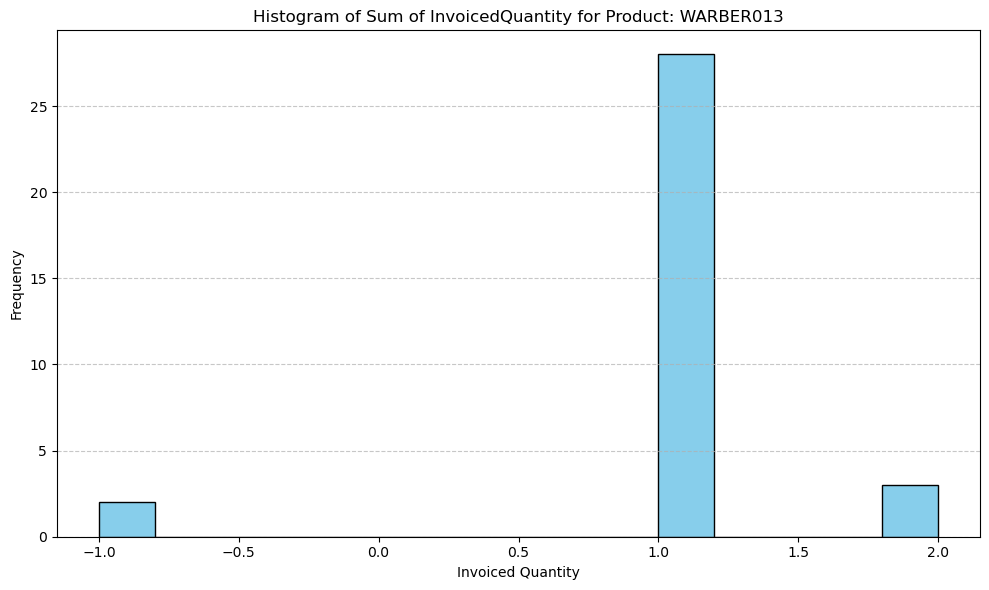

Raw data historical demand for Product: WARBER015


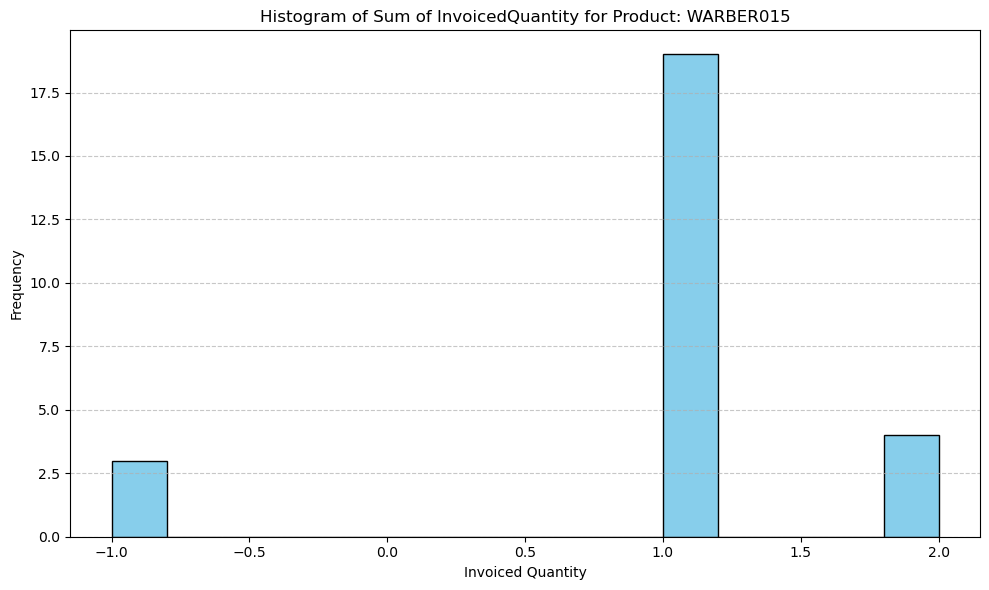

Raw data historical demand for Product: WARBER016


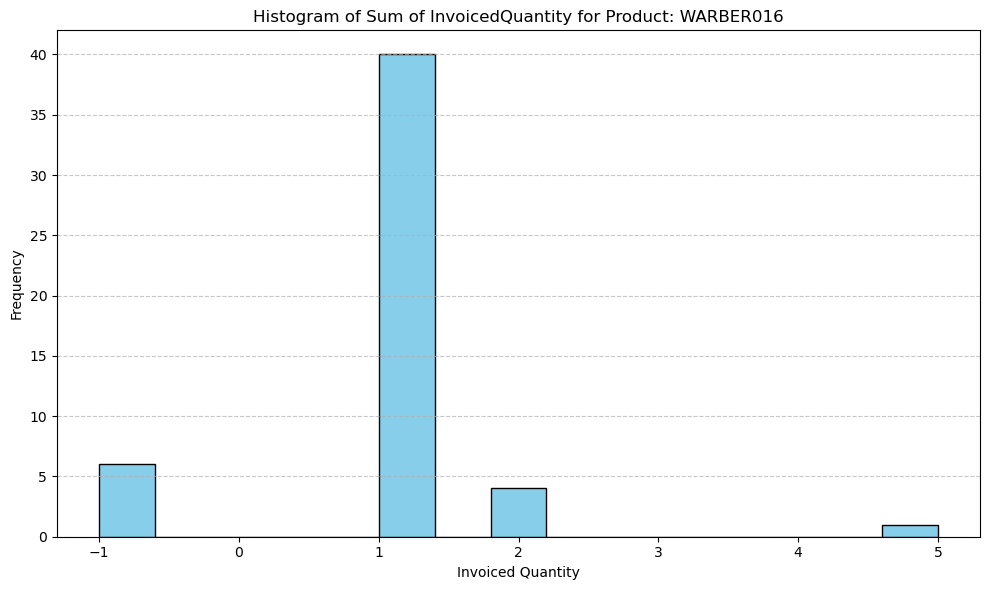

Raw data historical demand for Product: WARBER022


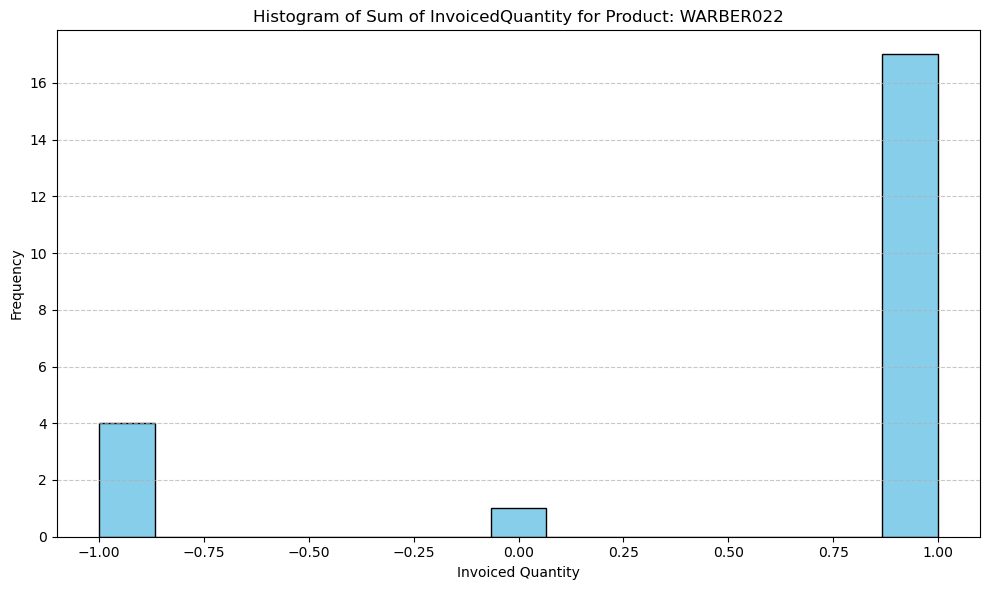

Raw data historical demand for Product: WARBER023


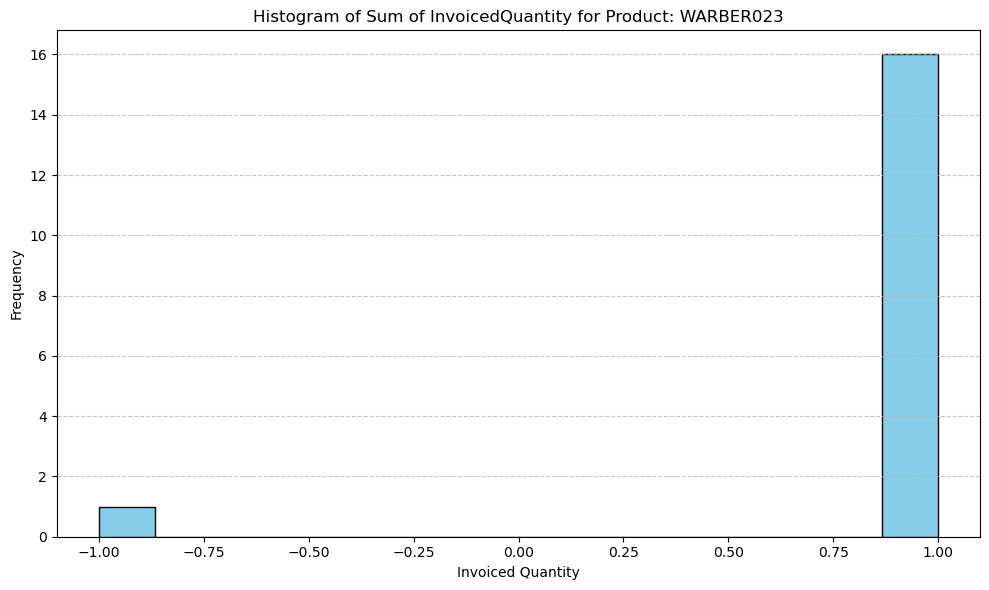

Raw data historical demand for Product: WARBER024


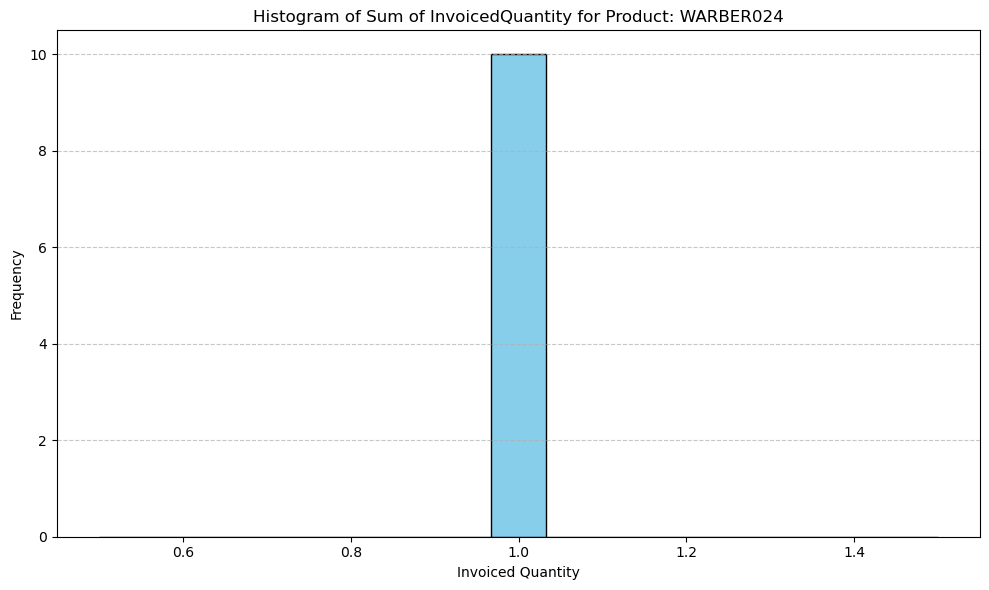

In [27]:
def raw_data_plot(ProductNumber, df):
    # Filter data for the specific product
    product_data = df[df['ProductNumber'] == ProductNumber]
    y = product_data['Sum of InvoicedQuantity']

    # Plot histogram
    plt.figure(figsize=(10, 6))
    plt.hist(y, bins=15, color='skyblue', edgecolor='black')  # Use column 'Sum of InvoicedQuantity'
        
    # Customize plot
    plt.title(f"Histogram of Sum of InvoicedQuantity for Product: {ProductNumber}")
    plt.xlabel("Invoiced Quantity")
    plt.ylabel("Frequency")
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()  # Adjust layout for better visibility

    # Show the plot
    plt.show()
    
    return product_data

# Get unique ProductNumbers
item_comb = raw_data_group[['ProductNumber']].drop_duplicates()

# Plot histogram for each product
for _, row in item_comb.iterrows():
    ProductNumber = row['ProductNumber']
    print(f"Raw data historical demand for Product: {ProductNumber}")
    raw_historical = raw_data_plot(ProductNumber, df)


## Remove Outliers ##

In [28]:
# Function to remove outliers per group (store-item combination)
def remove_outliers_grouped(df, group_cols, value_col):
    def remove_outliers(df_group):
        # Calculate IQR for the group
        Q1 = df_group[value_col].quantile(0.25)
        Q3 = df_group[value_col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
            
        # Filter out rows with higher than IQR outliers
        return df_group[((df_group[value_col] <= upper_bound) & (df_group[value_col] >= lower_bound)) |
            ((df_group[value_col] >= 1) & (df_group[value_col] <= 5)) |
            ((df_group[value_col] >= -5) & (df_group[value_col] <= -1))]
        # Filter out rows with higher than and lower than outliers in addition normal sales values between 1 and 5.

    # Apply outlier removal for each group
    df_cleaned = df.groupby(group_cols, group_keys=False).apply(remove_outliers, include_groups=False)
    return df_cleaned

# Remove outliers on a per-store, per-item basis
data_cleaned = remove_outliers_grouped(df, group_cols=['InventoryWarehouseId_dup', 'ProductNumber_dup'], value_col='Sum of InvoicedQuantity').reset_index()
data_cleaned

,index,InvoiceDate,InventoryWarehouseId,ProductNumber,Sum of InvoicedQuantity
0,200,2020-01-30,DMSQR,BOLBER001,1
1,201,2020-01-30,DMSQR,BOLBER001,2
2,454,2020-03-08,DMSQR,BOLBER001,1
3,704,2020-06-21,DMSQR,BOLBER001,1
4,1158,2020-09-26,DMSQR,BOLBER001,1
...,...,...,...,...,...
7451,4342,2022-08-11,TKSQR,WARBER023,1
7452,4659,2022-10-06,TKSQR,WARBER023,1
7453,5922,2023-07-08,TKSQR,WARBER023,1
7454,6737,2024-02-07,TKSQR,WARBER024,1


In [29]:
data_cleaned.to_csv('data_cleaned.csv', index=False)

In [30]:
# Aggregate daily sales into monthly buckets
data_cleaned['month'] = data_cleaned['InvoiceDate'].dt.to_period('M').dt.to_timestamp() + pd.offsets.MonthEnd(0)
monthly_data = data_cleaned.groupby(['ProductNumber', 'month'], as_index=False)['Sum of InvoicedQuantity'].sum()
monthly_data

,ProductNumber,month,Sum of InvoicedQuantity
0,BOLBER001,2020-01-31,5
1,BOLBER001,2020-02-29,0
2,BOLBER001,2020-03-31,4
3,BOLBER001,2020-06-30,10
4,BOLBER001,2020-07-31,2
...,...,...,...
1959,WARBER024,2023-01-31,1
1960,WARBER024,2023-02-28,2
1961,WARBER024,2023-03-31,1
1962,WARBER024,2024-02-29,1


In [31]:
monthly_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1964 entries, 0 to 1963
Data columns (total 3 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   ProductNumber            1964 non-null   object        
 1   month                    1964 non-null   datetime64[ns]
 2   Sum of InvoicedQuantity  1964 non-null   int64         
dtypes: datetime64[ns](1), int64(1), object(1)
memory usage: 46.2+ KB


In [32]:
monthly_data.to_csv('monthly_data.csv', index=False)

## Generate a complete date range for time series analysis

In [33]:
# Fill missing months in historical demand data up to a specified end date with 0 sales.
def fill_missing_months(data):

    # Ensure 'month' is in datetime format
    data['month'] = pd.to_datetime(data['month'])
    
    # Find the start date (earliest month in the data)
    start_date = data['month'].min()
    end_date = data['month'].max()
    
    # Generate a complete range of months
    all_months = pd.date_range(start=start_date, end=end_date, freq='ME')
    
    # Get all unique store-item combinations
    Unique_item = data[['ProductNumber']].drop_duplicates()
    
    # Create a cartesian product of all store-item combinations with the complete month range
    full_index = pd.MultiIndex.from_product(
        [Unique_item['ProductNumber'], 
         all_months],
        names=['ProductNumber', 'month']
    )
    
    # Create a full DataFrame from the cartesian product
    full_data = pd.DataFrame(index=full_index).reset_index()
    
    # Merge the original data with the full DataFrame
    data_filled = pd.merge(full_data, data, on=['ProductNumber', 'month'], how='left')
    
    # Fill missing sales with 0
    data_filled['Sum of InvoicedQuantity'] = data_filled['Sum of InvoicedQuantity'].fillna(0)
    
    return data_filled

# Fill missing months up to 30/11/2024
data_filled = fill_missing_months(monthly_data)

# Remove any potential duplicates introduced during merging
data_filled = data_filled.drop_duplicates(subset=['ProductNumber', 'month'])

In [34]:
data_filled

,ProductNumber,month,Sum of InvoicedQuantity
0,BOLBER001,2020-01-31,5.0
1,BOLBER001,2020-02-29,0.0
2,BOLBER001,2020-03-31,4.0
3,BOLBER001,2020-04-30,0.0
4,BOLBER001,2020-05-31,0.0
...,...,...,...
3655,WARBER024,2024-08-31,0.0
3656,WARBER024,2024-09-30,0.0
3657,WARBER024,2024-10-31,1.0
3658,WARBER024,2024-11-30,0.0


In [35]:
data_filled.to_csv('data_filled.csv', index=False)

## Explore the monthly sales historical data as pivot table

In [36]:
Pivot_table = pd.pivot_table(monthly_data, values='Sum of InvoicedQuantity', index='ProductNumber',
                       columns=['month'], aggfunc="sum", fill_value=0)
Pivot_table

month,2020-01-31,2020-02-29,2020-03-31,2020-04-30,2020-05-31,2020-06-30,2020-07-31,2020-08-31,2020-09-30,2020-10-31,...,2024-03-31,2024-04-30,2024-05-31,2024-06-30,2024-07-31,2024-08-31,2024-09-30,2024-10-31,2024-11-30,2024-12-31
ProductNumber,,,,,,,,,,,,,,,,,,,,,
BOLBER001,5,0,4,0,0,10,2,2,6,4,...,0,0,0,0,0,0,0,0,0,0
BOLBER002,5,11,7,2,5,10,2,3,3,0,...,1,0,0,0,0,0,0,0,0,0
BOLBER003,1,0,4,-1,1,2,0,6,1,2,...,0,4,0,0,0,1,1,1,0,0
BOLBER005,0,2,1,0,0,1,0,2,0,0,...,0,0,0,0,0,0,0,1,1,0
BURBER001,0,0,2,0,1,4,0,2,0,1,...,1,0,0,0,0,1,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
WARBER015,2,0,2,0,0,0,0,0,0,0,...,1,0,0,0,0,1,2,0,0,0
WARBER016,2,2,0,0,0,0,1,0,0,2,...,0,1,0,0,0,0,0,0,0,0
WARBER022,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [37]:
Pivot_table.to_csv('Pivot_table-monthly_data.csv', index=True) 

Historical demand for Item: BOLBER001


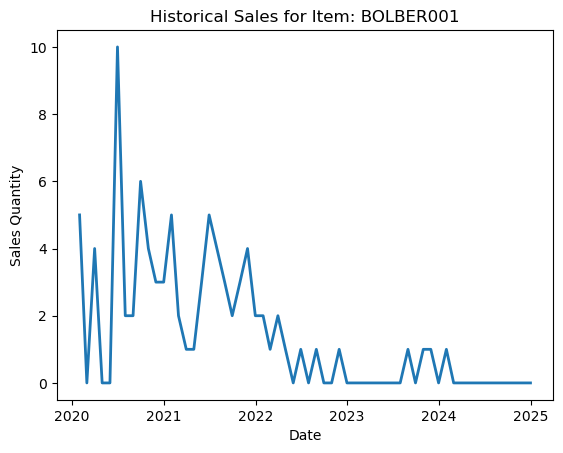

Historical demand for Item: BOLBER002


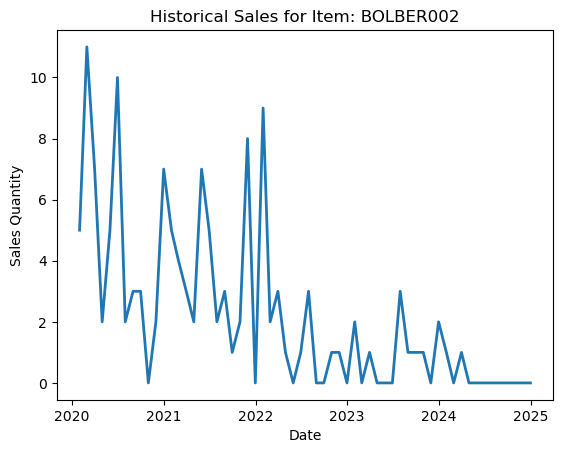

Historical demand for Item: BOLBER003


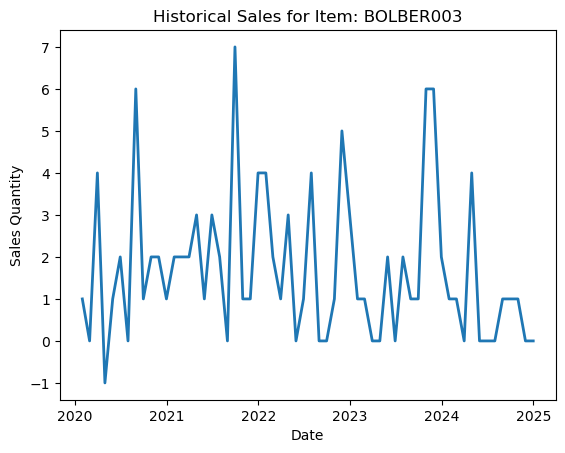

Historical demand for Item: BOLBER005


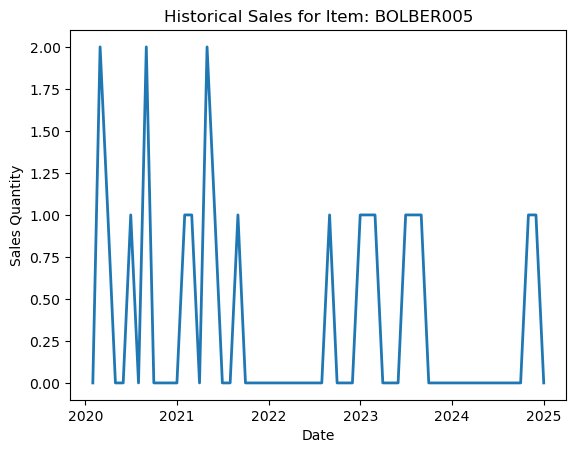

Historical demand for Item: BURBER001


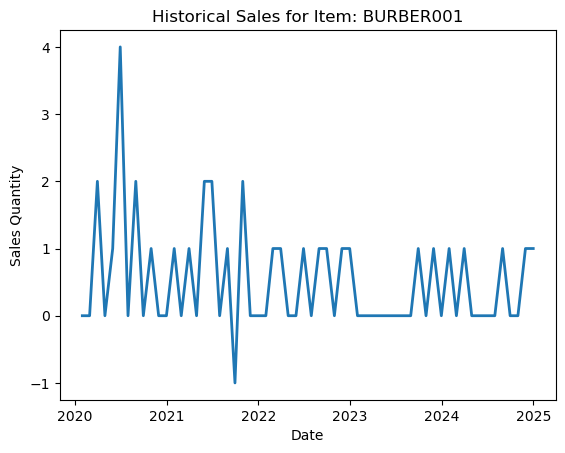

Historical demand for Item: BURBER002


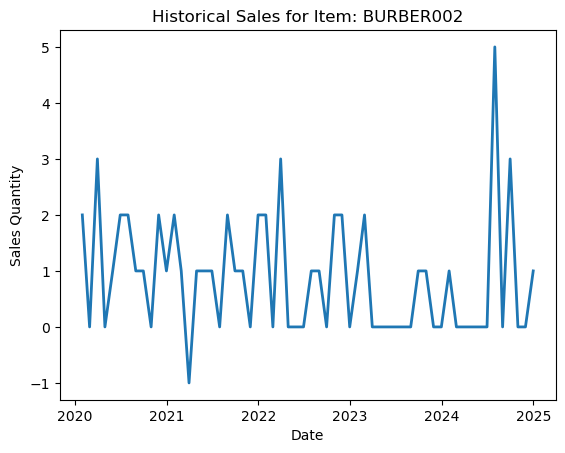

Historical demand for Item: BURBER003


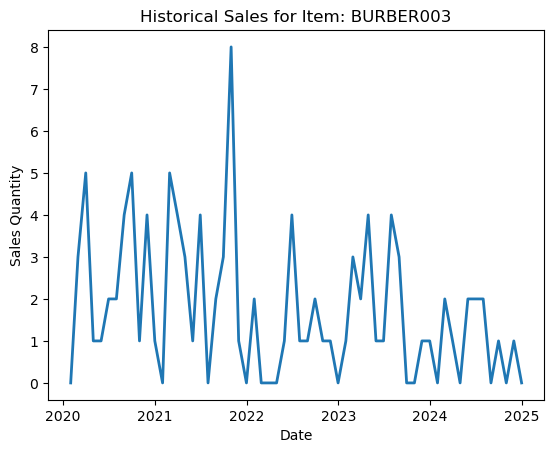

Historical demand for Item: BURBER004


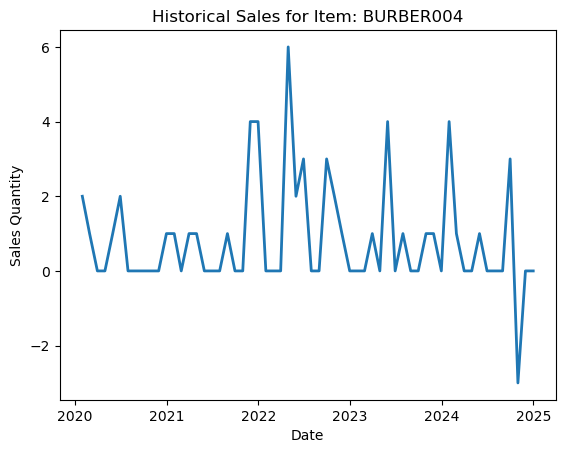

Historical demand for Item: BURBER007


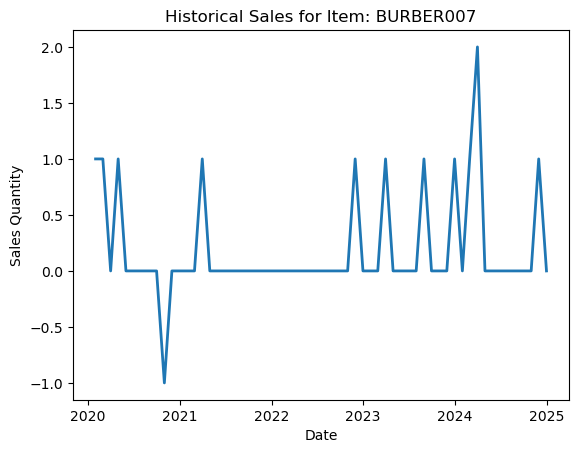

Historical demand for Item: COFBER001


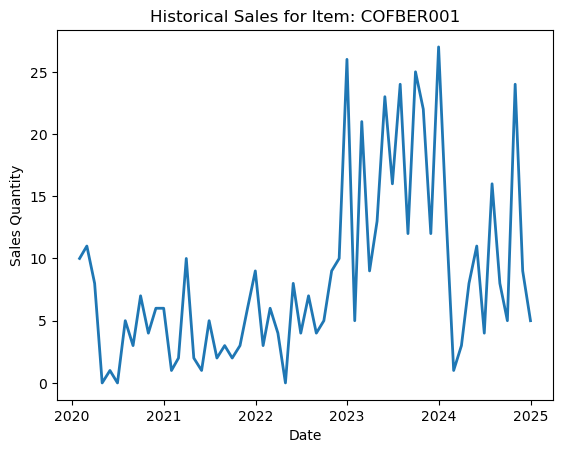

Historical demand for Item: COKBER001


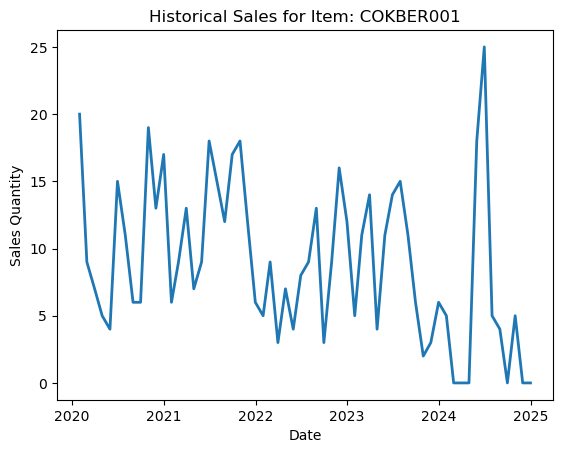

Historical demand for Item: FRYBER002


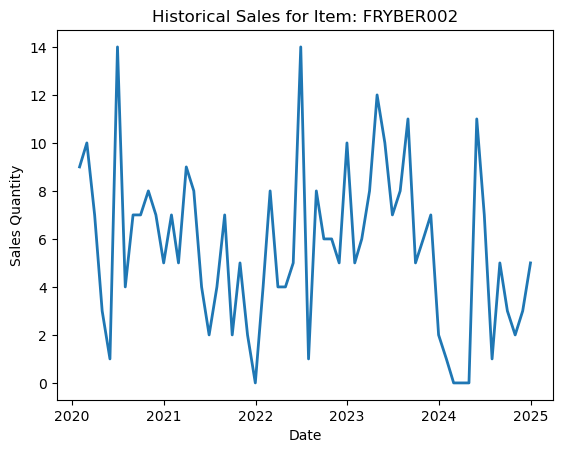

Historical demand for Item: FRYBER003


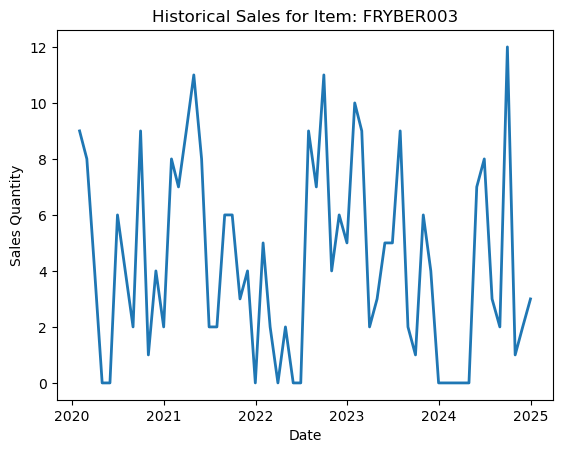

Historical demand for Item: FRYBER005


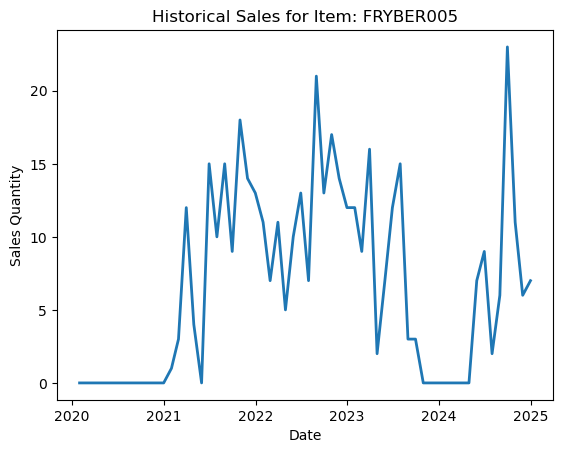

Historical demand for Item: GRLBER003


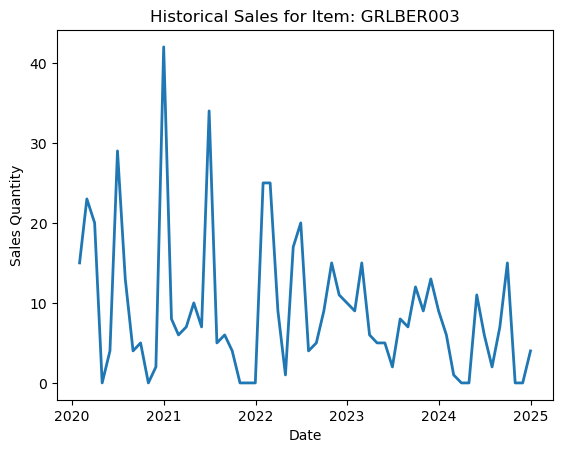

Historical demand for Item: GRLBER004


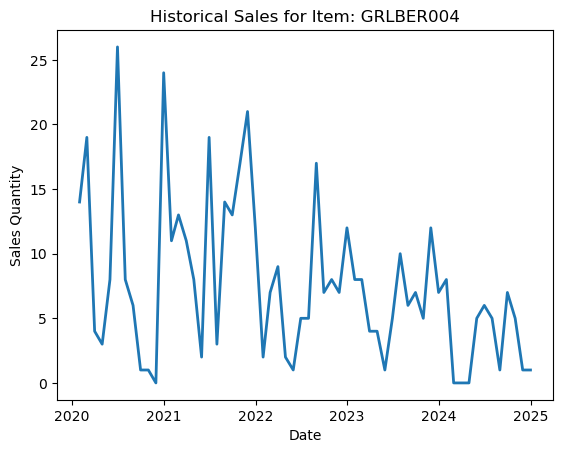

Historical demand for Item: GRLBER009


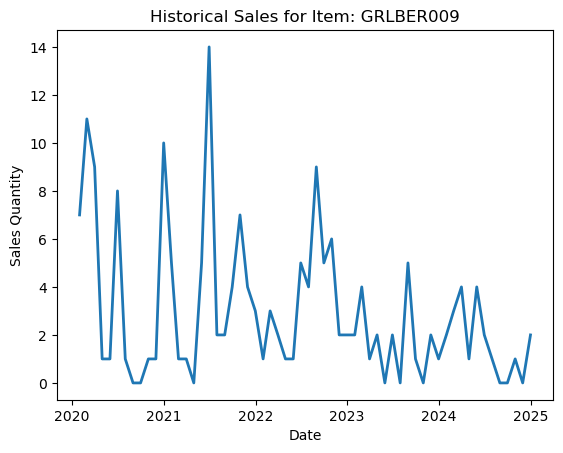

Historical demand for Item: GRLBER010


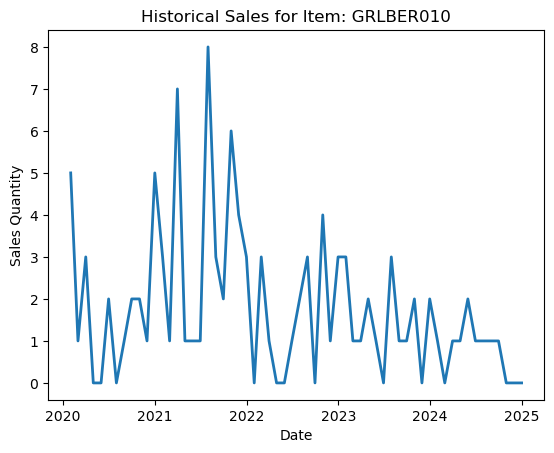

Historical demand for Item: GRLBER011


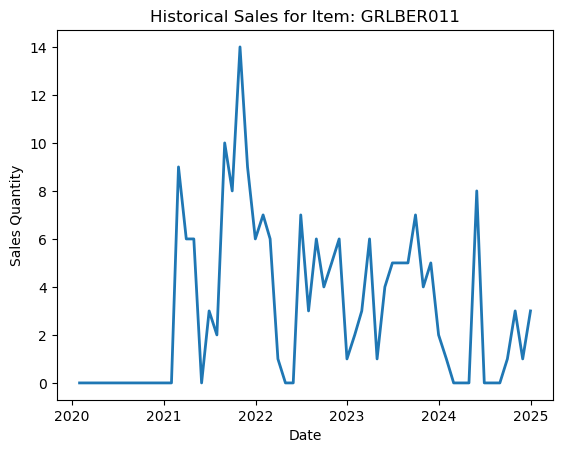

Historical demand for Item: GRLBER012


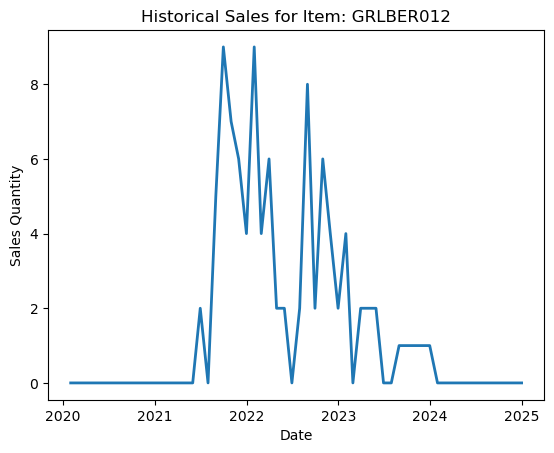

Historical demand for Item: GRLBER015


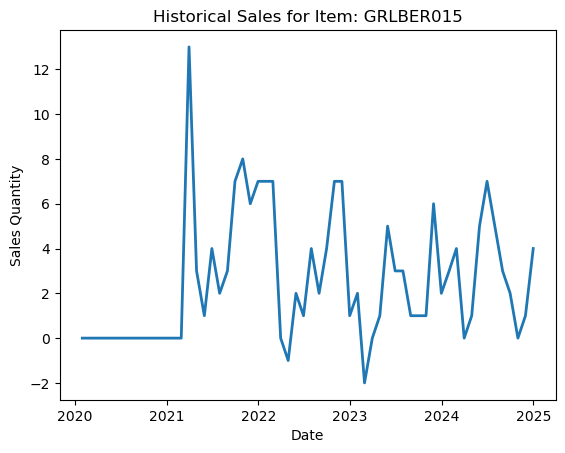

Historical demand for Item: GRLBER019


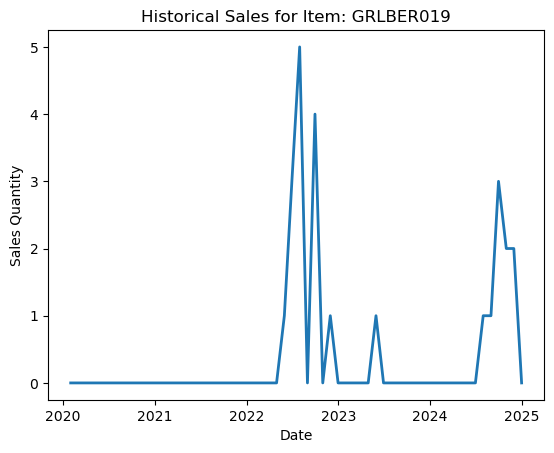

Historical demand for Item: GRLBER020


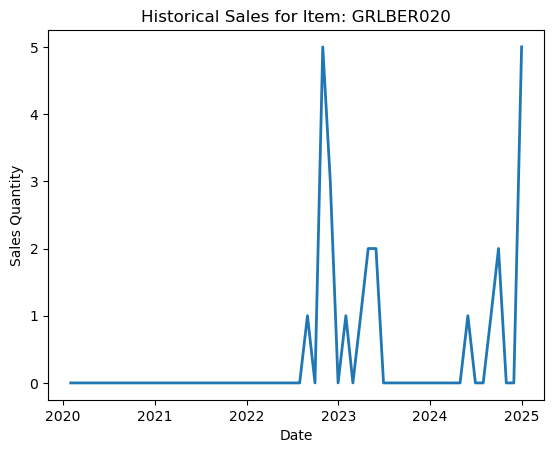

Historical demand for Item: HEABER001


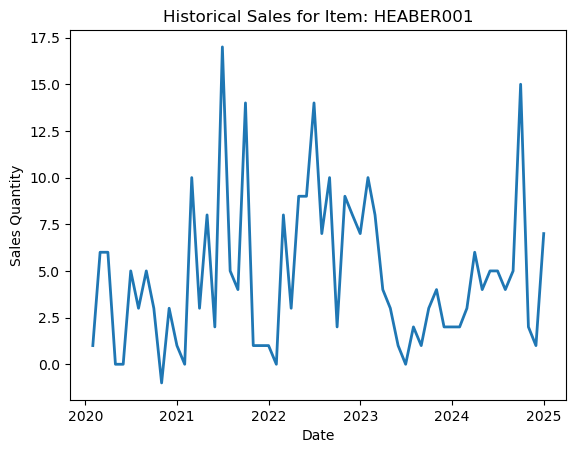

Historical demand for Item: HOTBER001


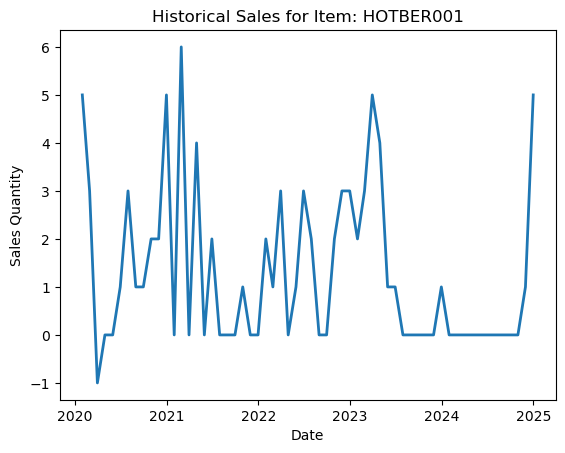

Historical demand for Item: HOTBER002


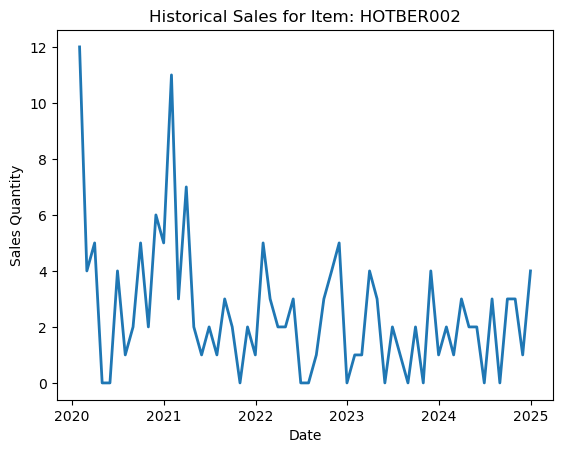

Historical demand for Item: HOTBER003


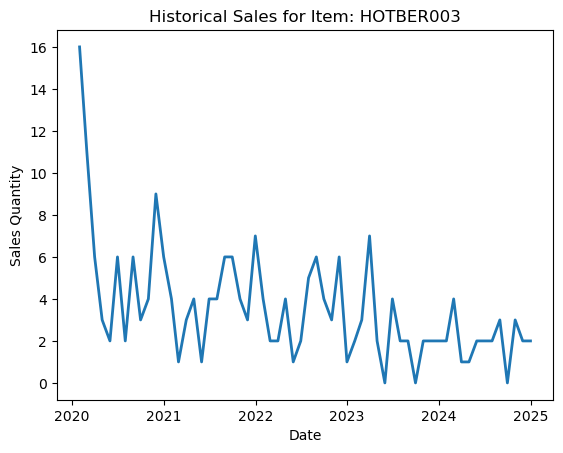

Historical demand for Item: ICMBER002


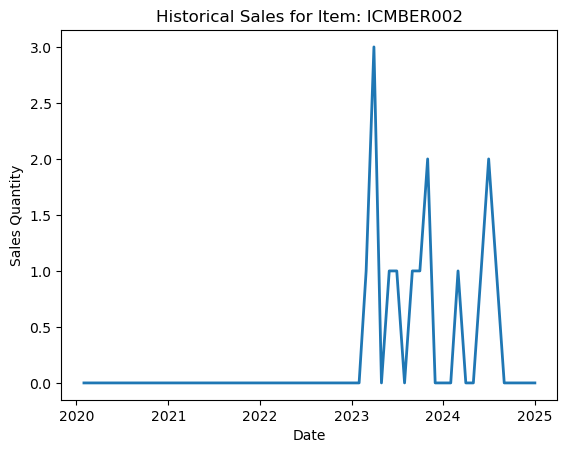

Historical demand for Item: ICMBER003


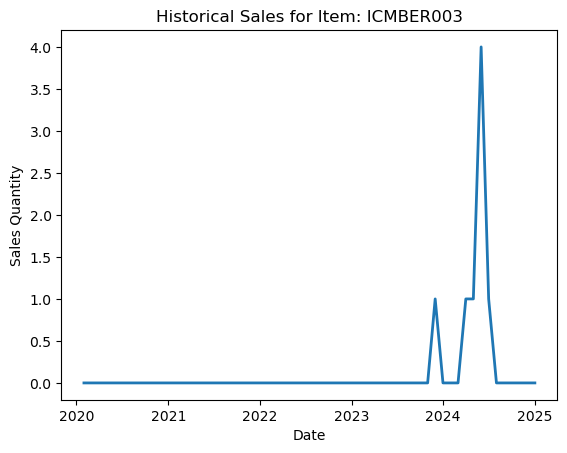

Historical demand for Item: MIXBER001


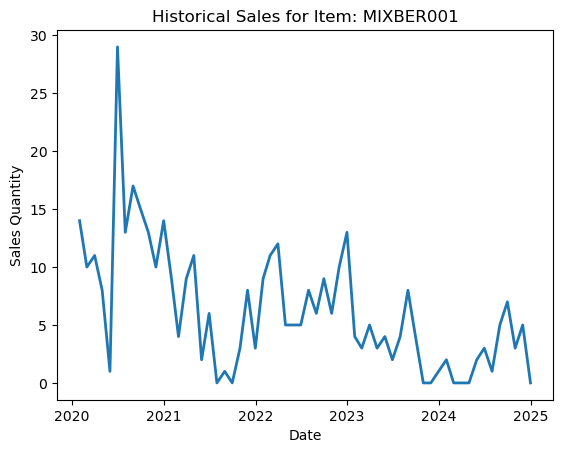

Historical demand for Item: MIXBER003


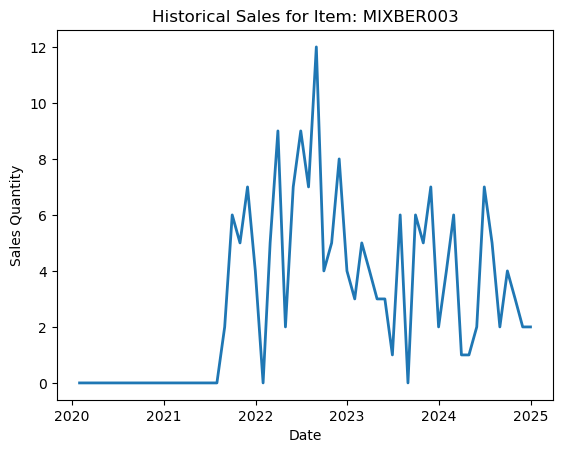

Historical demand for Item: OVEBER002


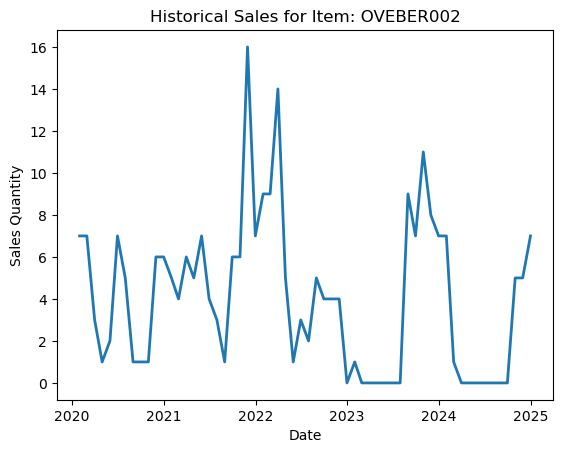

Historical demand for Item: OVEBER005


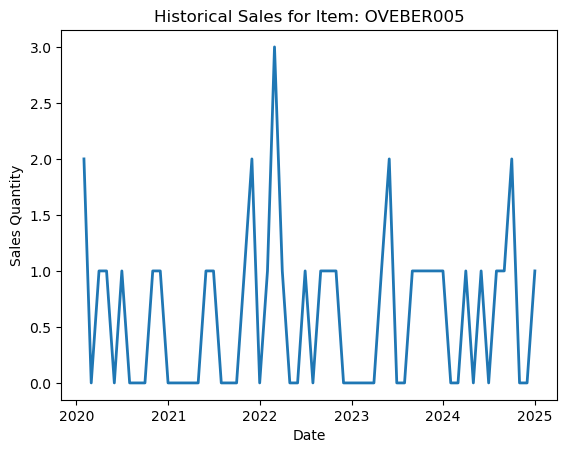

Historical demand for Item: OVEBER006


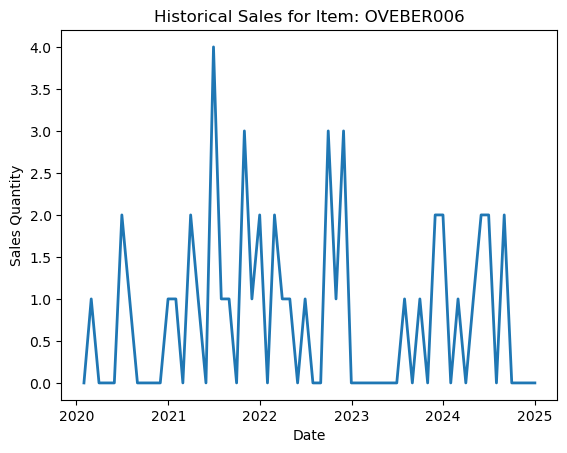

Historical demand for Item: OVEBER011


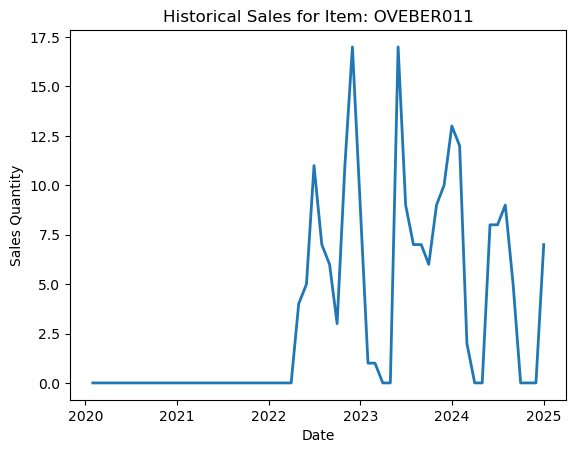

Historical demand for Item: OVEBER012


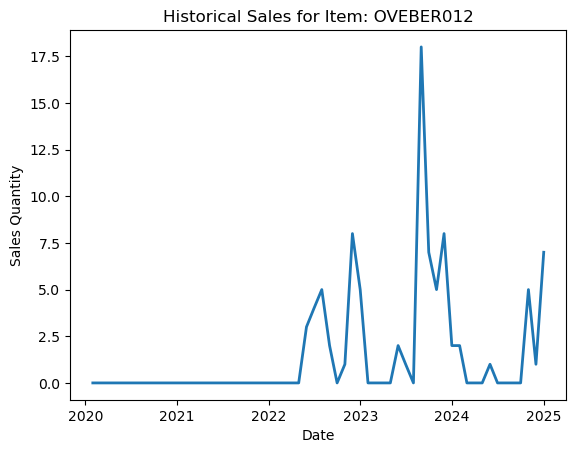

Historical demand for Item: OVEBER013


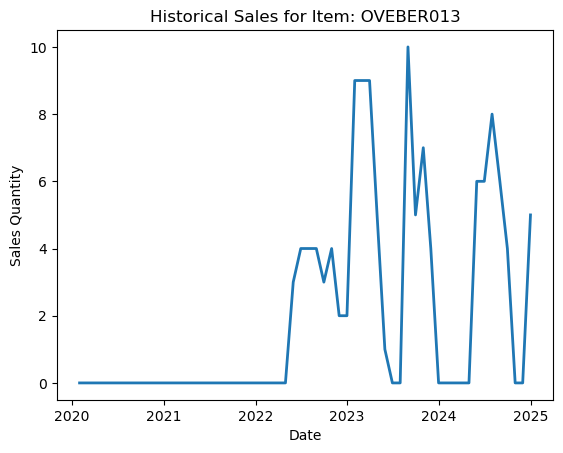

Historical demand for Item: OVEBER014


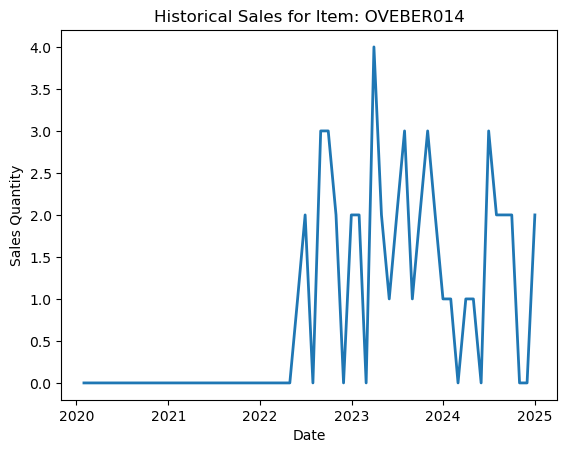

Historical demand for Item: OVEBER015


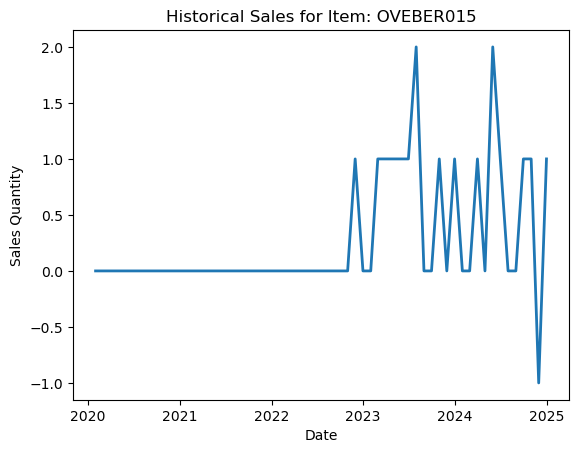

Historical demand for Item: OVEBER016


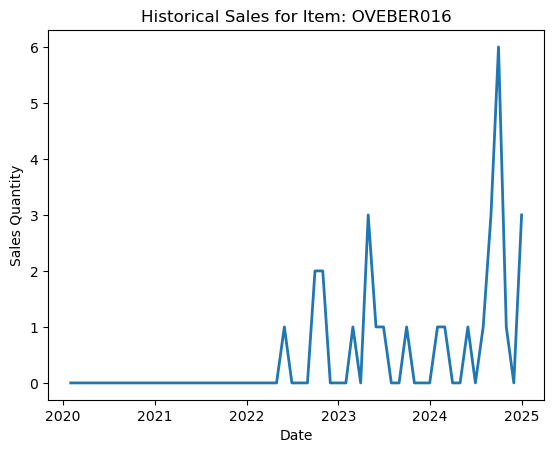

Historical demand for Item: OVEBER017


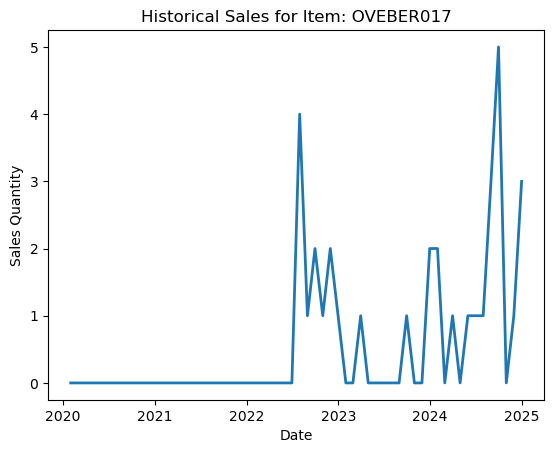

Historical demand for Item: POPBER001


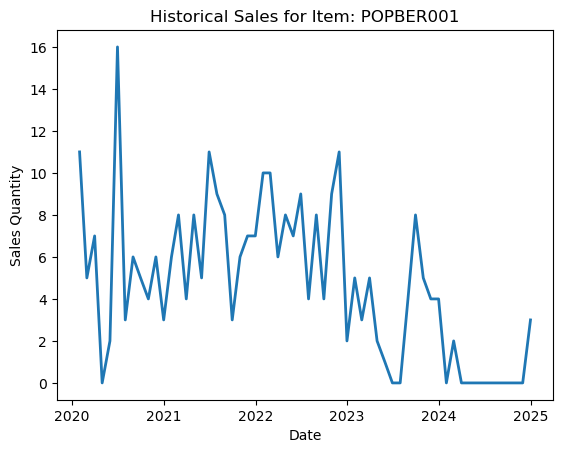

Historical demand for Item: SOPBER001


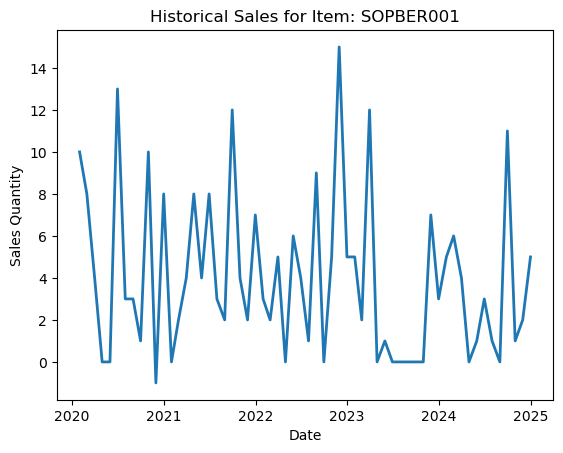

Historical demand for Item: TROBER001


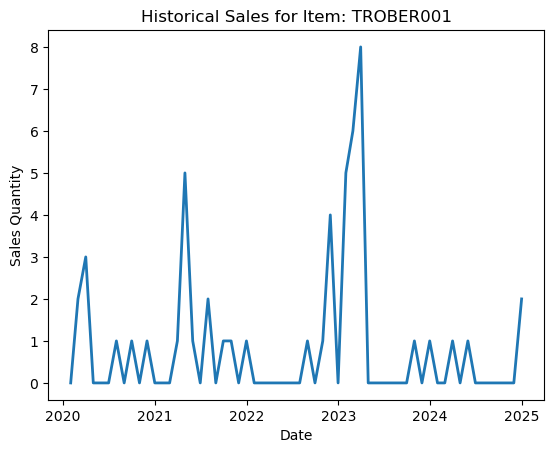

Historical demand for Item: TROBER003


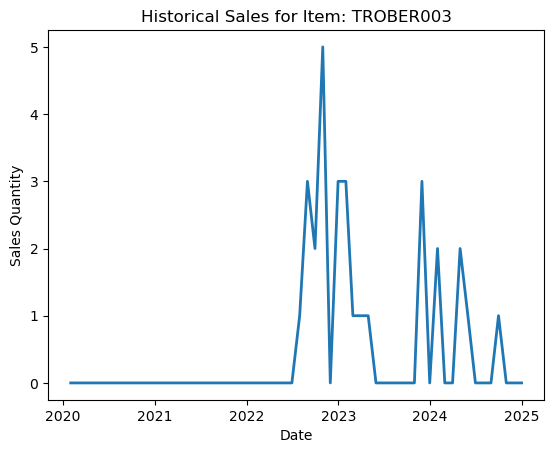

Historical demand for Item: WARBER001


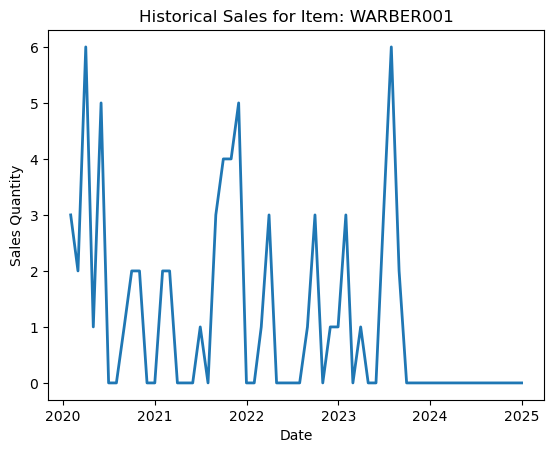

Historical demand for Item: WARBER002


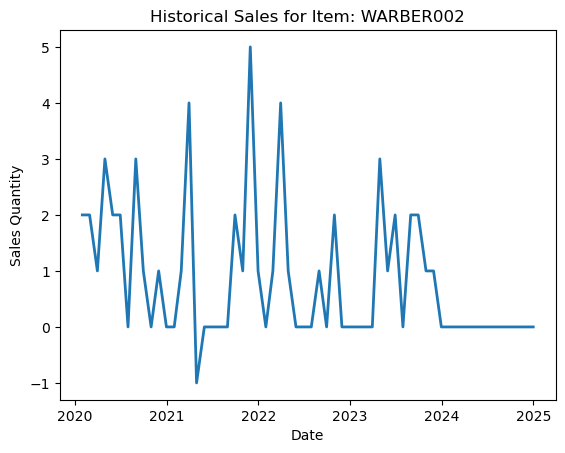

Historical demand for Item: WARBER003


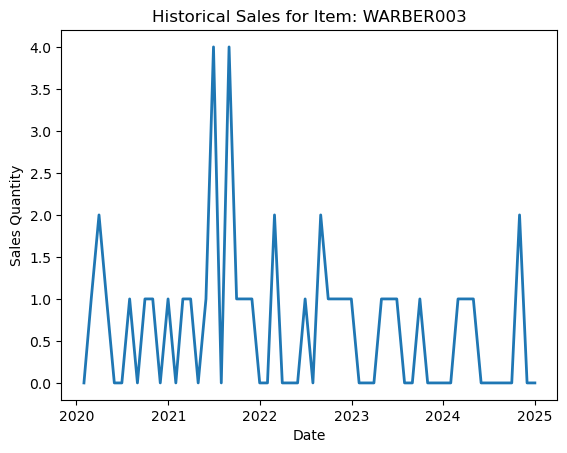

Historical demand for Item: WARBER004


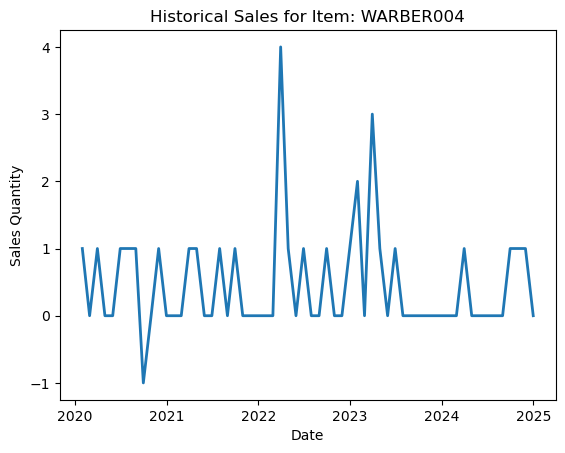

Historical demand for Item: WARBER005


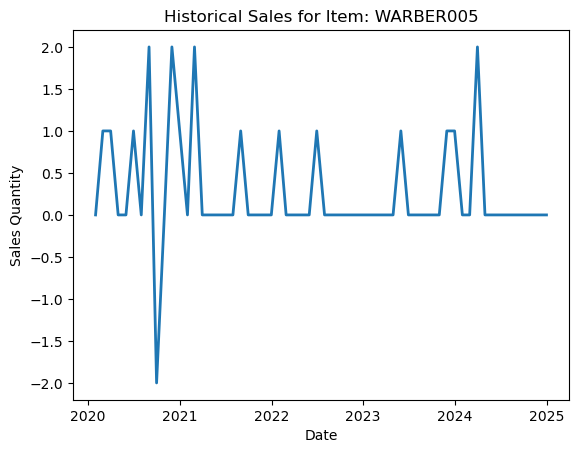

Historical demand for Item: WARBER006


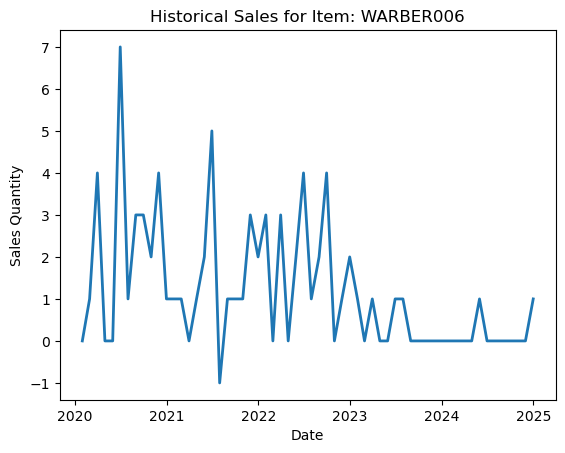

Historical demand for Item: WARBER009


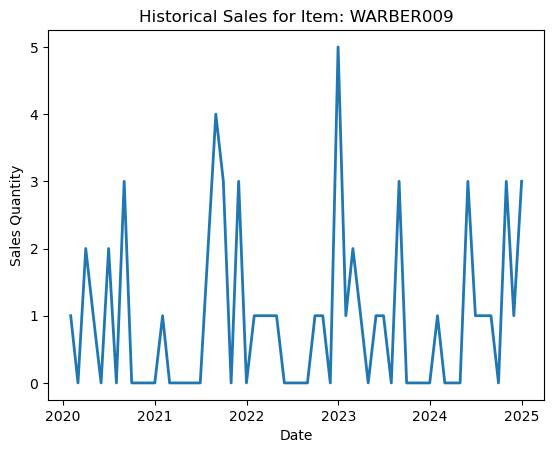

Historical demand for Item: WARBER010


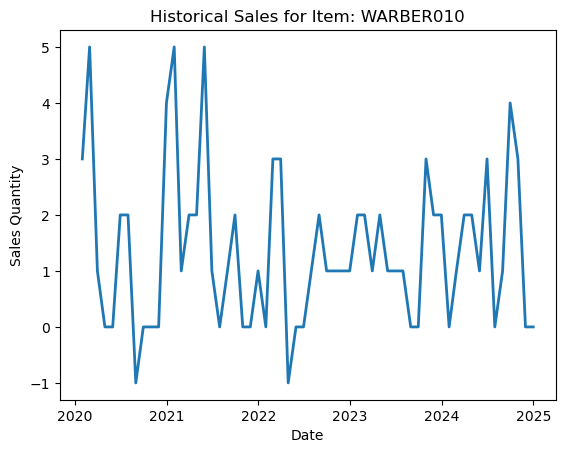

Historical demand for Item: WARBER011


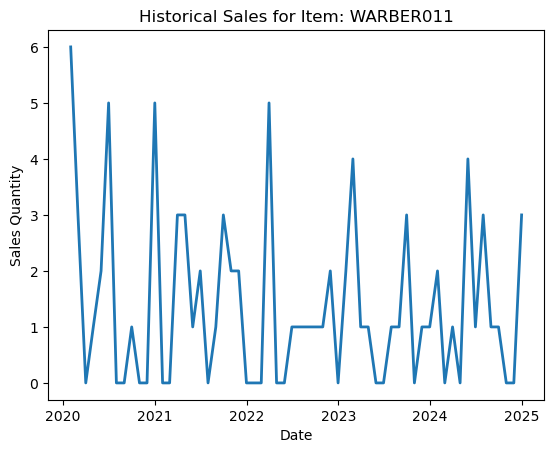

Historical demand for Item: WARBER012


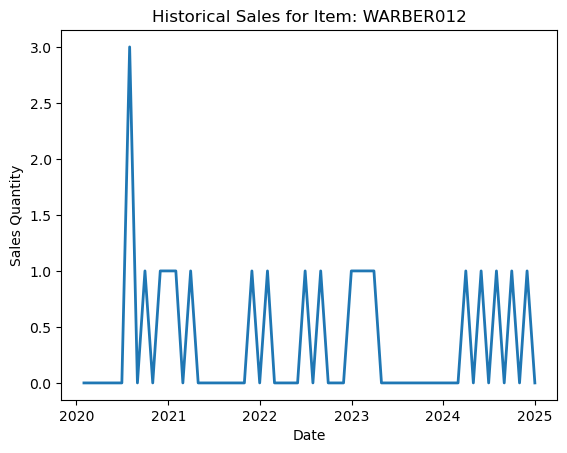

Historical demand for Item: WARBER013


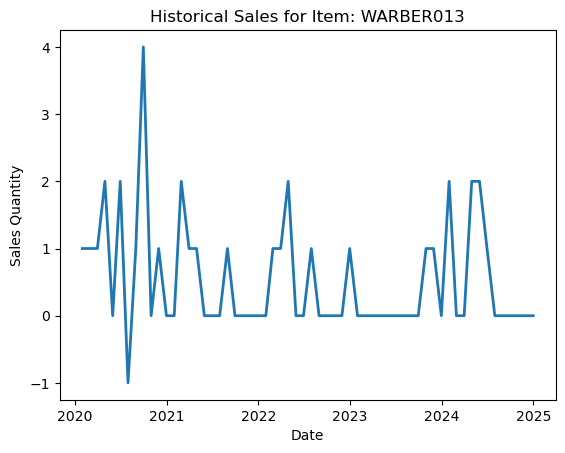

Historical demand for Item: WARBER015


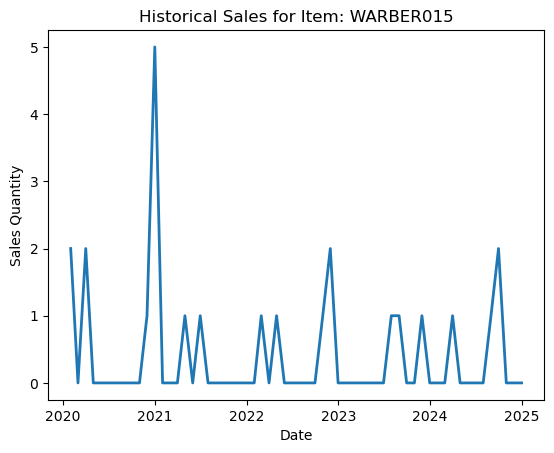

Historical demand for Item: WARBER016


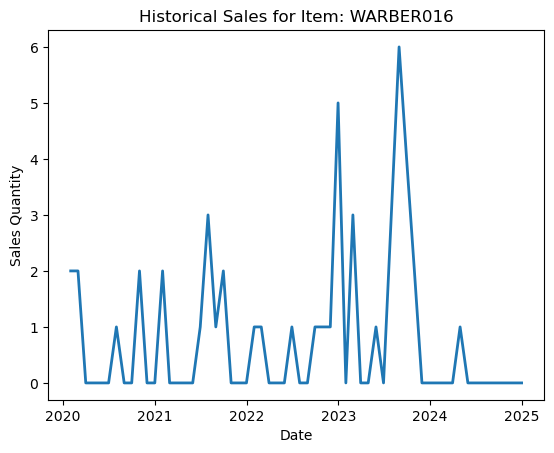

Historical demand for Item: WARBER022


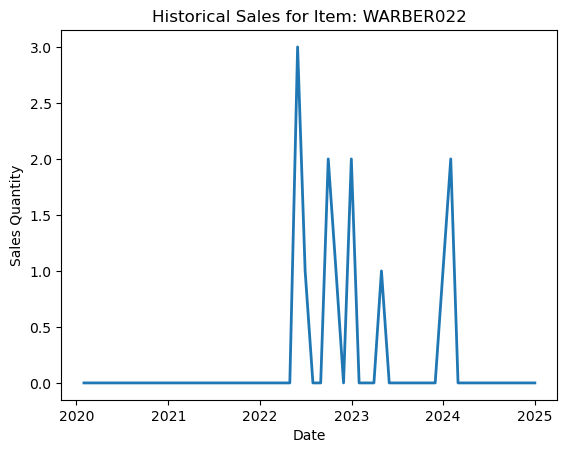

Historical demand for Item: WARBER023


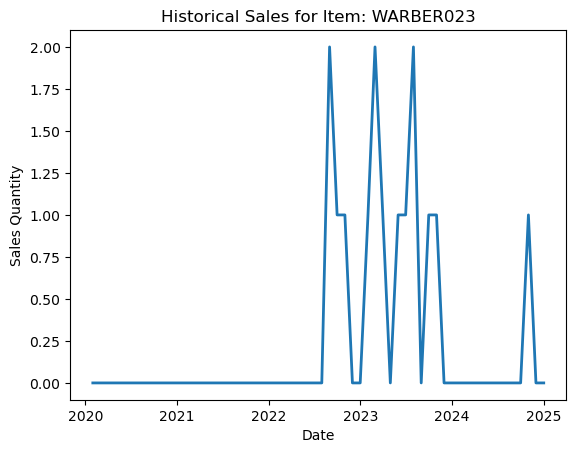

Historical demand for Item: WARBER024


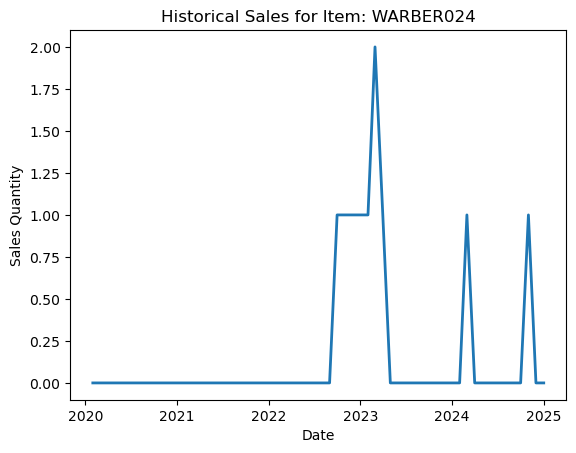

In [38]:
def EDA(ProductNumber, data_filled):
    # Filter data for the specific store and item
    filtered_data = data_filled[(data_filled['ProductNumber'] == ProductNumber)]
    x = filtered_data['month']
    y = filtered_data['Sum of InvoicedQuantity']
    
    # plot
    fig, ax = plt.subplots()
    ax.plot(x, y, linewidth=2.0)

    #plot = (filtered_data)
    plt.title(f"Historical Sales for Item: {ProductNumber}")
    plt.xlabel("Date")
    plt.ylabel("Sales Quantity")
    plt.show()
    
    return filtered_data

item_combinations = data_filled[['ProductNumber']].drop_duplicates()

for _, row in item_combinations.iterrows():
    ProductNumber = row['ProductNumber']
    print(f"Historical demand for Item: {ProductNumber}")
    Historical = EDA(ProductNumber, data_filled)
    

## Seasonal decompose

Seasonal Decomposing for Product: BOLBER001


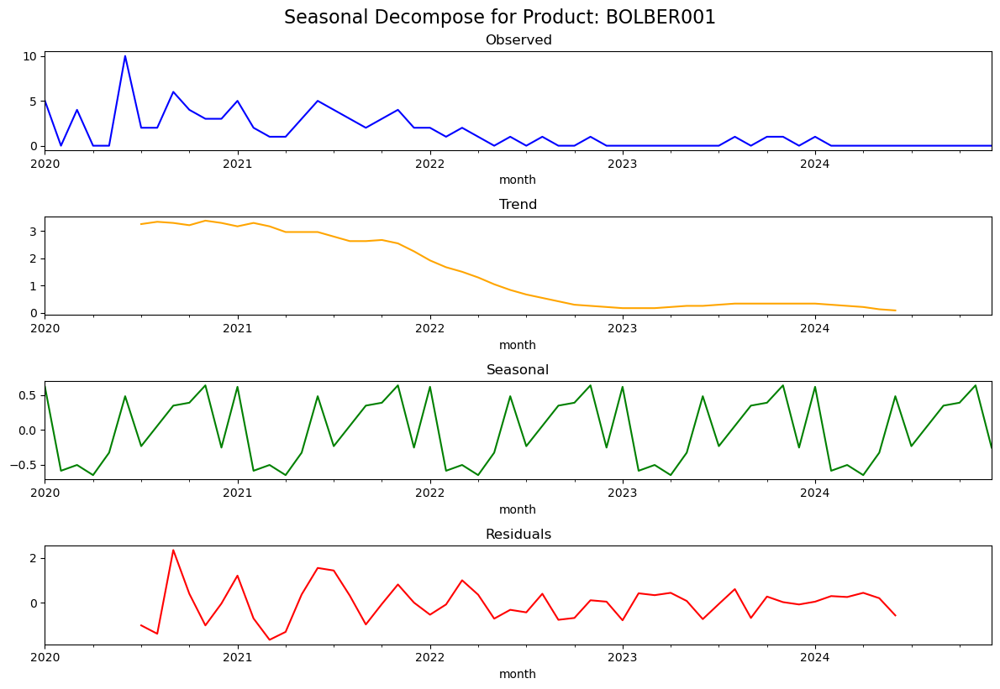

Seasonal Decomposing for Product: BOLBER002


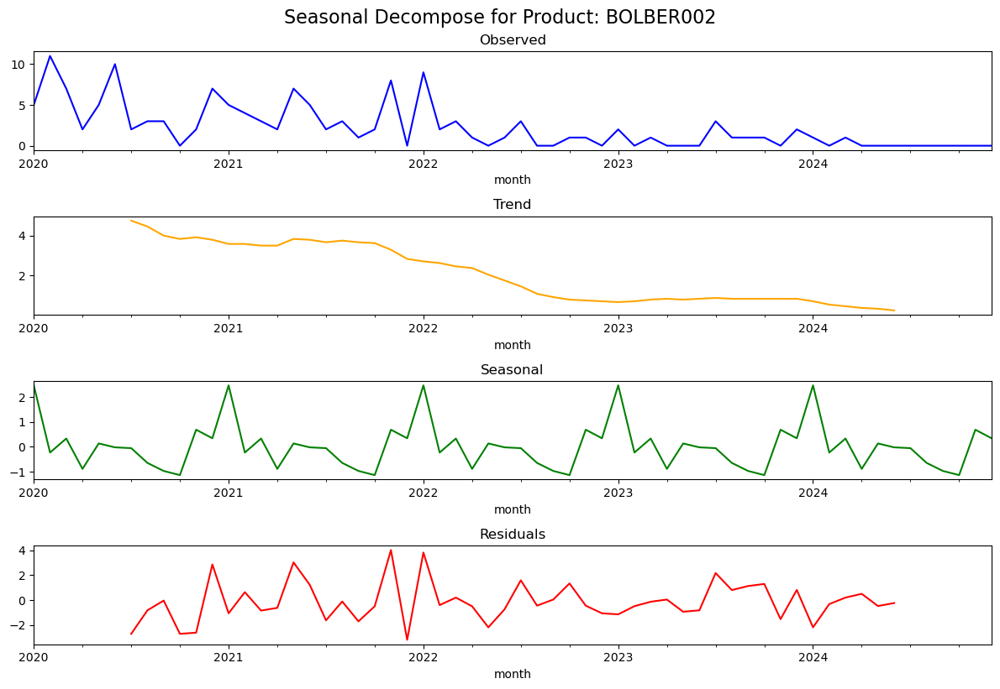

Seasonal Decomposing for Product: BOLBER003


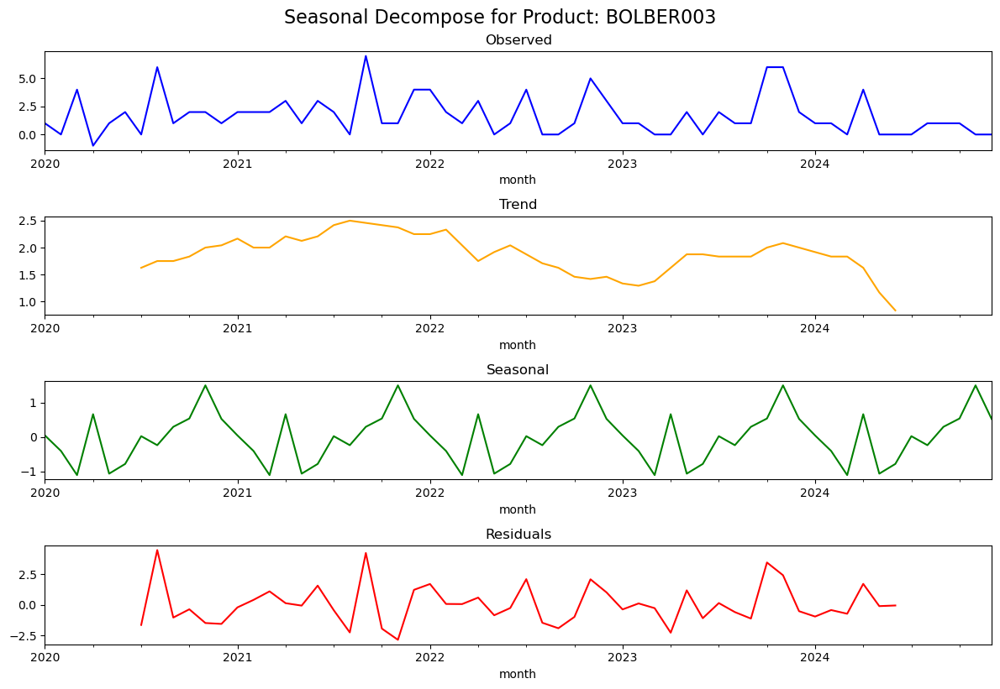

Seasonal Decomposing for Product: BOLBER005


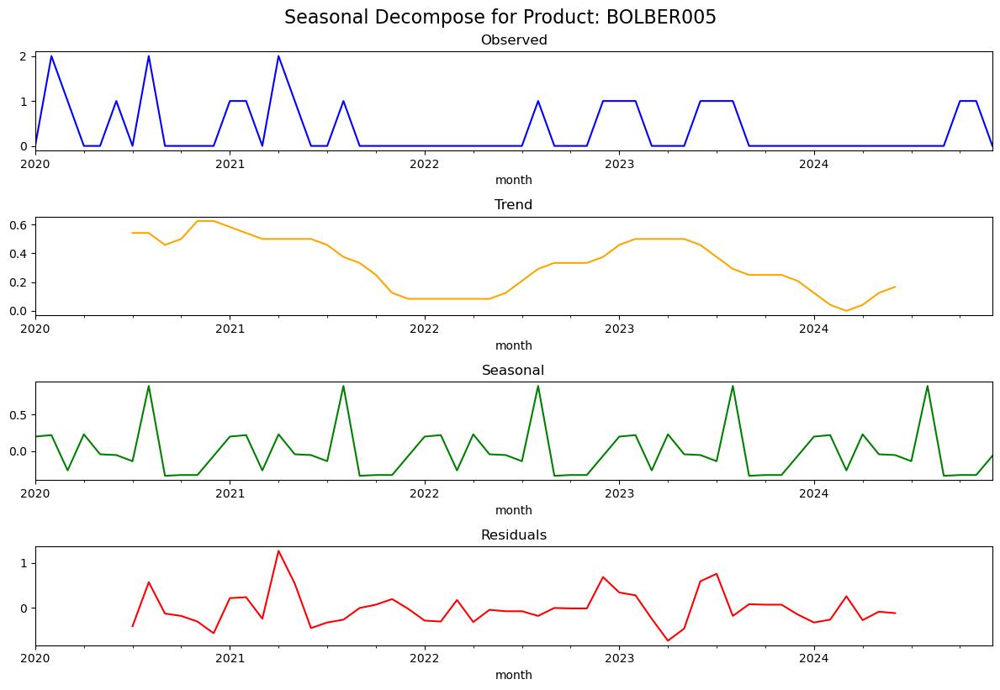

Seasonal Decomposing for Product: BURBER001


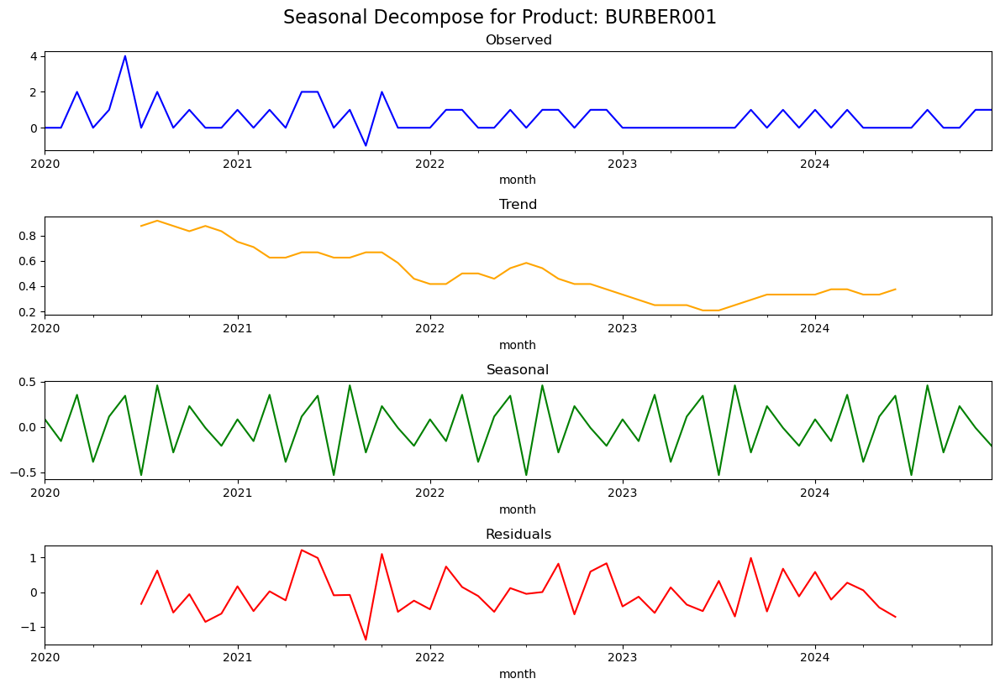

Seasonal Decomposing for Product: BURBER002


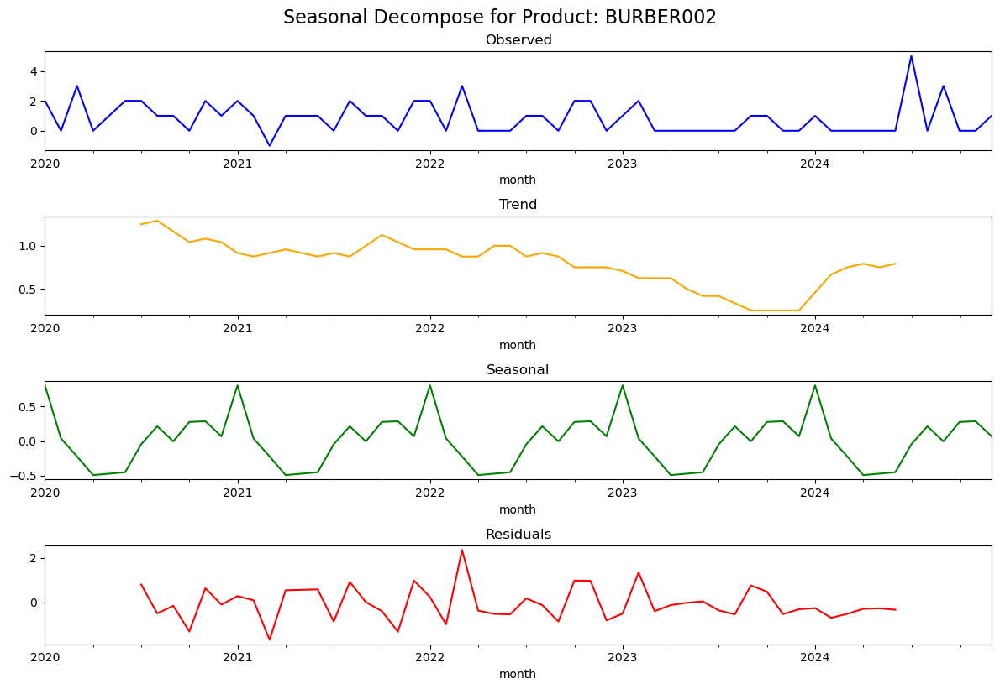

Seasonal Decomposing for Product: BURBER003


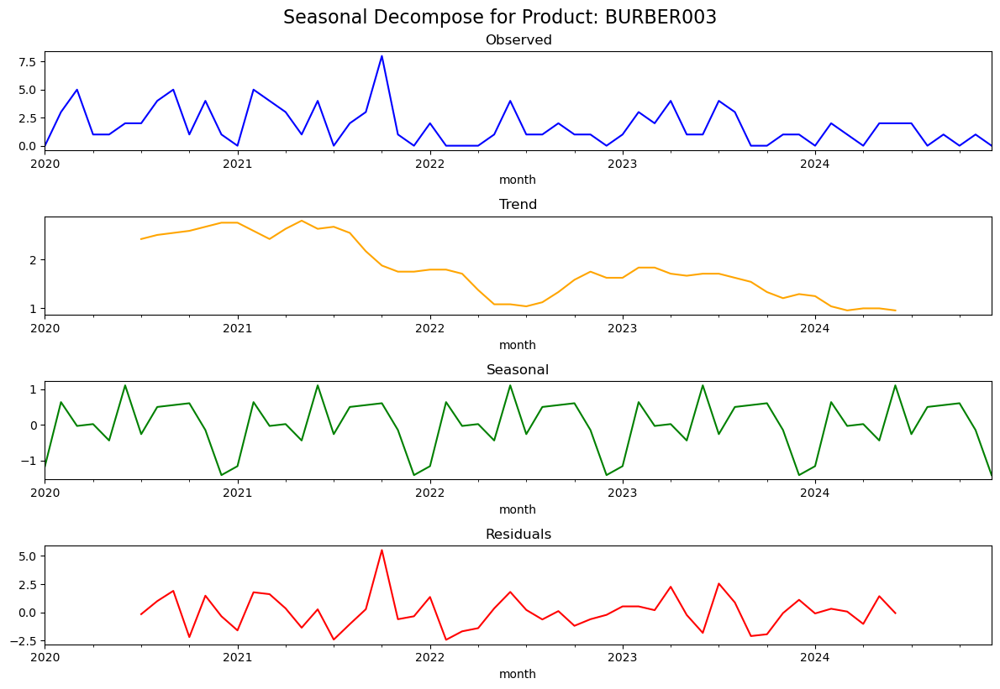

Seasonal Decomposing for Product: BURBER004


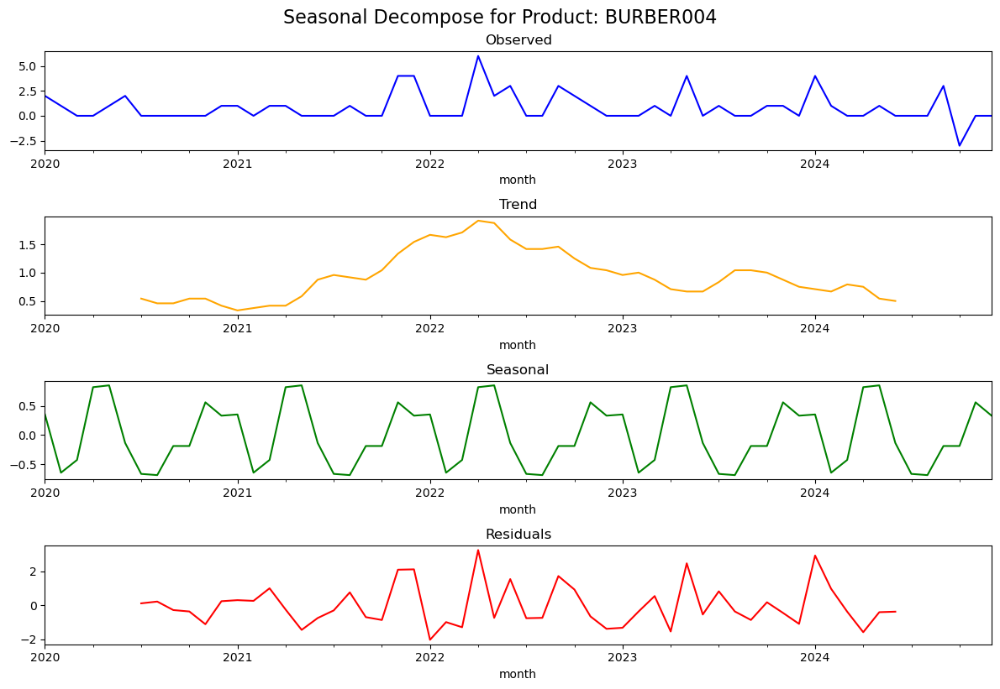

Seasonal Decomposing for Product: BURBER007


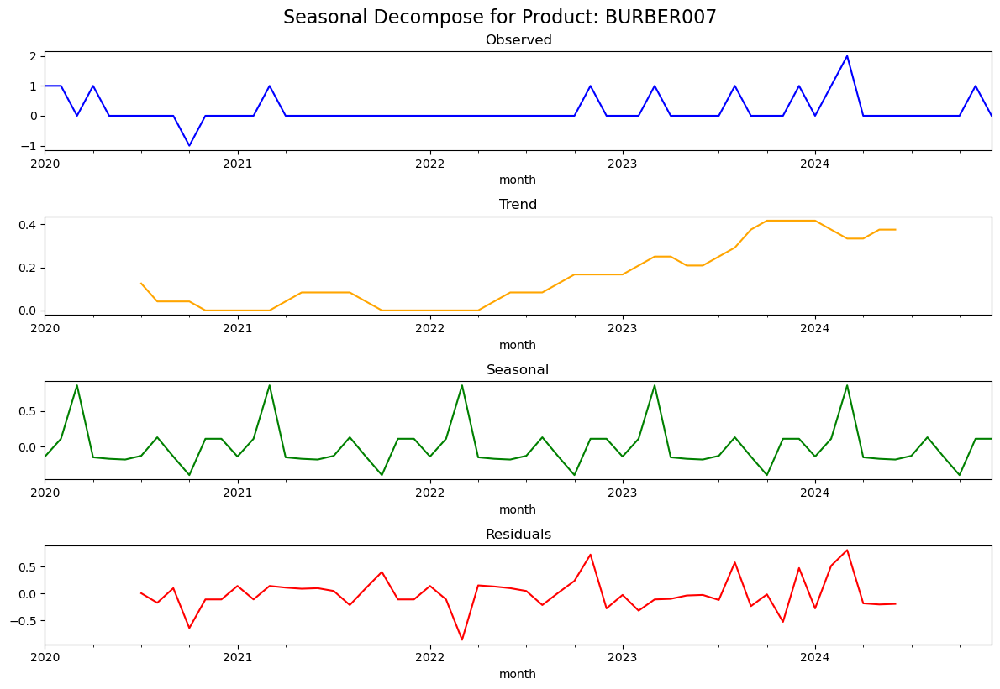

Seasonal Decomposing for Product: COFBER001


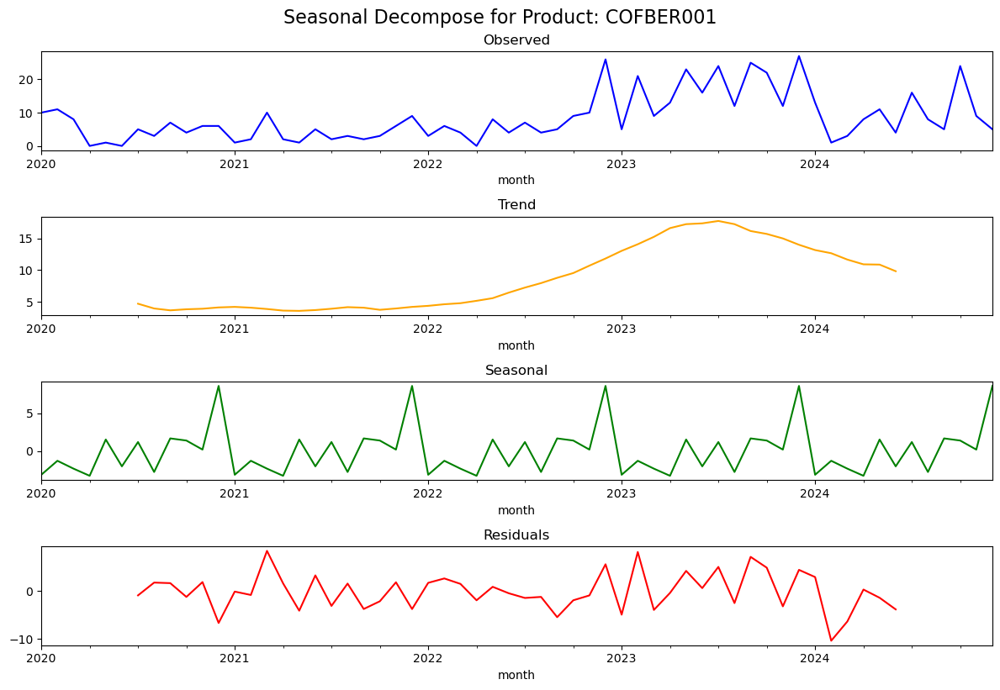

Seasonal Decomposing for Product: COKBER001


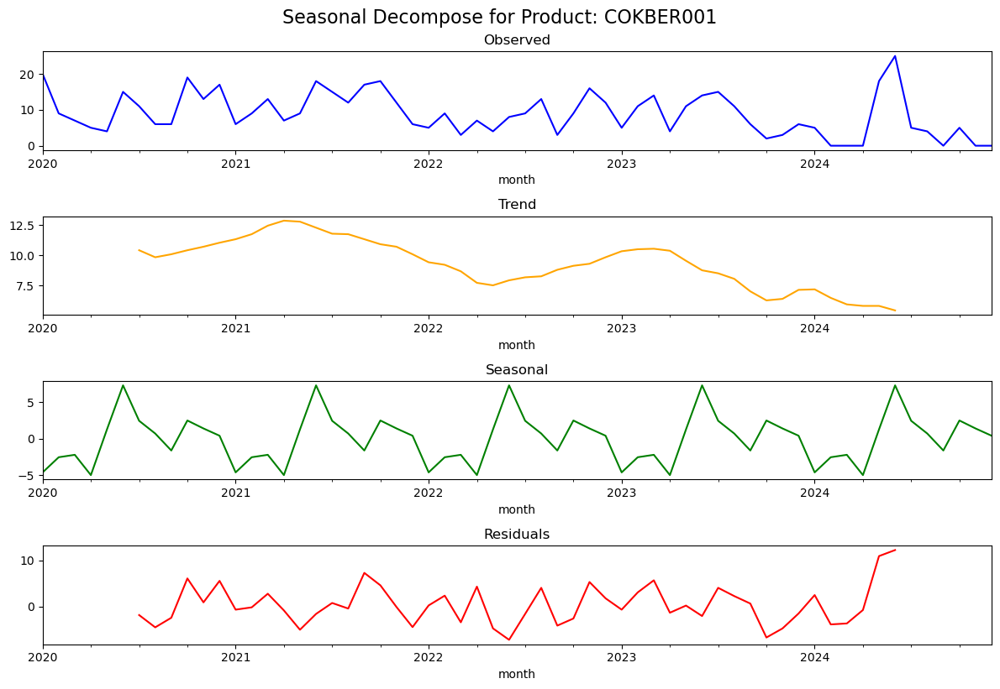

Seasonal Decomposing for Product: FRYBER002


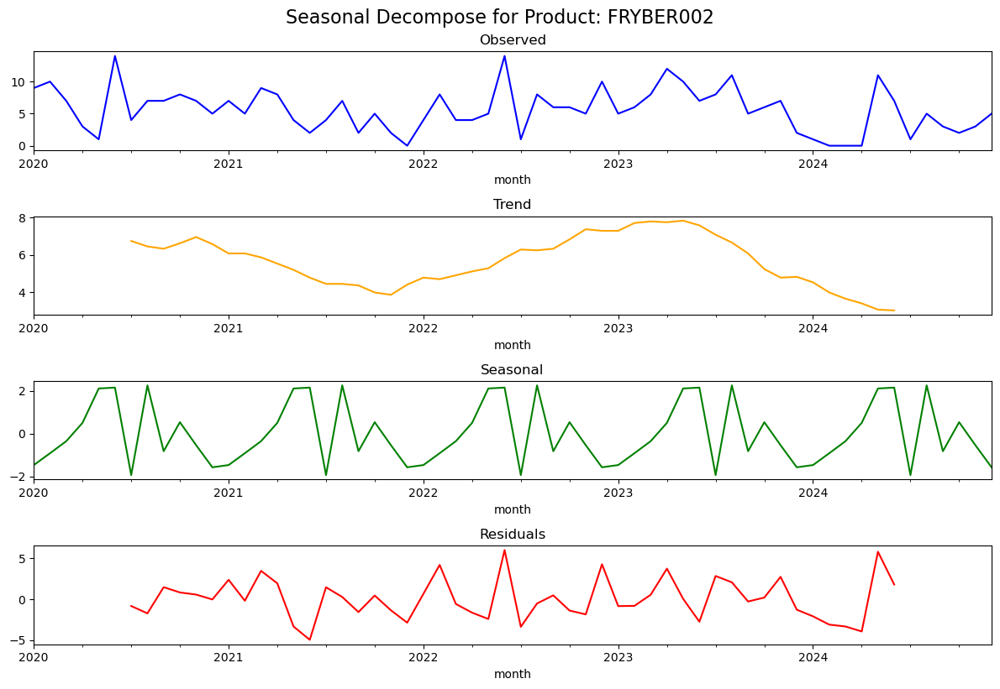

Seasonal Decomposing for Product: FRYBER003


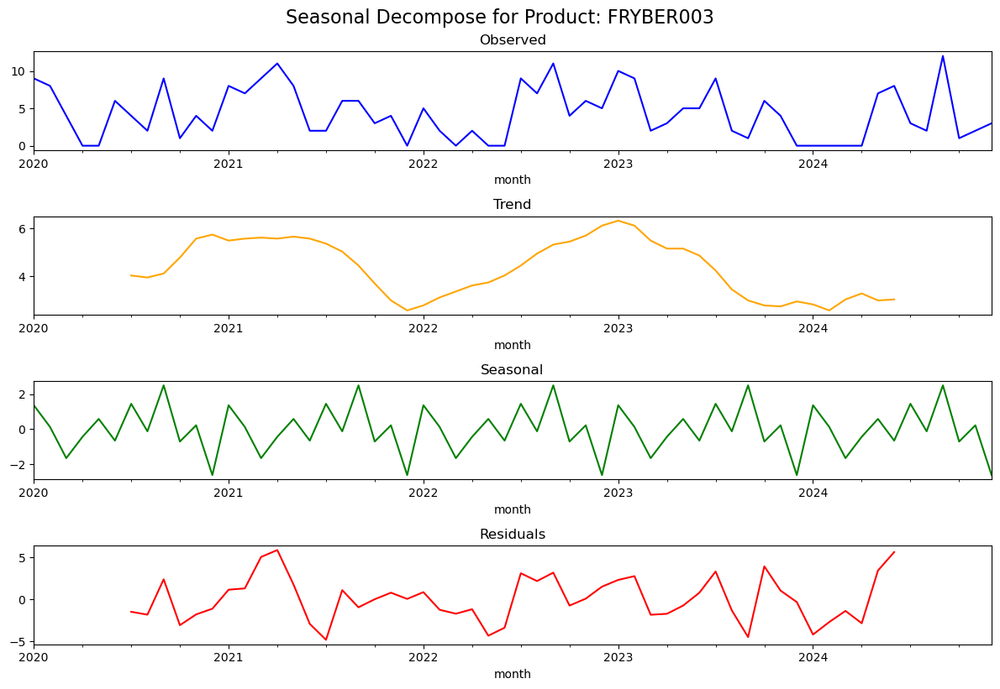

Seasonal Decomposing for Product: FRYBER005


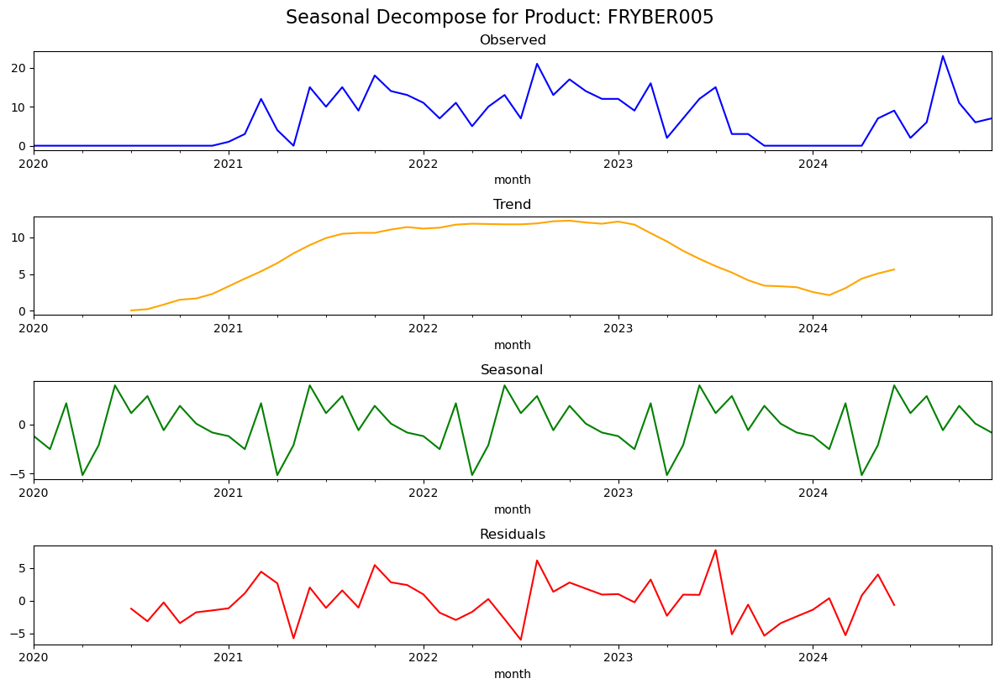

Seasonal Decomposing for Product: GRLBER003


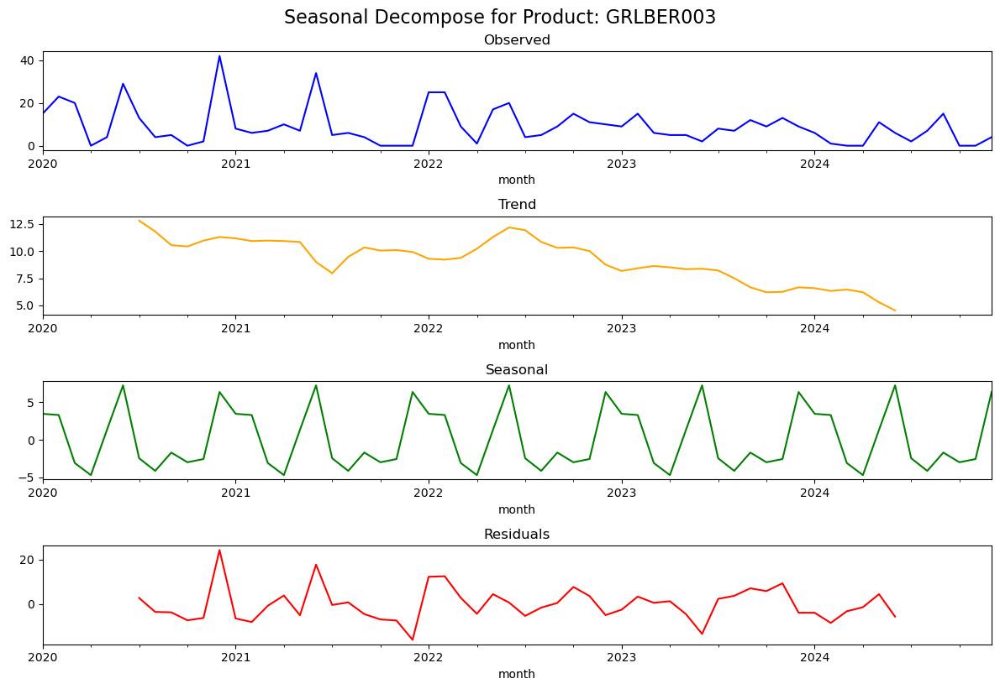

Seasonal Decomposing for Product: GRLBER004


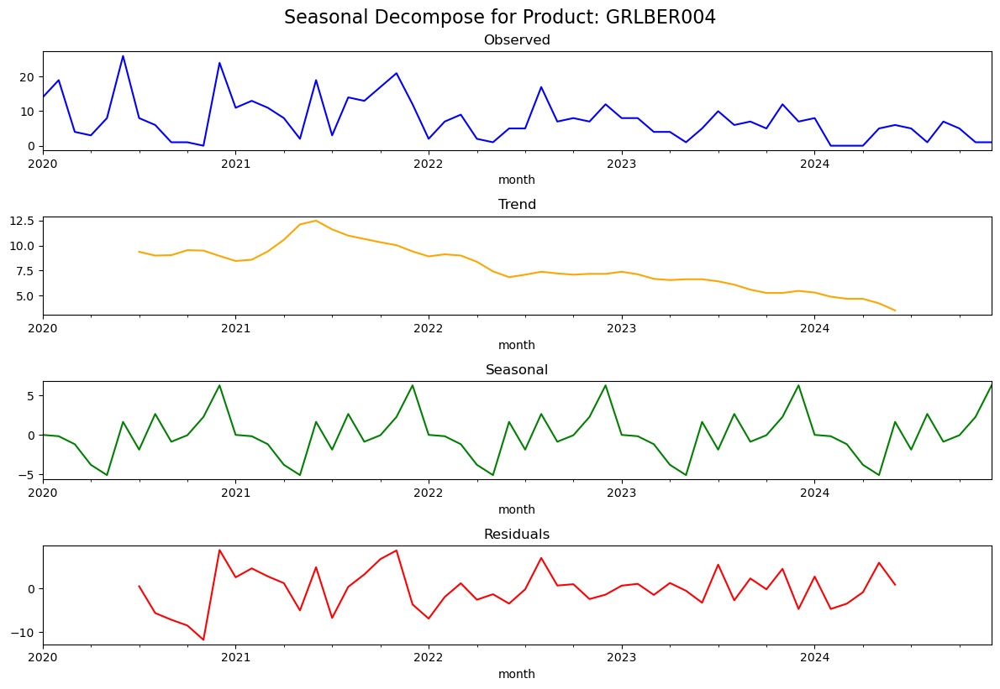

Seasonal Decomposing for Product: GRLBER009


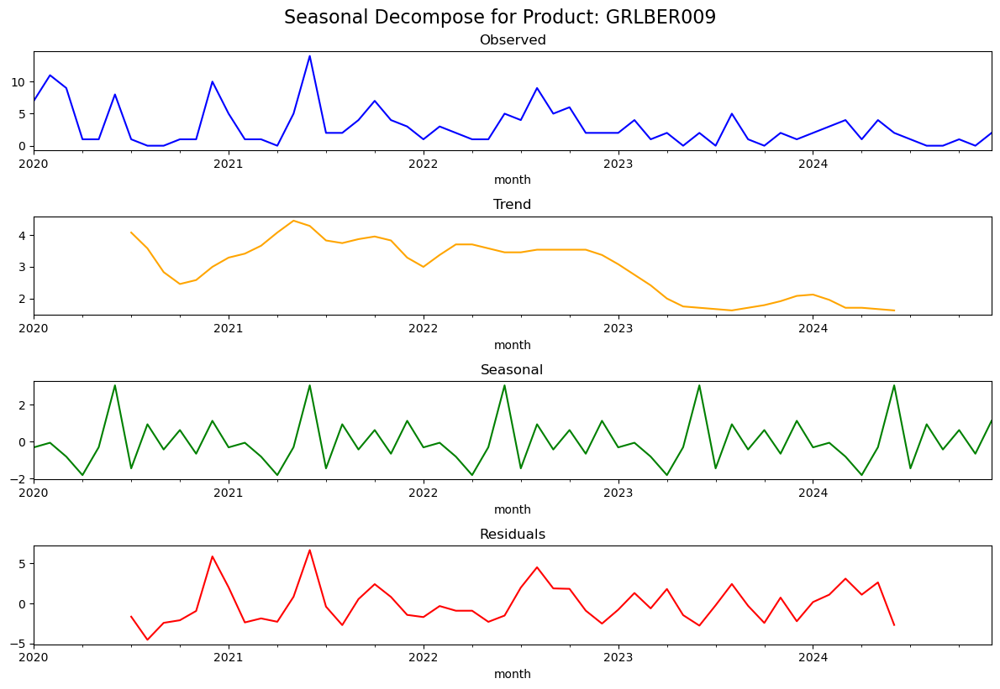

Seasonal Decomposing for Product: GRLBER010


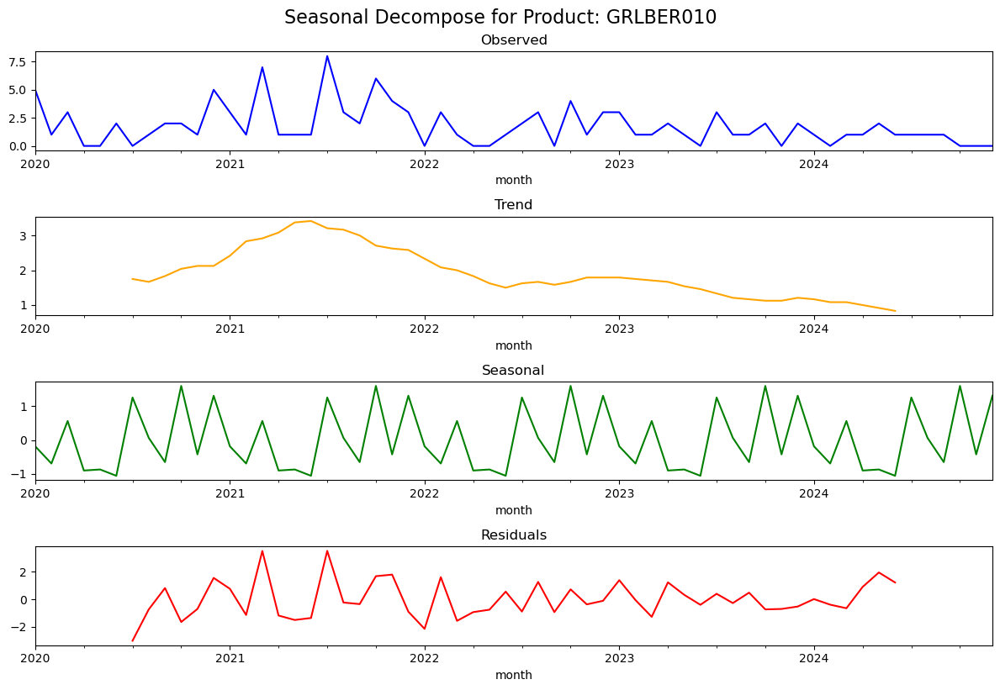

Seasonal Decomposing for Product: GRLBER011


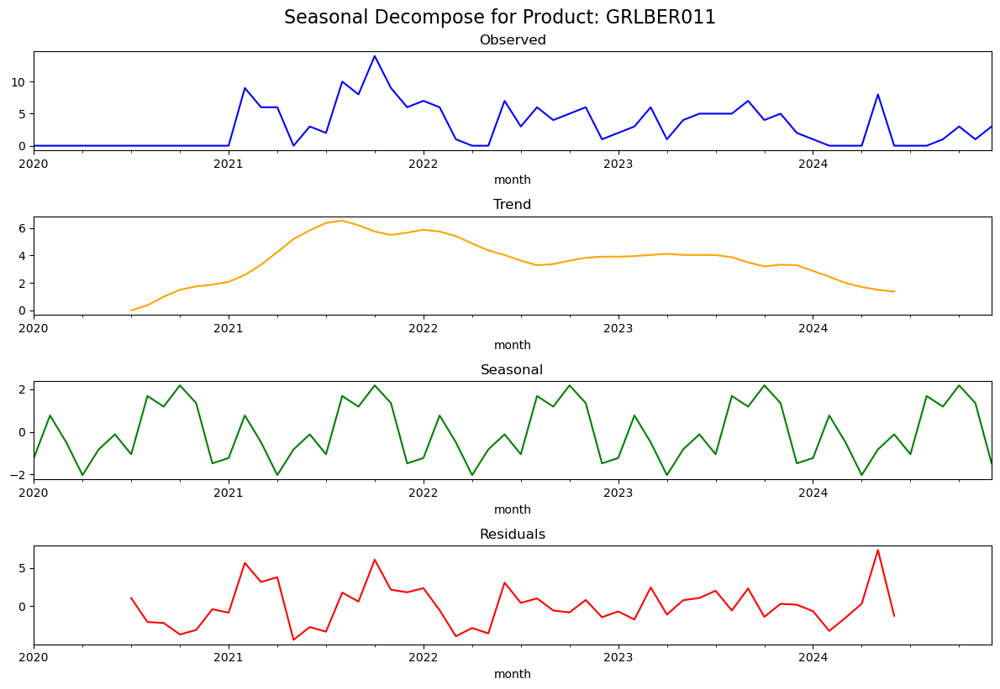

Seasonal Decomposing for Product: GRLBER012


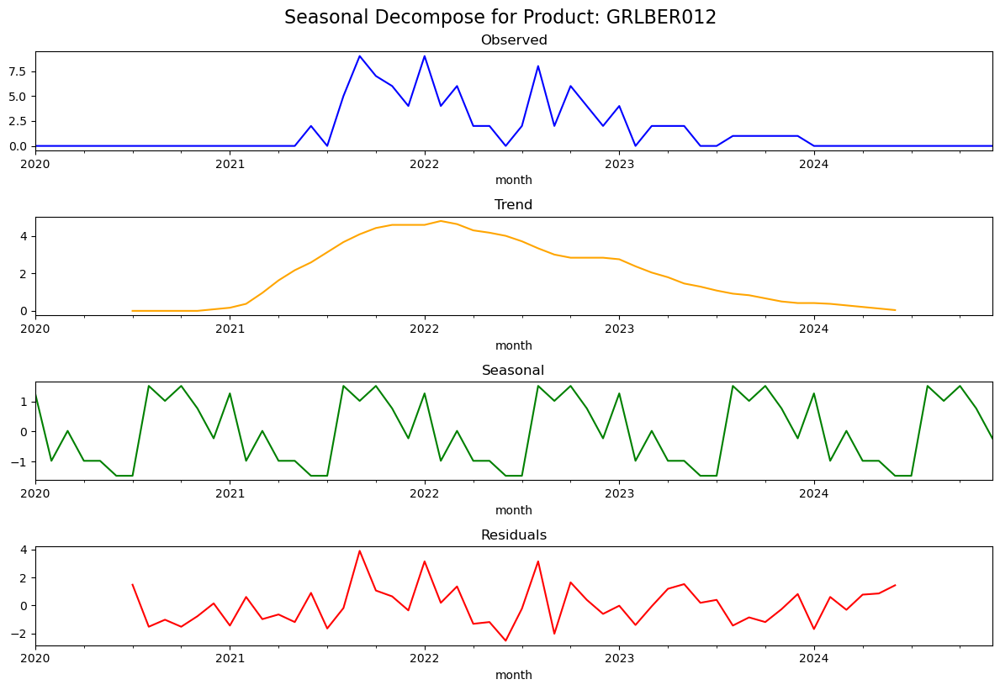

Seasonal Decomposing for Product: GRLBER015


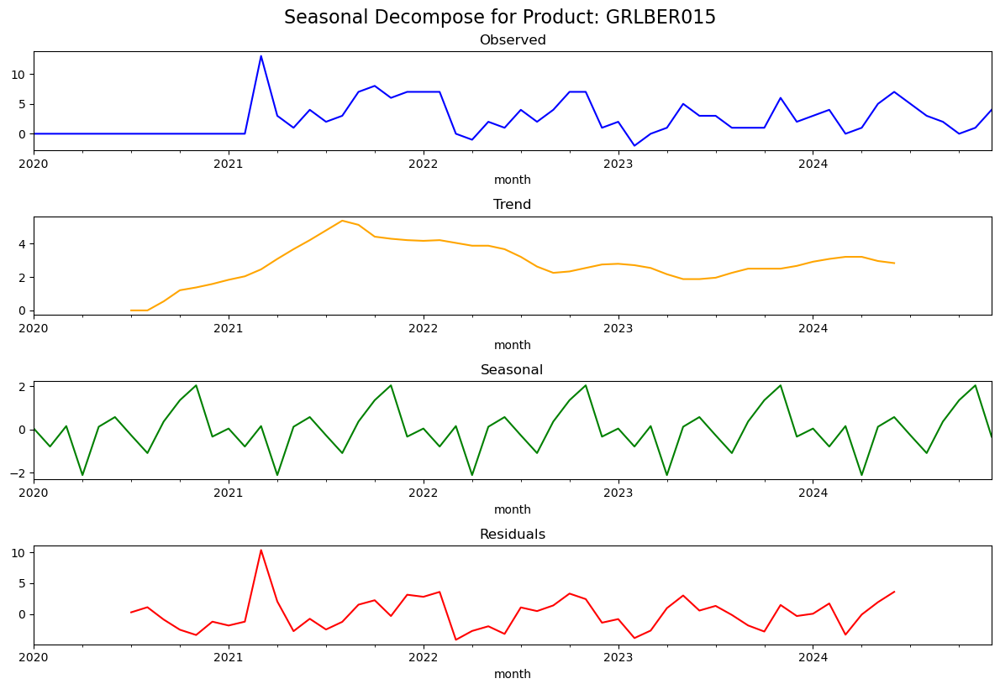

Seasonal Decomposing for Product: GRLBER019


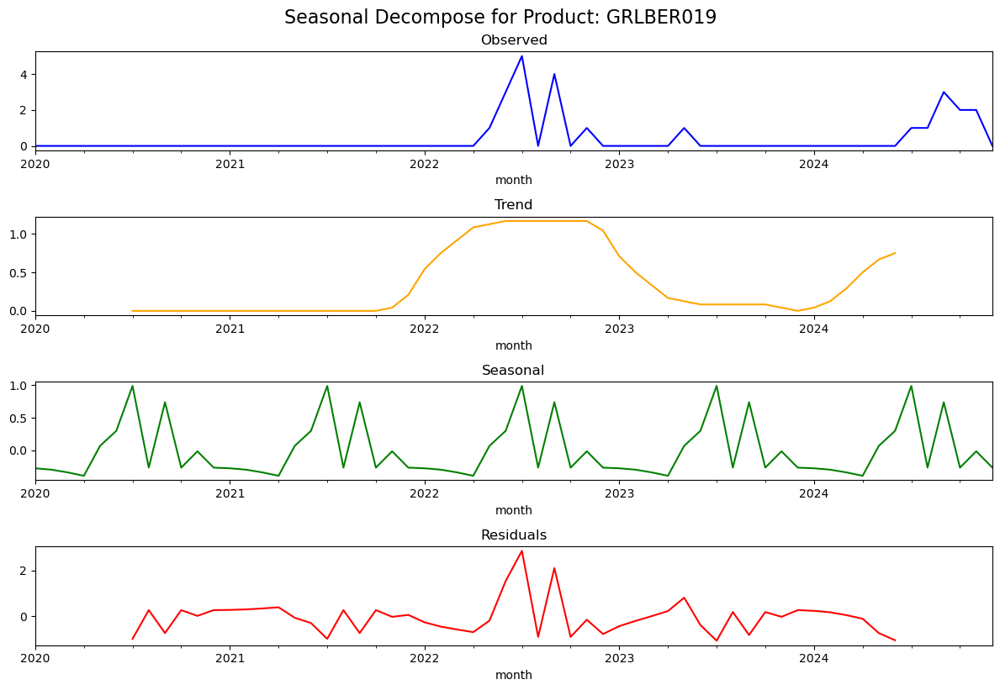

Seasonal Decomposing for Product: GRLBER020


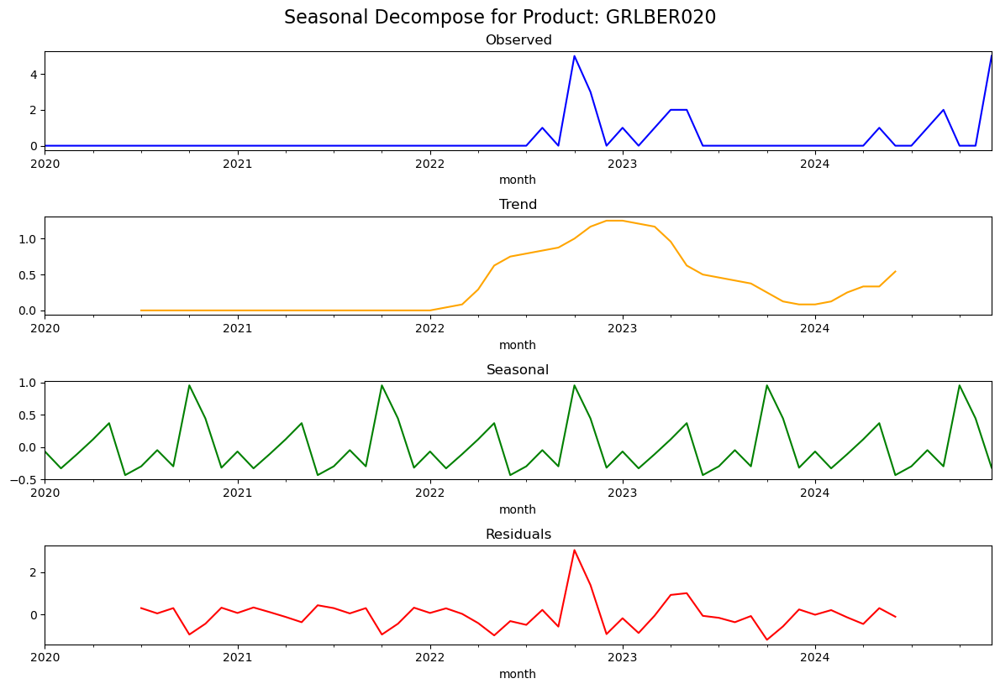

Seasonal Decomposing for Product: HEABER001


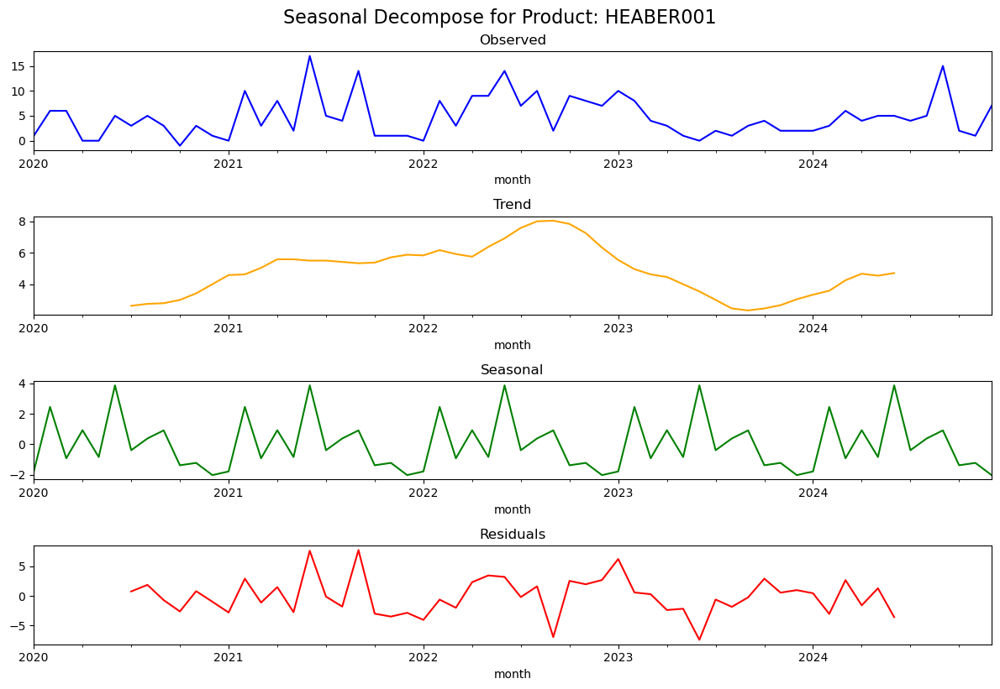

Seasonal Decomposing for Product: HOTBER001


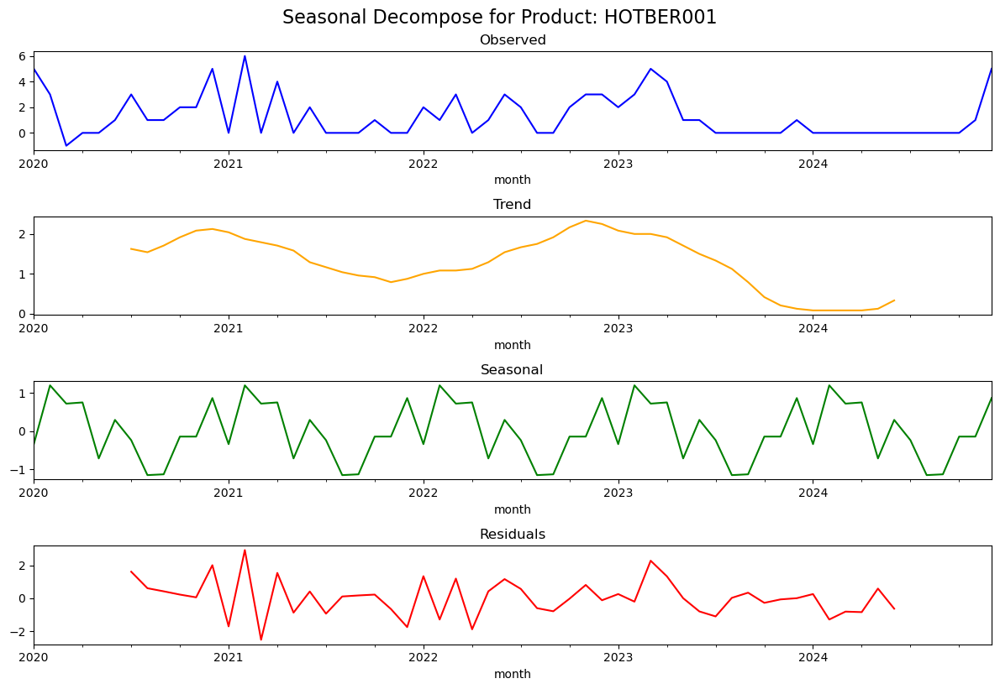

Seasonal Decomposing for Product: HOTBER002


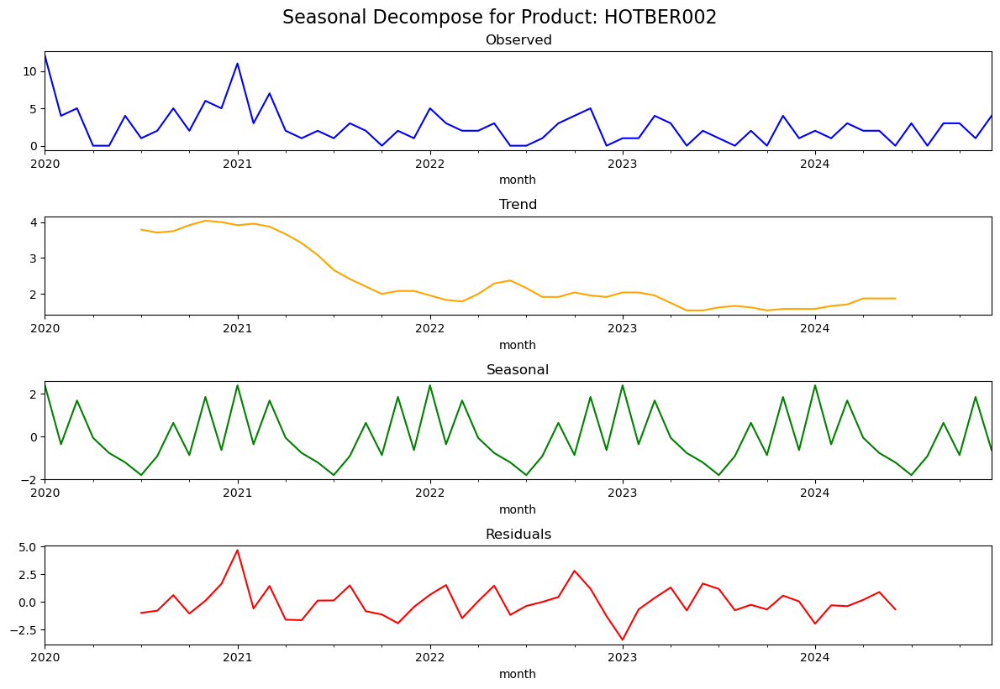

Seasonal Decomposing for Product: HOTBER003


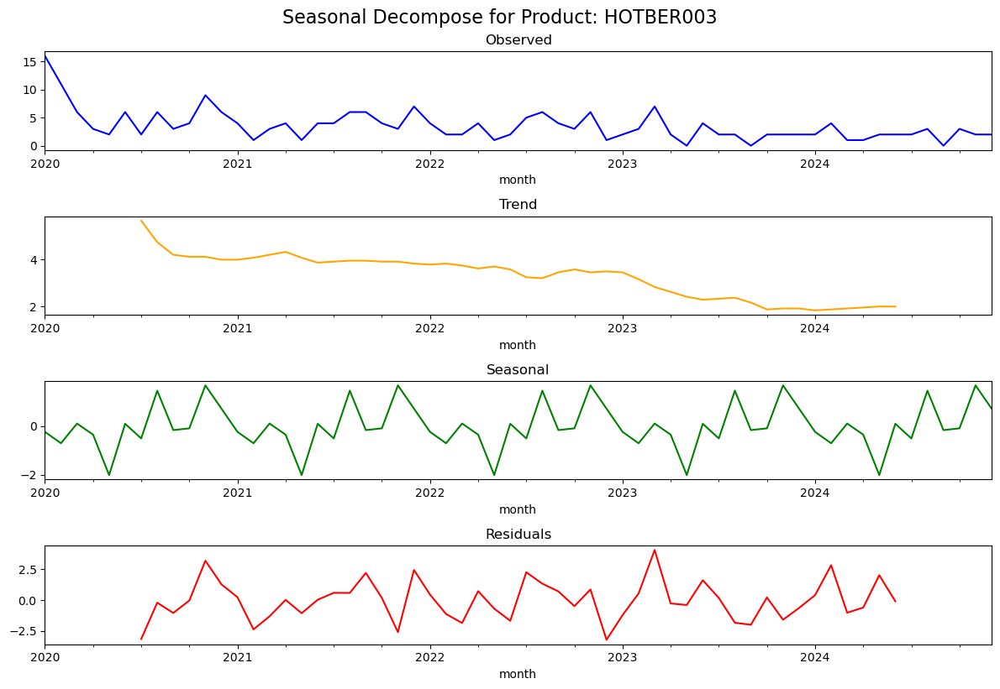

Seasonal Decomposing for Product: ICMBER002


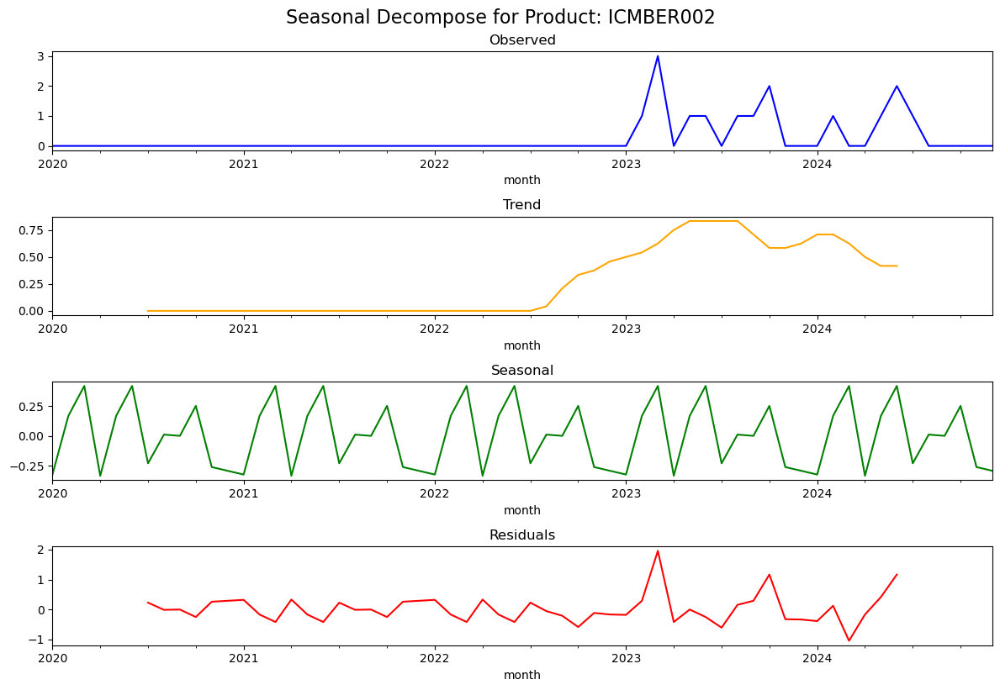

Seasonal Decomposing for Product: ICMBER003


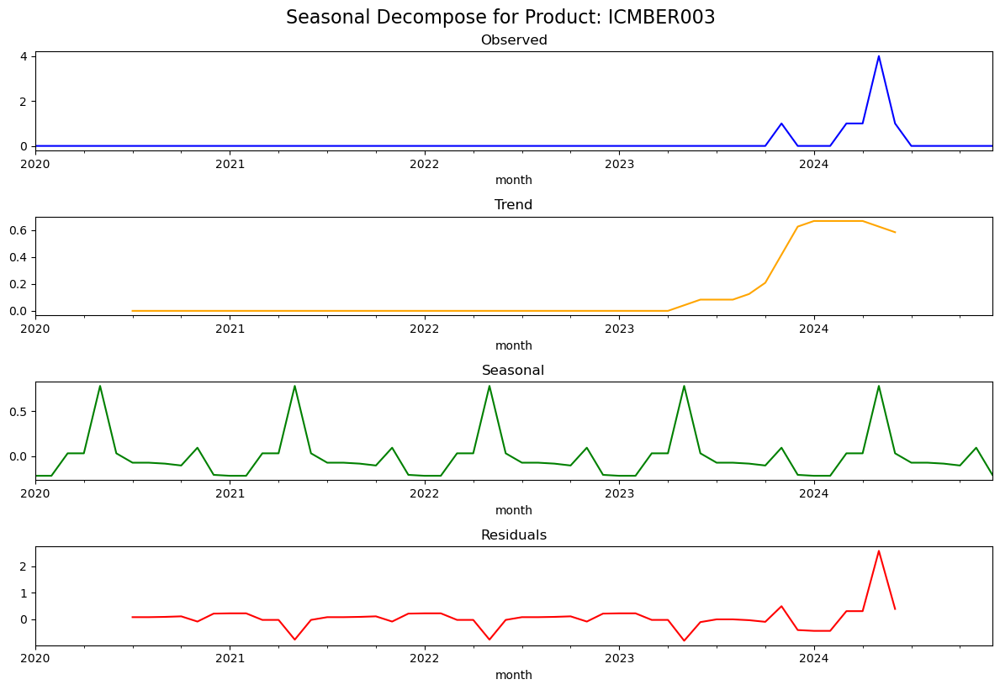

Seasonal Decomposing for Product: MIXBER001


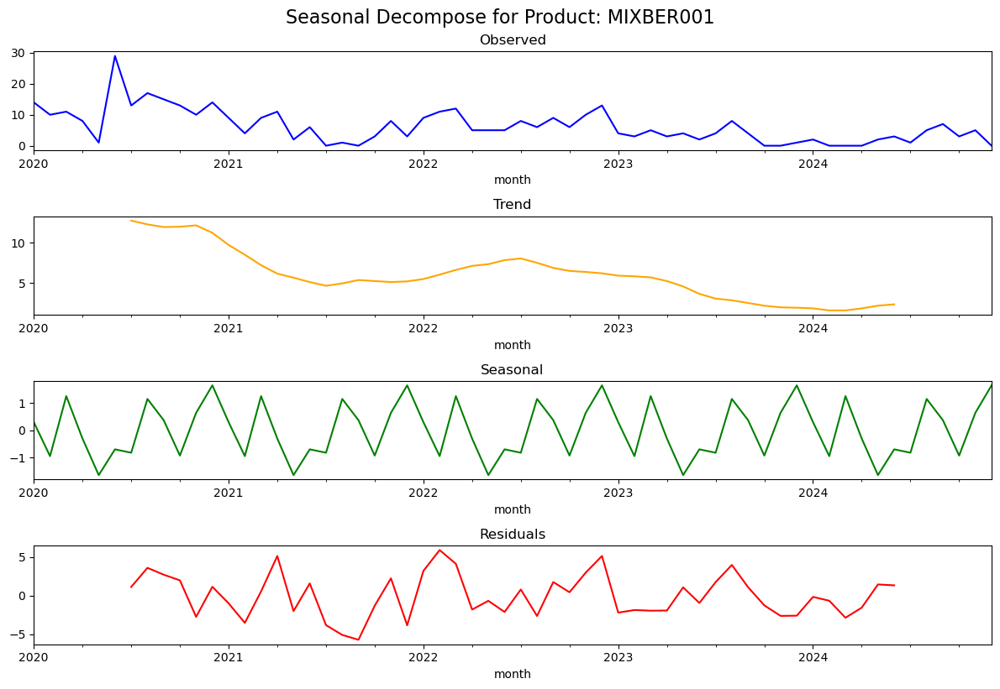

Seasonal Decomposing for Product: MIXBER003


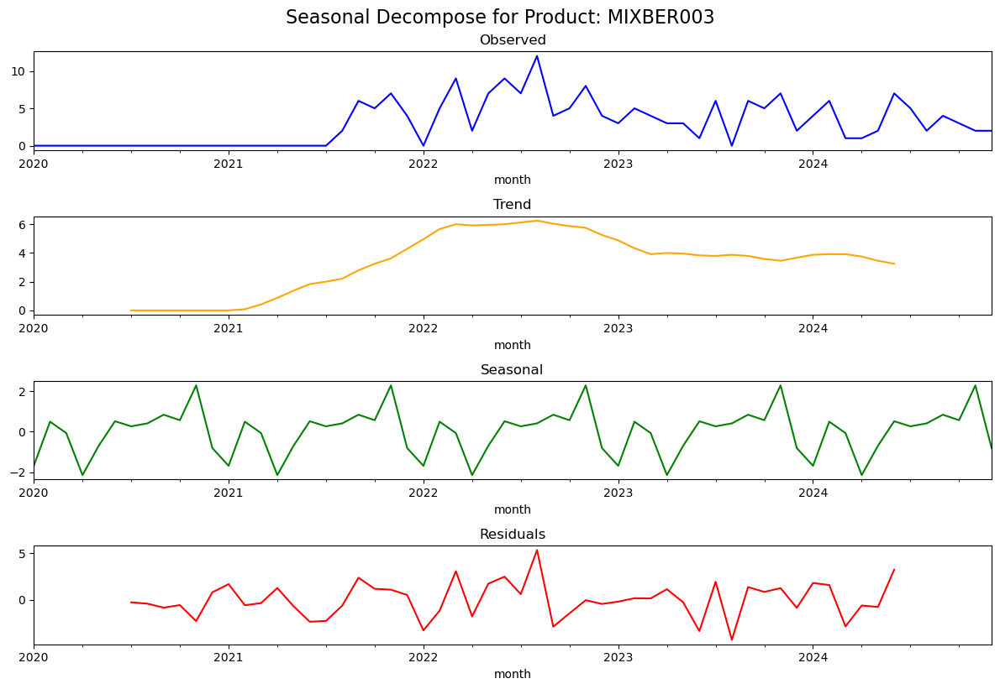

Seasonal Decomposing for Product: OVEBER002


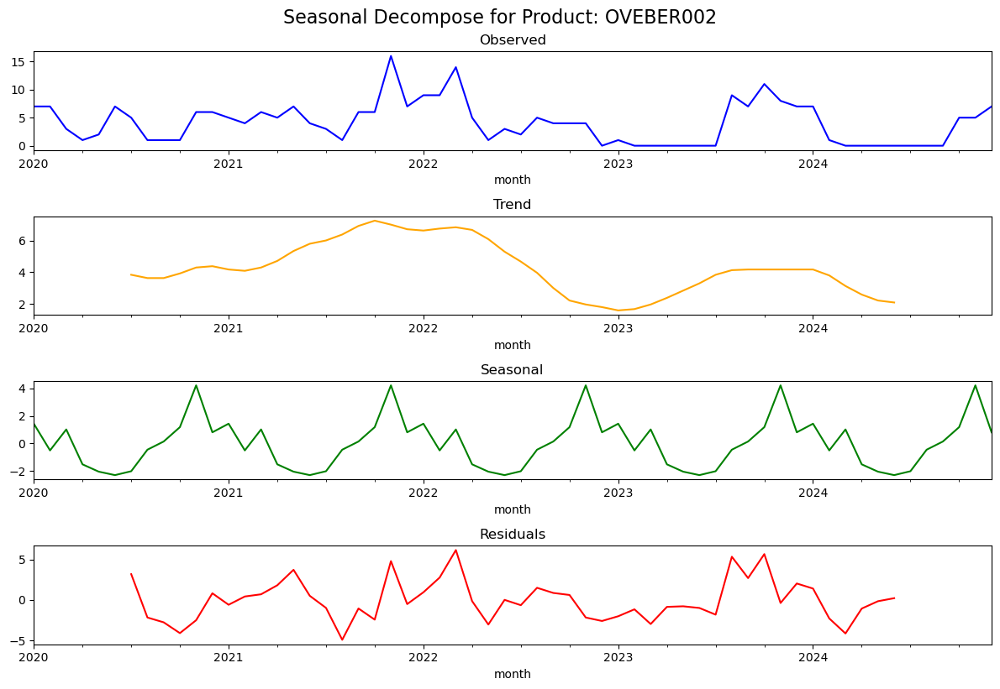

Seasonal Decomposing for Product: OVEBER005


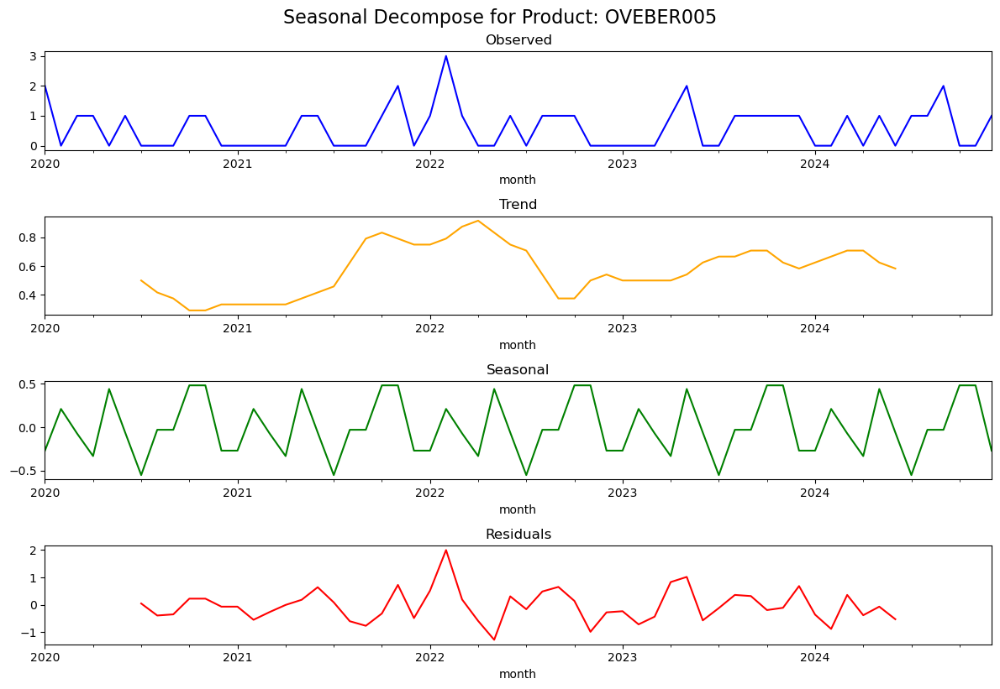

Seasonal Decomposing for Product: OVEBER006


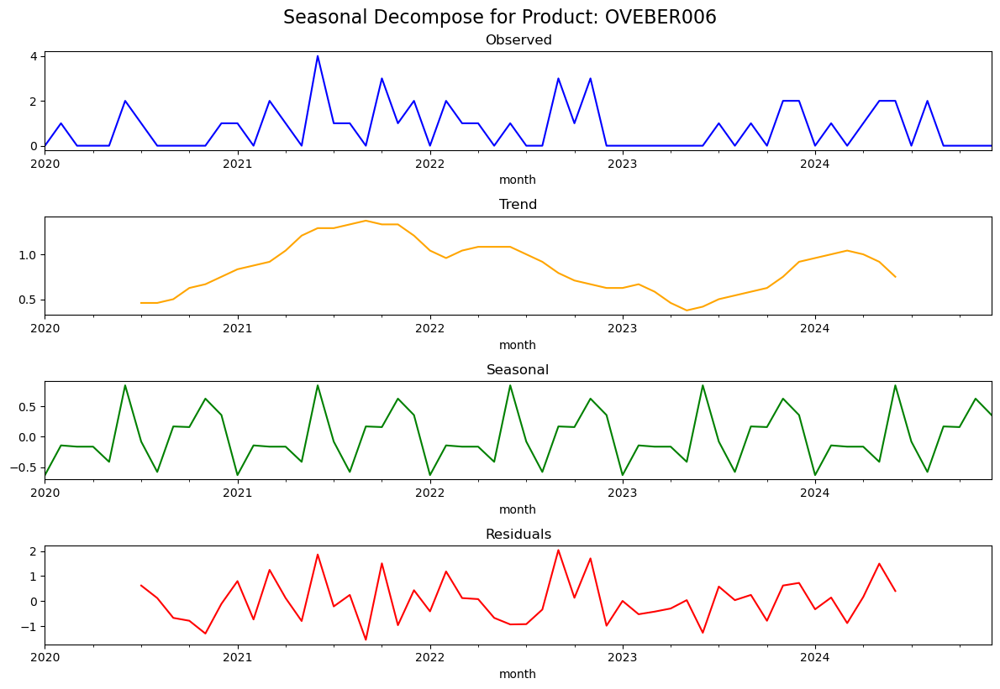

Seasonal Decomposing for Product: OVEBER011


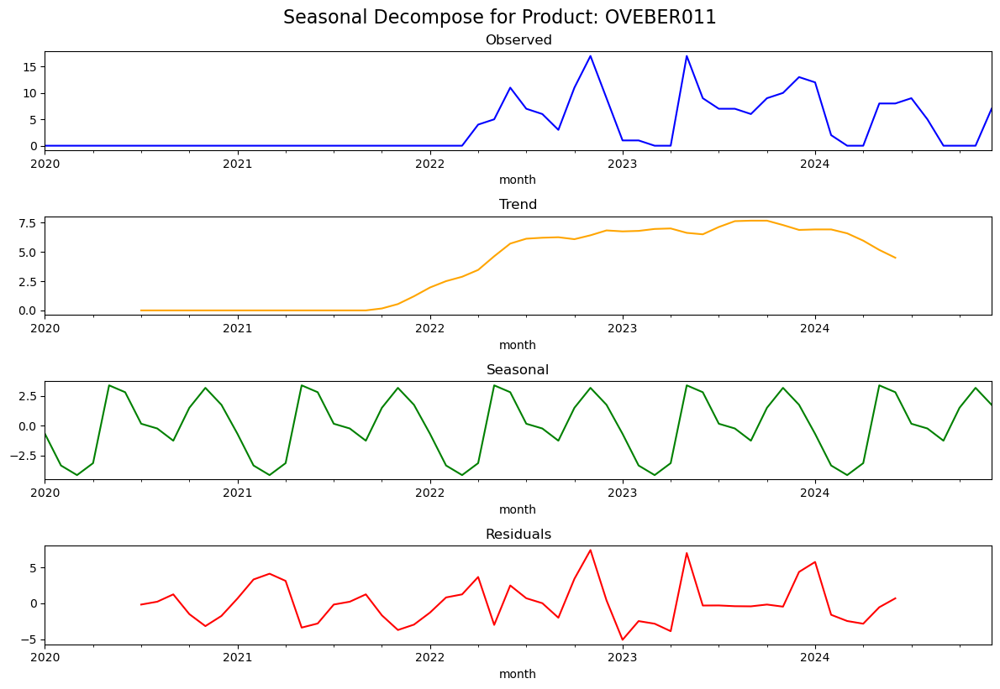

Seasonal Decomposing for Product: OVEBER012


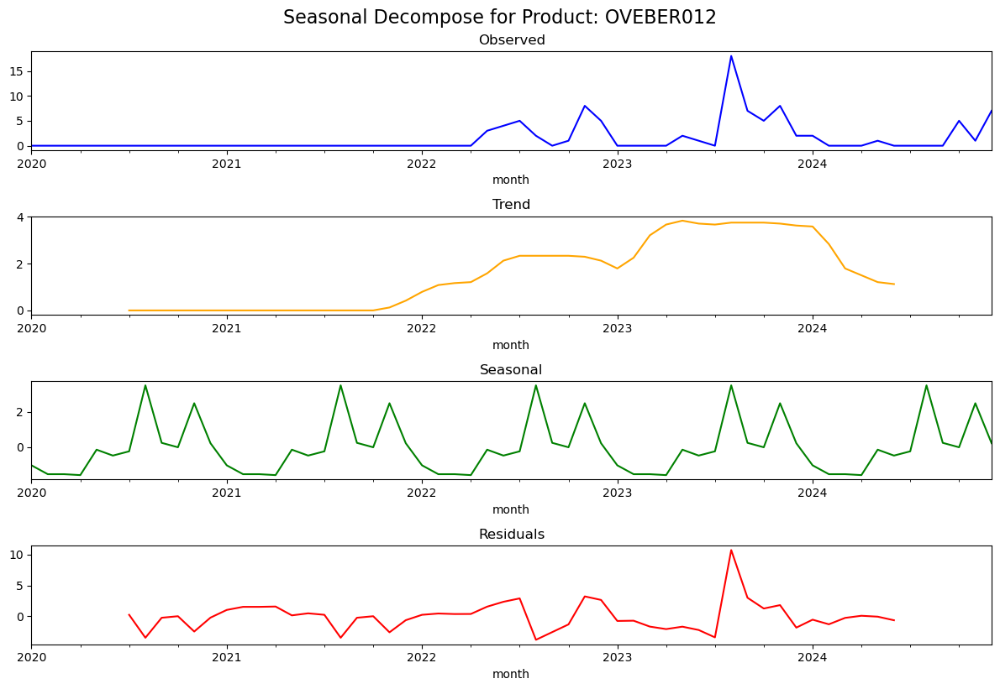

Seasonal Decomposing for Product: OVEBER013


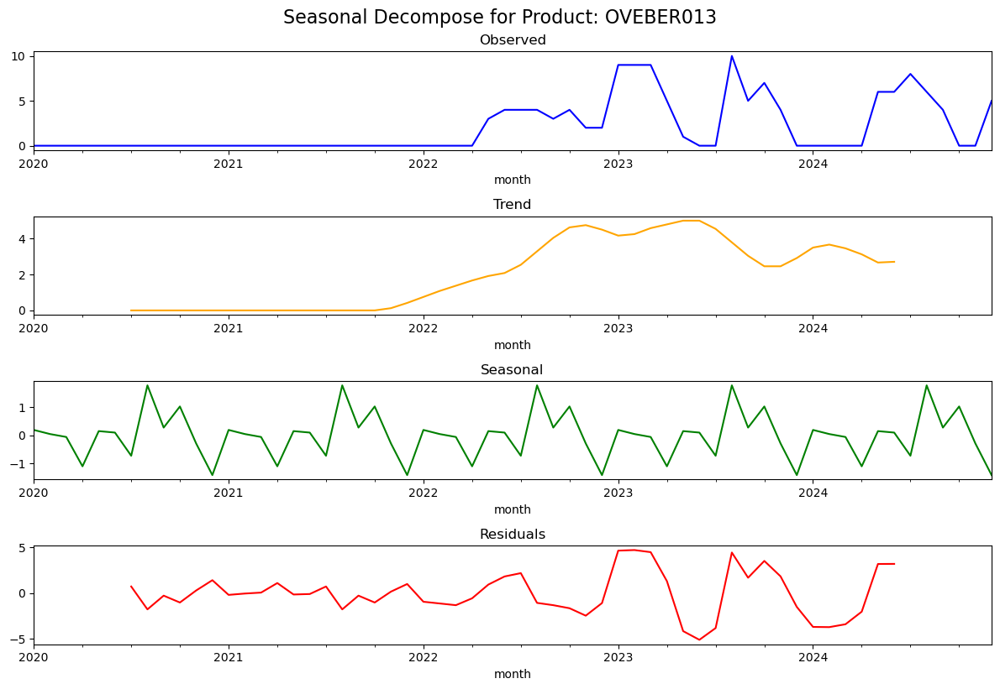

Seasonal Decomposing for Product: OVEBER014


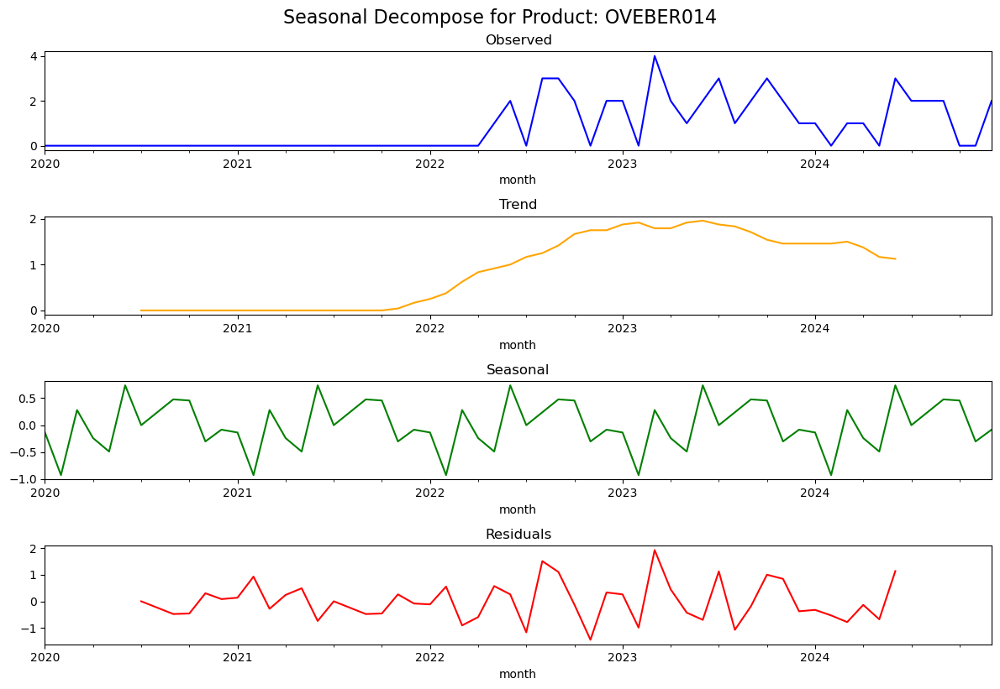

Seasonal Decomposing for Product: OVEBER015


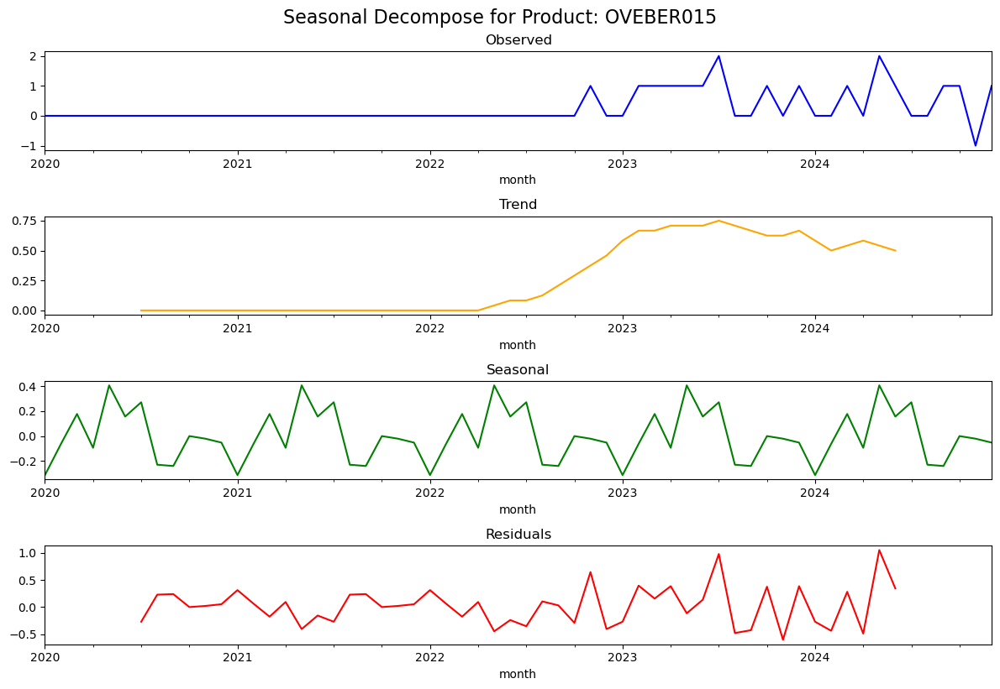

Seasonal Decomposing for Product: OVEBER016


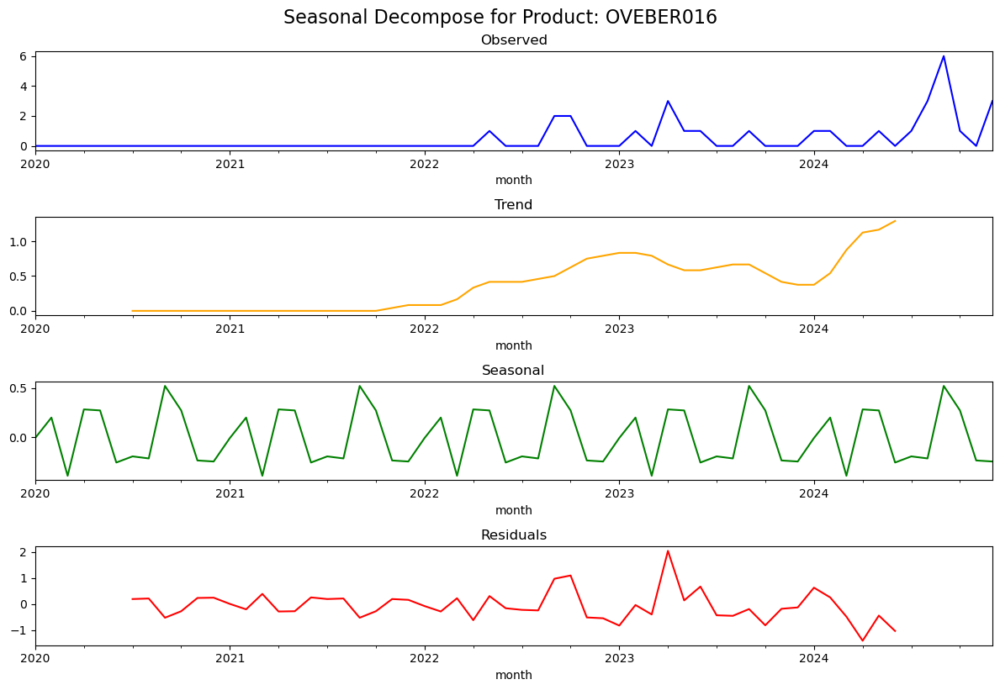

Seasonal Decomposing for Product: OVEBER017


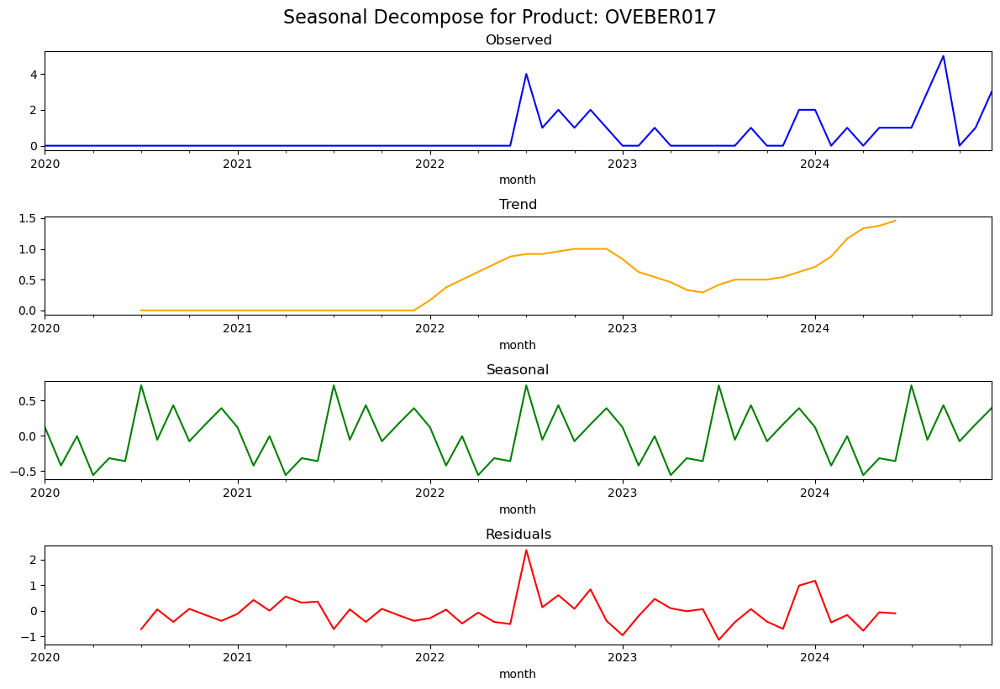

Seasonal Decomposing for Product: POPBER001


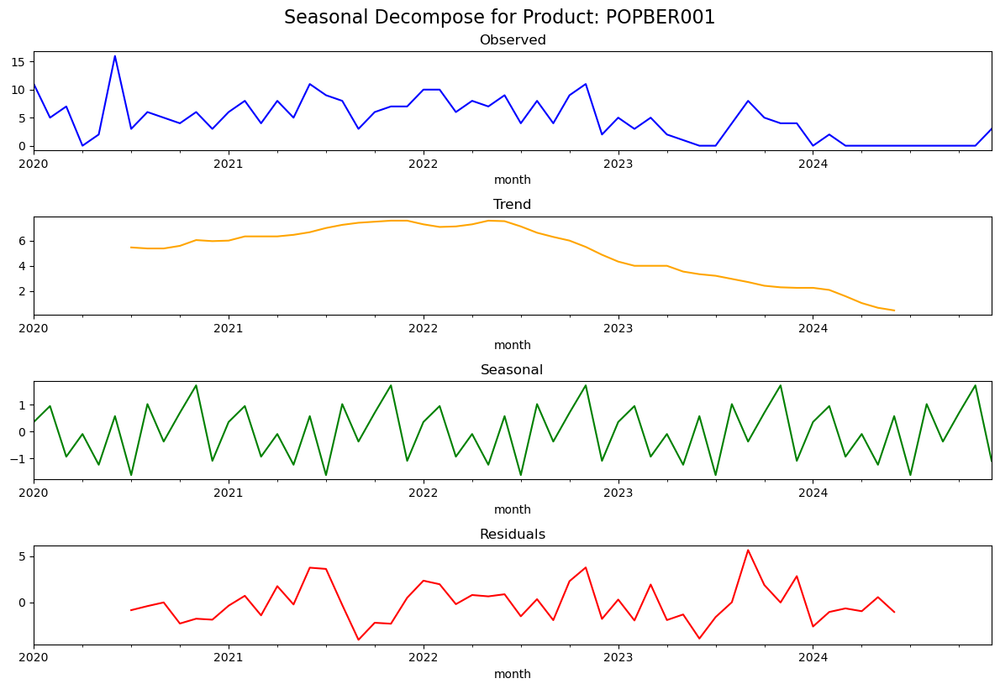

Seasonal Decomposing for Product: SOPBER001


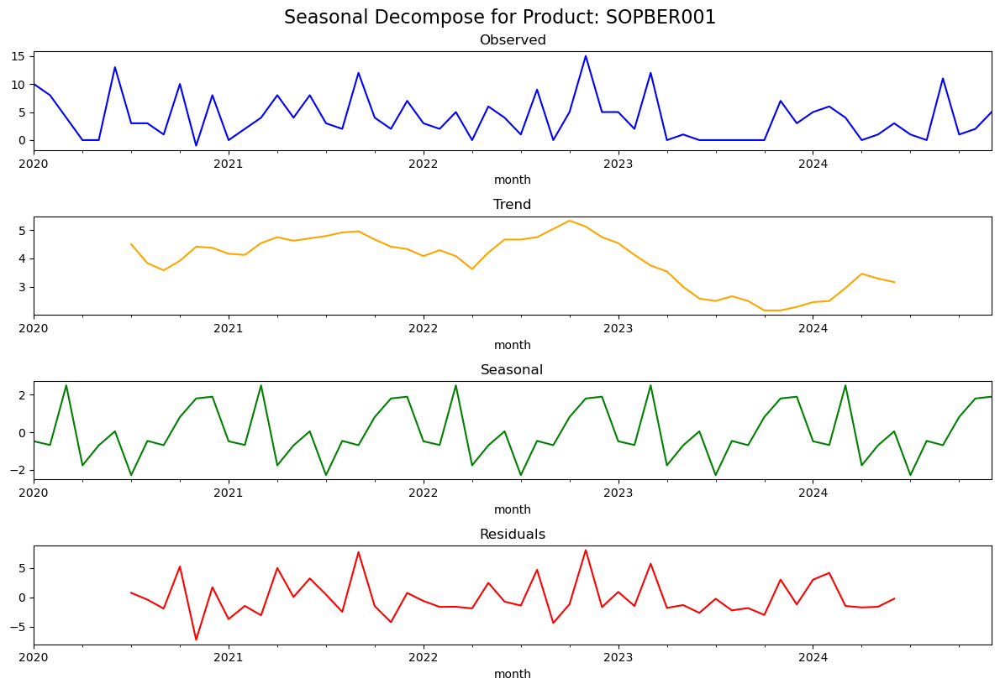

Seasonal Decomposing for Product: TROBER001


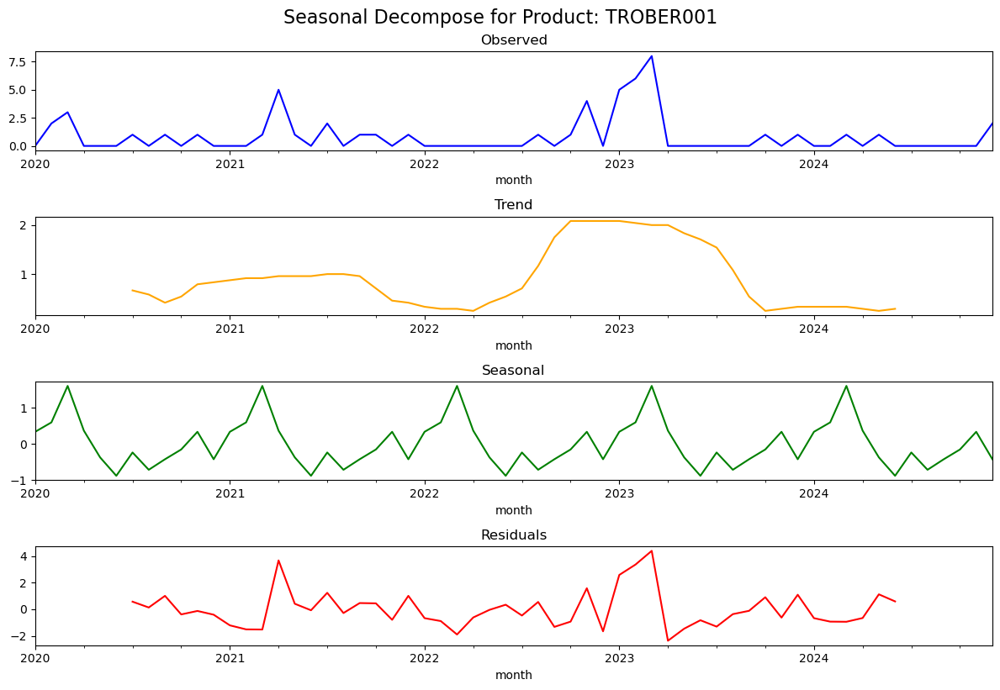

Seasonal Decomposing for Product: TROBER003


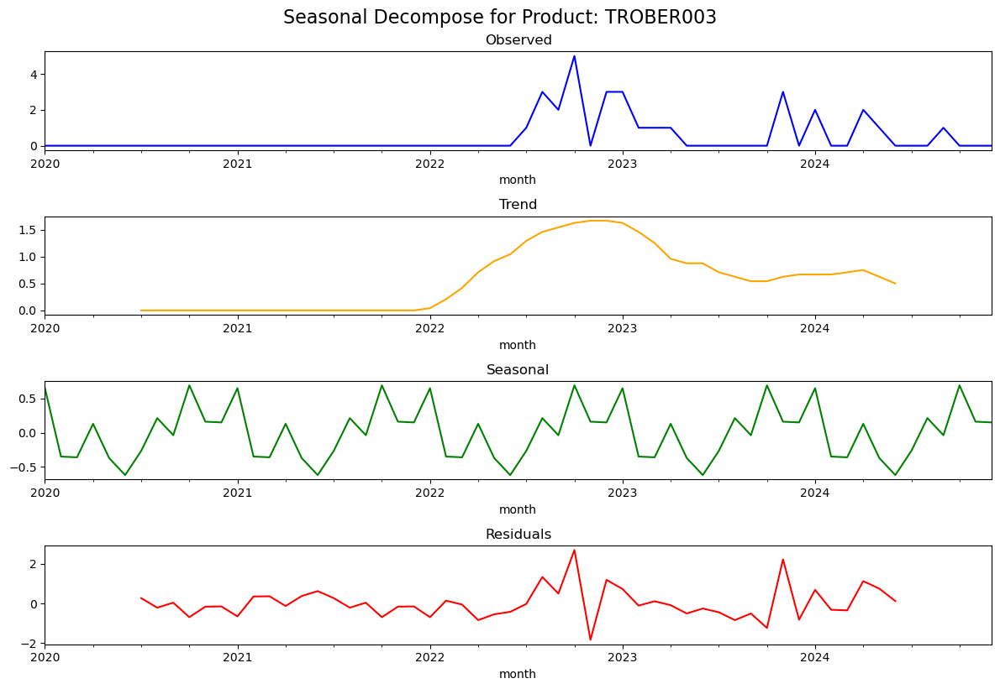

Seasonal Decomposing for Product: WARBER001


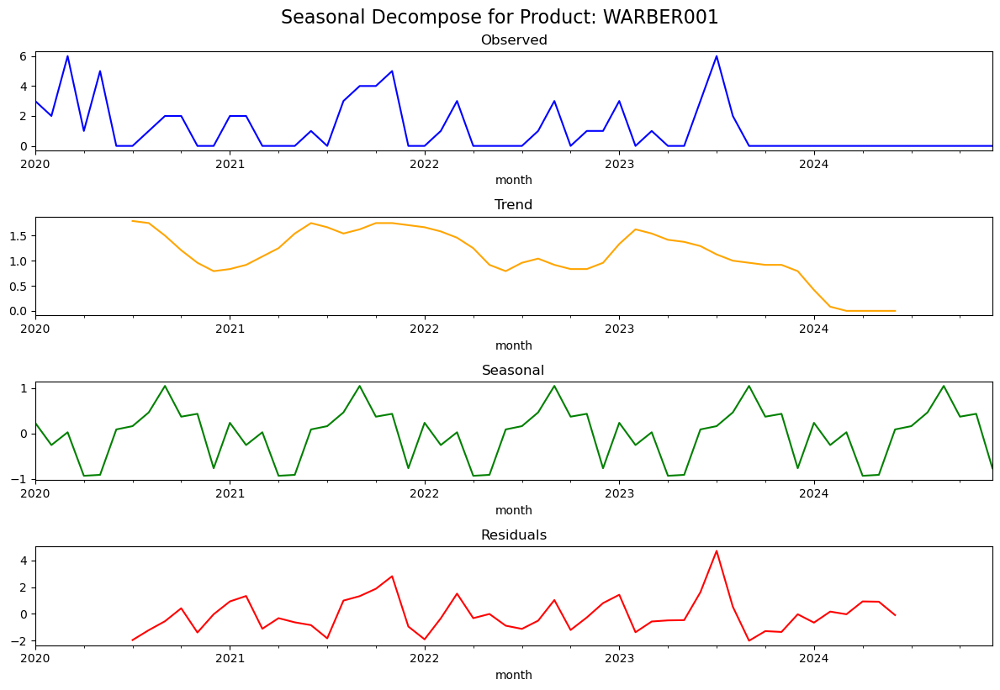

Seasonal Decomposing for Product: WARBER002


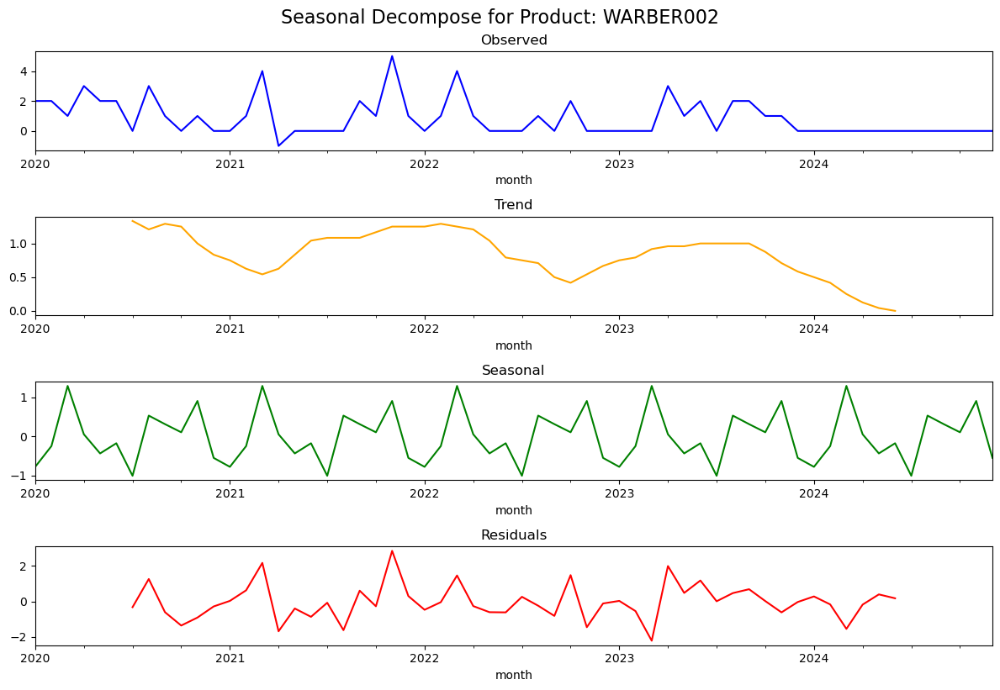

Seasonal Decomposing for Product: WARBER003


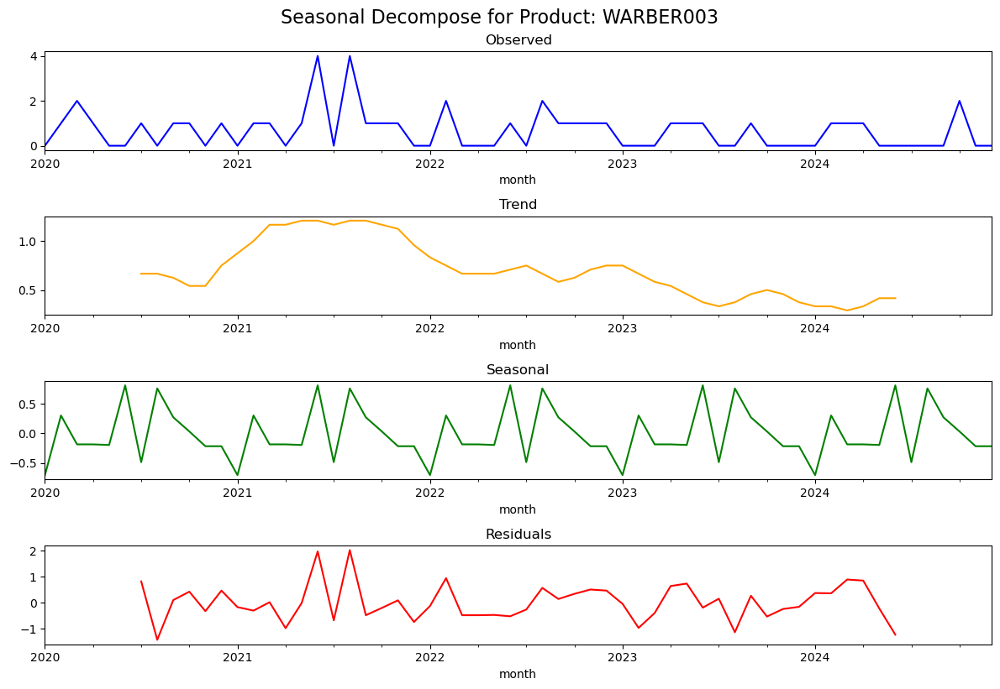

Seasonal Decomposing for Product: WARBER004


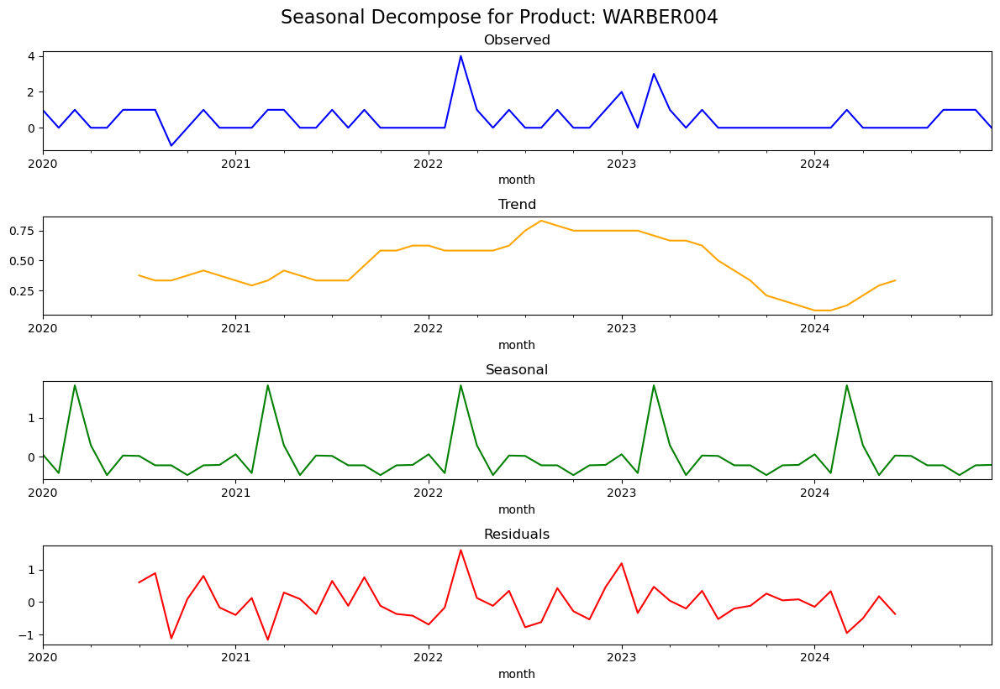

Seasonal Decomposing for Product: WARBER005


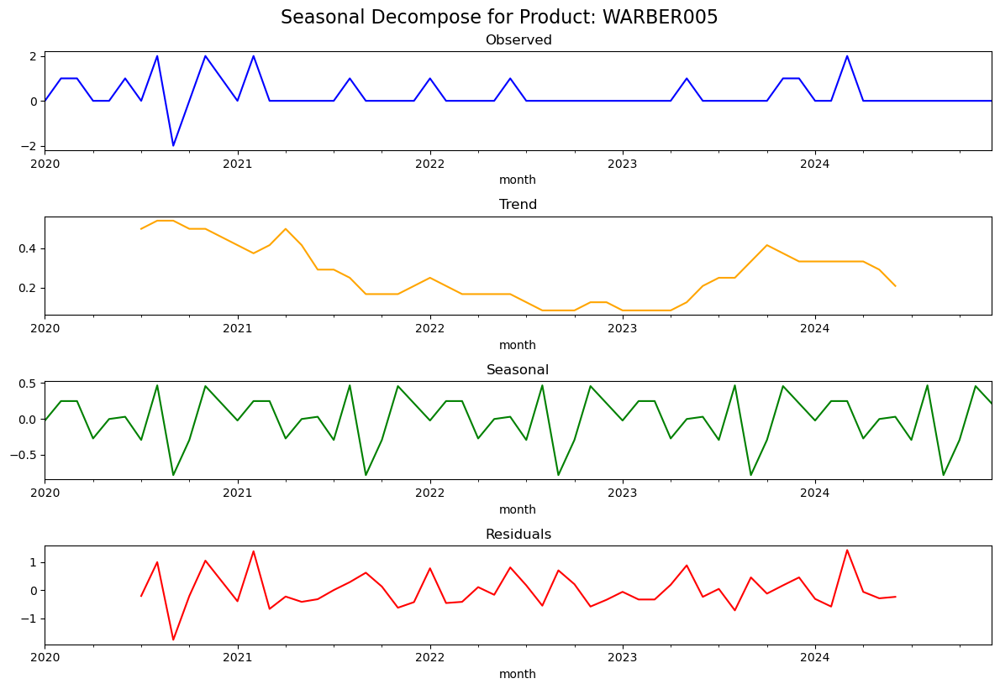

Seasonal Decomposing for Product: WARBER006


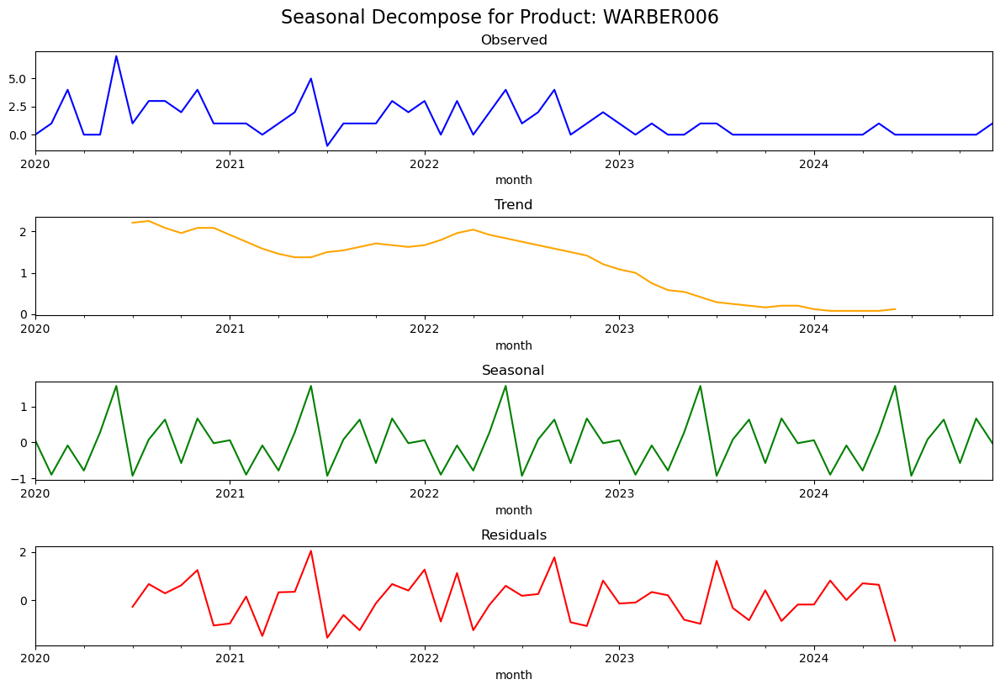

Seasonal Decomposing for Product: WARBER009


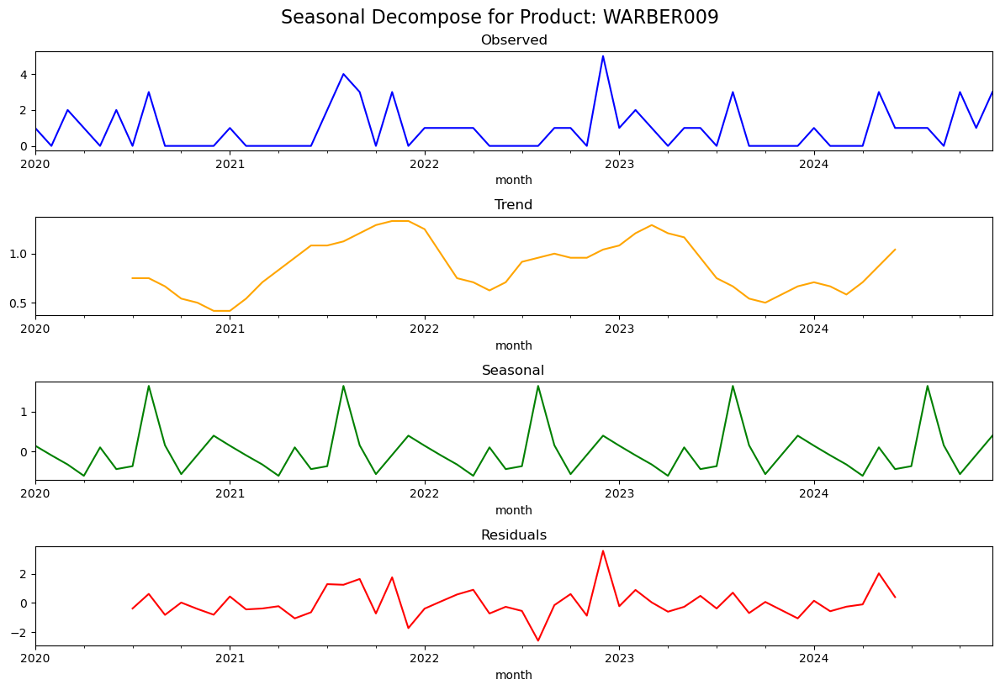

Seasonal Decomposing for Product: WARBER010


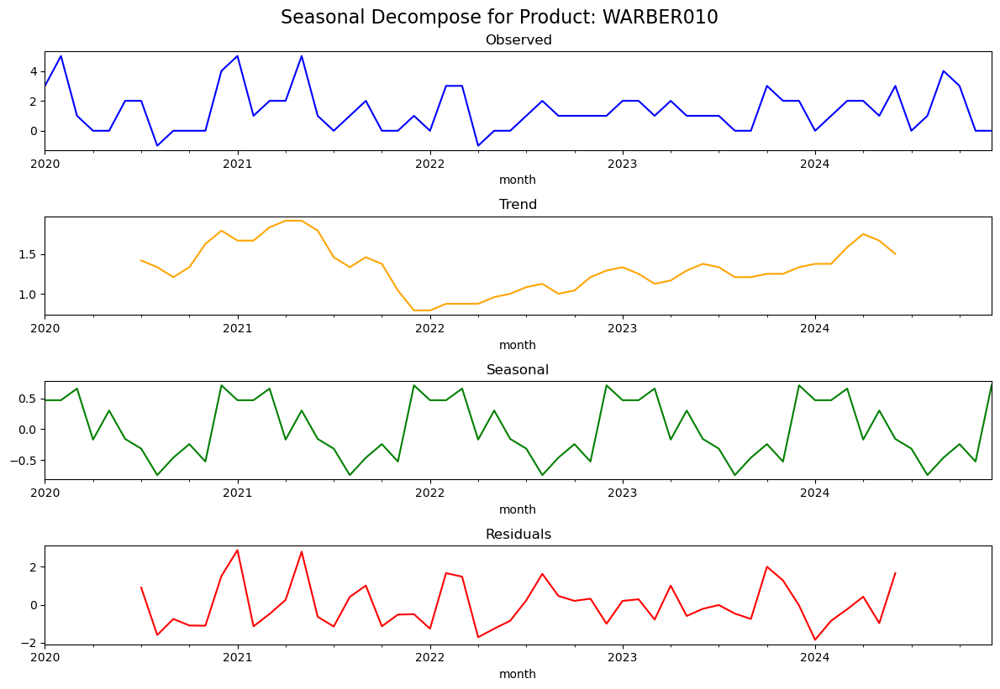

Seasonal Decomposing for Product: WARBER011


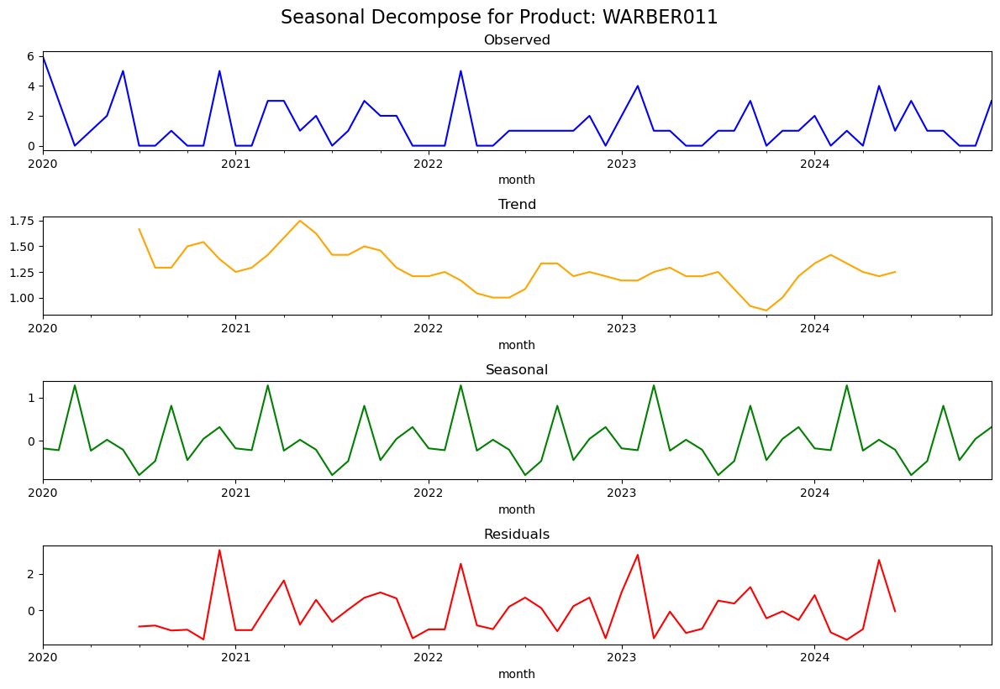

Seasonal Decomposing for Product: WARBER012


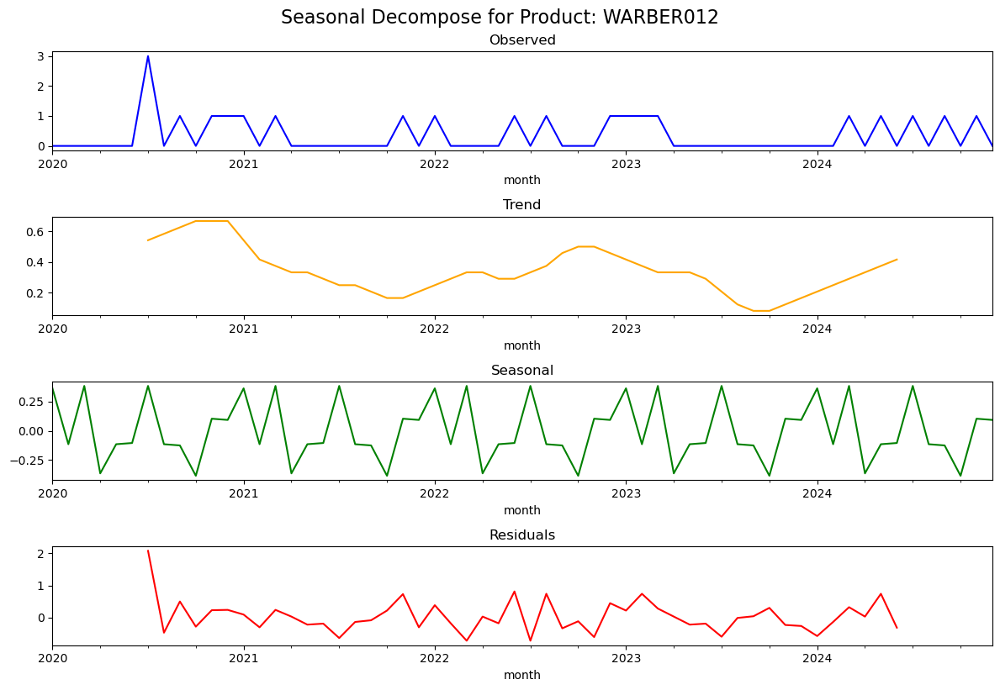

Seasonal Decomposing for Product: WARBER013


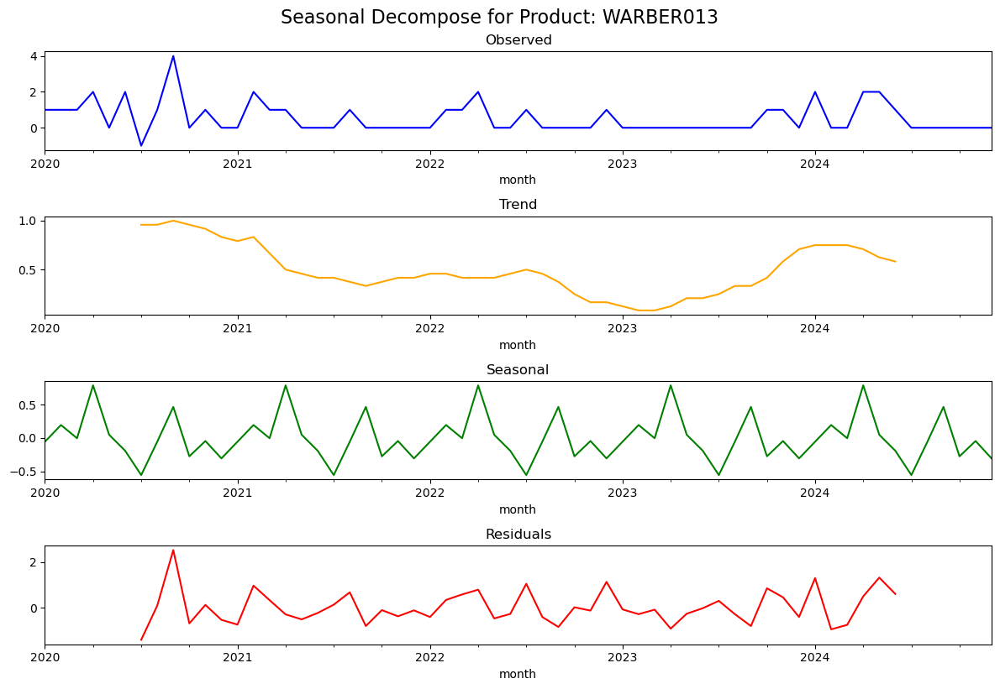

Seasonal Decomposing for Product: WARBER015


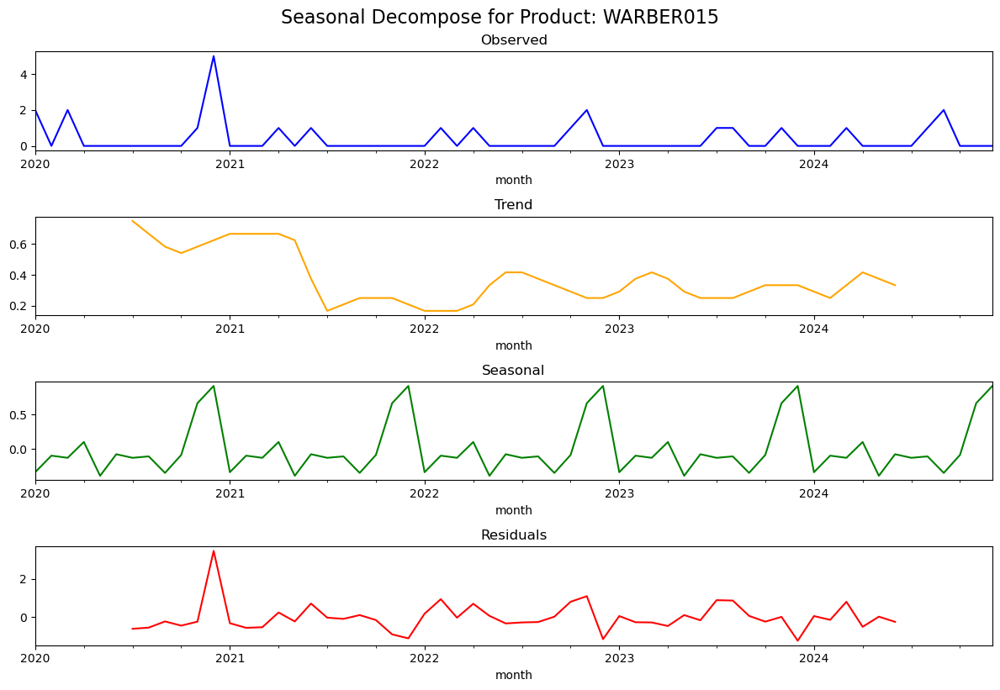

Seasonal Decomposing for Product: WARBER016


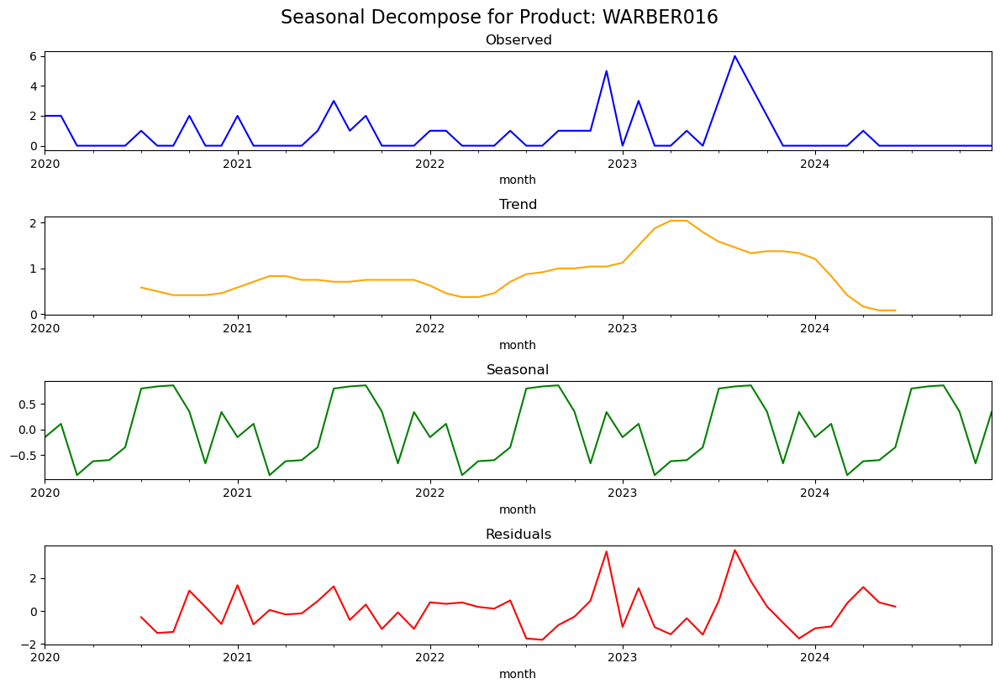

Seasonal Decomposing for Product: WARBER022


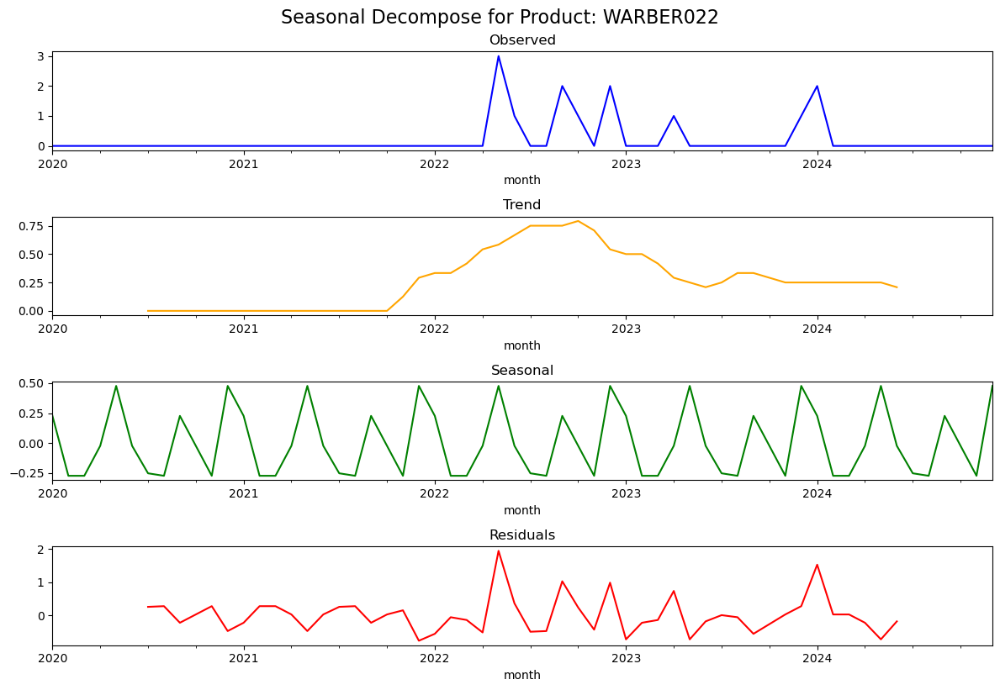

Seasonal Decomposing for Product: WARBER023


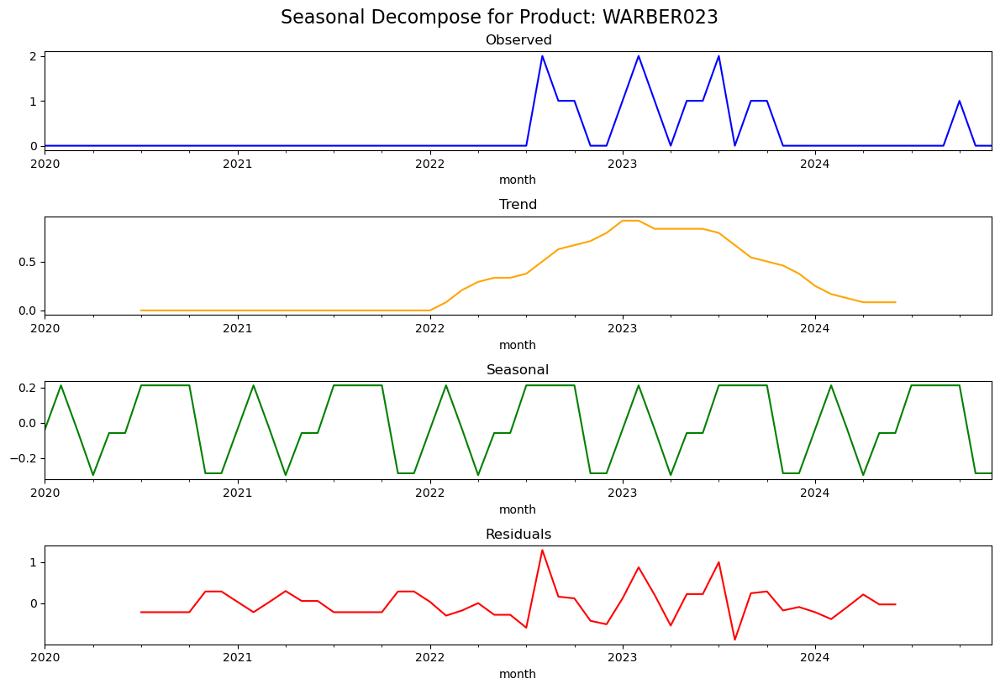

Seasonal Decomposing for Product: WARBER024


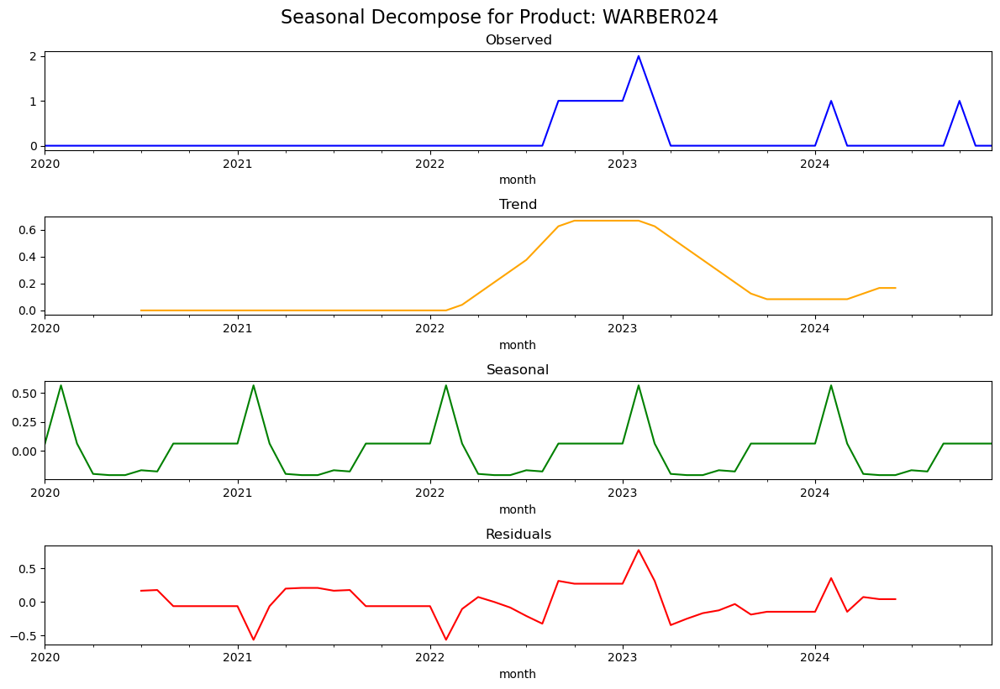

In [39]:
# Function to perform seasonal decomposition and plot results
def seasonal_decompose_and_plot(data, product_number, period):
    
    # Filter data for the specific product
    filtered_data = data[data['ProductNumber'] == product_number]
    
    if filtered_data.empty:
        print(f"No data available for Product: {product_number}")
        return None

    # Ensure time series data is properly indexed
    filtered_data.loc[:,'month'] = pd.to_datetime(filtered_data['month'])  # Convert to datetime
    filtered_data = filtered_data.sort_values('month').set_index('month')  # Set 'month' as index
    
    # Seasonal decomposition
    result = seasonal_decompose(filtered_data['Sum of InvoicedQuantity'], period=period)

    # Plot the results
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(12, 8))
    result.observed.plot(ax=ax1, title='Observed', color='blue')
    result.trend.plot(ax=ax2, title='Trend', color='orange')
    result.seasonal.plot(ax=ax3, title='Seasonal', color='green')
    result.resid.plot(ax=ax4, title='Residuals', color='red')
    plt.tight_layout()
    plt.suptitle(f"Seasonal Decompose for Product: {product_number}", y=1.02, fontsize=16)
    plt.show()
    return

# Get unique product combinations
product_combinations = data_filled[['ProductNumber']].drop_duplicates()

# Perform seasonal decomposition for all products; Seasonal period is 12 for monthly data.
for _, row in product_combinations.iterrows():
    ProductNumber = row['ProductNumber']
    print(f"Seasonal Decomposing for Product: {ProductNumber}")
    seasonal_decompose_and_plot(data_filled, ProductNumber, period=12)


## SARIMAX forecasting

Forecasting for Item: BOLBER001
MAE: 0.9166666666666666, MSE: 0.9166666666666666, RMSE: 0.9574271077563381
Execution time: 0.80 seconds


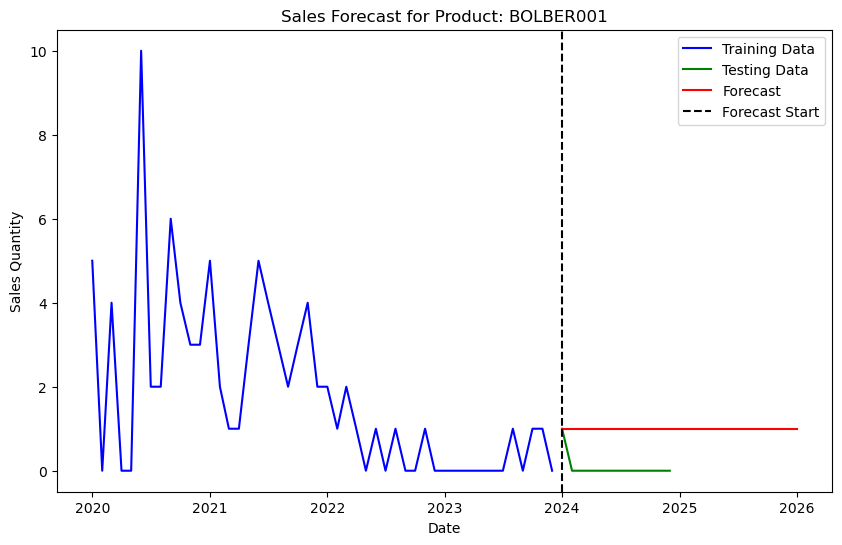

Forecasting for Item: BOLBER002
MAE: 0.9166666666666666, MSE: 0.9166666666666666, RMSE: 0.9574271077563381
Execution time: 0.03 seconds


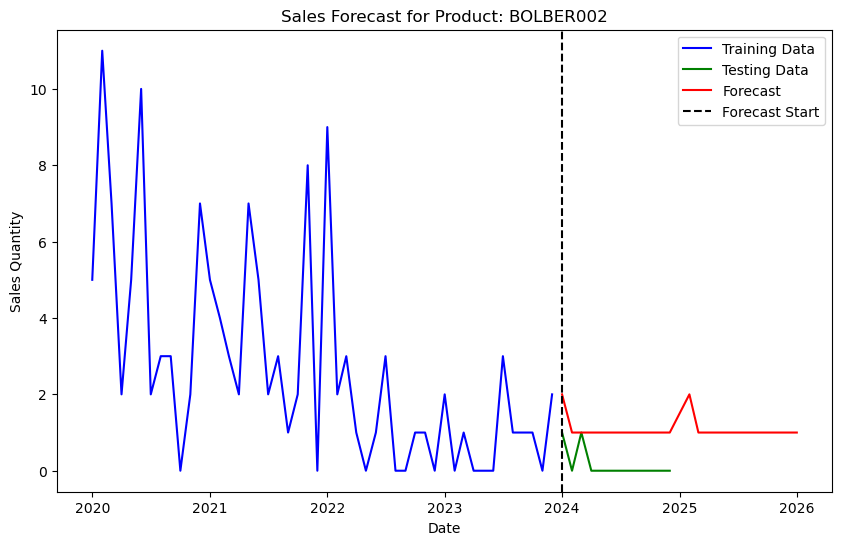

Forecasting for Item: BOLBER003
MAE: 0.75, MSE: 1.25, RMSE: 1.118033988749895
Execution time: 0.04 seconds


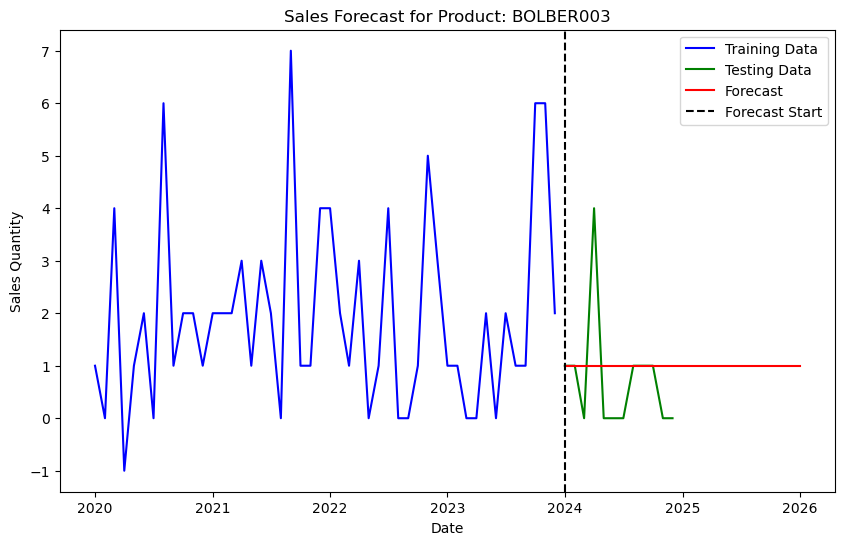

Forecasting for Item: BOLBER005
MAE: 0.8333333333333334, MSE: 0.8333333333333334, RMSE: 0.9128709291752769
Execution time: 0.08 seconds


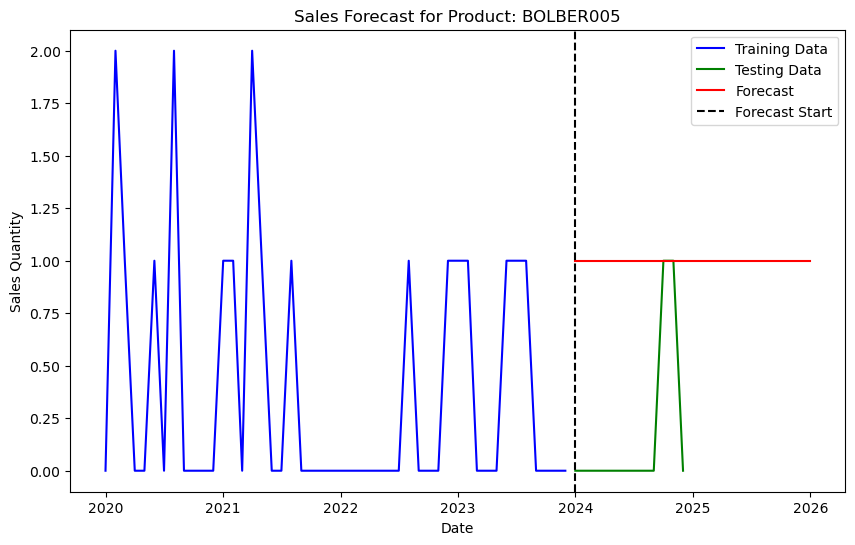

Forecasting for Item: BURBER001
MAE: 0.5833333333333334, MSE: 0.5833333333333334, RMSE: 0.7637626158259734
Execution time: 0.03 seconds


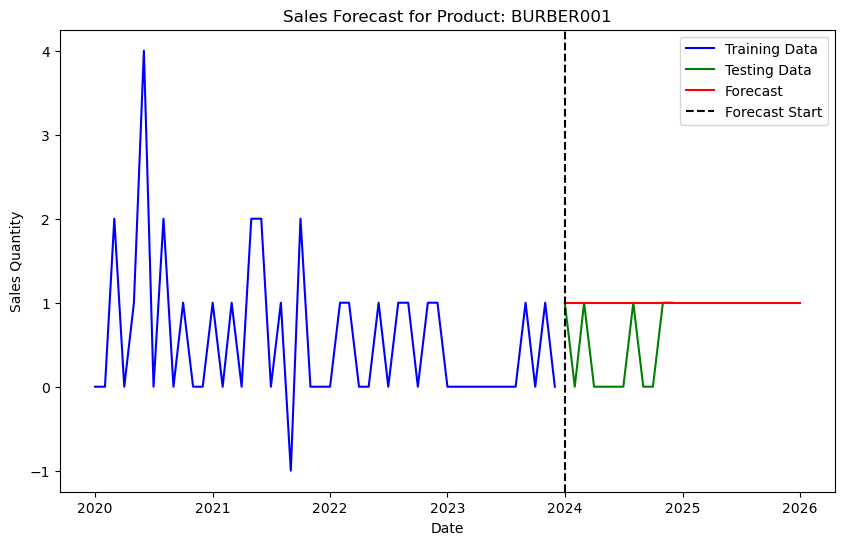

Forecasting for Item: BURBER002
MAE: 1.1666666666666667, MSE: 2.3333333333333335, RMSE: 1.5275252316519468
Execution time: 0.03 seconds


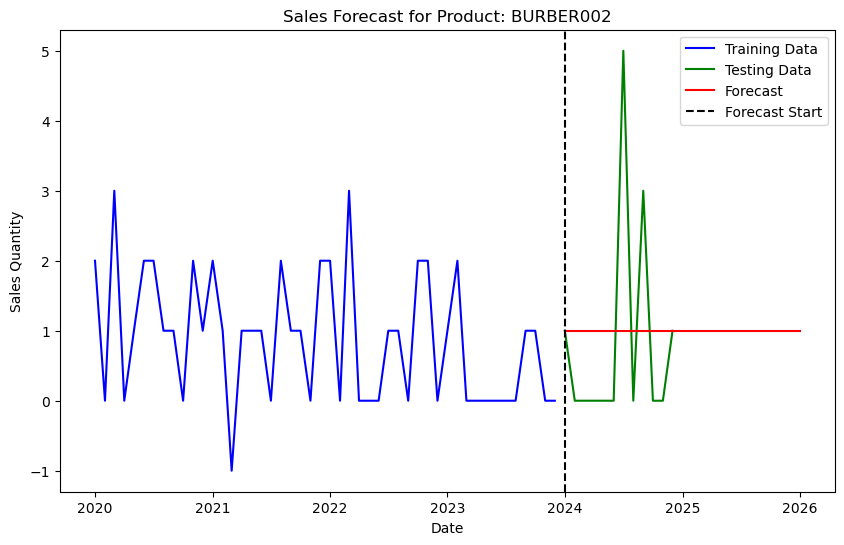

Forecasting for Item: BURBER003
MAE: 0.75, MSE: 0.75, RMSE: 0.8660254037844386
Execution time: 0.03 seconds


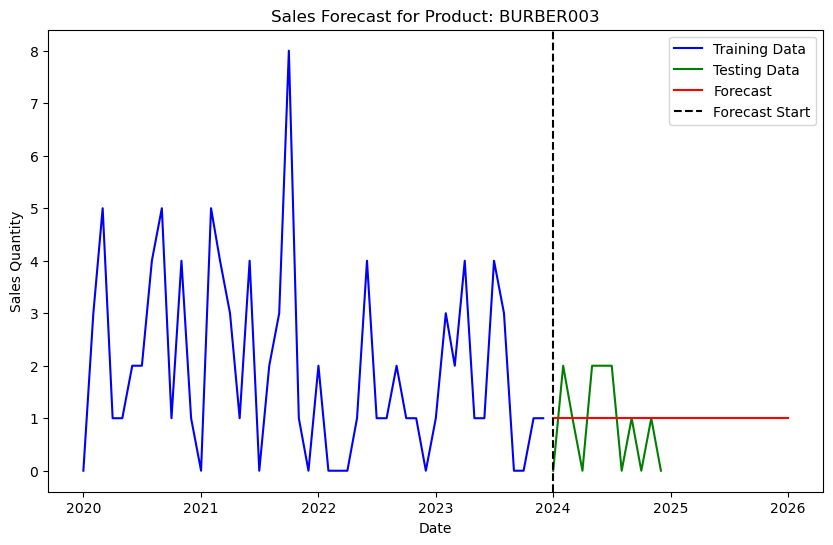

Forecasting for Item: BURBER004
MAE: 1.0, MSE: 3.0, RMSE: 1.7320508075688772
Execution time: 0.04 seconds


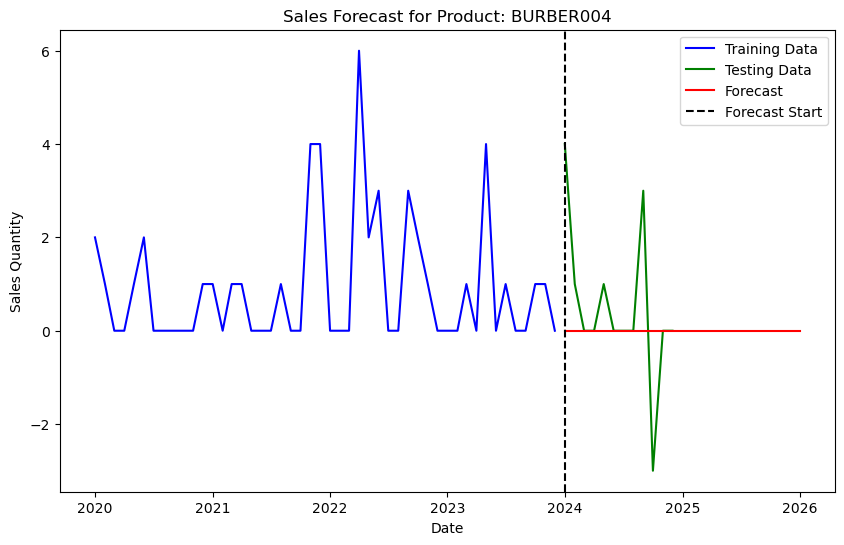

Forecasting for Item: BURBER007
MAE: 0.8333333333333334, MSE: 0.8333333333333334, RMSE: 0.9128709291752769
Execution time: 0.04 seconds


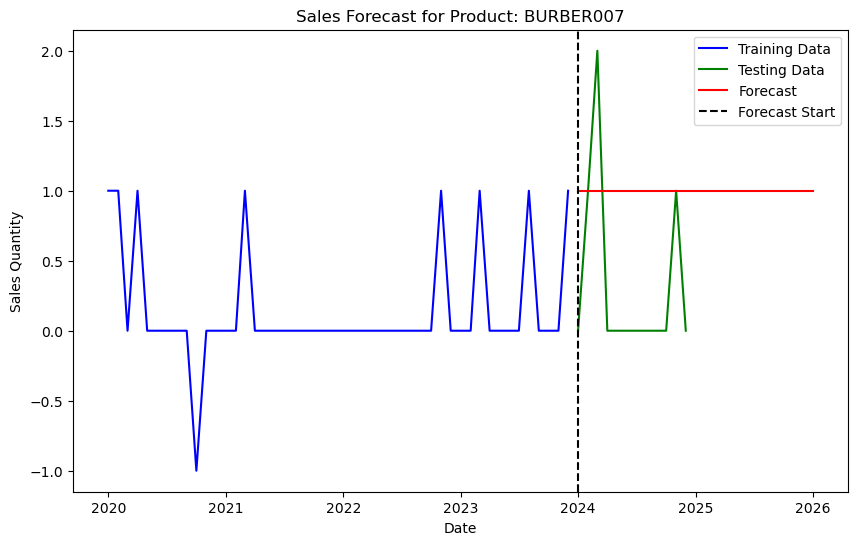

Forecasting for Item: COFBER001
MAE: 7.5, MSE: 95.33333333333333, RMSE: 9.763879010584539
Execution time: 0.03 seconds


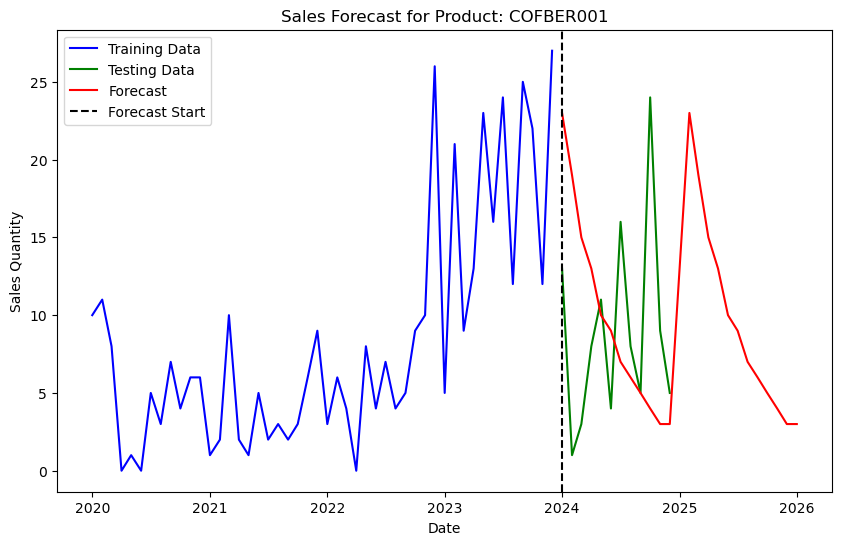

Forecasting for Item: COKBER001
MAE: 5.25, MSE: 64.41666666666667, RMSE: 8.025999418556339
Execution time: 0.03 seconds


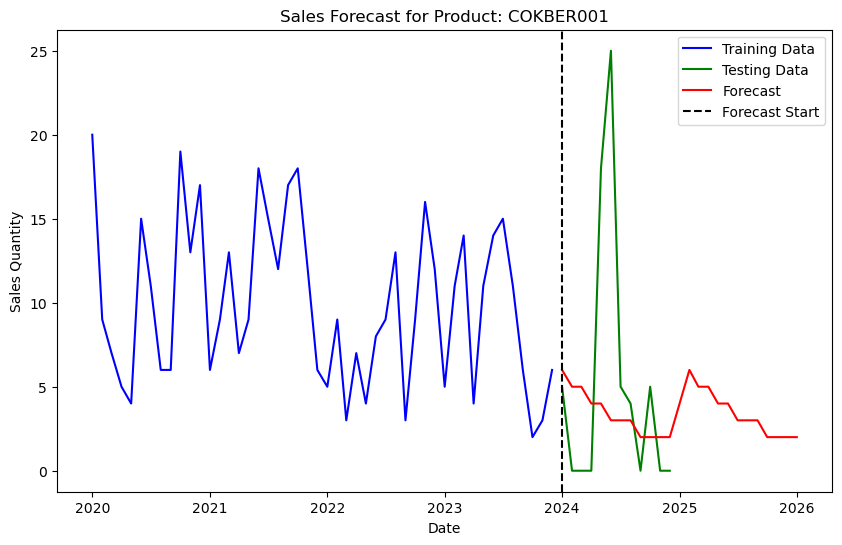

Forecasting for Item: FRYBER002
MAE: 2.9166666666666665, MSE: 15.583333333333334, RMSE: 3.947573094109004
Execution time: 0.06 seconds


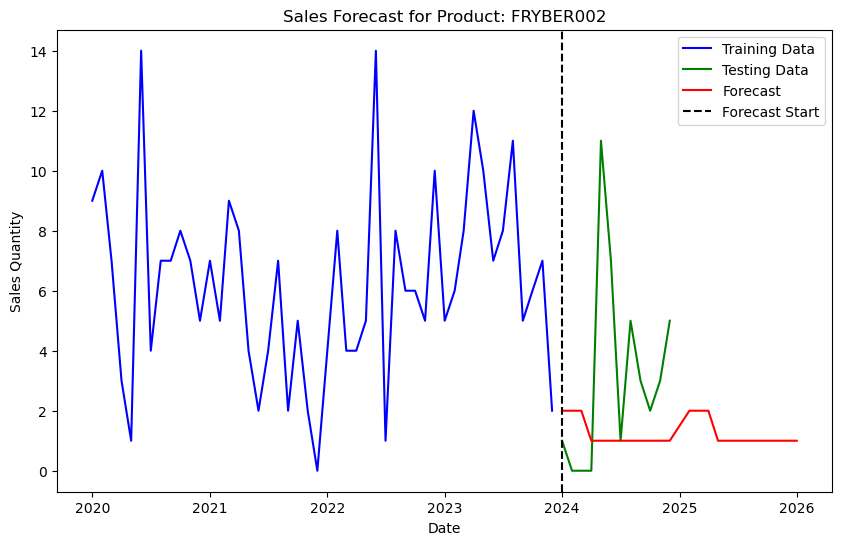

Forecasting for Item: FRYBER003
MAE: 3.1666666666666665, MSE: 23.666666666666668, RMSE: 4.864839839775475
Execution time: 0.03 seconds


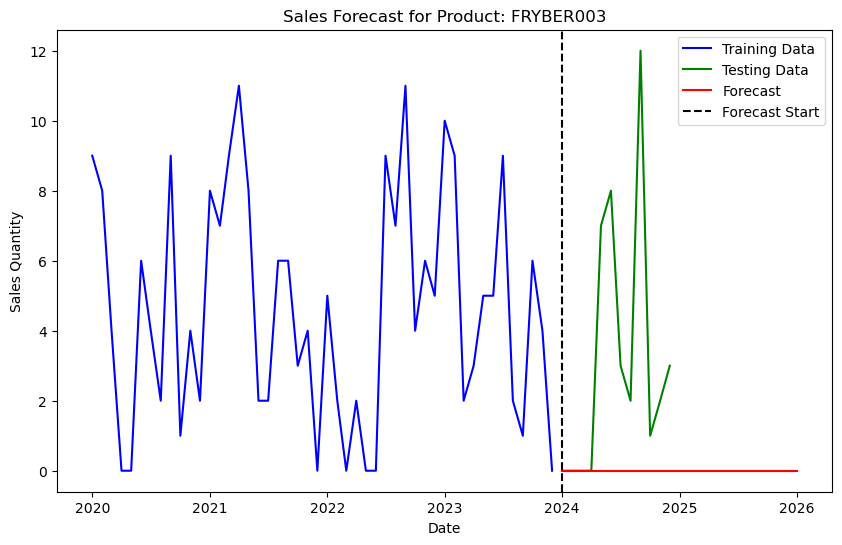

Forecasting for Item: FRYBER005
MAE: 5.583333333333333, MSE: 64.58333333333333, RMSE: 8.036375634160796
Execution time: 0.03 seconds


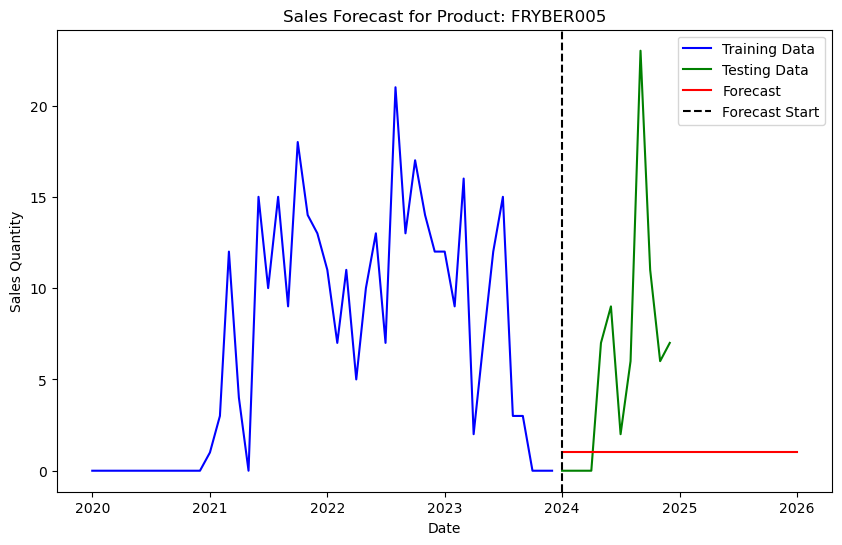

Forecasting for Item: GRLBER003
MAE: 3.8333333333333335, MSE: 31.5, RMSE: 5.612486080160912
Execution time: 0.04 seconds


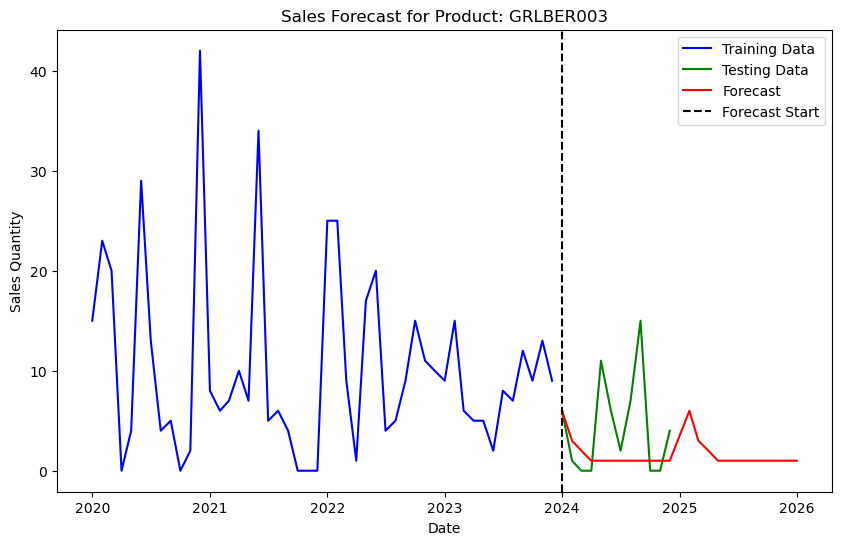

Forecasting for Item: GRLBER004
MAE: 2.8333333333333335, MSE: 11.666666666666666, RMSE: 3.415650255319866
Execution time: 0.03 seconds


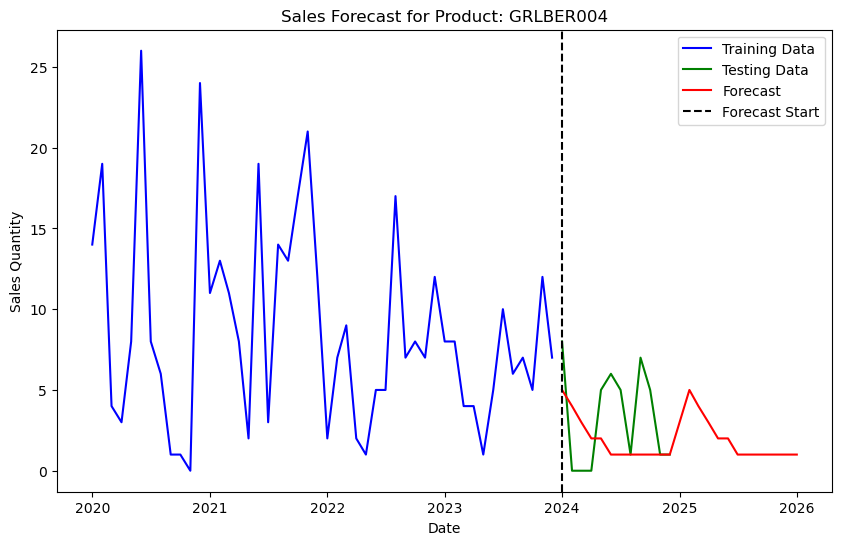

Forecasting for Item: GRLBER009
MAE: 1.1666666666666667, MSE: 2.3333333333333335, RMSE: 1.5275252316519468
Execution time: 0.03 seconds


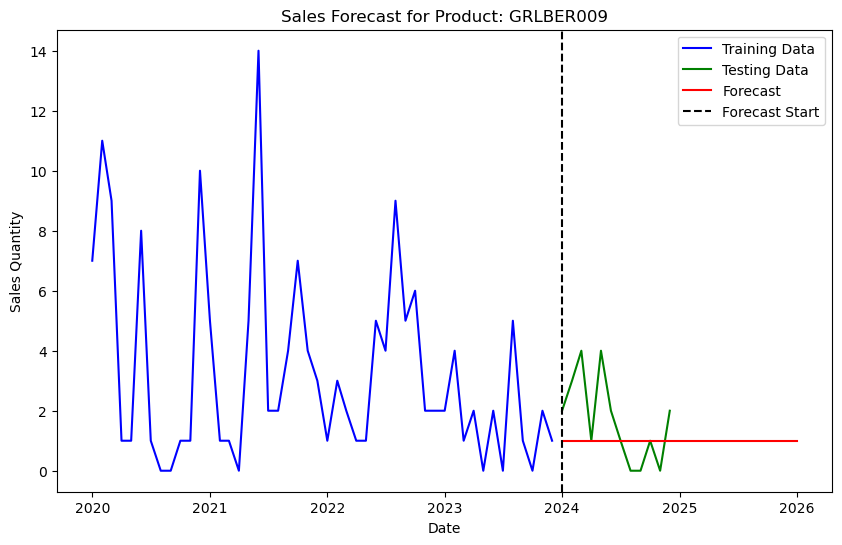

Forecasting for Item: GRLBER010
MAE: 0.5, MSE: 0.5, RMSE: 0.7071067811865476
Execution time: 0.04 seconds


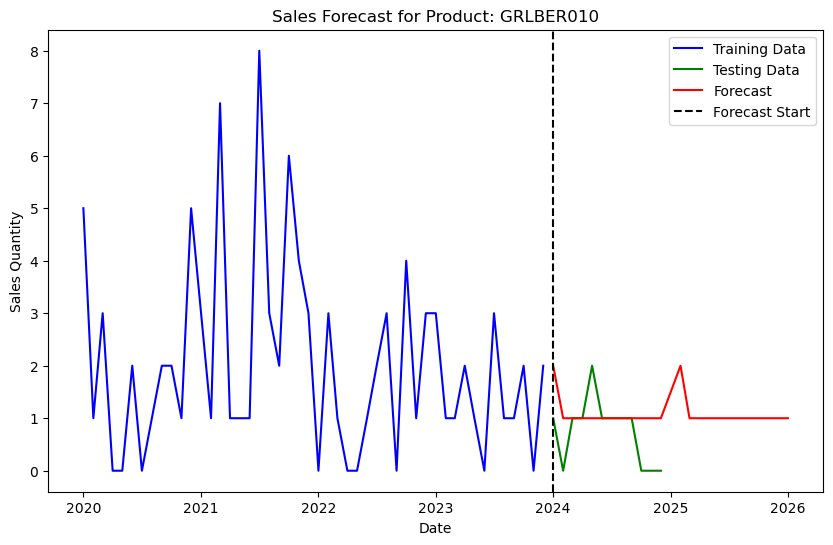

Forecasting for Item: GRLBER011
MAE: 1.5833333333333333, MSE: 5.583333333333333, RMSE: 2.362907813126304
Execution time: 0.07 seconds


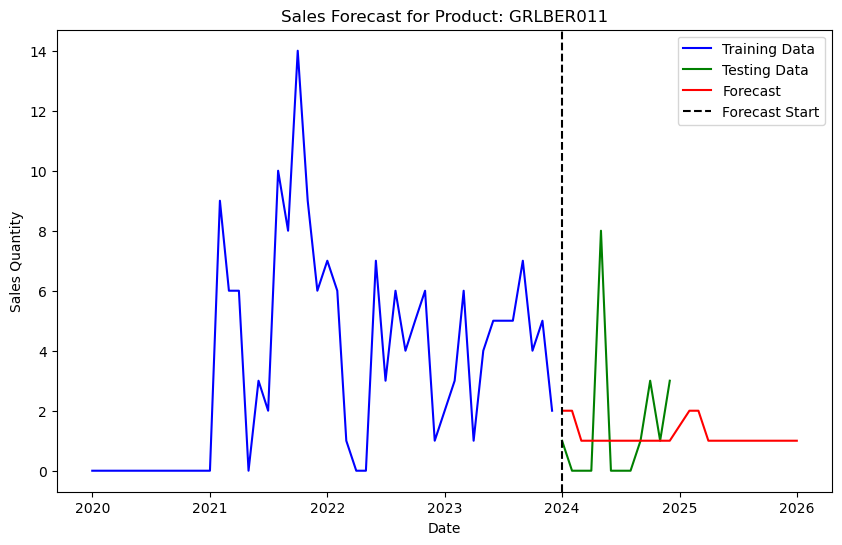

Forecasting for Item: GRLBER012
MAE: 1.0, MSE: 1.0, RMSE: 1.0
Execution time: 0.03 seconds


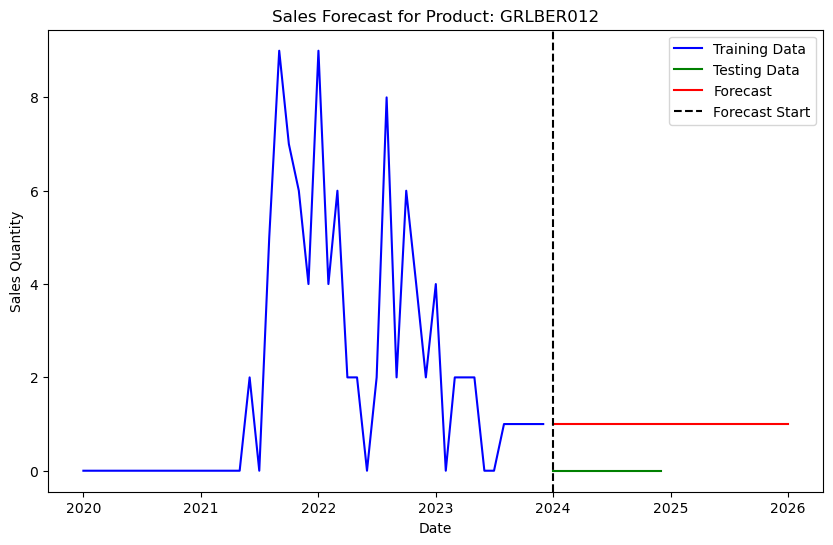

Forecasting for Item: GRLBER015
MAE: 2.1666666666666665, MSE: 7.833333333333333, RMSE: 2.798809270624444
Execution time: 0.03 seconds


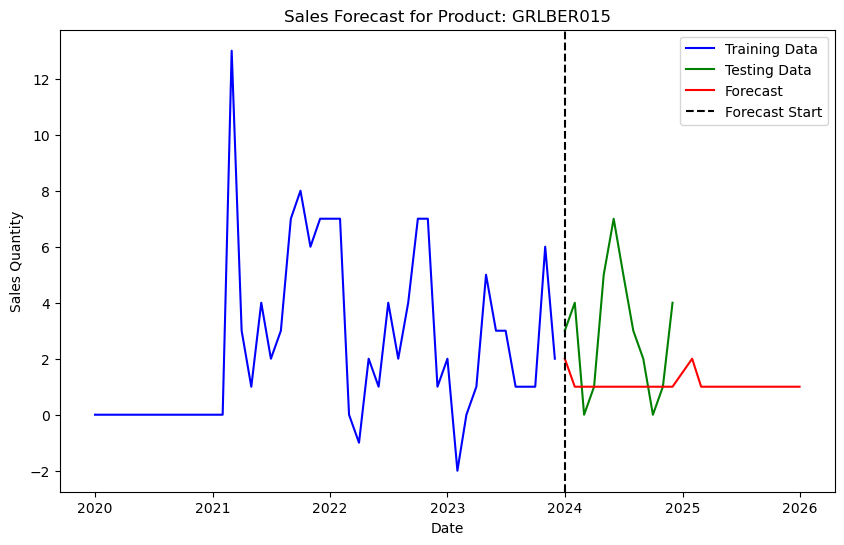

Forecasting for Item: GRLBER019
MAE: 0.75, MSE: 1.5833333333333333, RMSE: 1.2583057392117916
Execution time: 0.03 seconds


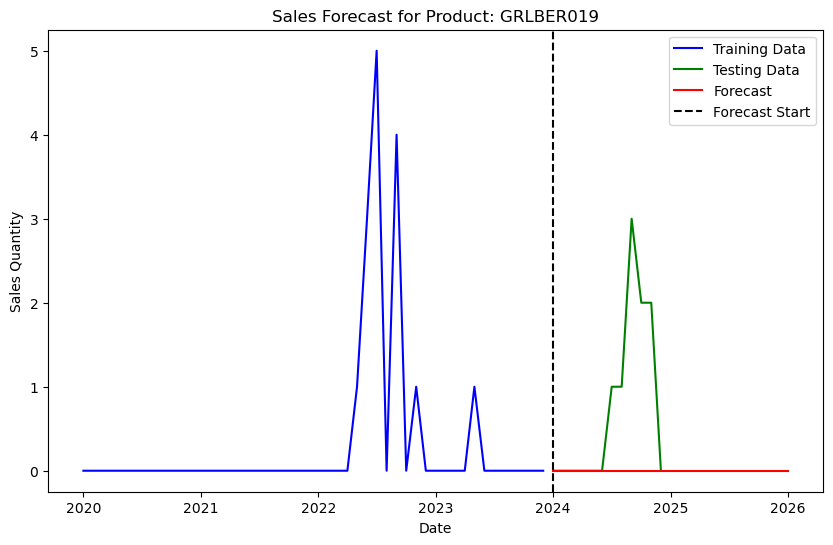

Forecasting for Item: GRLBER020
MAE: 0.75, MSE: 2.5833333333333335, RMSE: 1.6072751268321592
Execution time: 0.03 seconds


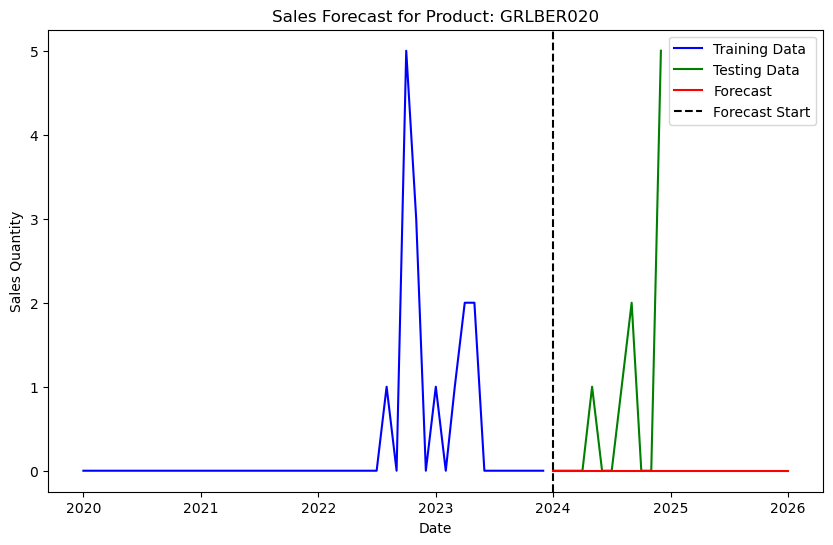

Forecasting for Item: HEABER001
MAE: 3.8333333333333335, MSE: 27.333333333333332, RMSE: 5.228129047119374
Execution time: 0.03 seconds


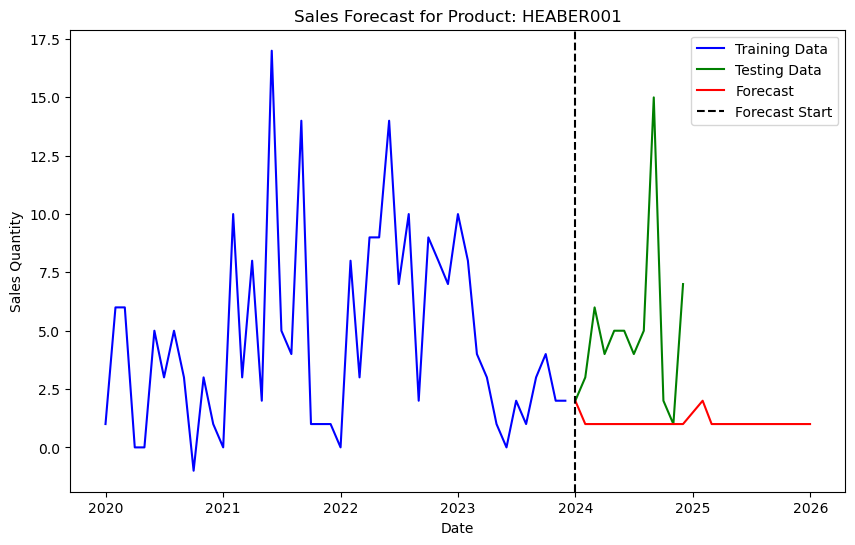

Forecasting for Item: HOTBER001
MAE: 1.1666666666666667, MSE: 2.1666666666666665, RMSE: 1.4719601443879744
Execution time: 0.03 seconds


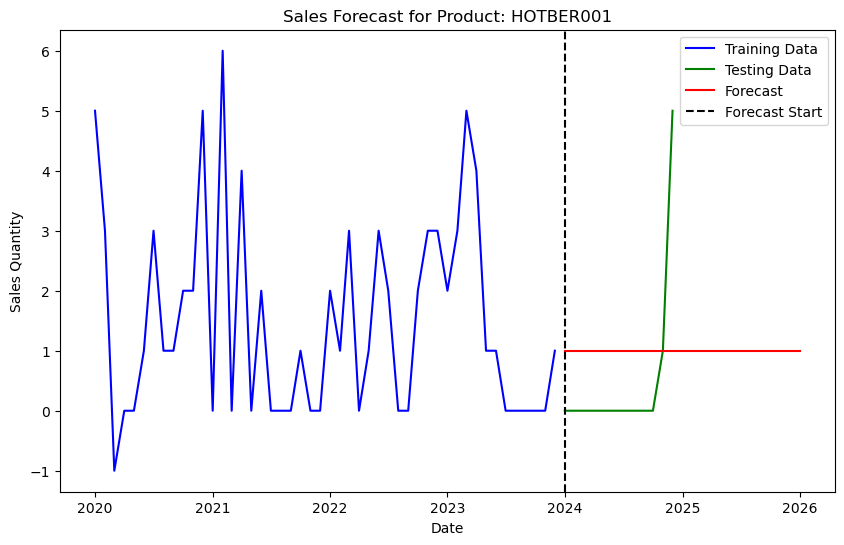

Forecasting for Item: HOTBER002
MAE: 1.3333333333333333, MSE: 2.5, RMSE: 1.5811388300841898
Execution time: 0.03 seconds


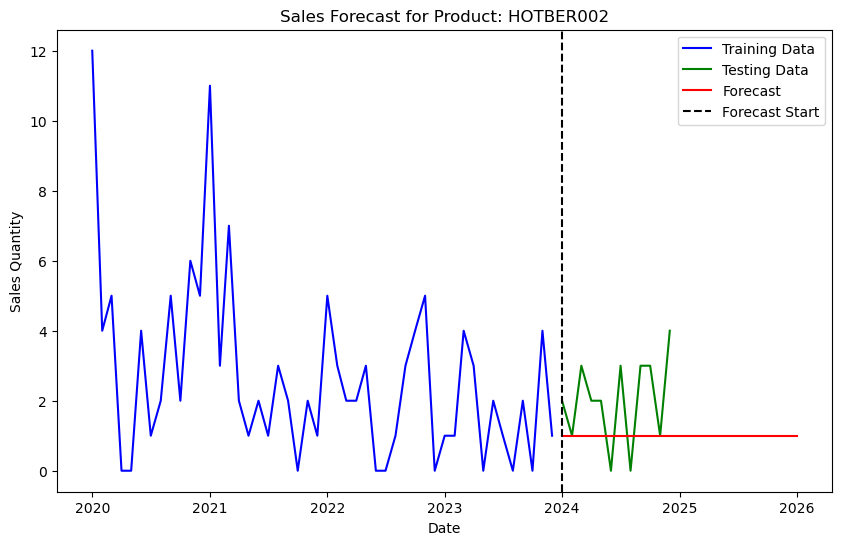

Forecasting for Item: HOTBER003
MAE: 1.0, MSE: 1.5, RMSE: 1.224744871391589
Execution time: 0.04 seconds


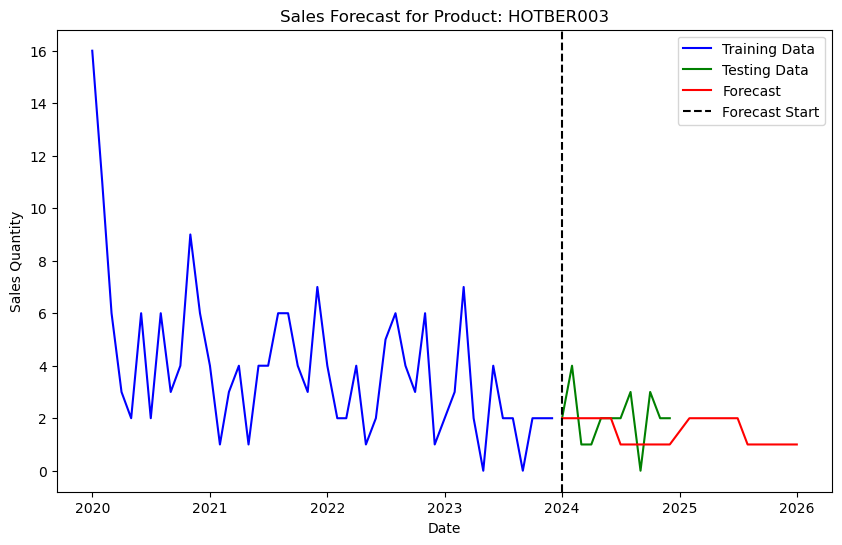

Forecasting for Item: ICMBER002
MAE: 0.4166666666666667, MSE: 0.5833333333333334, RMSE: 0.7637626158259734
Execution time: 0.03 seconds


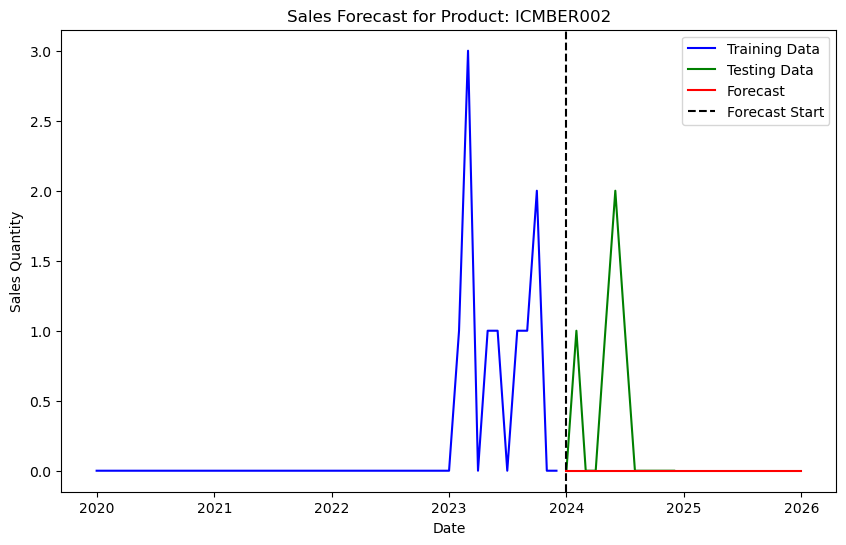

Forecasting for Item: ICMBER003
MAE: 0.5833333333333334, MSE: 1.5833333333333333, RMSE: 1.2583057392117916
Execution time: 0.03 seconds


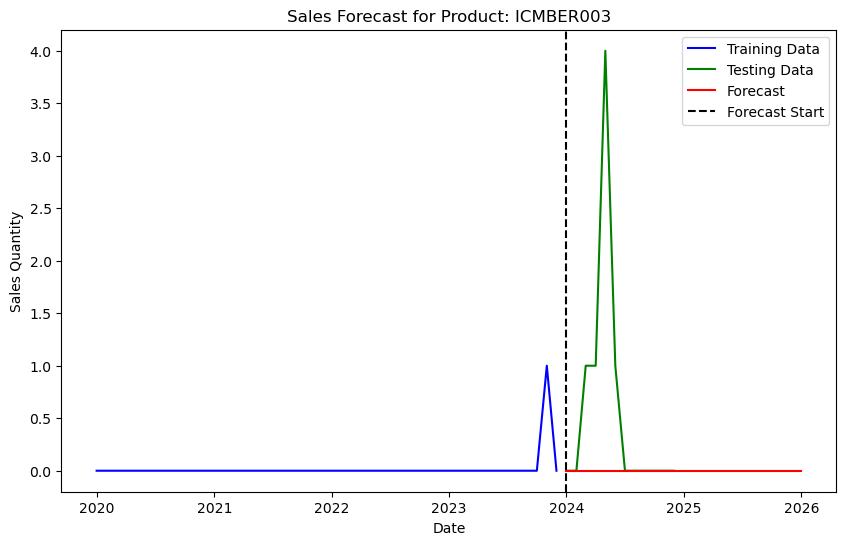

Forecasting for Item: MIXBER001
MAE: 2.0, MSE: 6.833333333333333, RMSE: 2.614064523559687
Execution time: 0.03 seconds


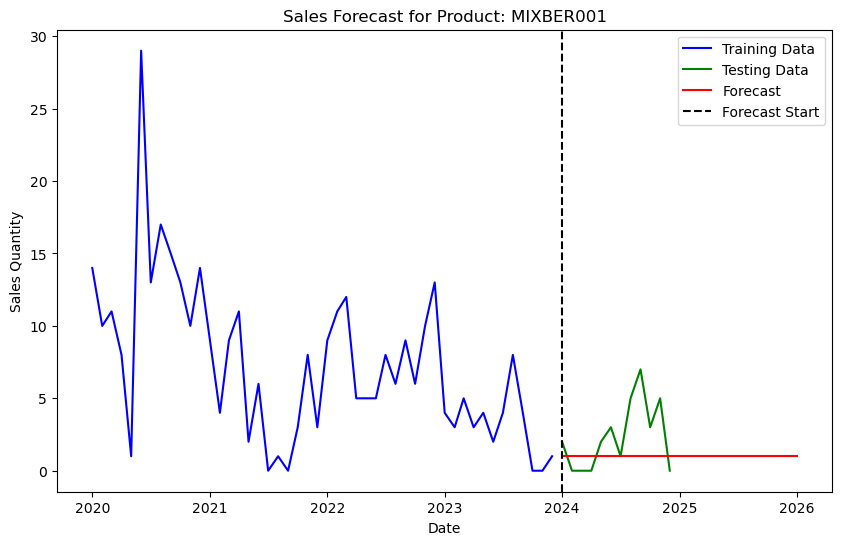

Forecasting for Item: MIXBER003
MAE: 2.0833333333333335, MSE: 7.416666666666667, RMSE: 2.7233557730613653
Execution time: 0.03 seconds


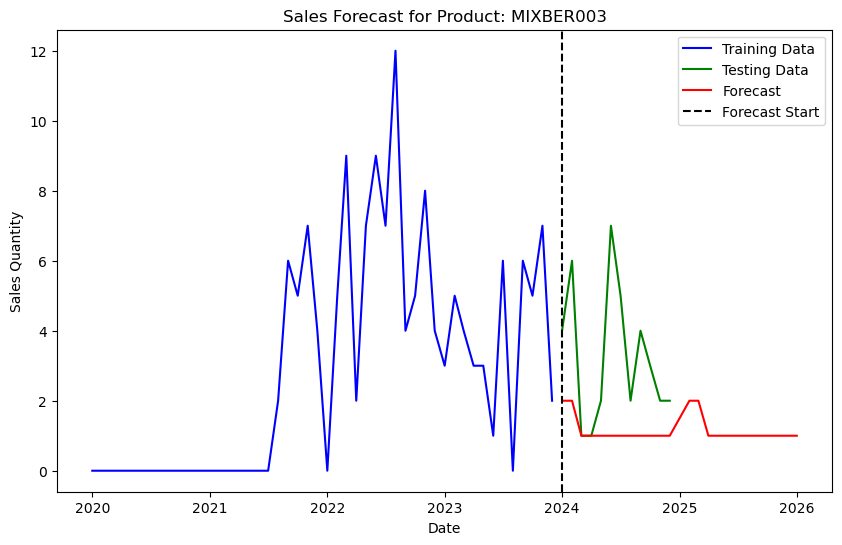

Forecasting for Item: OVEBER002
MAE: 3.25, MSE: 12.25, RMSE: 3.5
Execution time: 0.03 seconds


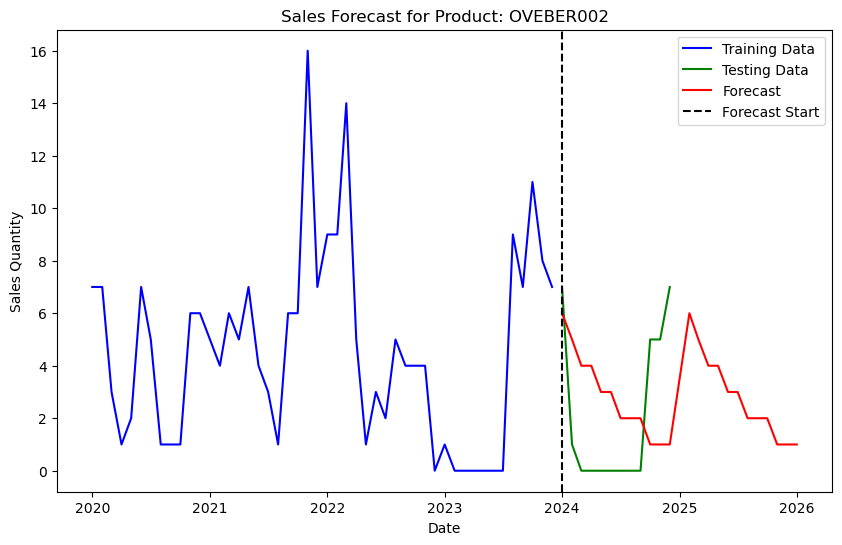

Forecasting for Item: OVEBER005
MAE: 0.5833333333333334, MSE: 0.5833333333333334, RMSE: 0.7637626158259734
Execution time: 0.07 seconds


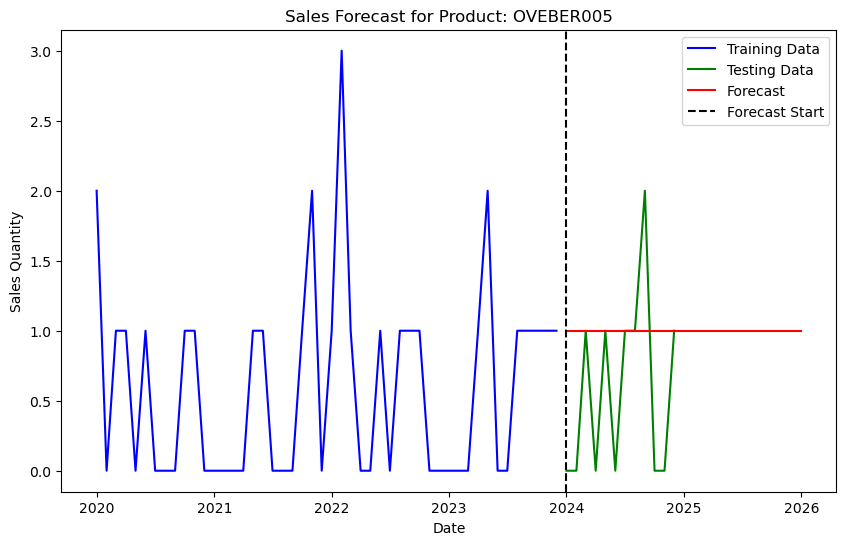

Forecasting for Item: OVEBER006
MAE: 0.8333333333333334, MSE: 0.8333333333333334, RMSE: 0.9128709291752769
Execution time: 0.03 seconds


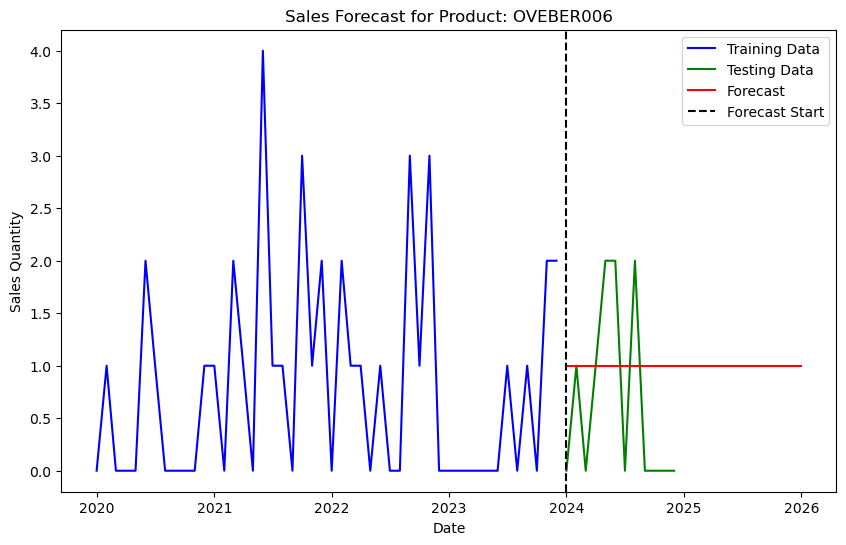

Forecasting for Item: OVEBER011
MAE: 4.0, MSE: 20.666666666666668, RMSE: 4.546060565661952
Execution time: 0.03 seconds


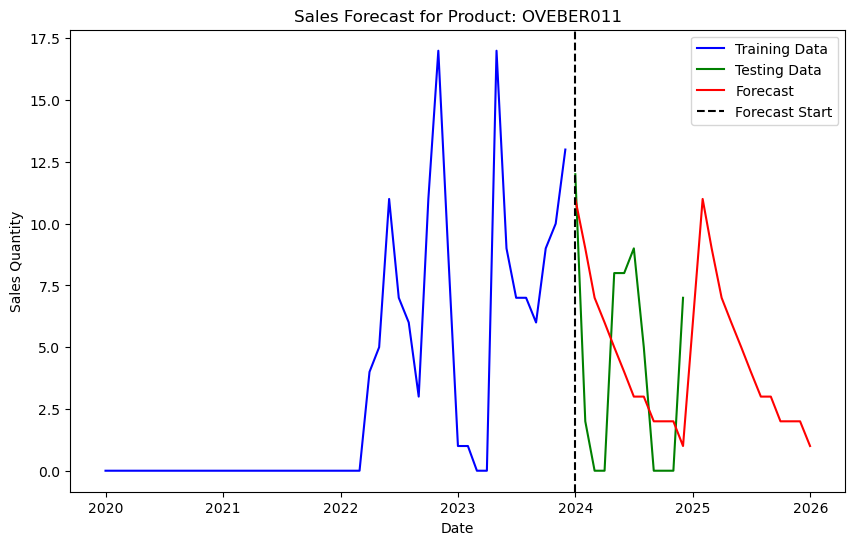

Forecasting for Item: OVEBER012
MAE: 1.5, MSE: 5.0, RMSE: 2.23606797749979
Execution time: 0.03 seconds


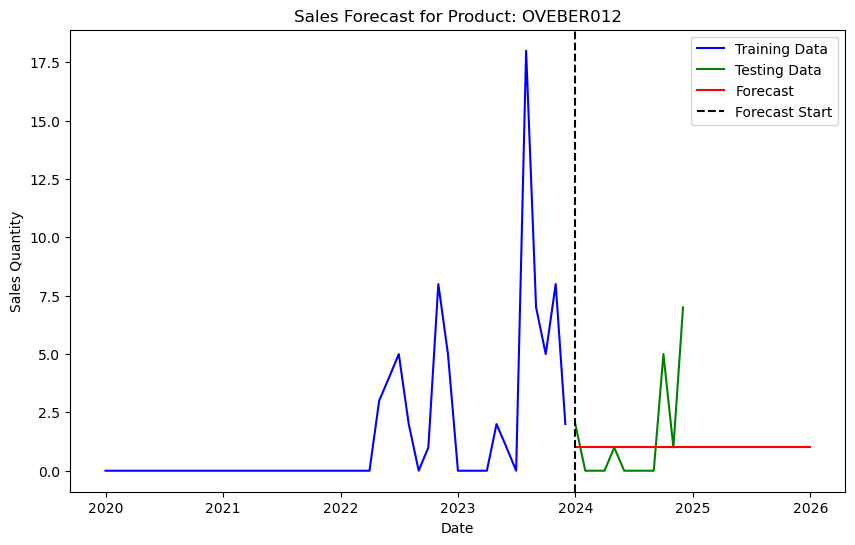

Forecasting for Item: OVEBER013
MAE: 2.9166666666666665, MSE: 17.75, RMSE: 4.2130748865881795
Execution time: 0.03 seconds


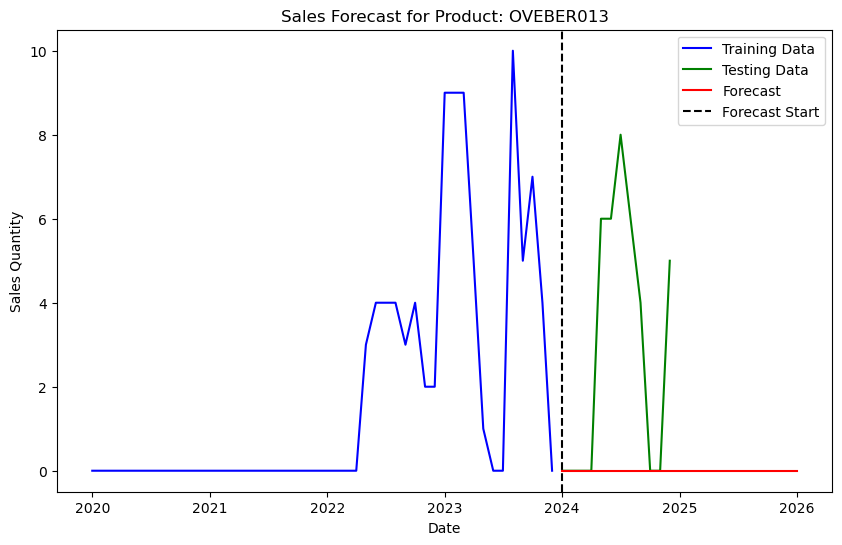

Forecasting for Item: OVEBER014
MAE: 0.8333333333333334, MSE: 1.0, RMSE: 1.0
Execution time: 0.03 seconds


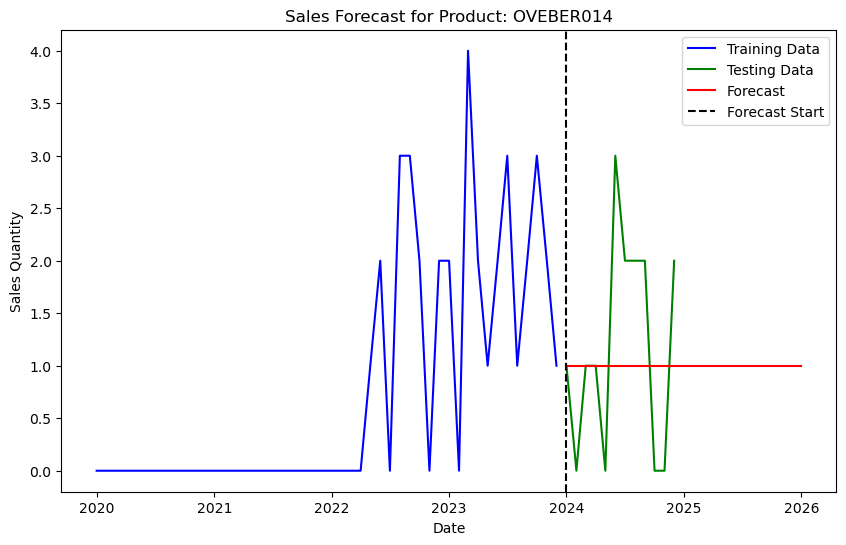

Forecasting for Item: OVEBER015
MAE: 0.6666666666666666, MSE: 0.8333333333333334, RMSE: 0.9128709291752769
Execution time: 0.04 seconds


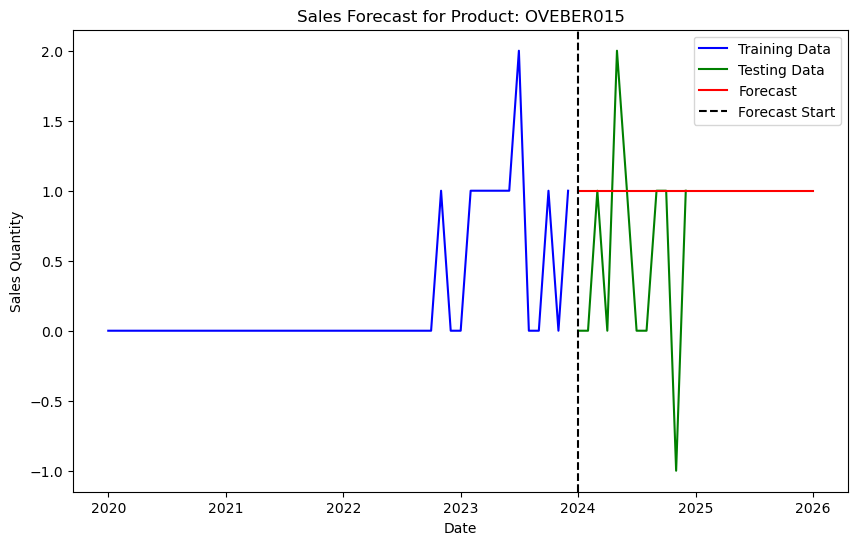

Forecasting for Item: OVEBER016
MAE: 1.4166666666666667, MSE: 4.916666666666667, RMSE: 2.217355782608345
Execution time: 0.03 seconds


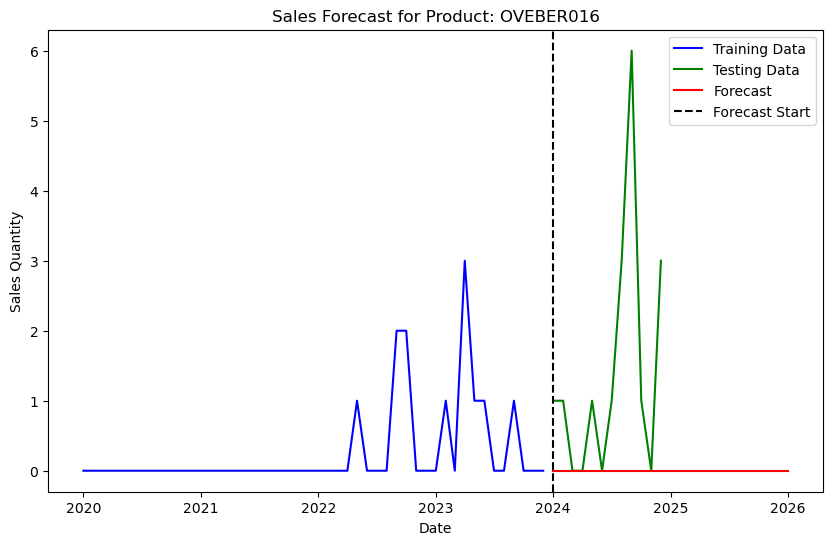

Forecasting for Item: OVEBER017
MAE: 1.0, MSE: 2.3333333333333335, RMSE: 1.5275252316519468
Execution time: 0.08 seconds


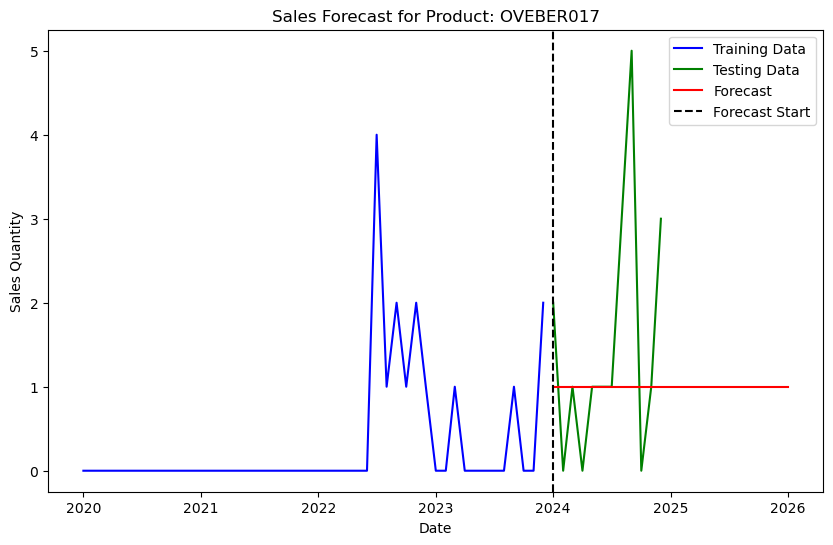

Forecasting for Item: POPBER001
MAE: 1.75, MSE: 3.9166666666666665, RMSE: 1.9790570145063195
Execution time: 0.03 seconds


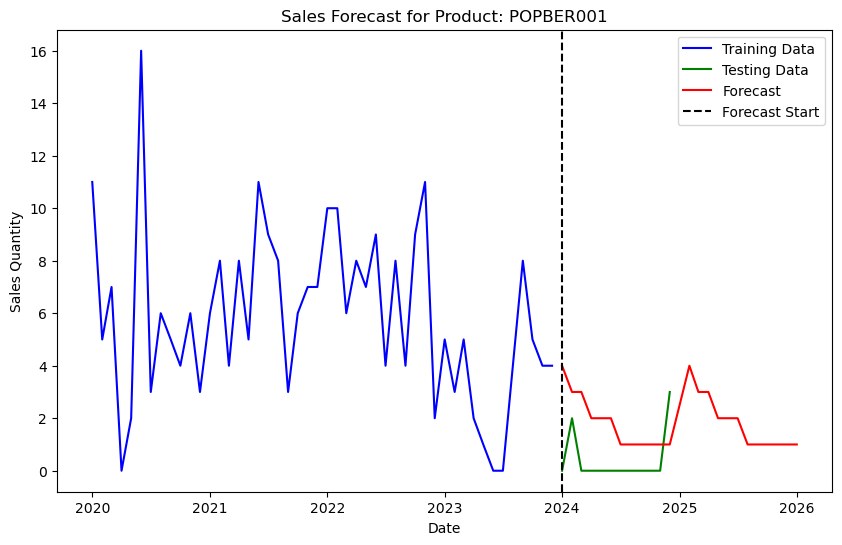

Forecasting for Item: SOPBER001
MAE: 2.5, MSE: 13.833333333333334, RMSE: 3.719318934070233
Execution time: 0.03 seconds


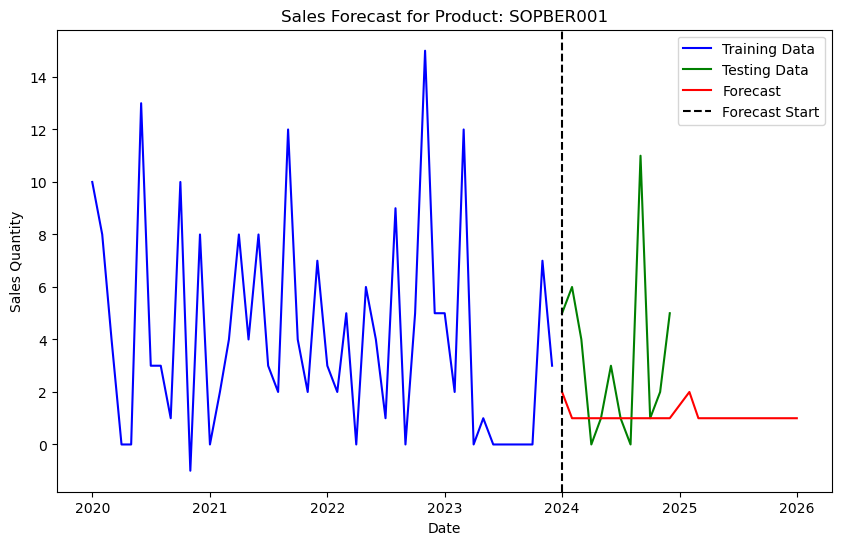

Forecasting for Item: TROBER001
MAE: 0.8333333333333334, MSE: 0.8333333333333334, RMSE: 0.9128709291752769
Execution time: 0.03 seconds


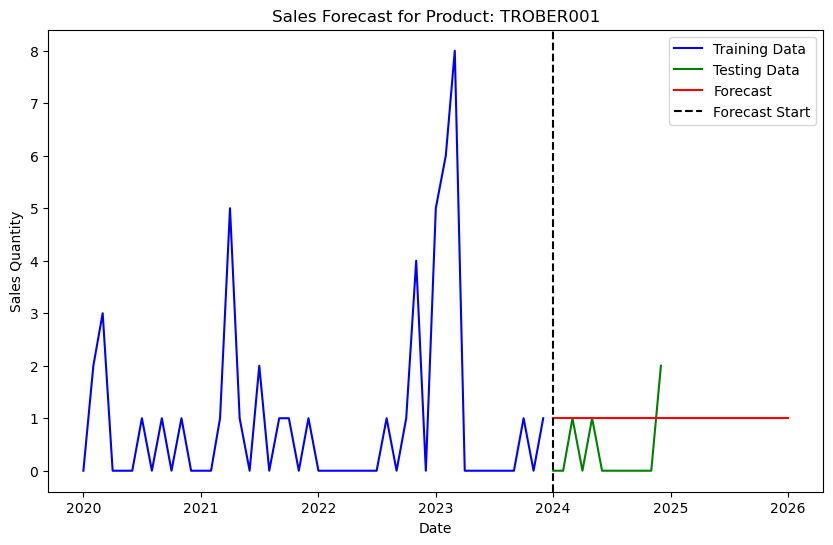

Forecasting for Item: TROBER003
MAE: 0.8333333333333334, MSE: 0.8333333333333334, RMSE: 0.9128709291752769
Execution time: 0.03 seconds


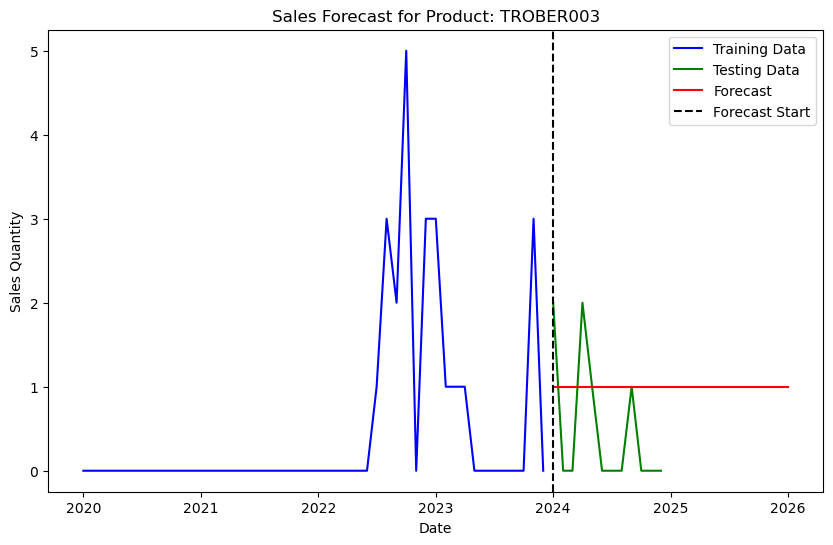

Forecasting for Item: WARBER001
MAE: 0.0, MSE: 0.0, RMSE: 0.0
Execution time: 0.03 seconds


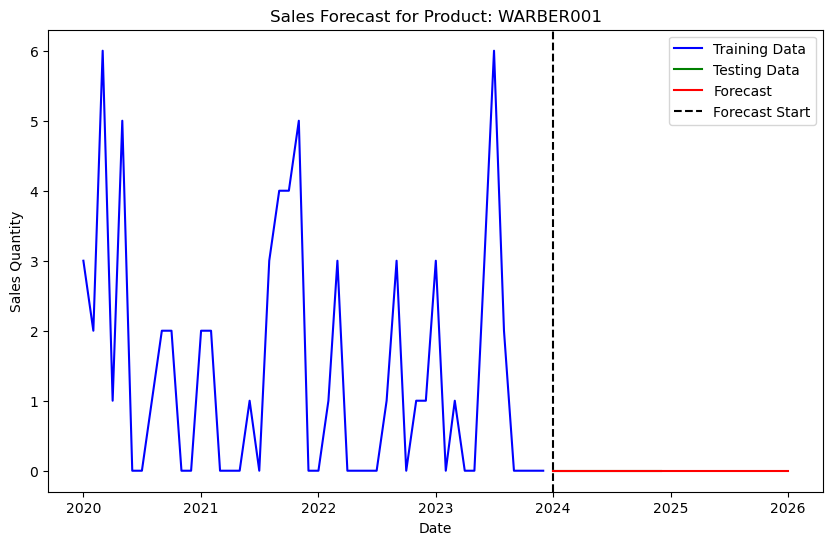

Forecasting for Item: WARBER002
MAE: 1.0, MSE: 1.0, RMSE: 1.0
Execution time: 0.03 seconds


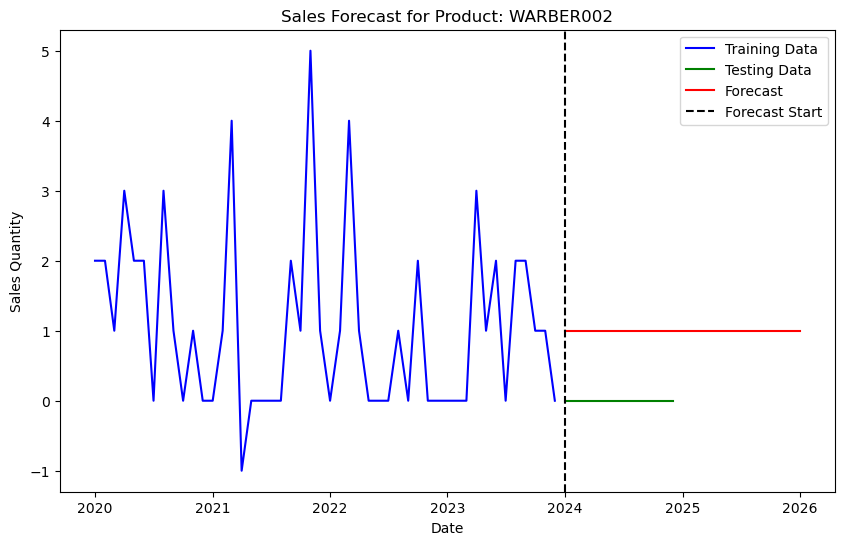

Forecasting for Item: WARBER003
MAE: 0.4166666666666667, MSE: 0.5833333333333334, RMSE: 0.7637626158259734
Execution time: 0.03 seconds


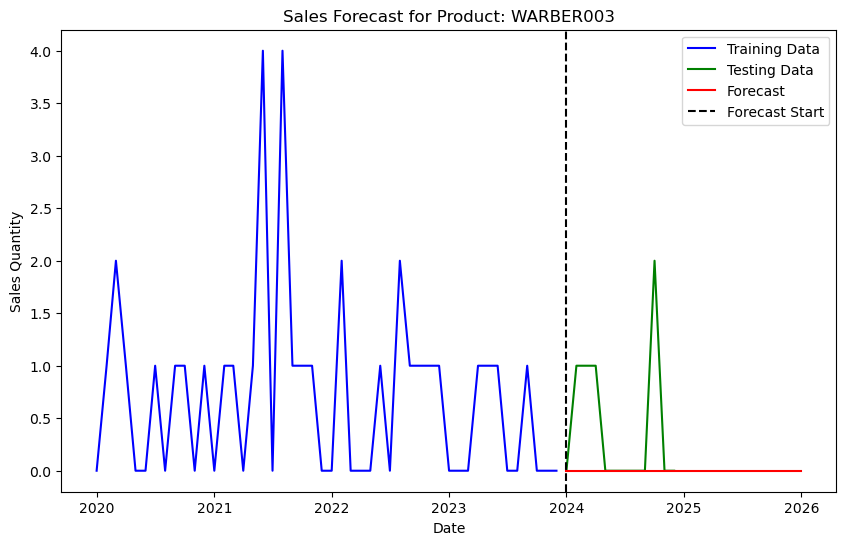

Forecasting for Item: WARBER004
MAE: 0.3333333333333333, MSE: 0.3333333333333333, RMSE: 0.5773502691896257
Execution time: 0.03 seconds


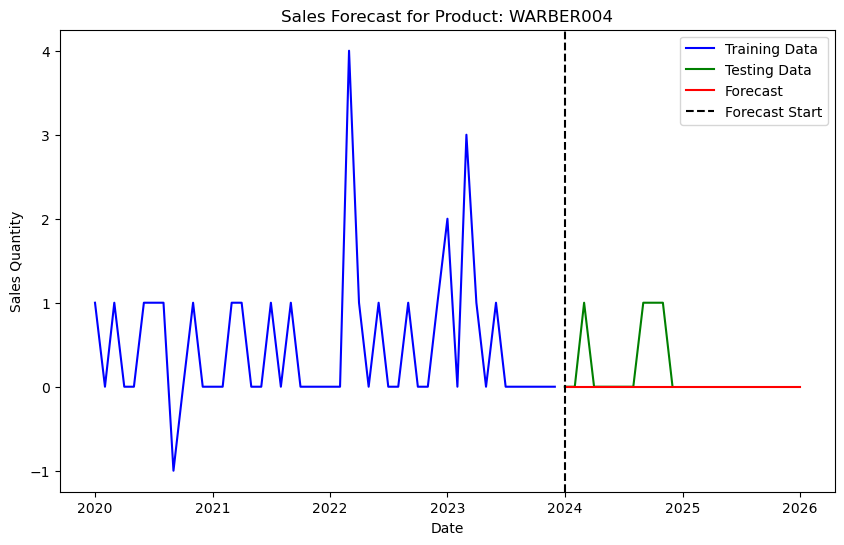

Forecasting for Item: WARBER005
MAE: 1.0, MSE: 1.0, RMSE: 1.0
Execution time: 0.04 seconds


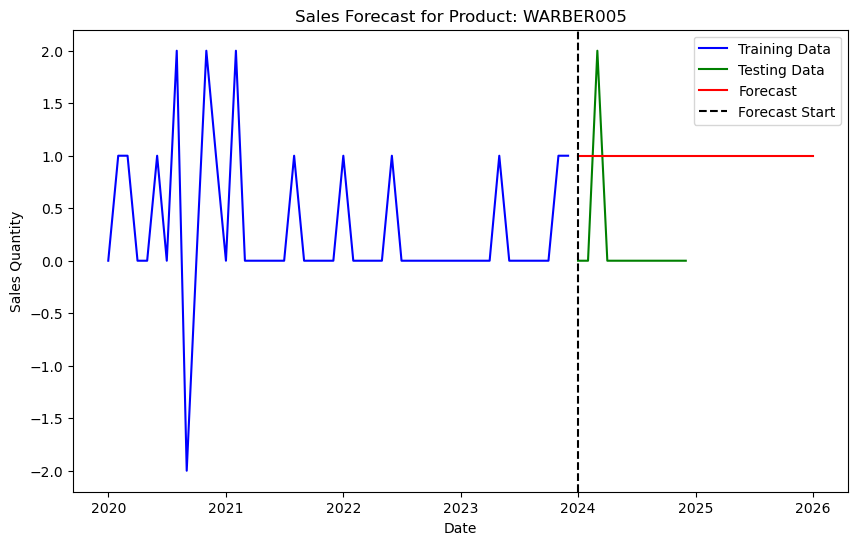

Forecasting for Item: WARBER006
MAE: 0.8333333333333334, MSE: 0.8333333333333334, RMSE: 0.9128709291752769
Execution time: 0.03 seconds


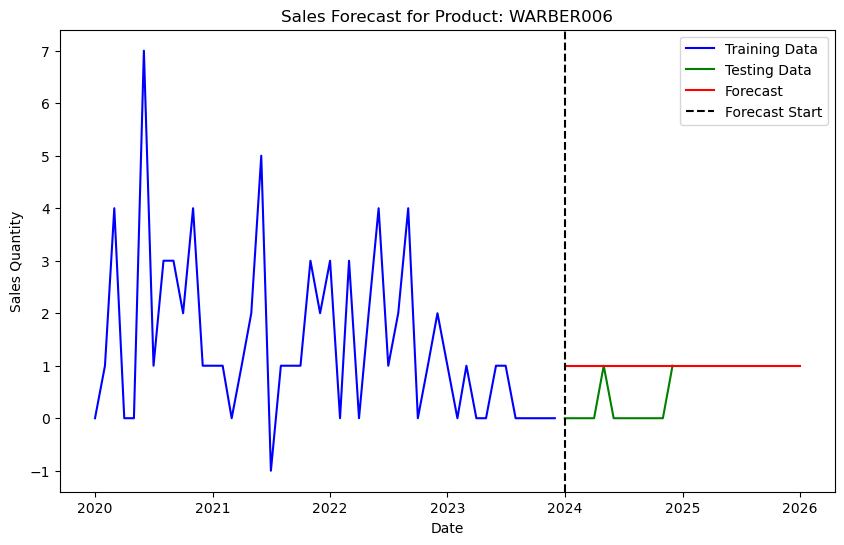

Forecasting for Item: WARBER009
MAE: 1.1666666666666667, MSE: 2.6666666666666665, RMSE: 1.632993161855452
Execution time: 0.04 seconds


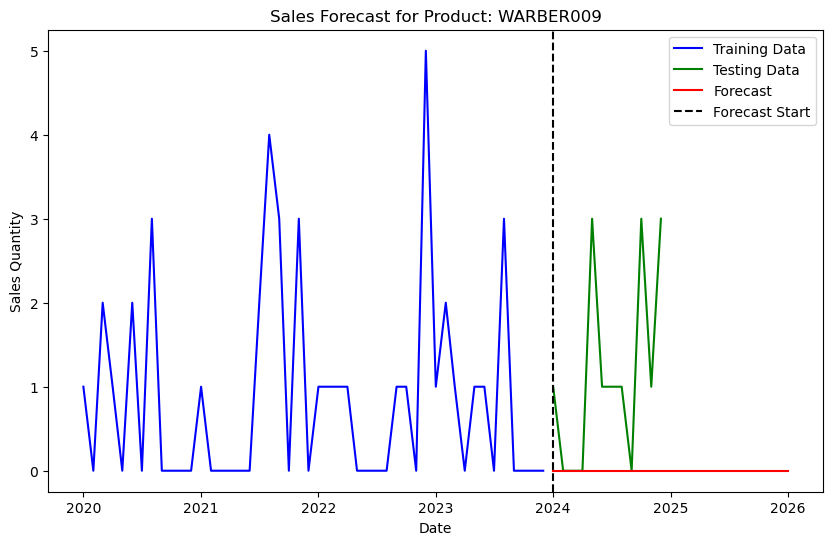

Forecasting for Item: WARBER010
MAE: 1.1666666666666667, MSE: 2.1666666666666665, RMSE: 1.4719601443879744
Execution time: 0.04 seconds


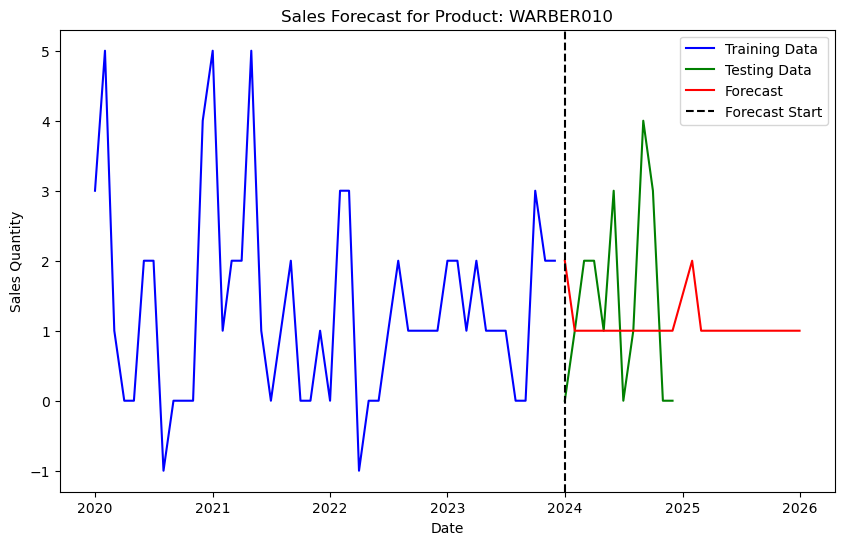

Forecasting for Item: WARBER011
MAE: 1.0, MSE: 1.8333333333333333, RMSE: 1.35400640077266
Execution time: 0.03 seconds


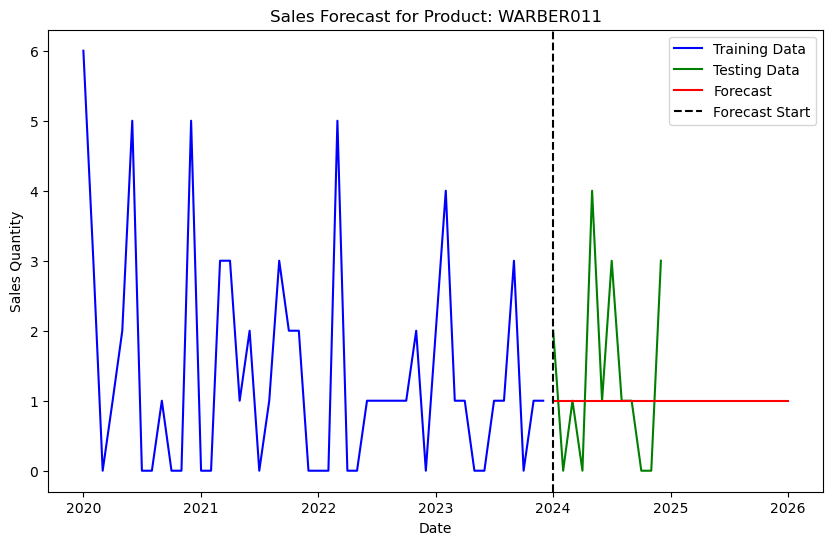

Forecasting for Item: WARBER012
MAE: 0.4166666666666667, MSE: 0.4166666666666667, RMSE: 0.6454972243679028
Execution time: 0.03 seconds


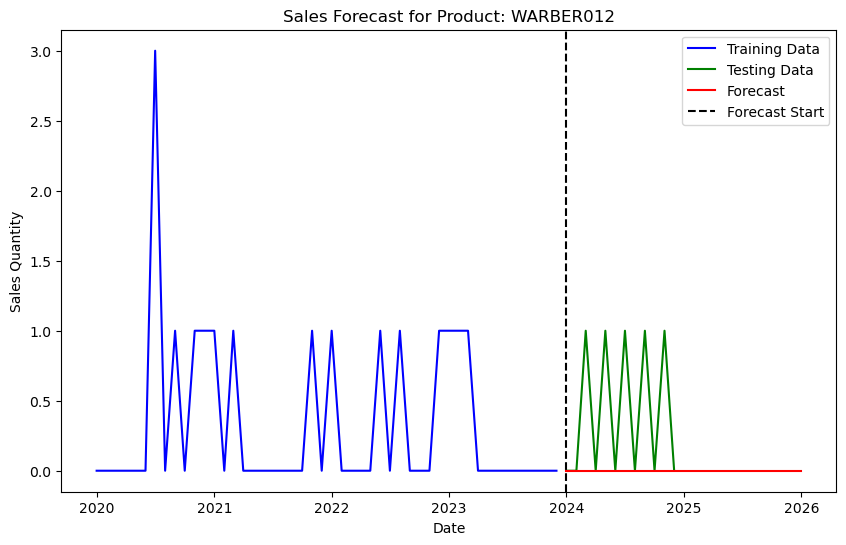

Forecasting for Item: WARBER013
MAE: 0.5833333333333334, MSE: 1.0833333333333333, RMSE: 1.0408329997330663
Execution time: 0.03 seconds


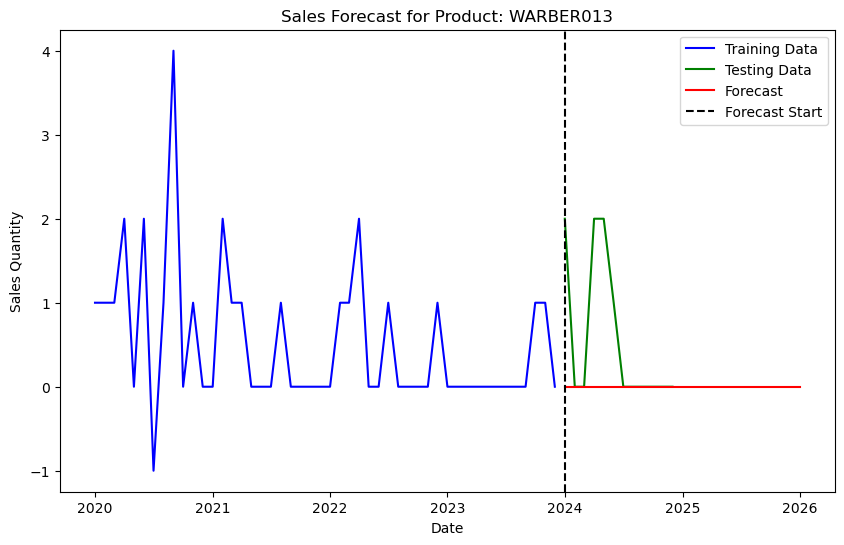

Forecasting for Item: WARBER015
MAE: 0.8333333333333334, MSE: 0.8333333333333334, RMSE: 0.9128709291752769
Execution time: 0.03 seconds


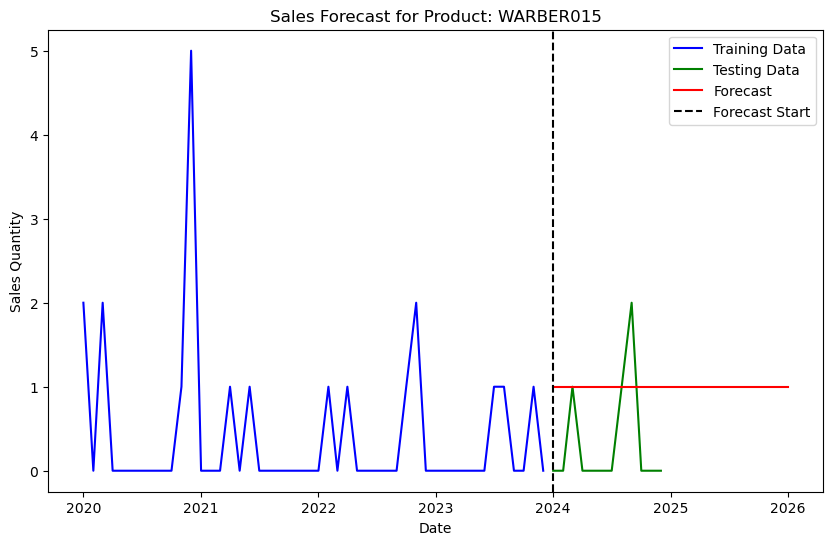

Forecasting for Item: WARBER016
MAE: 0.08333333333333333, MSE: 0.08333333333333333, RMSE: 0.28867513459481287
Execution time: 0.04 seconds


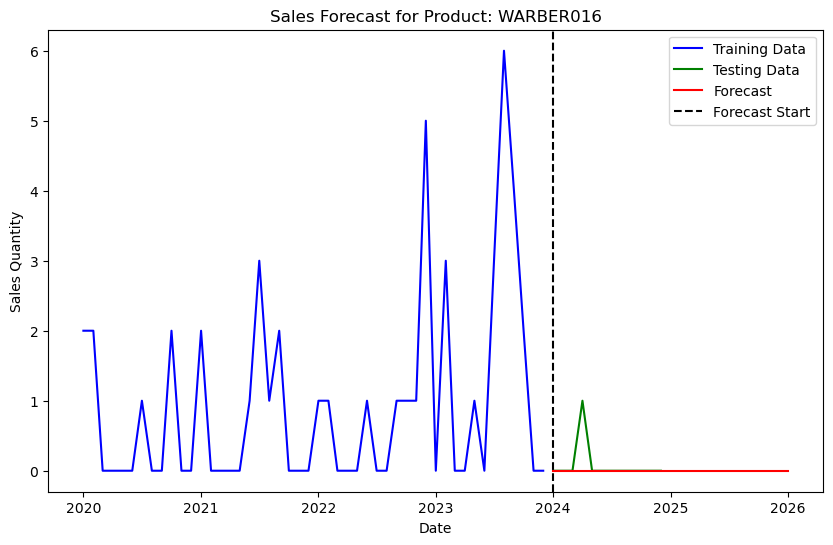

Forecasting for Item: WARBER022
MAE: 1.0, MSE: 1.0, RMSE: 1.0
Execution time: 0.03 seconds


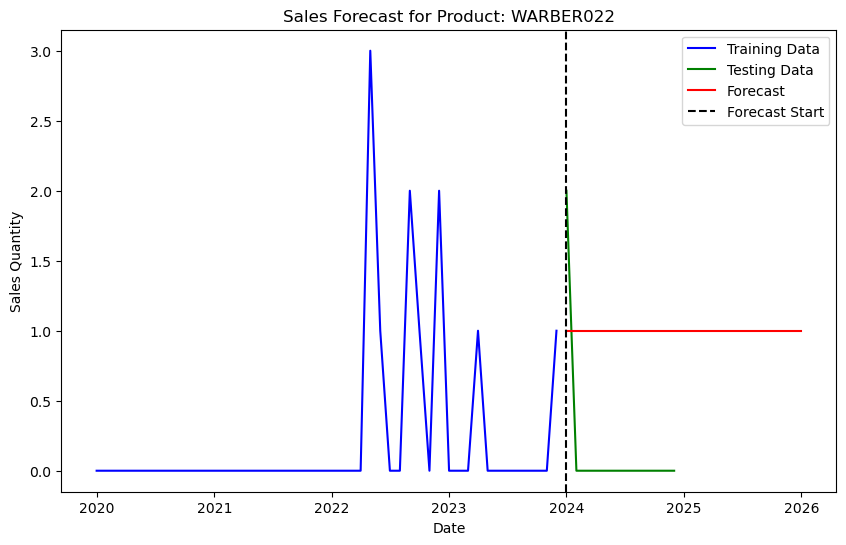

Forecasting for Item: WARBER023
MAE: 0.08333333333333333, MSE: 0.08333333333333333, RMSE: 0.28867513459481287
Execution time: 0.04 seconds


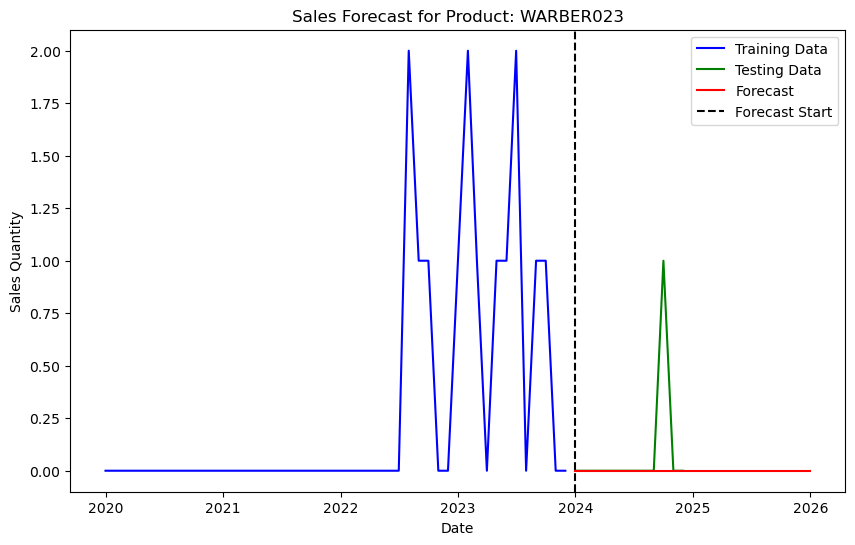

Forecasting for Item: WARBER024
MAE: 0.16666666666666666, MSE: 0.16666666666666666, RMSE: 0.408248290463863
Execution time: 0.04 seconds


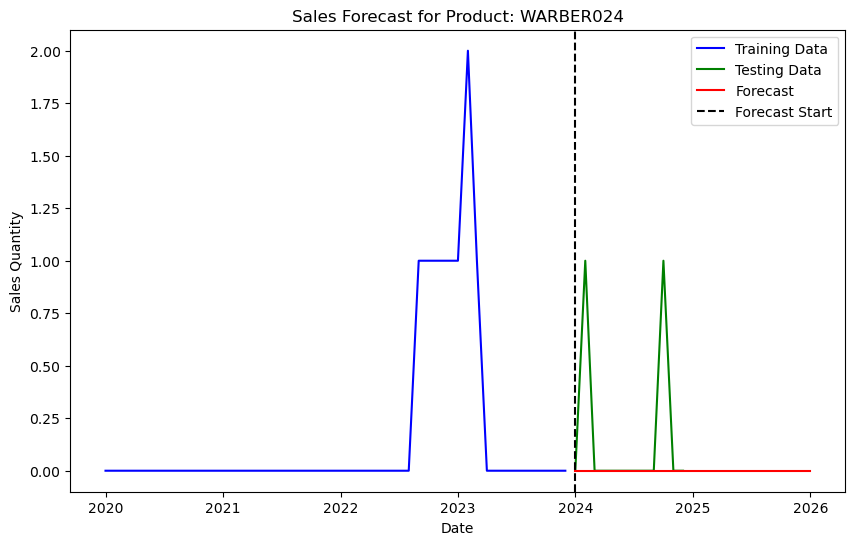

In [40]:
def forecast_sales_sarimax(ProductNumber, data_filled, horizon_months=12):
    # Record the start time
    start_time = time.time()
    
    # Filter data for the specific product
    filtered_data = data_filled[data_filled['ProductNumber'] == ProductNumber]
    
    if filtered_data.empty:
        print(f"No data available for Item: {ProductNumber}")
        return None, None
    
    # Prepare data
    df = filtered_data[['month', 'Sum of InvoicedQuantity']].rename(columns={'month': 'ds', 'Sum of InvoicedQuantity': 'y'})
    df.loc[:,'ds'] = pd.to_datetime(df['ds'])
    df.loc[:, 'Date'] = df['ds']
    df = df.sort_values('ds').reset_index(drop=True)
    df.set_index('ds', inplace=True)

    df.index = pd.to_datetime(df.index).to_period('M').to_timestamp()
    
    # Split the data into training and testing sets
    split_date = pd.Timestamp("2024-01-01")
    train_data = df[df.index < split_date]
    test_data = df[df.index >= split_date]

    
    y_train, y_test = train_data['y'], test_data['y']
    
    if len(y_train) < 2:
        print(f"Not enough training data for Item: {ProductNumber}")
        return None, None
    
    # Train the SARIMAX model
    try:
        model = SARIMAX(y_train)
        model_fit = model.fit(disp=False)
    except Exception as e:
        print(f"Error fitting SARIMAX for Item: {ProductNumber} -> {e}")
        return None, None
    
    # Generate predictions for the test period
    forecast_test = model_fit.get_prediction(start=y_test.index[0], end=y_test.index[-1])
    
    test_data = test_data.copy()
    
    test_data.loc[:, 'forecasted_y'] = np.ceil(forecast_test.predicted_mean).clip(lower=0)
    
    # Calculate accuracy metrics
    mae = mean_absolute_error(y_test, test_data['forecasted_y'])
    mse = mean_squared_error(y_test, test_data['forecasted_y'])
    rmse = root_mean_squared_error(y_test, test_data['forecasted_y'])
    test_data.loc[:, 'MAE'] = mae
    test_data.loc[:, 'MSE'] = mse
    test_data.loc[:, 'RMSE'] = rmse
    print(f"MAE: {mae}, MSE: {mse}, RMSE: {rmse}")
    
    # Generate future forecasts
    future_index = pd.date_range(start=df.index.max(), periods=horizon_months + 1, freq='ME')[1:]
    future_forecast = model_fit.get_forecast(steps=horizon_months)
    future_df = pd.DataFrame({
        'ds': future_index,
        'forecasted_y': np.ceil(future_forecast.predicted_mean).clip(lower=0)
    })

    # future_df.loc[:,'Date'] = future_df['ds']
    
    # Combine test and future forecasts
    forecast = pd.concat([test_data[['y', 'forecasted_y']], future_df.set_index('ds')], ignore_index=False)
    
    # Record the end time
    end_time = time.time()
    execution_time = end_time - start_time
    
    # Append execution time as a column
    test_data.loc[:, 'execution_time_seconds'] = execution_time
    print(f"Execution time: {execution_time:.2f} seconds")
    
    # Plot the results
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.plot(train_data.index, train_data['y'], label="Training Data", color="blue")
    ax.plot(test_data.index, test_data['y'], label="Testing Data", color="green")
    ax.plot(forecast.index, forecast['forecasted_y'], label="Forecast", color="red")
    ax.axvline(test_data.index[0], color='black', linestyle='--', label="Forecast Start")
    ax.set_title(f"Sales Forecast for Product: {ProductNumber}")
    ax.set_xlabel("Date")
    ax.set_ylabel("Sales Quantity")
    ax.legend()
    plt.show()
    
    return test_data, forecast

# Get unique product combinations
product_combinations = data_filled[['ProductNumber']].drop_duplicates()

# Initialize containers for results
evaluation_results = []
forecast_results = []


# Perform forecasting for each product
for _, row in product_combinations.iterrows():
    ProductNumber = row['ProductNumber']
    print(f"Forecasting for Item: {ProductNumber}")
    evaluation_df, forecast_df = forecast_sales_sarimax(ProductNumber, data_filled, horizon_months=12)
    
    if evaluation_df is not None and forecast_df is not None:
        evaluation_df['ProductNumber'] = ProductNumber
        forecast_df['ProductNumber'] = ProductNumber
        
        evaluation_results.append(evaluation_df)
        forecast_results.append(forecast_df)

# Combine all results into separate DataFrames
evaluation_df_combined = pd.concat(evaluation_results, ignore_index=False)
forecast_df_combined = pd.concat(forecast_results, ignore_index=False)

In [41]:
# Save results to a CSV file
evaluation_df_combined.to_csv("SARIMAX_evaluation_results.csv", index=False)
forecast_df_combined.to_csv("SARIMAX_sales_forecast_results.csv", index=False)

## Extract the forecasted values for the 12 months horizon in Pivot table

In [42]:
forecast_df_combined

,y,forecasted_y,ProductNumber
ds,,,
2024-01-01,1.0,1.0,BOLBER001
2024-02-01,0.0,1.0,BOLBER001
2024-03-01,0.0,1.0,BOLBER001
2024-04-01,0.0,1.0,BOLBER001
2024-05-01,0.0,1.0,BOLBER001
...,...,...,...
2025-08-31,NaN,-0.0,WARBER024
2025-09-30,NaN,-0.0,WARBER024
2025-10-31,NaN,-0.0,WARBER024


In [45]:
# Create the pivot table using the filtered DataFrame
filtered_forecast_df = forecast_df_combined[forecast_df_combined.index >= '2025-01-01']

Pivot_table2 = pd.pivot_table(
    filtered_forecast_df, 
    values='forecasted_y', 
    index='ProductNumber',
    columns='ds', 
    aggfunc='sum', 
    fill_value=0
)

Pivot_table2

ds,2025-01-31,2025-02-28,2025-03-31,2025-04-30,2025-05-31,2025-06-30,2025-07-31,2025-08-31,2025-09-30,2025-10-31,2025-11-30,2025-12-31
ProductNumber,,,,,,,,,,,,
BOLBER001,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
BOLBER002,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
BOLBER003,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
BOLBER005,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
BURBER001,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
WARBER015,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
WARBER016,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
WARBER022,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [46]:
Pivot_table2.to_csv("Pivot_table2-filtered-sales_forecast_results.csv", index=True)

## Cross-validation

In [47]:
# Function to perform time-series cross-validation and evaluate SARIMAX
def cross_validate_sarimax(ProductNumber, data_filled, n_splits=5):
    # Filter data for the specific product
    filtered_data = data_filled[data_filled['ProductNumber'] == ProductNumber]
    
    if filtered_data.empty:
        print(f"No data available for Item: {ProductNumber}")
        return None
    
    # Prepare data
    df = filtered_data[['month', 'Sum of InvoicedQuantity']].rename(columns={'month': 'ds', 'Sum of InvoicedQuantity': 'y'})
    df['ds'] = pd.to_datetime(df['ds'])
    df = df.sort_values('ds').reset_index(drop=True)
    df.set_index('ds', inplace=True)

    # Convert index to monthly timestamps for SARIMAX
    df.index = pd.to_datetime(df.index).to_period('M').to_timestamp()
    y = df['y']
    
    # Time-series cross-validation
    tscv = TimeSeriesSplit(n_splits=n_splits)
    fold_metrics = []
    
    for fold, (train_index, test_index) in enumerate(tscv.split(y)):
        # Split into train and test sets for this fold
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Get training and testing dates
        train_start_date, train_end_date = y_train.index[0], y_train.index[-1]
        test_start_date, test_end_date = y_test.index[0], y_test.index[-1]
        
        # Print training and testing periods
        print(f"Fold {fold + 1}:")
        print(f"  Training period: {train_start_date.date()} to {train_end_date.date()}")
        print(f"  Testing period: {test_start_date.date()} to {test_end_date.date()}")

        
        # Fit SARIMAX model

        model = SARIMAX(y_train)
        model_fit = model.fit(disp=False)
            
        # Generate predictions for the test set
        forecast_test = model_fit.get_prediction(start=y_test.index[0], end=y_test.index[-1])
        predicted = np.ceil(forecast_test.predicted_mean).clip(lower=0)
            
        # Calculate metrics
        mae = mean_absolute_error(y_test, predicted)
        mse = mean_squared_error(y_test, predicted)
        rmse = root_mean_squared_error(y_test, predicted)
            
        print(f"Fold {fold + 1}: MAE={mae:.2f}, MSE={mse:.2f}, RMSE={rmse:.2f}")
        fold_metrics.append({'Fold': fold + 1, 'Training Period': (train_start_date, train_end_date), 'Testing Period': (test_start_date, test_end_date), 'MAE': mae, 'MSE': mse, 'RMSE': rmse})


    return fold_metrics

# Example usage for the top 5 products
top_5_products = data_filled[data_filled['month'] >= '2023-01-01'].groupby('ProductNumber')['Sum of InvoicedQuantity'].sum().nlargest(5).index.tolist()

results = []

for ProductNumber in top_5_products:
    print(f"\nCross-validating for Product: {ProductNumber}")
    metrics = cross_validate_sarimax(ProductNumber, data_filled, n_splits=5)
    results.append({'ProductNumber': ProductNumber, 'Metrics': metrics})

# Display results
for result in results:
    print(f"\nProduct: {result['ProductNumber']}")
    for metric in result['Metrics']:
        print(f"  Fold {metric['Fold']}:")
        print(f"    Training Period: {metric['Training Period'][0].date()} to {metric['Training Period'][1].date()}")
        print(f"    Testing Period: {metric['Testing Period'][0].date()} to {metric['Testing Period'][1].date()}")
        print(f"    MAE={metric['MAE']:.2f}, MSE={metric['MSE']:.2f}, RMSE={metric['RMSE']:.2f}")



Cross-validating for Product: COFBER001
Fold 1:
  Training period: 2020-01-01 to 2020-10-01
  Testing period: 2020-11-01 to 2021-08-01
Fold 1: MAE=2.30, MSE=10.30, RMSE=3.21
Fold 2:
  Training period: 2020-01-01 to 2021-08-01
  Testing period: 2021-09-01 to 2022-06-01
Fold 2: MAE=3.50, MSE=17.90, RMSE=4.23
Fold 3:
  Training period: 2020-01-01 to 2022-06-01
  Testing period: 2022-07-01 to 2023-04-01
Fold 3: MAE=9.30, MSE=140.50, RMSE=11.85
Fold 4:
  Training period: 2020-01-01 to 2023-04-01
  Testing period: 2023-05-01 to 2024-02-01
Fold 4: MAE=14.30, MSE=258.90, RMSE=16.09
Fold 5:
  Training period: 2020-01-01 to 2024-02-01
  Testing period: 2024-03-01 to 2024-12-01
Fold 5: MAE=8.30, MSE=106.10, RMSE=10.30

Cross-validating for Product: COKBER001
Fold 1:
  Training period: 2020-01-01 to 2020-10-01
  Testing period: 2020-11-01 to 2021-08-01
Fold 1: MAE=4.50, MSE=30.30, RMSE=5.50
Fold 2:
  Training period: 2020-01-01 to 2021-08-01
  Testing period: 2021-09-01 to 2022-06-01
Fold 2: MAE=

In [48]:
results

[{'ProductNumber': 'COFBER001',
  'Metrics': [{'Fold': 1,
    'Training Period': (Timestamp('2020-01-01 00:00:00'),
     Timestamp('2020-10-01 00:00:00')),
    'Testing Period': (Timestamp('2020-11-01 00:00:00'),
     Timestamp('2021-08-01 00:00:00')),
    'MAE': 2.3,
    'MSE': 10.3,
    'RMSE': 3.2093613071762426},
   {'Fold': 2,
    'Training Period': (Timestamp('2020-01-01 00:00:00'),
     Timestamp('2021-08-01 00:00:00')),
    'Testing Period': (Timestamp('2021-09-01 00:00:00'),
     Timestamp('2022-06-01 00:00:00')),
    'MAE': 3.5,
    'MSE': 17.9,
    'RMSE': 4.230839160261236},
   {'Fold': 3,
    'Training Period': (Timestamp('2020-01-01 00:00:00'),
     Timestamp('2022-06-01 00:00:00')),
    'Testing Period': (Timestamp('2022-07-01 00:00:00'),
     Timestamp('2023-04-01 00:00:00')),
    'MAE': 9.3,
    'MSE': 140.5,
    'RMSE': 11.853269591129697},
   {'Fold': 4,
    'Training Period': (Timestamp('2020-01-01 00:00:00'),
     Timestamp('2023-04-01 00:00:00')),
    'Testing Per

## Auto-ARIMA for SARIMAX parameter searching

In [71]:
# Ignore warnings for clean output
import warnings
warnings.filterwarnings("ignore")  

# Function to find the best SARIMAX parameters using Auto ARIMA
def find_best_sarimax_params(data, product_number, seasonal_period=12):
    
    # Filter data for the specific product
    filtered_data = data[data['ProductNumber'] == product_number]
    
    if filtered_data.empty:
        print(f"No data available for Product: {product_number}")
        return None

    # Ensure time series data is properly indexed
    filtered_data['month'] = pd.to_datetime(filtered_data['month']) # Convert to datetime
    filtered_data = filtered_data.sort_values('month').set_index('month')  # Set 'month' as index

    # Ensure no missing values in the time series
    ts_data = filtered_data['Sum of InvoicedQuantity'].asfreq('M').fillna(0)  # Fill missing months with 0
    
    # Use Auto ARIMA to find the best parameters
    print(f"Finding best SARIMAX parameters for Product: {product_number}...")
    model = auto_arima(
        ts_data, 
        seasonal=True, 
        m=seasonal_period,  # Seasonal period
        trace=True, 
        error_action='ignore', 
        suppress_warnings=True,
        stepwise=True
    )
    
    print(f"Best SARIMAX parameters for Product {product_number}: {model.order} x {model.seasonal_order}")
    return model.order, model.seasonal_order

order, seasonal = find_best_sarimax_params(data_filled,'ICMBER003', seasonal_period=12)
order

# # Select the top 15 products based on the sum of their invoiced quantities
# top_15_products = data_filled[data_filled['month'] >= '2023-01-01'].groupby('ProductNumber')['Sum of InvoicedQuantity'].sum().nlargest(15).index

# # Find the best SARIMAX parameters for the top 15 products
# best_params = {}
# for product in top_15_products:
#     params = find_best_sarimax_params(data_filled, product, seasonal_period=12)
#     if params:
#         best_params[product] = params

# # Print the best parameters for each product
# print("\nBest SARIMAX Parameters for Top 15 Products:")
# for product, (order, seasonal_order) in best_params.items():
#     print(f"Product: {product}, Order: {order}, Seasonal Order: {seasonal_order}")


Finding best SARIMAX parameters for Product: ICMBER003...
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(1,1,1)[12] intercept   : AIC=100.165, Time=0.40 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=98.146, Time=0.03 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=93.106, Time=0.08 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=94.770, Time=0.09 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=98.538, Time=0.02 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=92.003, Time=0.03 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=93.027, Time=0.09 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=95.027, Time=0.19 sec
 ARIMA(2,0,0)(0,1,0)[12] intercept   : AIC=93.919, Time=0.04 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=93.951, Time=0.06 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=93.781, Time=0.03 sec
 ARIMA(2,0,1)(0,1,0)[12] intercept   : AIC=95.511, Time=0.10 sec
 ARIMA(1,0,0)(0,1,0)[12]             : AIC=90.995, Time=0.02 sec
 ARIMA(1,0,0)(1,1,0)[12]             : AIC=92.278, Ti

(1, 0, 0)

In [50]:
best_params

{'COFBER001': ((0, 1, 2), (0, 0, 1, 12)),
 'COKBER001': ((0, 1, 0), (0, 0, 0, 12)),
 'GRLBER003': ((2, 1, 2), (0, 0, 0, 12)),
 'FRYBER005': ((3, 0, 0), (0, 0, 0, 12)),
 'OVEBER011': ((0, 1, 0), (0, 0, 0, 12)),
 'FRYBER002': ((1, 0, 0), (2, 0, 0, 12)),
 'GRLBER004': ((1, 1, 1), (1, 0, 0, 12)),
 'HEABER001': ((0, 0, 0), (0, 0, 0, 12)),
 'FRYBER003': ((1, 0, 0), (0, 0, 0, 12)),
 'OVEBER013': ((0, 1, 0), (0, 0, 0, 12)),
 'MIXBER003': ((0, 1, 1), (0, 0, 0, 12)),
 'SOPBER001': ((0, 0, 0), (0, 0, 0, 12)),
 'OVEBER002': ((1, 0, 0), (0, 0, 0, 12)),
 'GRLBER011': ((2, 0, 1), (0, 0, 0, 12)),
 'MIXBER001': ((0, 1, 1), (0, 0, 0, 12))}

## Re-run SARIMAX with Auto-ARIMA parameter searching

Forecasting for Item: BOLBER001
Running Auto-ARIMA for Product: BOLBER001
Optimal SARIMA parameters for BOLBER001: (2, 1, 0), (1, 0, 0, 12)
MAE: 1.0, MSE: 1.1666666666666667, RMSE: 1.0801234497346435
Execution time: 3.70 seconds


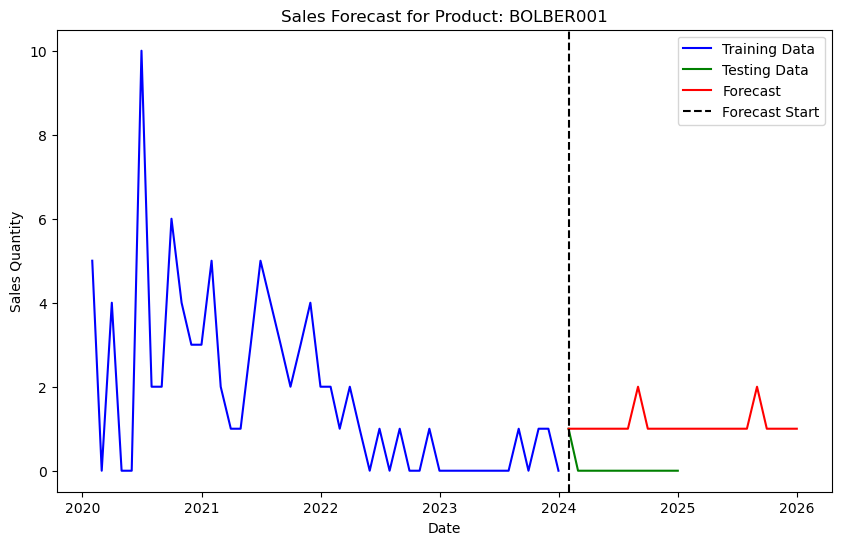

Forecasting for Item: BOLBER002
Running Auto-ARIMA for Product: BOLBER002
Optimal SARIMA parameters for BOLBER002: (0, 1, 1), (0, 0, 0, 12)
MAE: 1.8333333333333333, MSE: 3.5, RMSE: 1.8708286933869707
Execution time: 2.98 seconds


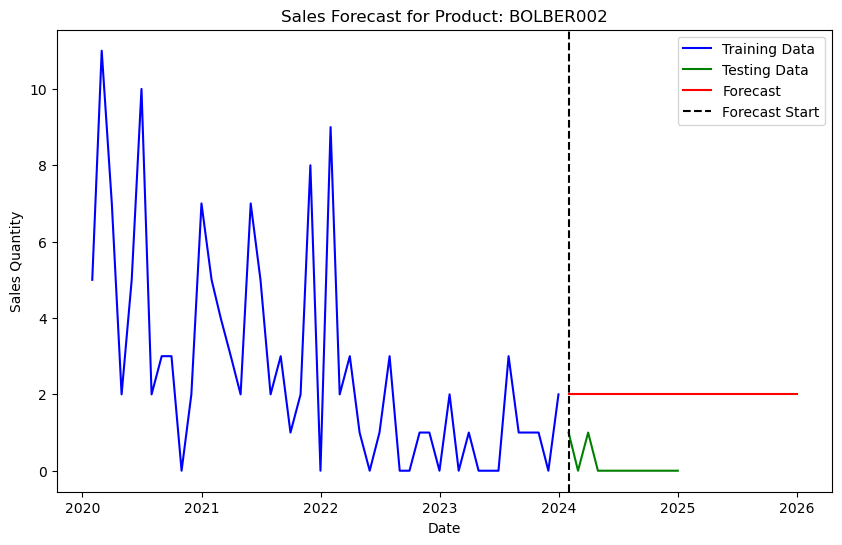

Forecasting for Item: BOLBER003
Running Auto-ARIMA for Product: BOLBER003
Optimal SARIMA parameters for BOLBER003: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.75, MSE: 1.75, RMSE: 1.3228756555322954
Execution time: 1.02 seconds


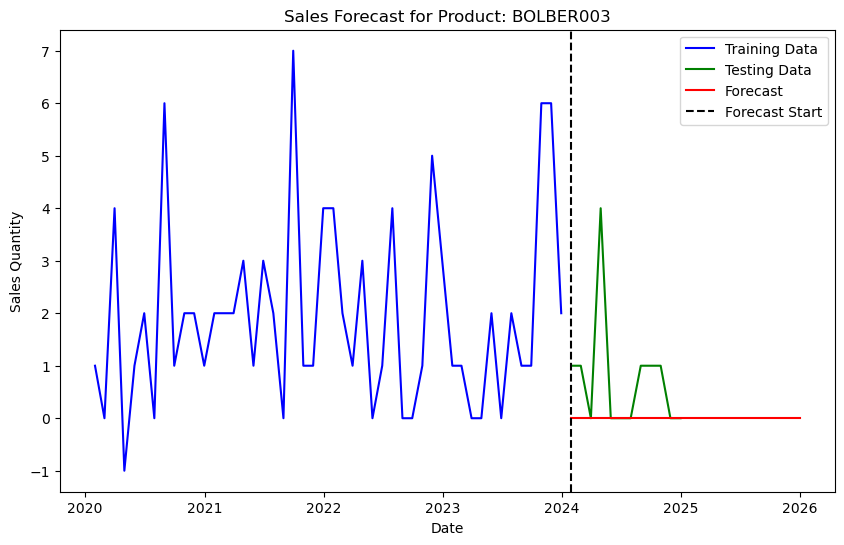

Forecasting for Item: BOLBER005
Running Auto-ARIMA for Product: BOLBER005
Optimal SARIMA parameters for BOLBER005: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.16666666666666666, MSE: 0.16666666666666666, RMSE: 0.408248290463863
Execution time: 0.96 seconds


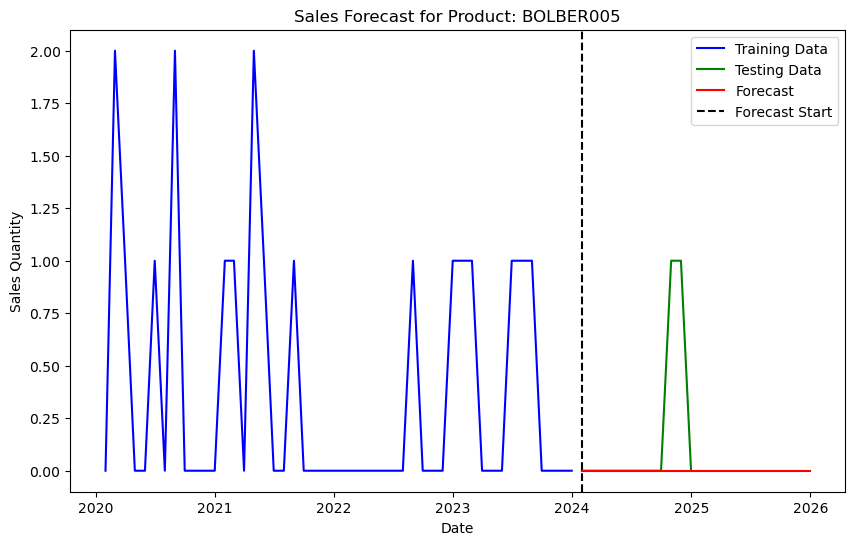

Forecasting for Item: BURBER001
Running Auto-ARIMA for Product: BURBER001
Optimal SARIMA parameters for BURBER001: (0, 0, 0), (1, 0, 0, 12)
MAE: 0.5833333333333334, MSE: 0.5833333333333334, RMSE: 0.7637626158259734
Execution time: 2.18 seconds


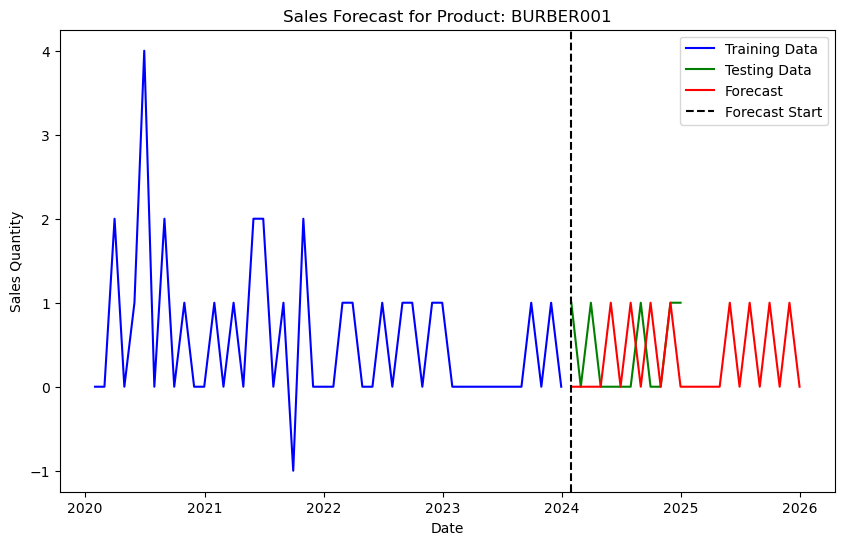

Forecasting for Item: BURBER002
Running Auto-ARIMA for Product: BURBER002
Optimal SARIMA parameters for BURBER002: (0, 1, 1), (2, 0, 0, 12)
MAE: 1.25, MSE: 2.75, RMSE: 1.6583123951777
Execution time: 10.33 seconds


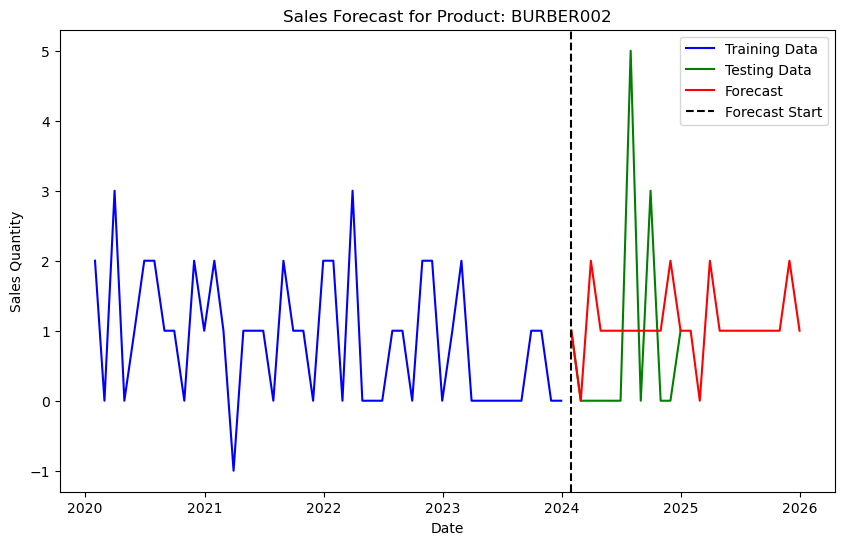

Forecasting for Item: BURBER003
Running Auto-ARIMA for Product: BURBER003
Optimal SARIMA parameters for BURBER003: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.9166666666666666, MSE: 1.5833333333333333, RMSE: 1.2583057392117916
Execution time: 0.92 seconds


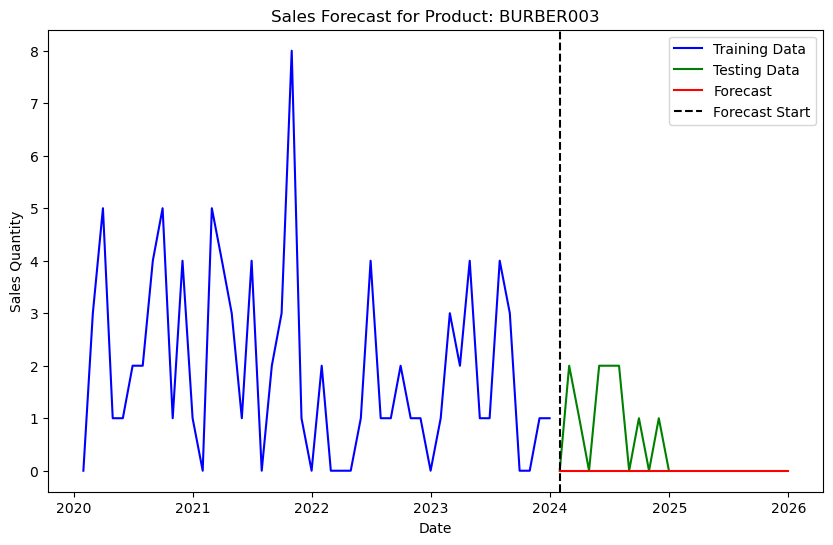

Forecasting for Item: BURBER004
Running Auto-ARIMA for Product: BURBER004
Optimal SARIMA parameters for BURBER004: (0, 0, 0), (0, 0, 0, 12)
MAE: 1.0, MSE: 3.0, RMSE: 1.7320508075688772
Execution time: 0.88 seconds


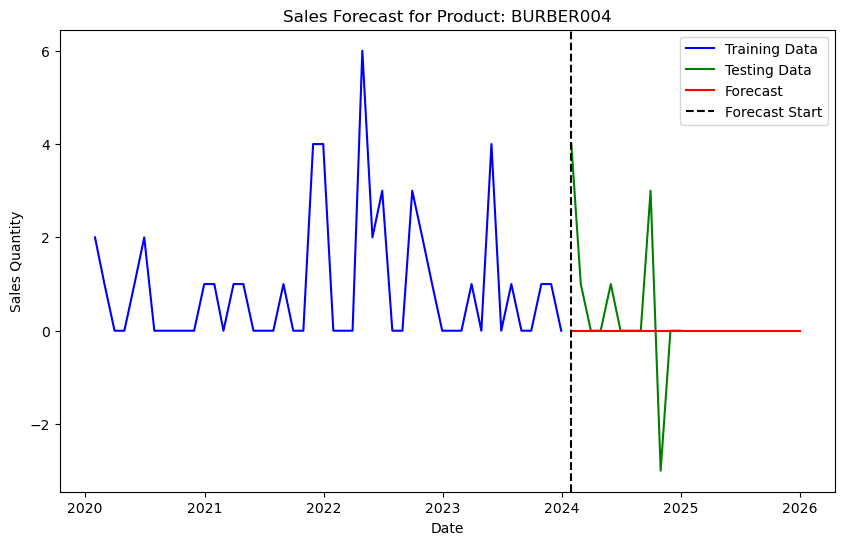

Forecasting for Item: BURBER007
Running Auto-ARIMA for Product: BURBER007
Optimal SARIMA parameters for BURBER007: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.3333333333333333, MSE: 0.5, RMSE: 0.7071067811865476
Execution time: 0.95 seconds


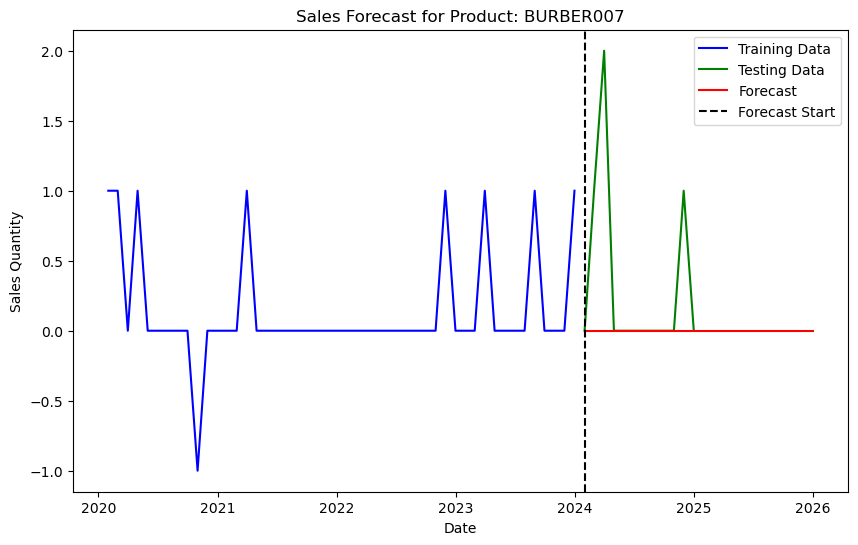

Forecasting for Item: COFBER001
Running Auto-ARIMA for Product: COFBER001
Optimal SARIMA parameters for COFBER001: (2, 1, 1), (0, 0, 1, 12)
MAE: 11.666666666666666, MSE: 175.5, RMSE: 13.24764129949177
Execution time: 6.83 seconds


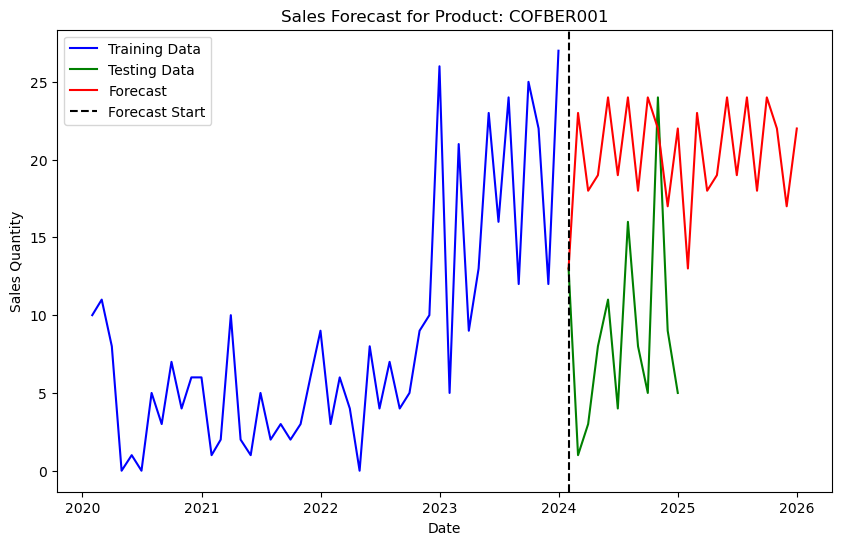

Forecasting for Item: COKBER001
Running Auto-ARIMA for Product: COKBER001
Optimal SARIMA parameters for COKBER001: (0, 0, 1), (0, 0, 0, 12)
MAE: 4.916666666666667, MSE: 84.91666666666667, RMSE: 9.215023964519391
Execution time: 1.39 seconds


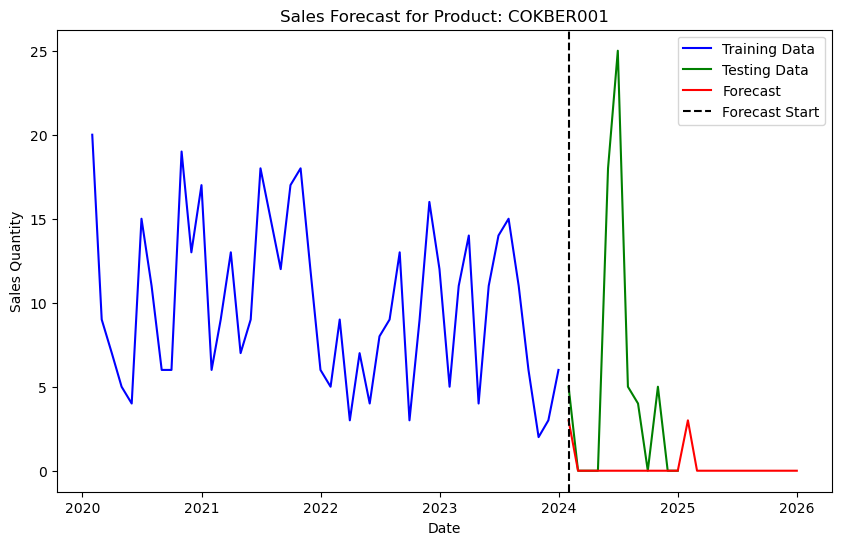

Forecasting for Item: FRYBER002
Running Auto-ARIMA for Product: FRYBER002
Optimal SARIMA parameters for FRYBER002: (0, 0, 0), (2, 0, 0, 12)
MAE: 4.333333333333333, MSE: 21.166666666666668, RMSE: 4.600724580614087
Execution time: 2.15 seconds


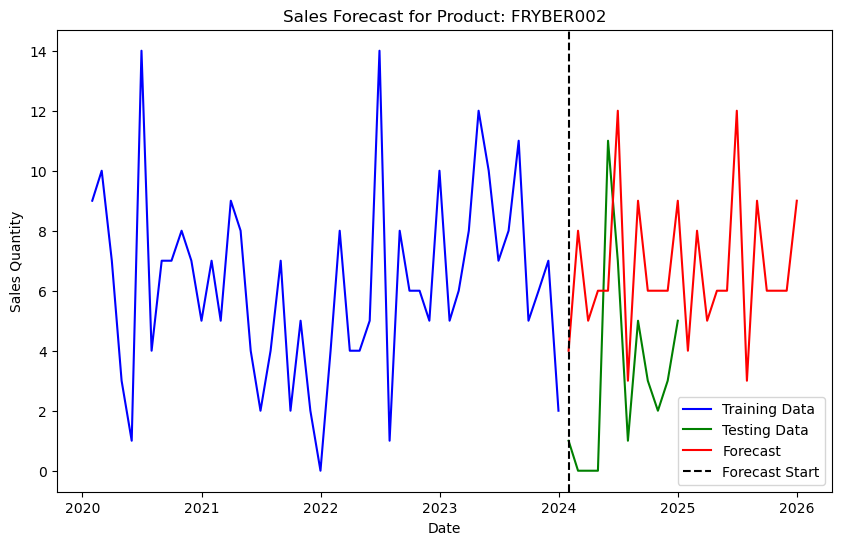

Forecasting for Item: FRYBER003
Running Auto-ARIMA for Product: FRYBER003
Optimal SARIMA parameters for FRYBER003: (2, 0, 1), (0, 0, 0, 12)
MAE: 3.75, MSE: 16.25, RMSE: 4.031128874149275
Execution time: 2.94 seconds


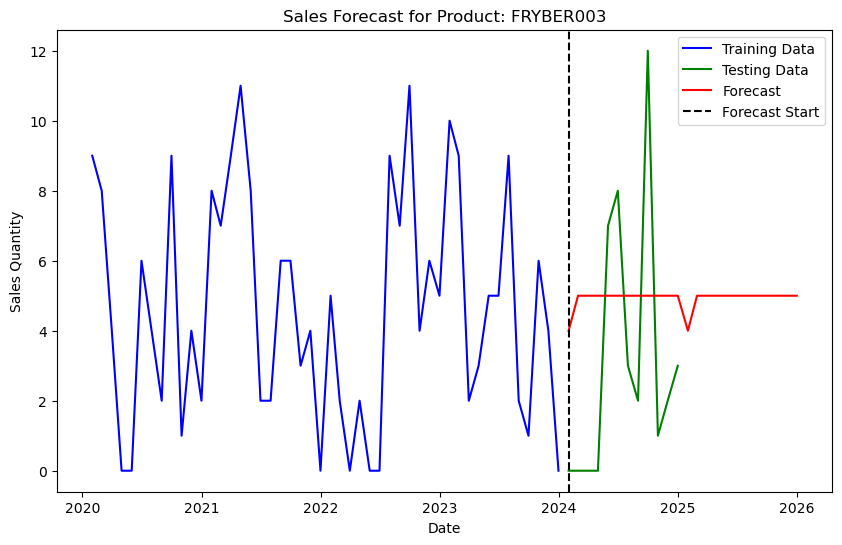

Forecasting for Item: FRYBER005
Running Auto-ARIMA for Product: FRYBER005
Optimal SARIMA parameters for FRYBER005: (0, 1, 1), (0, 0, 0, 12)
MAE: 5.25, MSE: 55.75, RMSE: 7.466592261534039
Execution time: 1.22 seconds


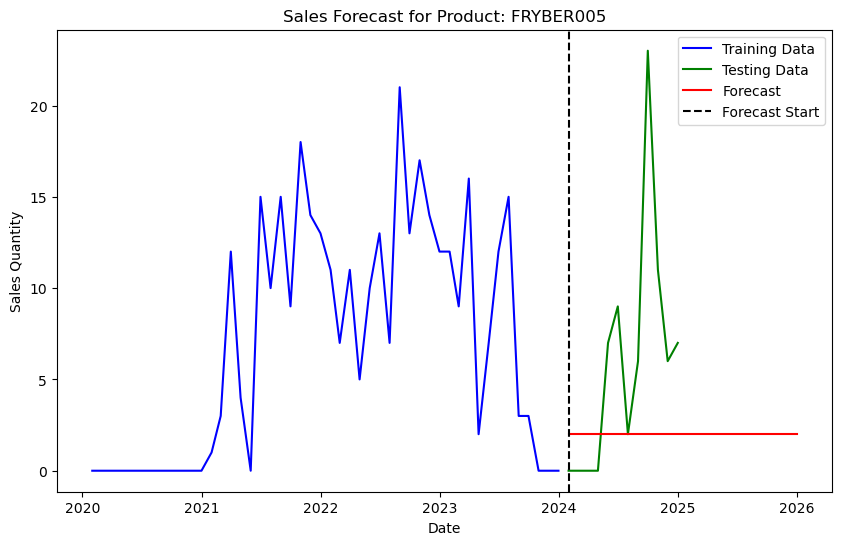

Forecasting for Item: GRLBER003
Running Auto-ARIMA for Product: GRLBER003
Optimal SARIMA parameters for GRLBER003: (0, 0, 0), (0, 0, 0, 12)
MAE: 4.333333333333333, MSE: 40.666666666666664, RMSE: 6.377042156569663
Execution time: 0.94 seconds


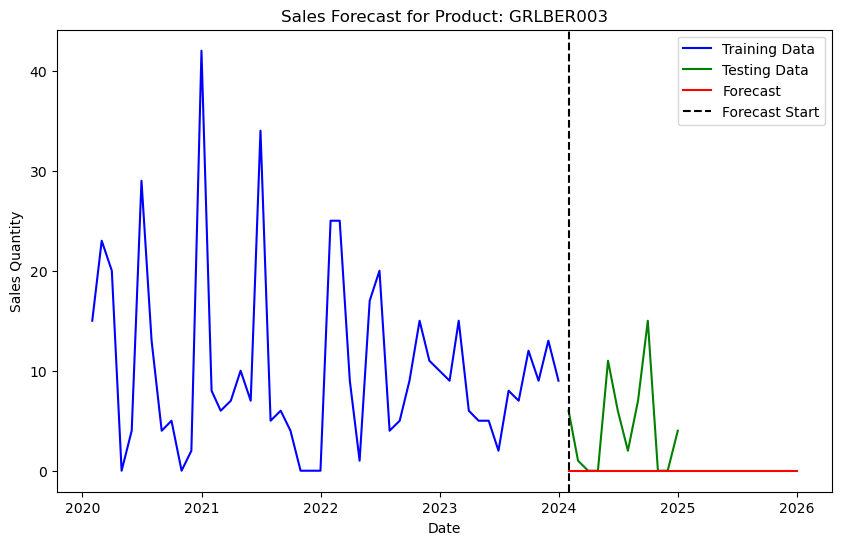

Forecasting for Item: GRLBER004
Running Auto-ARIMA for Product: GRLBER004
Optimal SARIMA parameters for GRLBER004: (0, 0, 0), (0, 0, 0, 12)
MAE: 3.25, MSE: 18.916666666666668, RMSE: 4.349329450233296
Execution time: 0.94 seconds


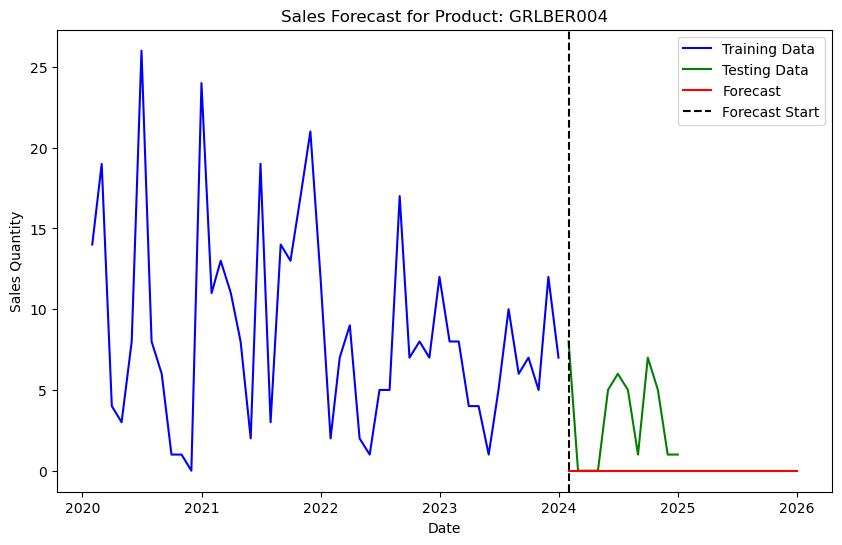

Forecasting for Item: GRLBER009
Running Auto-ARIMA for Product: GRLBER009
Optimal SARIMA parameters for GRLBER009: (0, 0, 1), (0, 0, 1, 12)
MAE: 1.4166666666666667, MSE: 3.4166666666666665, RMSE: 1.848422751068236
Execution time: 1.89 seconds


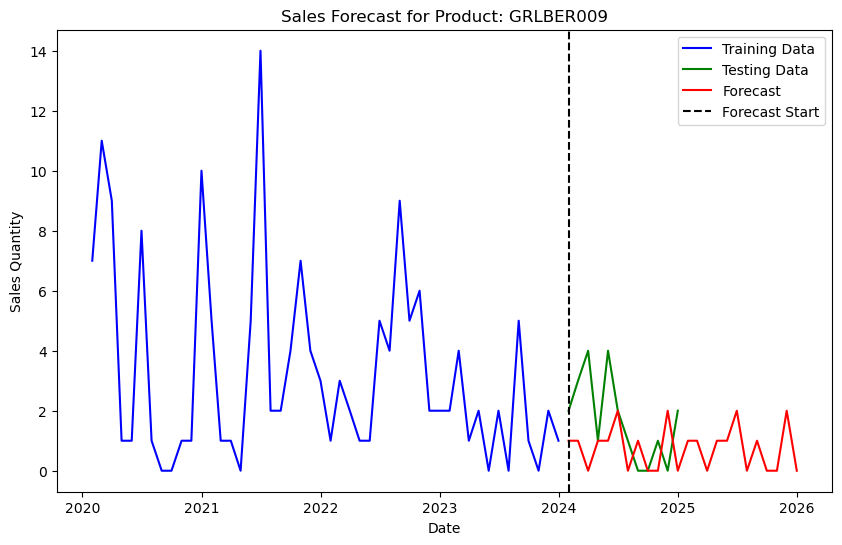

Forecasting for Item: GRLBER010
Running Auto-ARIMA for Product: GRLBER010
Optimal SARIMA parameters for GRLBER010: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.75, MSE: 0.9166666666666666, RMSE: 0.9574271077563381
Execution time: 1.02 seconds


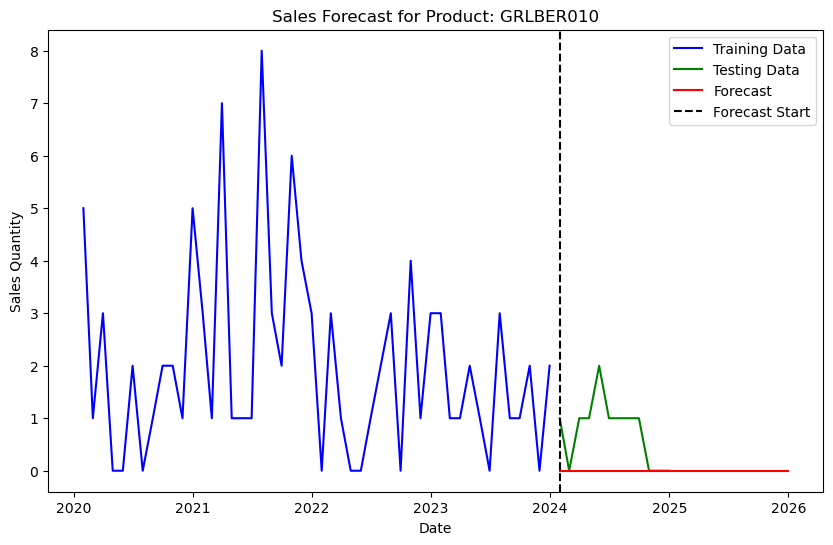

Forecasting for Item: GRLBER011
Running Auto-ARIMA for Product: GRLBER011
Optimal SARIMA parameters for GRLBER011: (2, 0, 1), (0, 0, 0, 12)
MAE: 1.8333333333333333, MSE: 5.666666666666667, RMSE: 2.3804761428476167
Execution time: 2.70 seconds


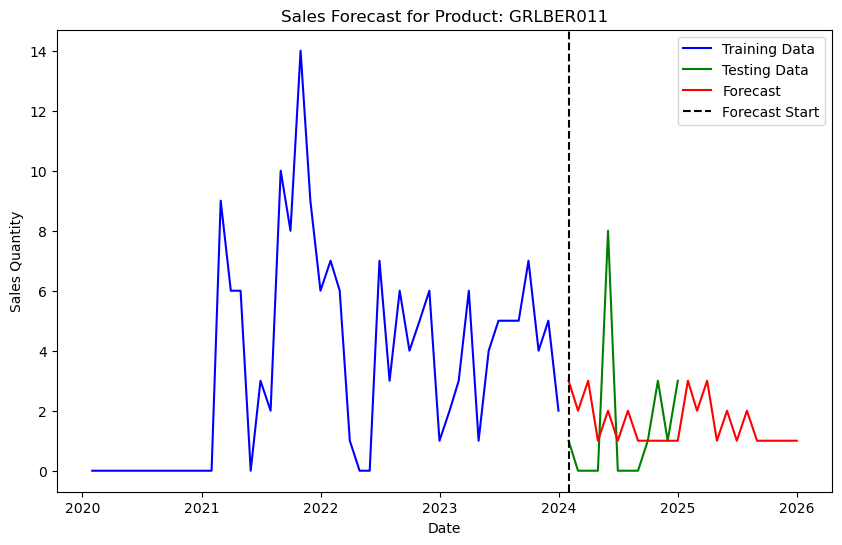

Forecasting for Item: GRLBER012
Running Auto-ARIMA for Product: GRLBER012
Optimal SARIMA parameters for GRLBER012: (2, 0, 0), (0, 0, 0, 12)
MAE: 1.0, MSE: 1.0, RMSE: 1.0
Execution time: 7.04 seconds


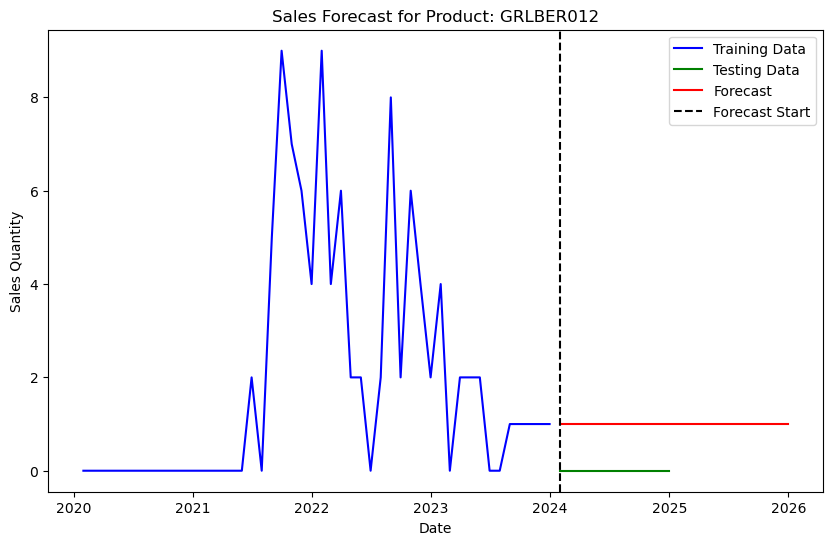

Forecasting for Item: GRLBER015
Running Auto-ARIMA for Product: GRLBER015
Optimal SARIMA parameters for GRLBER015: (1, 0, 0), (0, 0, 0, 12)
MAE: 2.1666666666666665, MSE: 7.833333333333333, RMSE: 2.798809270624444
Execution time: 0.98 seconds


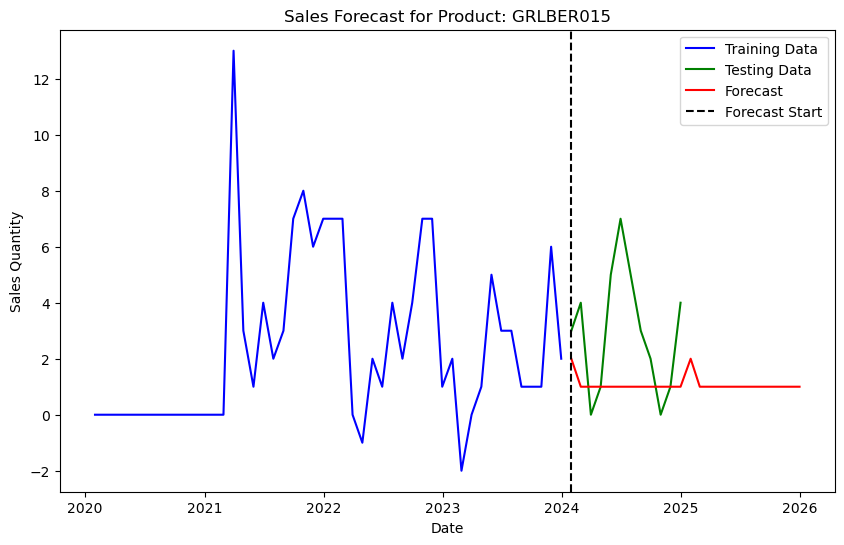

Forecasting for Item: GRLBER019
Running Auto-ARIMA for Product: GRLBER019
Optimal SARIMA parameters for GRLBER019: (1, 0, 2), (0, 0, 0, 12)
MAE: 0.75, MSE: 1.5833333333333333, RMSE: 1.2583057392117916
Execution time: 2.06 seconds


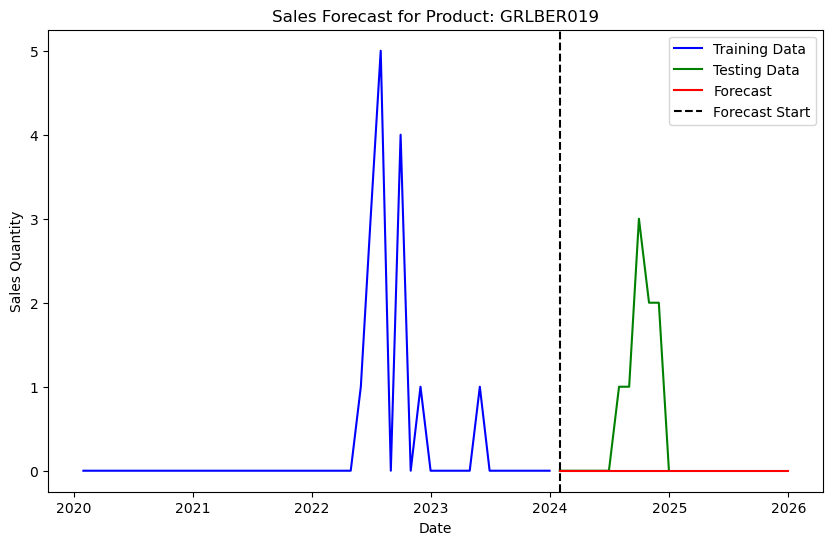

Forecasting for Item: GRLBER020
Running Auto-ARIMA for Product: GRLBER020
Optimal SARIMA parameters for GRLBER020: (1, 0, 0), (0, 0, 0, 12)
MAE: 0.75, MSE: 2.5833333333333335, RMSE: 1.6072751268321592
Execution time: 1.07 seconds


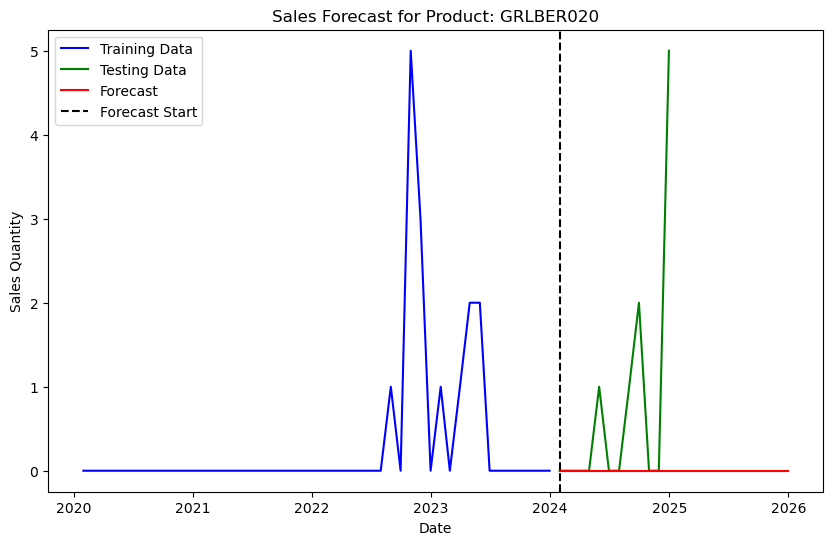

Forecasting for Item: HEABER001
Running Auto-ARIMA for Product: HEABER001
Optimal SARIMA parameters for HEABER001: (0, 0, 0), (0, 0, 0, 12)
MAE: 4.916666666666667, MSE: 36.25, RMSE: 6.020797289396148
Execution time: 0.95 seconds


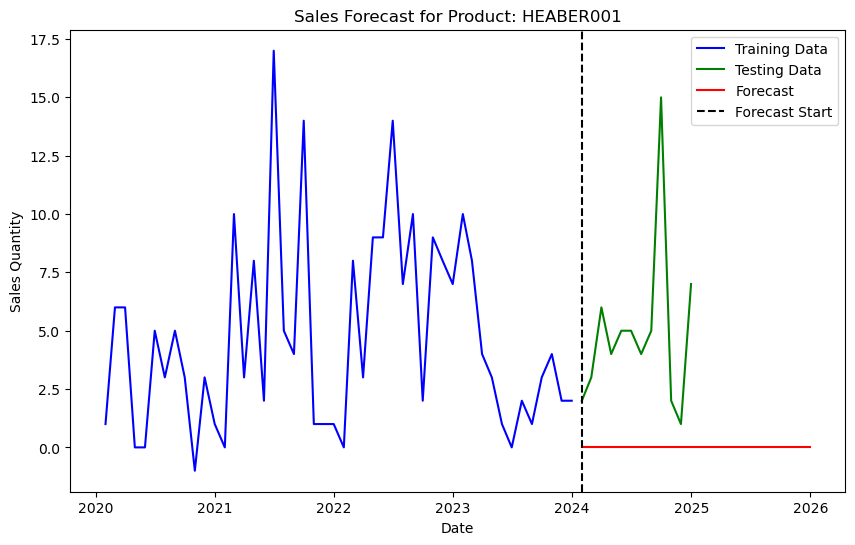

Forecasting for Item: HOTBER001
Running Auto-ARIMA for Product: HOTBER001
Optimal SARIMA parameters for HOTBER001: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.5, MSE: 2.1666666666666665, RMSE: 1.4719601443879744
Execution time: 0.86 seconds


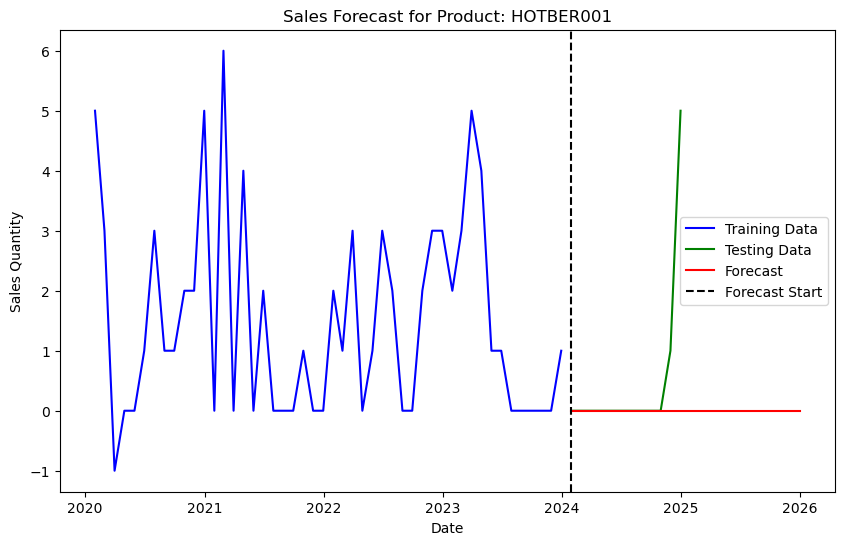

Forecasting for Item: HOTBER002
Running Auto-ARIMA for Product: HOTBER002
Optimal SARIMA parameters for HOTBER002: (1, 1, 1), (1, 0, 0, 12)
MAE: 1.1666666666666667, MSE: 1.8333333333333333, RMSE: 1.35400640077266
Execution time: 4.29 seconds


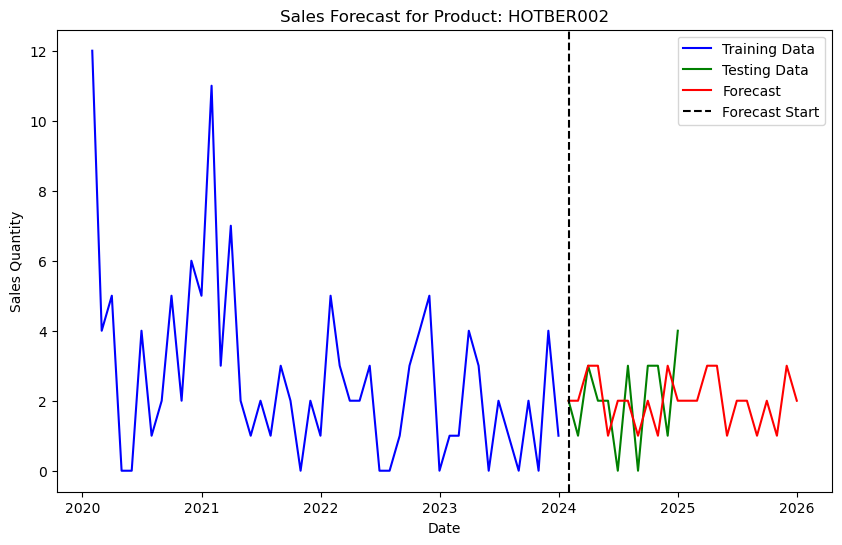

Forecasting for Item: HOTBER003
Running Auto-ARIMA for Product: HOTBER003
Optimal SARIMA parameters for HOTBER003: (1, 1, 1), (0, 0, 0, 12)
MAE: 1.1666666666666667, MSE: 2.0, RMSE: 1.4142135623730951
Execution time: 2.61 seconds


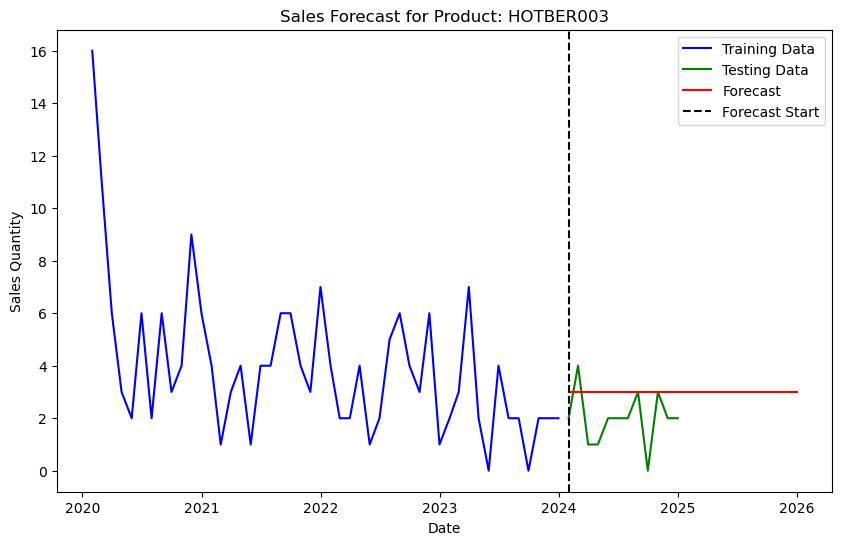

Forecasting for Item: ICMBER002
Running Auto-ARIMA for Product: ICMBER002
Optimal SARIMA parameters for ICMBER002: (0, 1, 1), (0, 1, 0, 12)
MAE: 1.4166666666666667, MSE: 3.25, RMSE: 1.8027756377319946
Execution time: 1.38 seconds


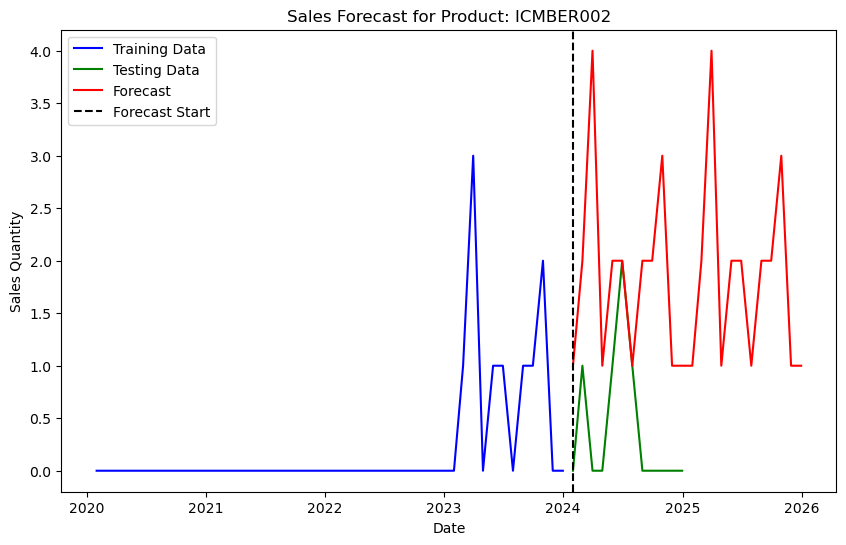

Forecasting for Item: ICMBER003
Running Auto-ARIMA for Product: ICMBER003
MAE: 0.75, MSE: 1.75, RMSE: 1.3228756555322954
Execution time: 0.04 seconds


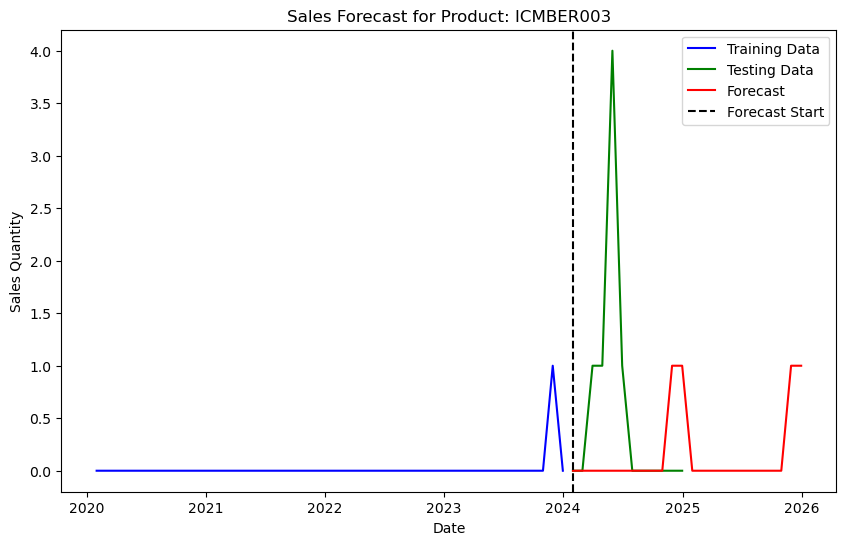

Forecasting for Item: MIXBER001
Running Auto-ARIMA for Product: MIXBER001
Optimal SARIMA parameters for MIXBER001: (0, 1, 1), (0, 0, 0, 12)
MAE: 1.8333333333333333, MSE: 5.166666666666667, RMSE: 2.273030282830976
Execution time: 2.50 seconds


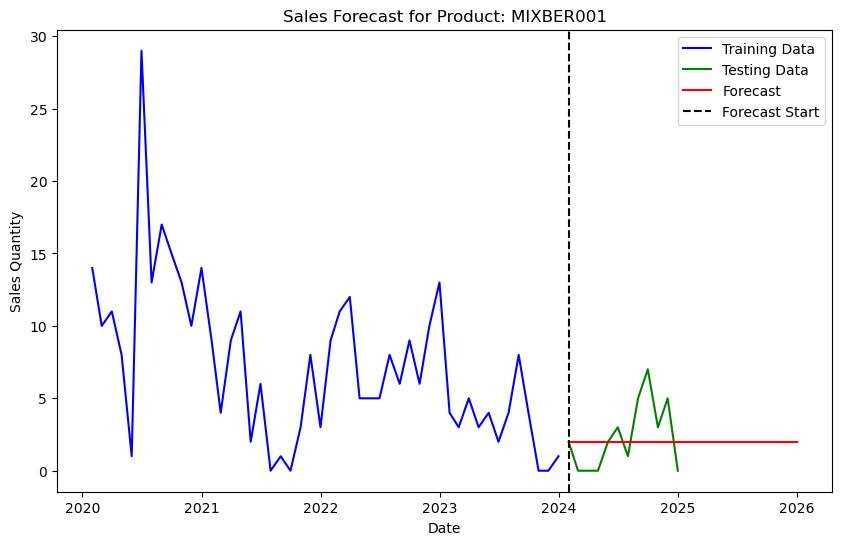

Forecasting for Item: MIXBER003
Running Auto-ARIMA for Product: MIXBER003
Optimal SARIMA parameters for MIXBER003: (0, 1, 1), (0, 0, 0, 12)
MAE: 2.25, MSE: 6.583333333333333, RMSE: 2.565800719723442
Execution time: 1.31 seconds


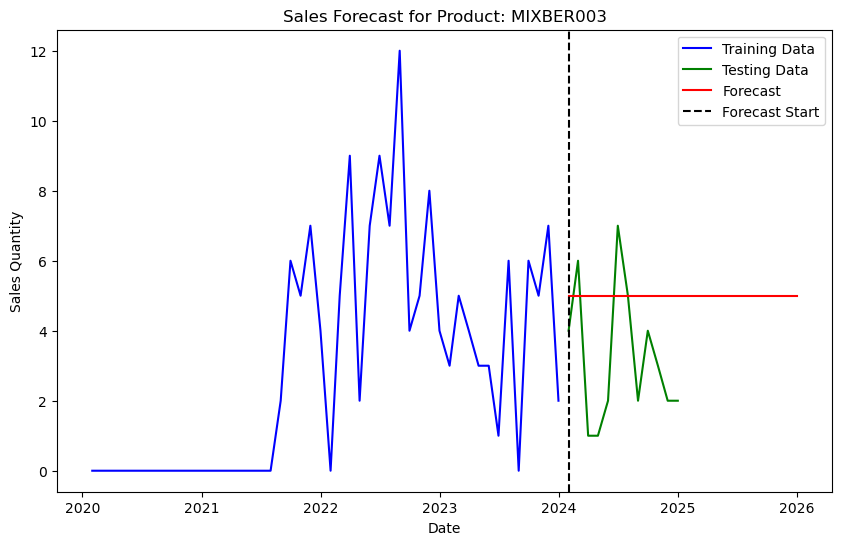

Forecasting for Item: OVEBER002
Running Auto-ARIMA for Product: OVEBER002
Optimal SARIMA parameters for OVEBER002: (1, 0, 0), (0, 0, 0, 12)
MAE: 3.25, MSE: 12.25, RMSE: 3.5
Execution time: 0.73 seconds


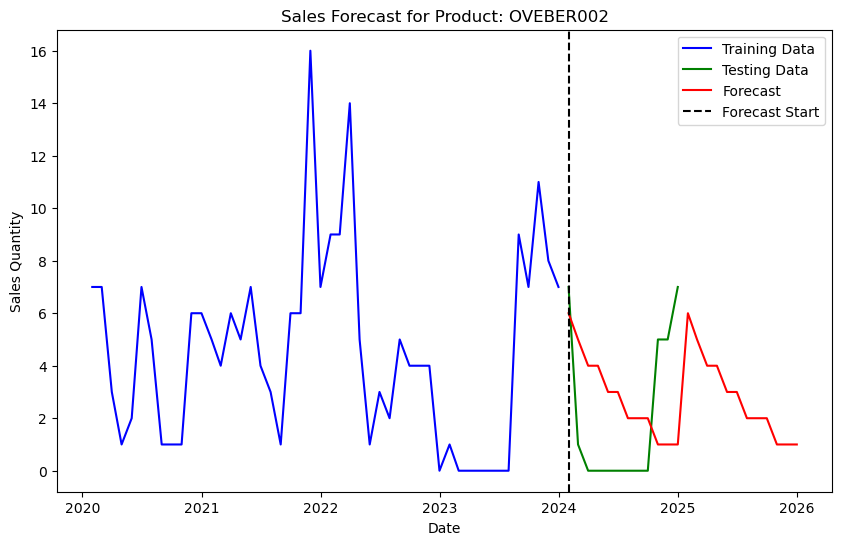

Forecasting for Item: OVEBER005
Running Auto-ARIMA for Product: OVEBER005
Optimal SARIMA parameters for OVEBER005: (0, 0, 2), (1, 0, 0, 12)
MAE: 0.75, MSE: 0.75, RMSE: 0.8660254037844386
Execution time: 3.32 seconds


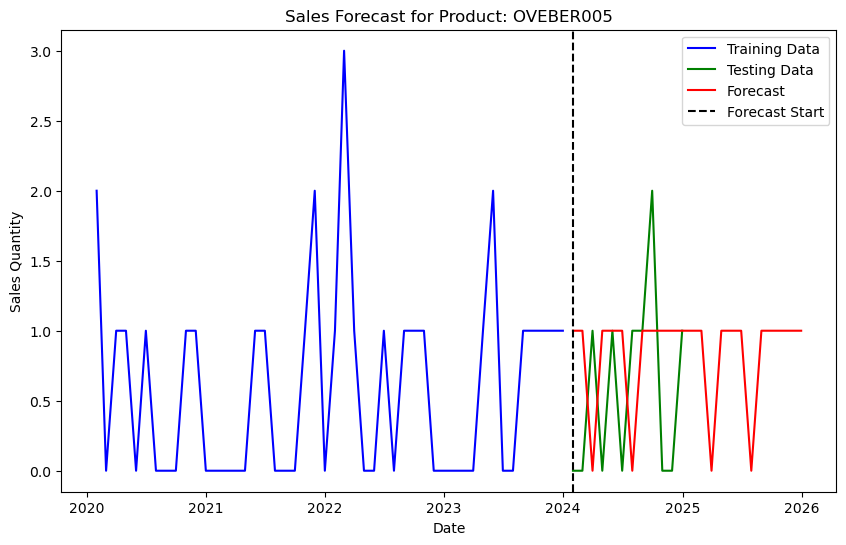

Forecasting for Item: OVEBER006
Running Auto-ARIMA for Product: OVEBER006
Optimal SARIMA parameters for OVEBER006: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.6666666666666666, MSE: 1.1666666666666667, RMSE: 1.0801234497346435
Execution time: 0.91 seconds


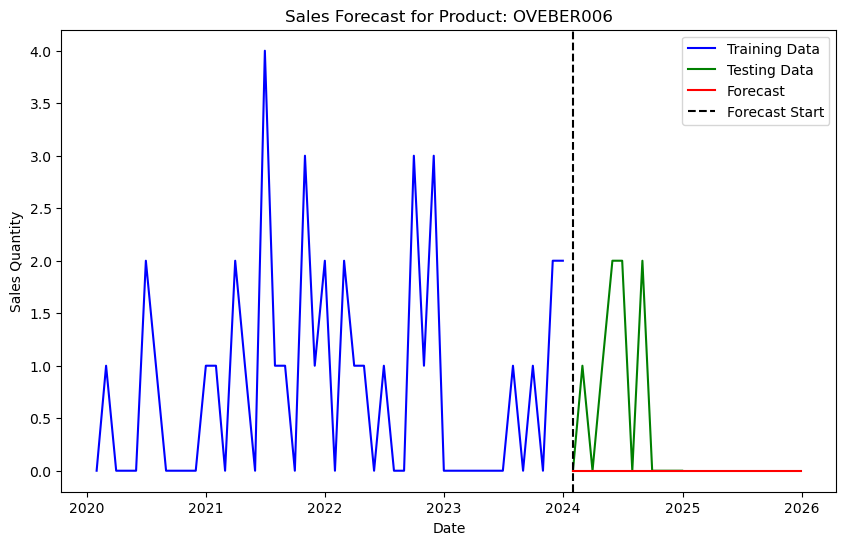

Forecasting for Item: OVEBER011
Running Auto-ARIMA for Product: OVEBER011
Optimal SARIMA parameters for OVEBER011: (0, 1, 0), (0, 0, 0, 12)
MAE: 8.75, MSE: 94.41666666666667, RMSE: 9.716823898098939
Execution time: 0.90 seconds


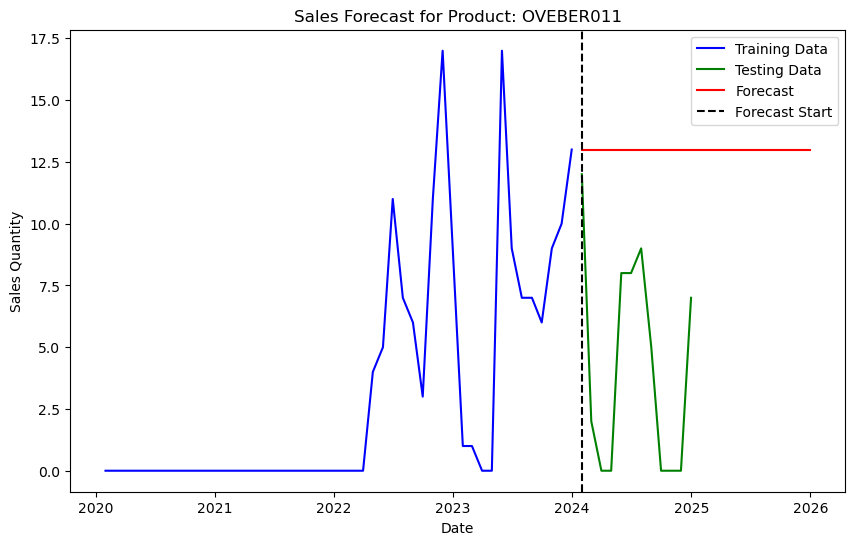

Forecasting for Item: OVEBER012
Running Auto-ARIMA for Product: OVEBER012
Optimal SARIMA parameters for OVEBER012: (0, 1, 1), (0, 0, 0, 12)
MAE: 4.0, MSE: 18.333333333333332, RMSE: 4.281744192888376
Execution time: 2.96 seconds


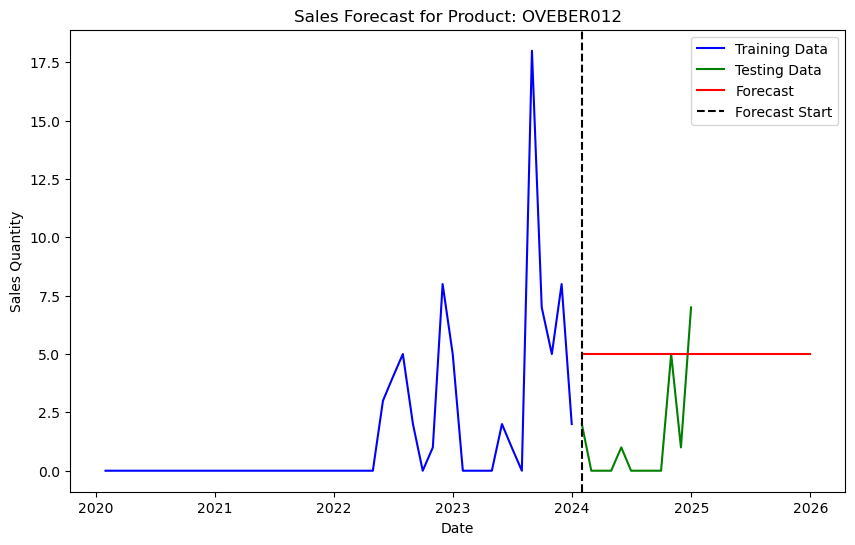

Forecasting for Item: OVEBER013
Running Auto-ARIMA for Product: OVEBER013
Optimal SARIMA parameters for OVEBER013: (1, 0, 0), (0, 1, 0, 12)
MAE: 5.916666666666667, MSE: 40.25, RMSE: 6.34428877022476
Execution time: 1.56 seconds


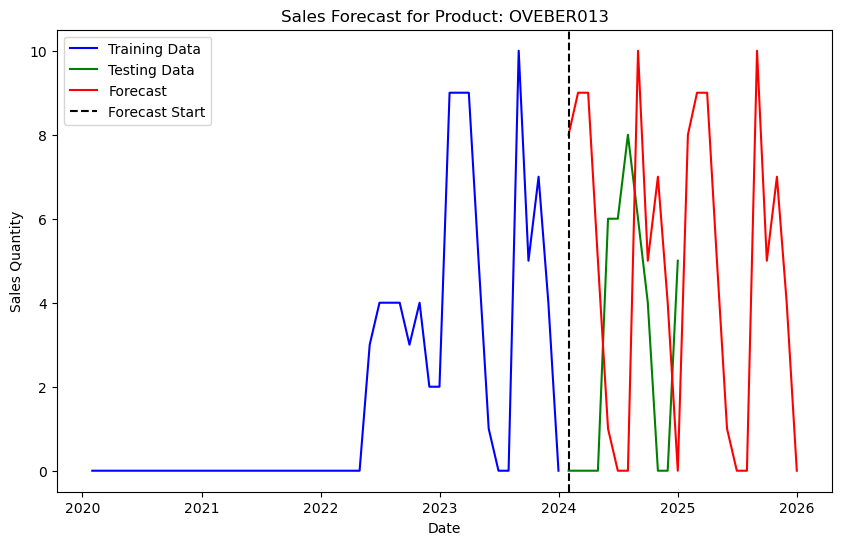

Forecasting for Item: OVEBER014
Running Auto-ARIMA for Product: OVEBER014
Optimal SARIMA parameters for OVEBER014: (0, 1, 1), (0, 0, 0, 12)
MAE: 1.0, MSE: 1.6666666666666667, RMSE: 1.2909944487358056
Execution time: 1.11 seconds


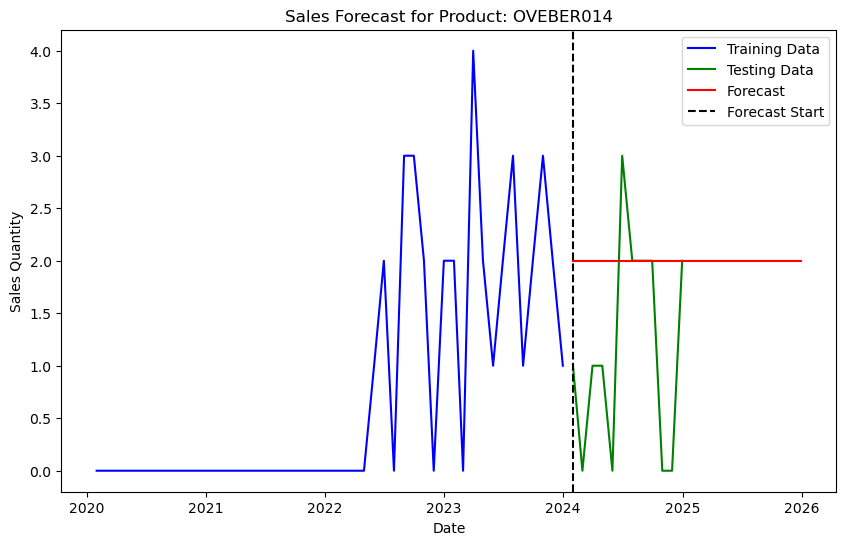

Forecasting for Item: OVEBER015
Running Auto-ARIMA for Product: OVEBER015
Optimal SARIMA parameters for OVEBER015: (0, 1, 1), (0, 0, 0, 12)
MAE: 0.6666666666666666, MSE: 0.8333333333333334, RMSE: 0.9128709291752769
Execution time: 2.87 seconds


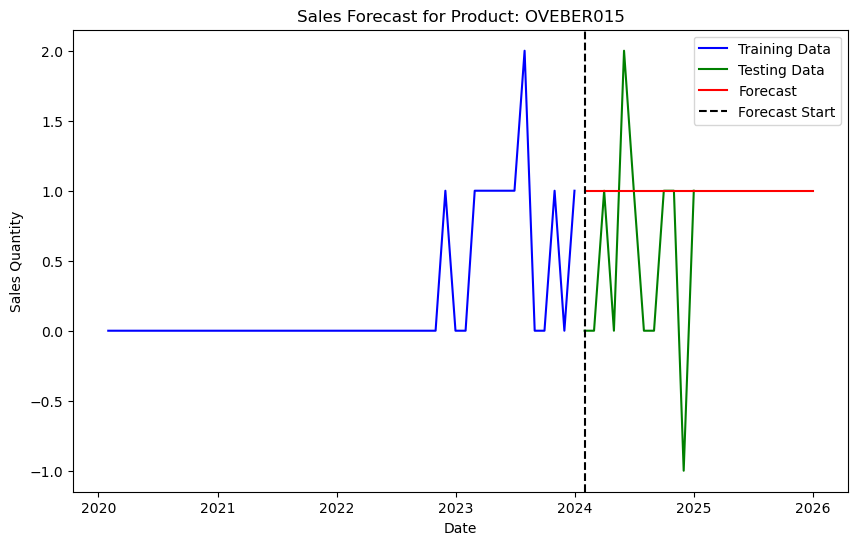

Forecasting for Item: OVEBER016
Running Auto-ARIMA for Product: OVEBER016
Optimal SARIMA parameters for OVEBER016: (0, 1, 1), (0, 0, 0, 12)
MAE: 1.0833333333333333, MSE: 3.0833333333333335, RMSE: 1.7559422921421233
Execution time: 2.38 seconds


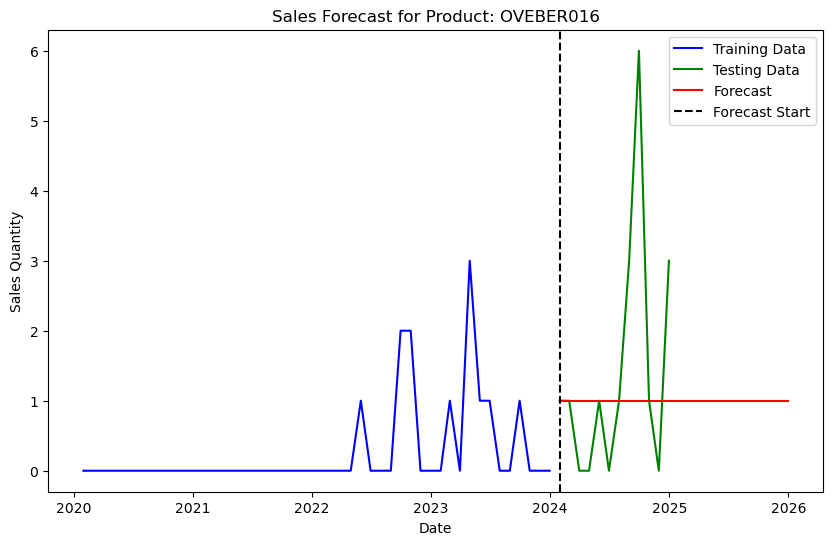

Forecasting for Item: OVEBER017
Running Auto-ARIMA for Product: OVEBER017
Optimal SARIMA parameters for OVEBER017: (2, 0, 0), (0, 0, 0, 12)
MAE: 1.0, MSE: 2.3333333333333335, RMSE: 1.5275252316519468
Execution time: 1.55 seconds


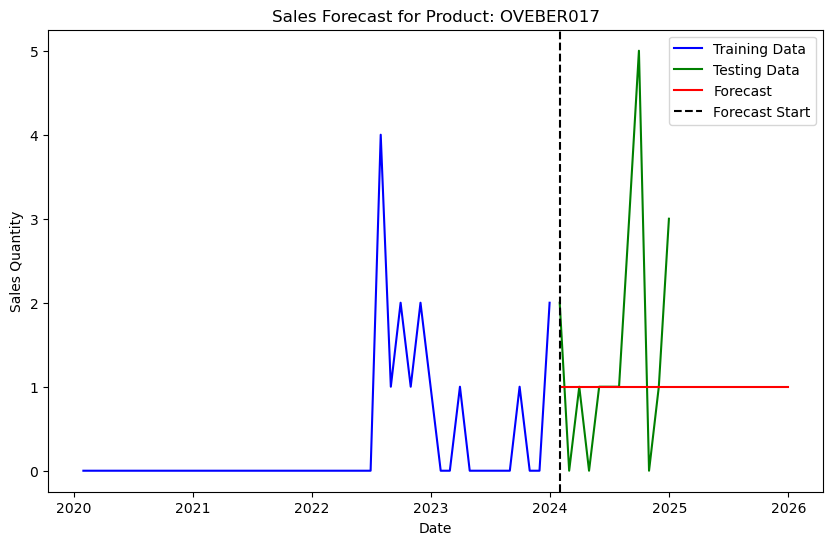

Forecasting for Item: POPBER001
Running Auto-ARIMA for Product: POPBER001
Optimal SARIMA parameters for POPBER001: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.4166666666666667, MSE: 1.0833333333333333, RMSE: 1.0408329997330663
Execution time: 0.96 seconds


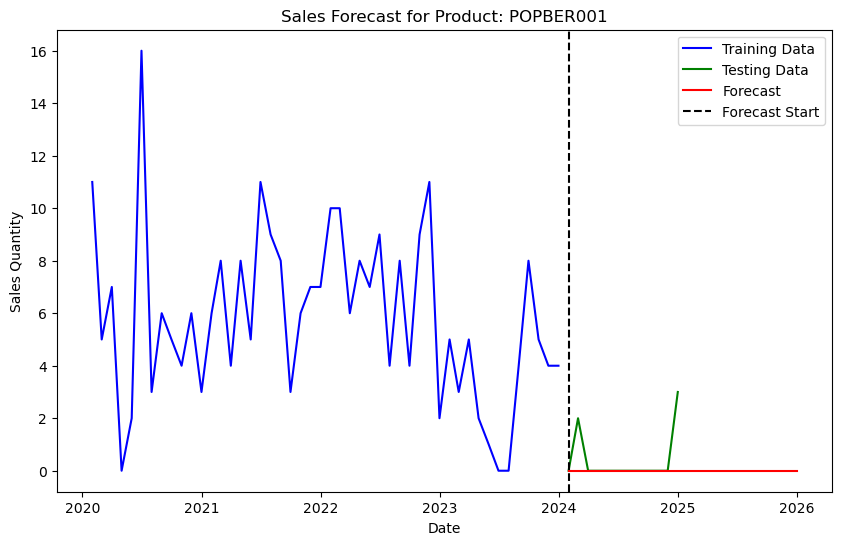

Forecasting for Item: SOPBER001
Running Auto-ARIMA for Product: SOPBER001
Optimal SARIMA parameters for SOPBER001: (0, 0, 0), (0, 0, 0, 12)
MAE: 3.25, MSE: 19.916666666666668, RMSE: 4.4628092796652945
Execution time: 0.95 seconds


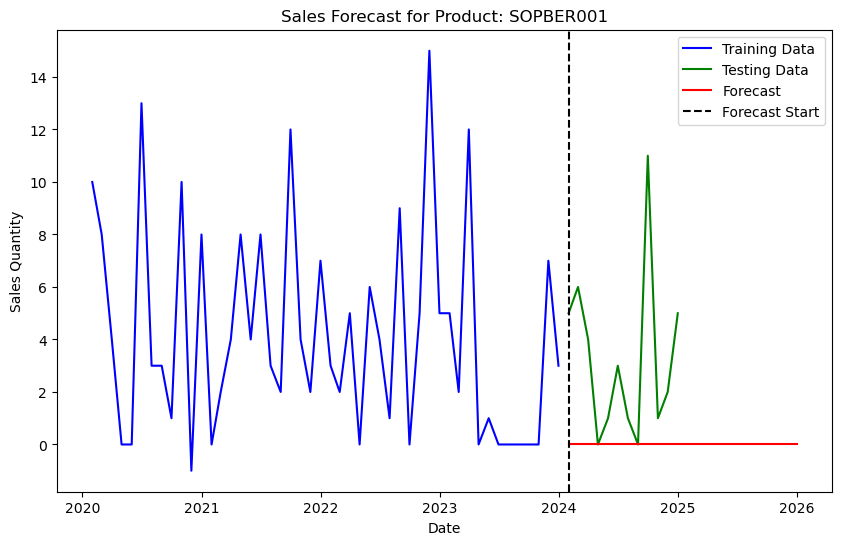

Forecasting for Item: TROBER001
Running Auto-ARIMA for Product: TROBER001
Optimal SARIMA parameters for TROBER001: (1, 0, 0), (0, 0, 1, 12)
MAE: 0.5, MSE: 0.6666666666666666, RMSE: 0.816496580927726
Execution time: 1.44 seconds


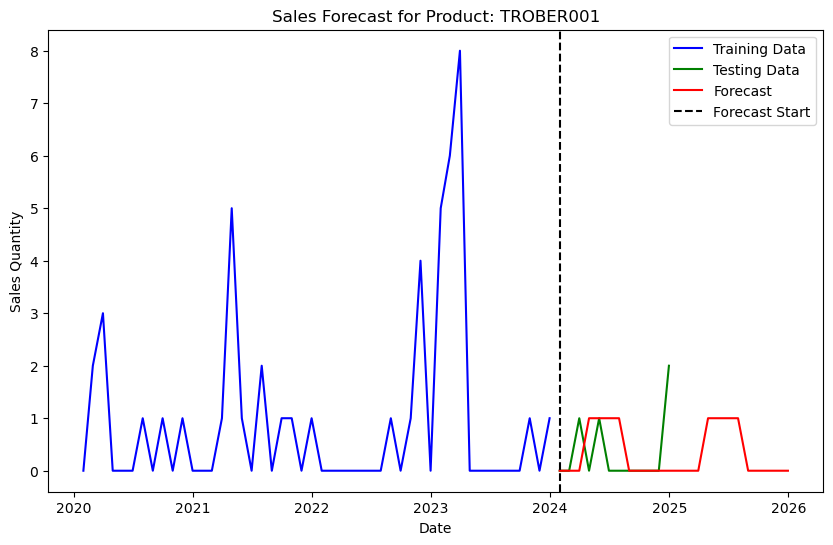

Forecasting for Item: TROBER003
Running Auto-ARIMA for Product: TROBER003
Optimal SARIMA parameters for TROBER003: (2, 0, 0), (0, 0, 1, 12)
MAE: 0.75, MSE: 0.75, RMSE: 0.8660254037844386
Execution time: 2.91 seconds


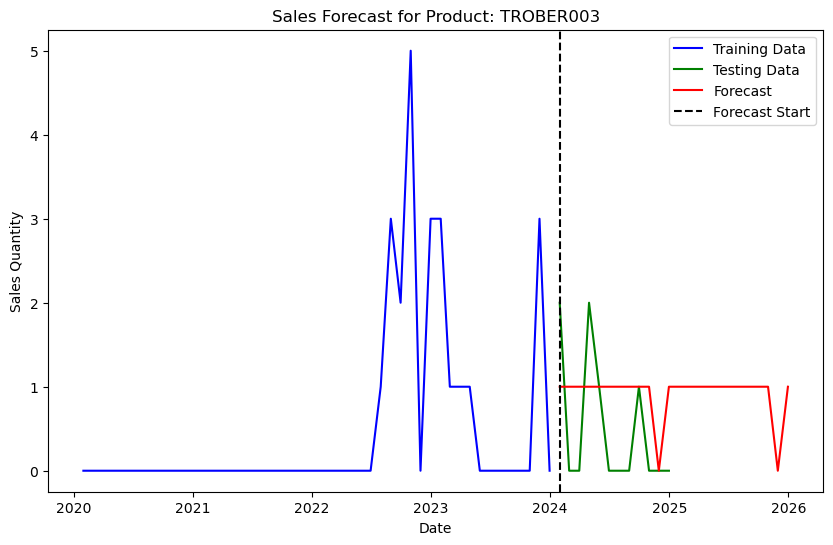

Forecasting for Item: WARBER001
Running Auto-ARIMA for Product: WARBER001
Optimal SARIMA parameters for WARBER001: (1, 0, 0), (0, 0, 0, 12)
MAE: 0.0, MSE: 0.0, RMSE: 0.0
Execution time: 1.28 seconds


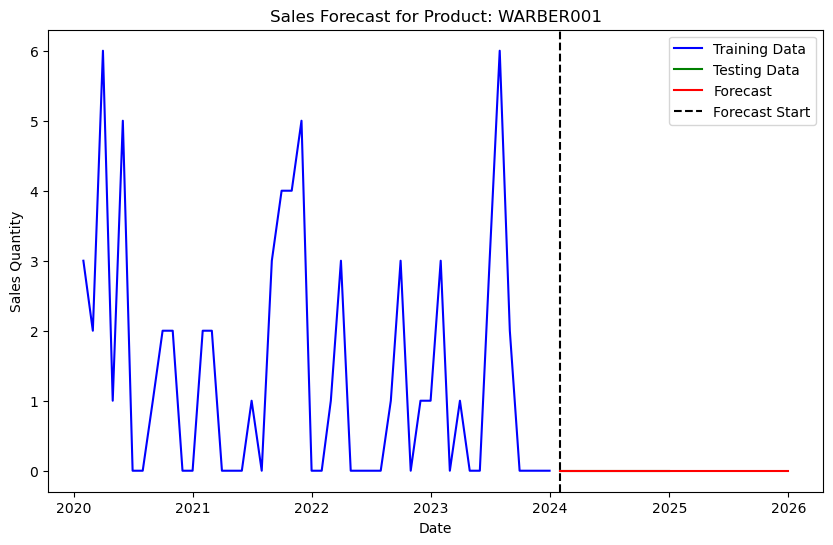

Forecasting for Item: WARBER002
Running Auto-ARIMA for Product: WARBER002
Optimal SARIMA parameters for WARBER002: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.0, MSE: 0.0, RMSE: 0.0
Execution time: 0.81 seconds


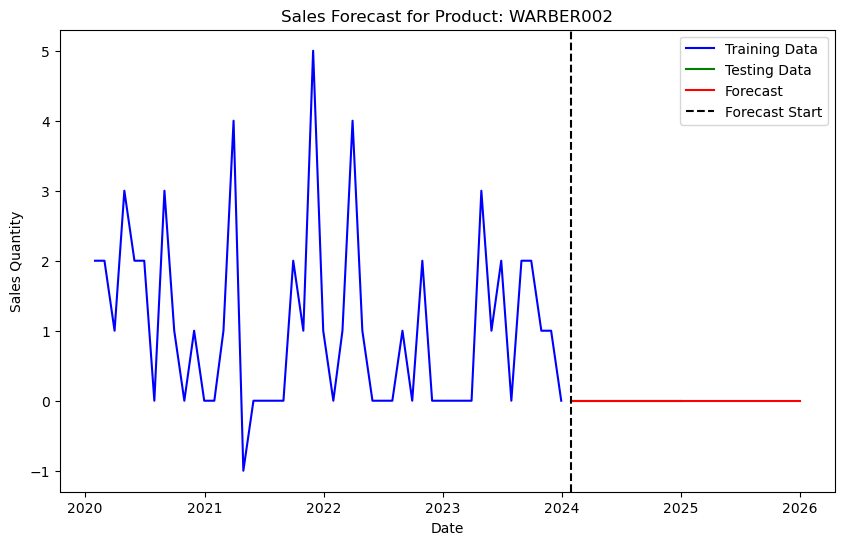

Forecasting for Item: WARBER003
Running Auto-ARIMA for Product: WARBER003
Optimal SARIMA parameters for WARBER003: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.4166666666666667, MSE: 0.5833333333333334, RMSE: 0.7637626158259734
Execution time: 0.99 seconds


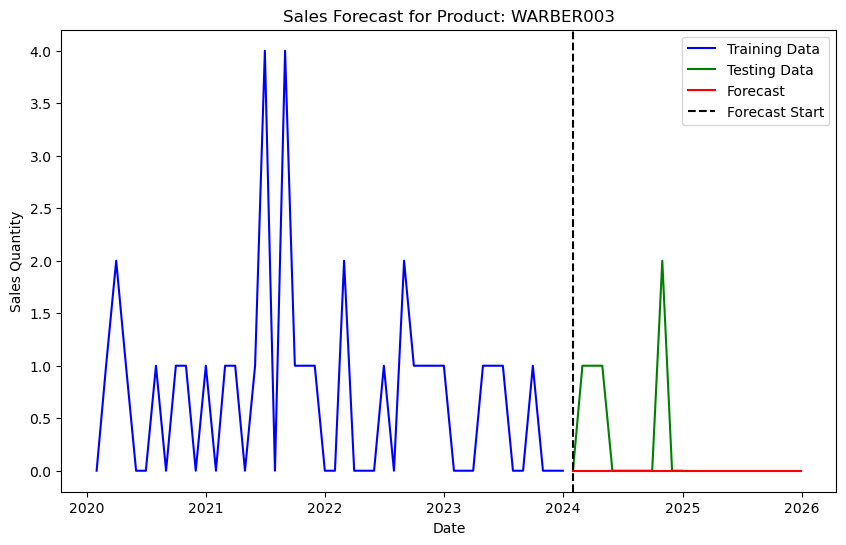

Forecasting for Item: WARBER004
Running Auto-ARIMA for Product: WARBER004
Optimal SARIMA parameters for WARBER004: (0, 0, 0), (0, 0, 1, 12)
MAE: 0.6666666666666666, MSE: 0.8333333333333334, RMSE: 0.9128709291752769
Execution time: 2.59 seconds


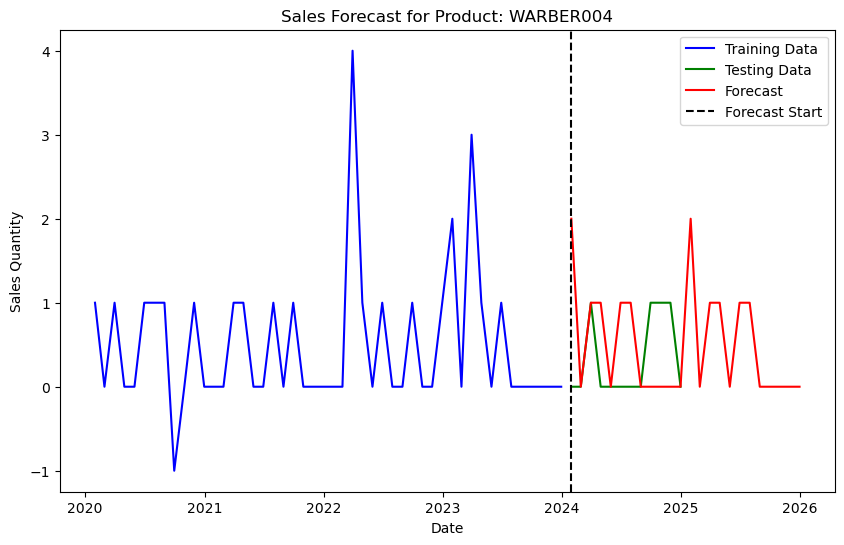

Forecasting for Item: WARBER005
Running Auto-ARIMA for Product: WARBER005
Optimal SARIMA parameters for WARBER005: (0, 0, 1), (0, 0, 0, 12)
MAE: 0.16666666666666666, MSE: 0.3333333333333333, RMSE: 0.5773502691896257
Execution time: 1.37 seconds


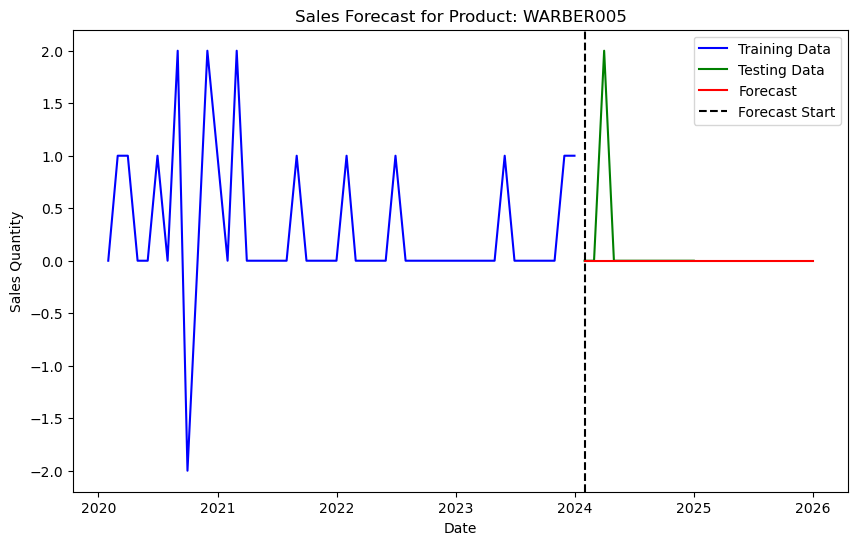

Forecasting for Item: WARBER006
Running Auto-ARIMA for Product: WARBER006
Optimal SARIMA parameters for WARBER006: (0, 1, 1), (2, 0, 0, 12)
MAE: 0.5833333333333334, MSE: 0.75, RMSE: 0.8660254037844386
Execution time: 12.56 seconds


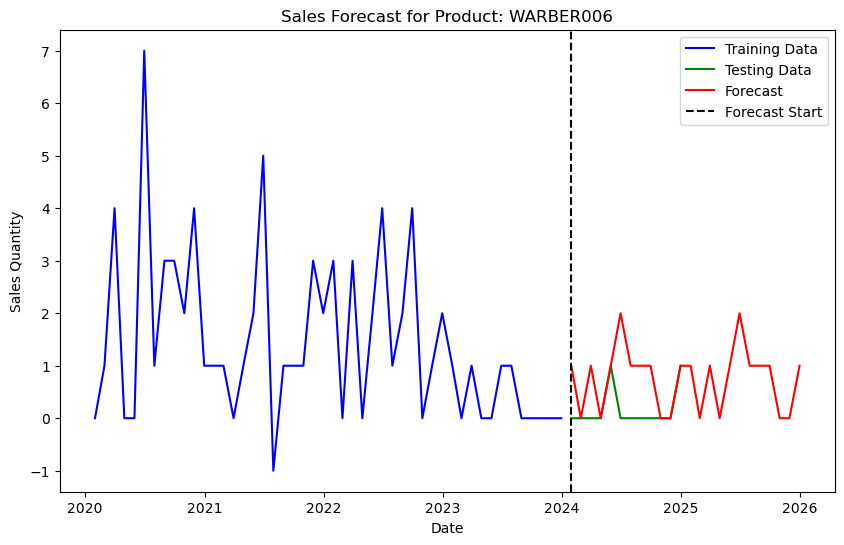

Forecasting for Item: WARBER009
Running Auto-ARIMA for Product: WARBER009
Optimal SARIMA parameters for WARBER009: (0, 0, 0), (0, 0, 0, 12)
MAE: 1.1666666666666667, MSE: 2.6666666666666665, RMSE: 1.632993161855452
Execution time: 0.75 seconds


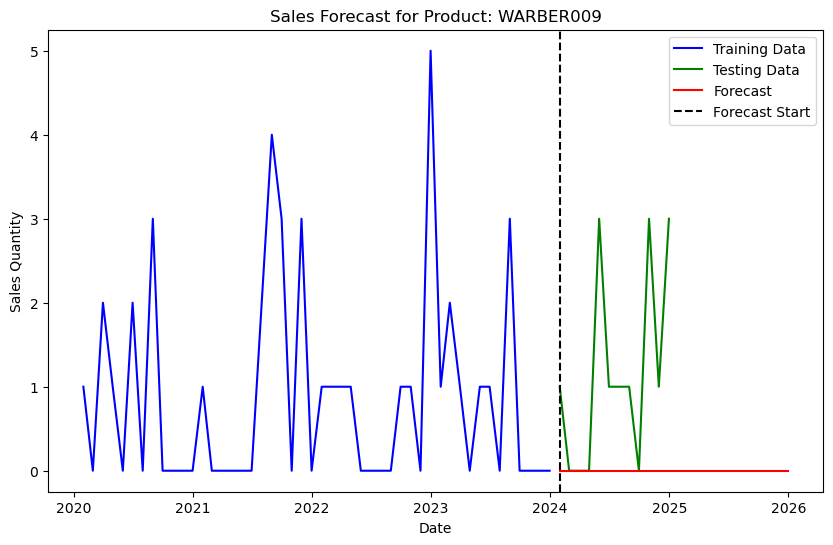

Forecasting for Item: WARBER010
Running Auto-ARIMA for Product: WARBER010
Optimal SARIMA parameters for WARBER010: (0, 0, 1), (0, 0, 0, 12)
MAE: 1.5833333333333333, MSE: 4.083333333333333, RMSE: 2.0207259421636903
Execution time: 0.94 seconds


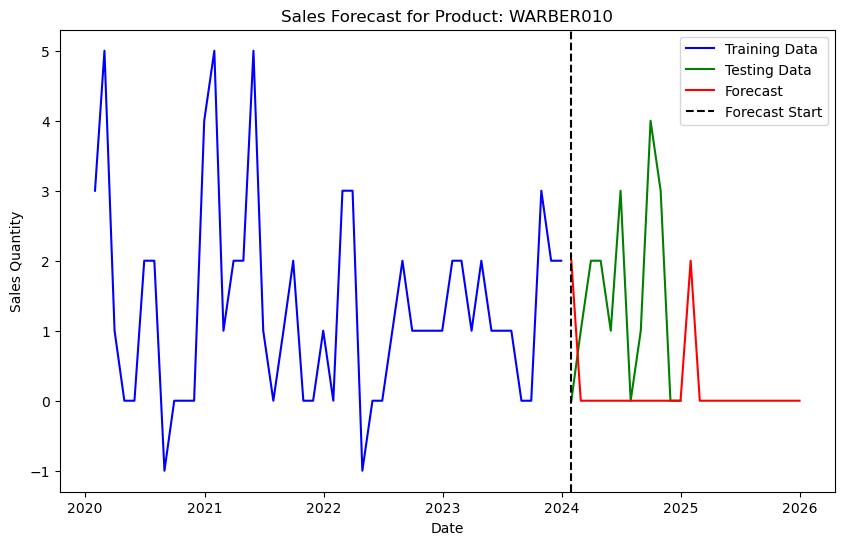

Forecasting for Item: WARBER011
Running Auto-ARIMA for Product: WARBER011
Optimal SARIMA parameters for WARBER011: (0, 0, 0), (0, 0, 0, 12)
MAE: 1.3333333333333333, MSE: 3.5, RMSE: 1.8708286933869707
Execution time: 0.95 seconds


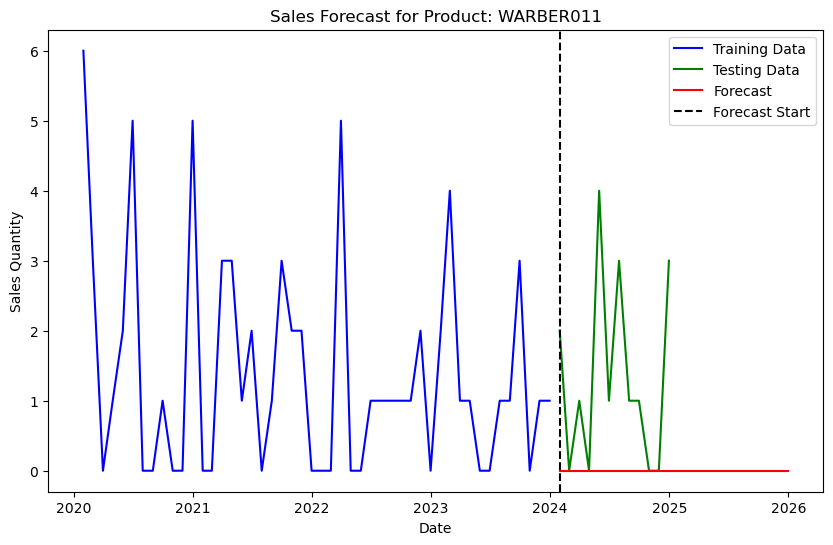

Forecasting for Item: WARBER012
Running Auto-ARIMA for Product: WARBER012
Optimal SARIMA parameters for WARBER012: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.4166666666666667, MSE: 0.4166666666666667, RMSE: 0.6454972243679028
Execution time: 1.02 seconds


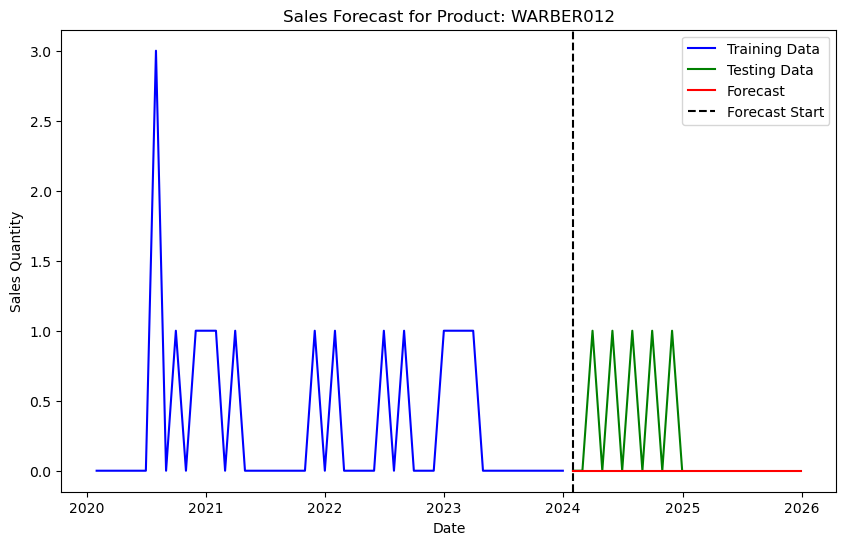

Forecasting for Item: WARBER013
Running Auto-ARIMA for Product: WARBER013
Optimal SARIMA parameters for WARBER013: (0, 1, 1), (0, 0, 0, 12)
MAE: 0.9166666666666666, MSE: 0.9166666666666666, RMSE: 0.9574271077563381
Execution time: 2.81 seconds


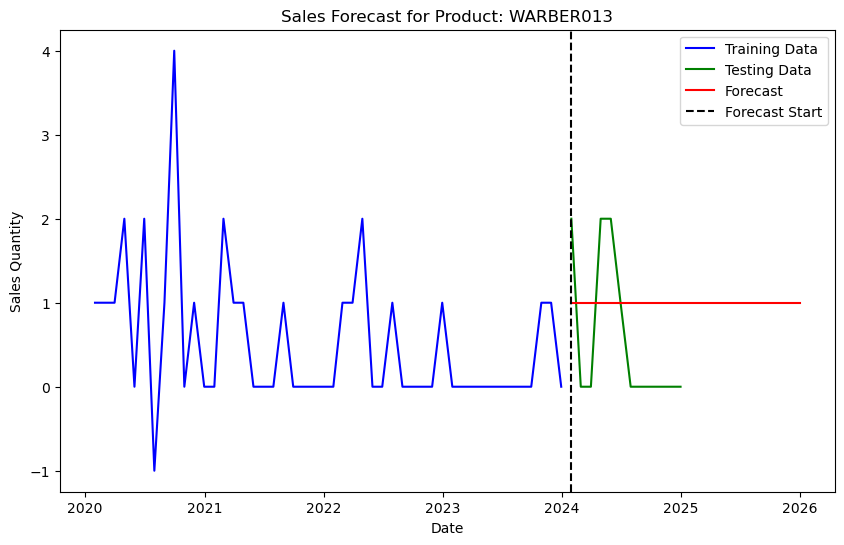

Forecasting for Item: WARBER015
Running Auto-ARIMA for Product: WARBER015
Optimal SARIMA parameters for WARBER015: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.3333333333333333, MSE: 0.5, RMSE: 0.7071067811865476
Execution time: 0.92 seconds


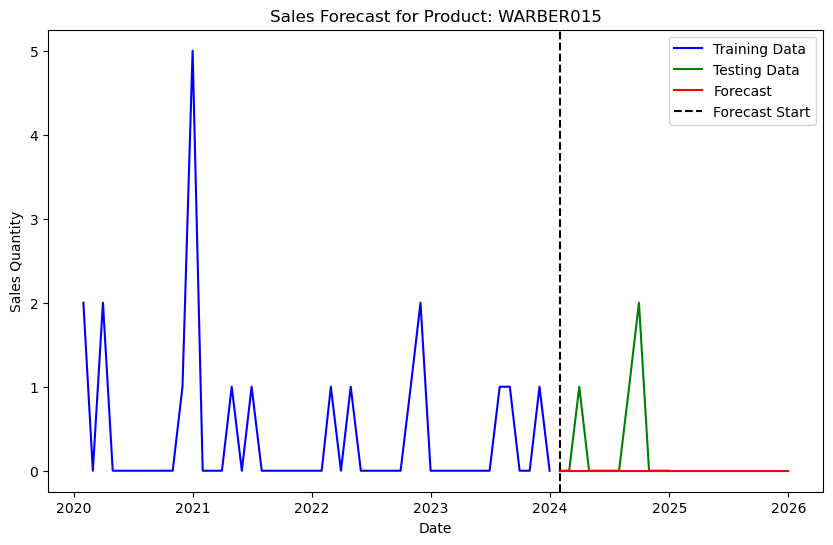

Forecasting for Item: WARBER016
Running Auto-ARIMA for Product: WARBER016
Optimal SARIMA parameters for WARBER016: (1, 0, 0), (0, 0, 0, 12)
MAE: 0.08333333333333333, MSE: 0.08333333333333333, RMSE: 0.28867513459481287
Execution time: 0.87 seconds


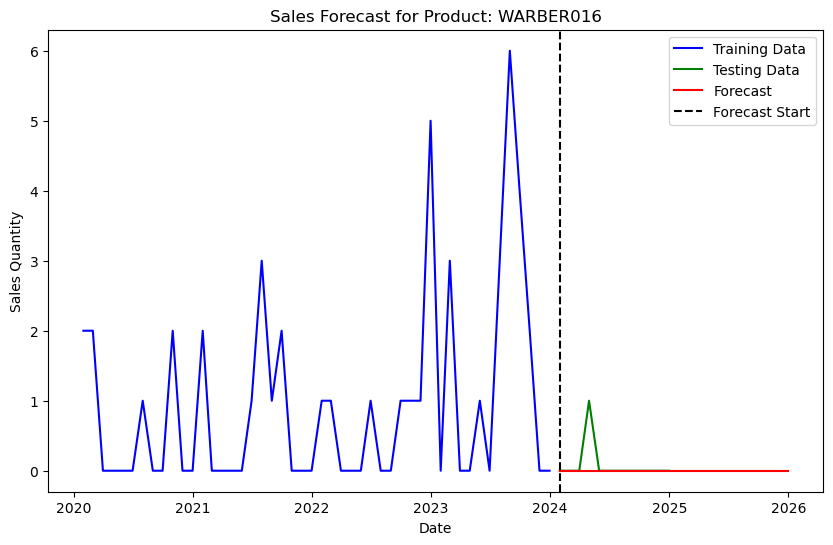

Forecasting for Item: WARBER022
Running Auto-ARIMA for Product: WARBER022
Optimal SARIMA parameters for WARBER022: (0, 0, 0), (0, 0, 0, 12)
MAE: 0.16666666666666666, MSE: 0.3333333333333333, RMSE: 0.5773502691896257
Execution time: 0.94 seconds


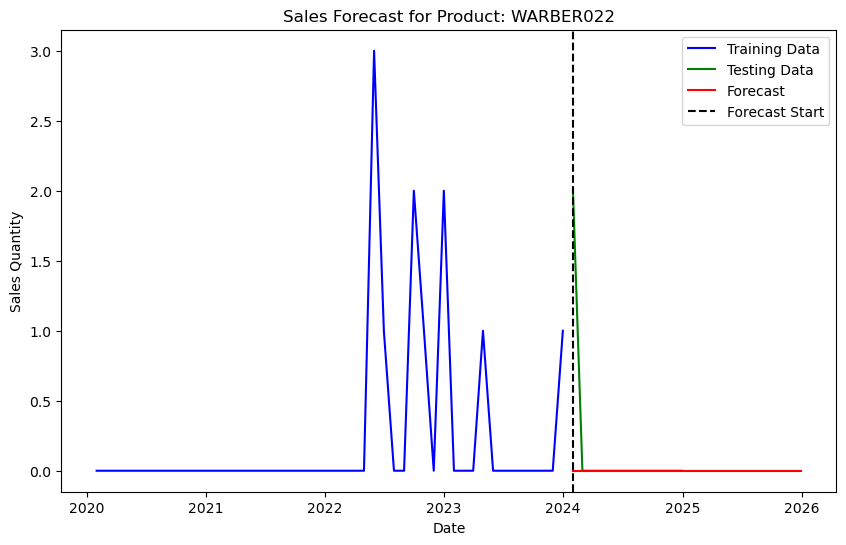

Forecasting for Item: WARBER023
Running Auto-ARIMA for Product: WARBER023
Optimal SARIMA parameters for WARBER023: (4, 1, 0), (0, 0, 0, 12)
MAE: 0.9166666666666666, MSE: 0.9166666666666666, RMSE: 0.9574271077563381
Execution time: 7.22 seconds


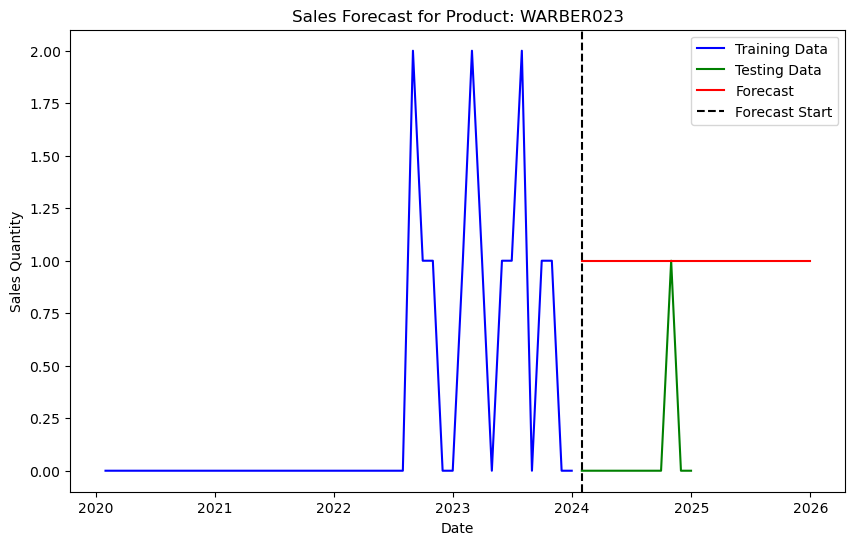

Forecasting for Item: WARBER024
Running Auto-ARIMA for Product: WARBER024
Optimal SARIMA parameters for WARBER024: (1, 0, 0), (0, 0, 0, 12)
MAE: 0.16666666666666666, MSE: 0.16666666666666666, RMSE: 0.408248290463863
Execution time: 1.99 seconds


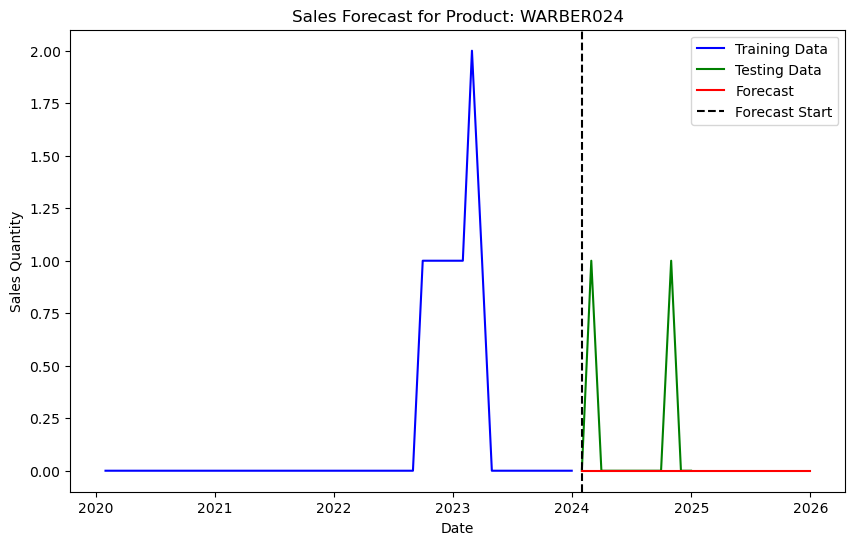

In [93]:
# Ignore warnings for clean output
import warnings
warnings.filterwarnings("ignore")  

def forecast_best_sarimax(ProductNumber, data_filled, horizon_months=12):
    # Record the start time
    start_time = time.time()
    
    # Filter data for the specific product
    filtered_data = data_filled[data_filled['ProductNumber'] == ProductNumber]
    
    if filtered_data.empty:
        print(f"No data available for Item: {ProductNumber}")
        return None, None
    
    # Prepare data
    df = filtered_data[['month', 'Sum of InvoicedQuantity']].rename(columns={'month': 'ds', 'Sum of InvoicedQuantity': 'y'})
    df.loc[:,'ds'] = pd.to_datetime(df['ds'])
    # df.loc[:, 'Date'] = df['ds']
    df = df.sort_values('ds').reset_index(drop=True)
    df.set_index('ds', inplace=True)
    
    # df = filtered_data[['month', 'Sum of InvoicedQuantity']].rename(columns={'month': 'ds', 'Sum of InvoicedQuantity': 'y'})
    # df.loc[:,'ds'] = pd.to_datetime(df['ds'])
    # df.loc[:, 'Date'] = df['ds']
    # df = df.sort_values('ds').reset_index(drop=True)
    # df.set_index('ds', inplace=True)
    # df.index = pd.to_datetime(df.index).to_period('M').to_timestamp()
    
    # Split the data into training and testing sets
    split_date = pd.Timestamp("2024-01-01")
    train_data = df[df.index < split_date]
    test_data = df[df.index >= split_date]

    
    y_train, y_test = train_data['y'], test_data['y']
    
    if len(y_train) < 2:
        print(f"Not enough training data for Item: {ProductNumber}")
        return None, None

    # Use Auto-ARIMA to find the best parameters
    print(f"Running Auto-ARIMA for Product: {ProductNumber}")
    if ProductNumber == 'ICMBER003':
        order = (1, 0, 0)
        seasonal_order = (0, 1, 0, 12)
    else:
        try:
            arima_model = auto_arima(
                y_train,
                seasonal=True,
                m=12,  # Monthly data
                stepwise=True,
                suppress_warnings=True,
                error_action="ignore",
                trace=False #non-verbose output for searching parameters
            )
            order = arima_model.order
            seasonal_order = arima_model.seasonal_order
            print(f"Optimal SARIMA parameters for {ProductNumber}: {order}, {seasonal_order}")
        except Exception as e:
            print(f"Auto-ARIMA failed for Item: {ProductNumber} -> {e}")
            return None, None


    # Train the SARIMAX model with the selected parameters
    try:
        model = SARIMAX(y_train, order=order, seasonal_order=seasonal_order)
        model_fit = model.fit(disp=False)
    except Exception as e:
        print(f"Error fitting SARIMAX for Item: {ProductNumber} -> {e}")
        return None, None
    
    # # Train the SARIMAX model with the selected parameters
    # try:
    #     model = SARIMAX(y_train, order=order, seasonal_order=seasonal_order)
    #     model_fit = model.fit(disp=False)
    # except Exception as e:
    #     print(f"Error fitting SARIMAX for Item: {ProductNumber} -> {e}")
    #     return None, None
    
    
    # Generate predictions for the test period
    forecast_test = model_fit.get_prediction(start=y_test.index[0], end=y_test.index[-1])
    
    test_data = test_data.copy()
    
    test_data.loc[:, 'forecasted_y'] = np.ceil(forecast_test.predicted_mean).clip(lower=0)
    
    # Calculate accuracy metrics
    mae = mean_absolute_error(y_test, test_data['forecasted_y'])
    mse = mean_squared_error(y_test, test_data['forecasted_y'])
    rmse = root_mean_squared_error(y_test, test_data['forecasted_y'])
    test_data.loc[:, 'MAE'] = mae
    test_data.loc[:, 'MSE'] = mse
    test_data.loc[:, 'RMSE'] = rmse
    print(f"MAE: {mae}, MSE: {mse}, RMSE: {rmse}")
    
    # Generate future forecasts
    future_index = pd.date_range(start=df.index.max(), periods=horizon_months + 1, freq='ME')[1:]
    future_forecast = model_fit.get_forecast(steps=horizon_months)
    future_df = pd.DataFrame({
        'ds': future_index,
        'forecasted_y': np.ceil(future_forecast.predicted_mean).clip(lower=0)
    })

    # Combine test and future forecasts
    forecast = pd.concat([test_data[['y', 'forecasted_y']], future_df.set_index('ds')], ignore_index=False)
    
    # Record the end time
    end_time = time.time()
    execution_time = end_time - start_time
    
    # Append execution time as a column
    test_data.loc[:, 'execution_time_seconds'] = execution_time
    print(f"Execution time: {execution_time:.2f} seconds")
    
    
    
    # Plot the results
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.plot(train_data.index, train_data['y'], label="Training Data", color="blue")
    ax.plot(test_data.index, test_data['y'], label="Testing Data", color="green")
    ax.plot(forecast.index, forecast['forecasted_y'], label="Forecast", color="red")
    ax.axvline(test_data.index[0], color='black', linestyle='--', label="Forecast Start")
    ax.set_title(f"Sales Forecast for Product: {ProductNumber}")
    ax.set_xlabel("Date")
    ax.set_ylabel("Sales Quantity")
    ax.legend()
    plt.show()

    return test_data, forecast

# Get unique product combinations
product_combinations = data_filled[['ProductNumber']].drop_duplicates()


# Initialize containers for results
evaluation_best_res = []
forecast_best_res = []

# Perform forecasting for each product
for _, row in product_combinations.iterrows():
    ProductNumber = row['ProductNumber']
    print(f"Forecasting for Item: {ProductNumber}")
    evaluation_best_df2, forecast_best_df2 = forecast_best_sarimax(ProductNumber, data_filled, horizon_months=12)
    
    if evaluation_best_df2 is not None and forecast_best_df2 is not None:
        evaluation_best_df2['ProductNumber'] = ProductNumber
        forecast_best_df2['ProductNumber'] = ProductNumber
        
        evaluation_best_res.append(evaluation_best_df2)
        forecast_best_res.append(forecast_best_df2)

# Combine all results into separate DataFrames
evaluation_best_df_comb = pd.concat(evaluation_best_res, ignore_index=False)
forecast_best_df_comb = pd.concat(forecast_best_res, ignore_index=False)

In [94]:
# Save results to CSV
evaluation_best_df_comb.to_csv("evaluation_df_best_results.csv", index=False)
forecast_best_df_comb.to_csv("forecast_df_best_results.csv", index=False)